In [12]:
# Code for a classic GAN

# Importing dependencies
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
from utils import Logger

In [13]:
# Dataset used is LeCunn's MNIST dataset (60000 black and white images each being 28x28)
# We first preprocess the dataset with some useful hacks proven to be useful for training GANs.
# Particularly, the input values which range betwee [0, 255] will be normalized between -1 and 1.

def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5, .5, .5), (.5, .5, .5))
        ]
    )
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)

# Load data
data = mnist_data()

# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)

# Num batches
num_batches = len(data_loader)

In [14]:
# First we define the Discriminator network. This will take a flattened image as the input and
# return the probability of the image belonging to the real dataset. The input size = 28x28=784
# The network has three hidden layers, each followed by a Leaky-Relu non-linearity and a Dropout
# layer to prevent overfitting. A sigmoid/logistic function is aplied to the real valued output to
# obtain real-valued output to obtain a value in the open-interval (0,1).

class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1

        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        return self.out(self.hidden2(self.hidden1(self.hidden0(x))))


discriminator = DiscriminatorNet()

In [15]:
# Some additional functionality to convert a flattened image to its 2 dimensional representation and the opposite.

def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [16]:
# Constructing the Generative Network
# The generative network takes a latent variable vector as input and returns a 784 valued vector which corresponds
# to a flattened 28x28 image. The purpose of thsi network is to learn how to create real-looking images.
# The network has three hidden layers each followed by a Leaky-Relu non-linearity and finally a TanH activation funtion
# which maps the resulting values in the (-1, 1) range which is the same range our preprocessed MNIST images are boundeddddd.

class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )

        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

generator = GeneratorNet()

In [17]:
# We need something that is able to produce random noise from a normal distribution with mean 0 and variance 1.
def noise(size):
    """
    Generates a 1-d vector of Gaussian sampled random values
    """
    n = Variable(torch.randn(size, 100))
    return n

print (noise(1))

tensor([[-1.6107, -0.7706, -0.1413,  1.4880, -0.3577, -1.1263,  2.4612, -0.2830,
         -1.1961, -0.7214,  0.3030, -0.0555, -0.2391, -0.4141, -0.6822,  1.7732,
          2.0728,  0.7698, -0.3847,  0.4948, -0.9496, -0.9328, -0.7148,  0.2532,
         -0.3361,  0.2715, -0.0874, -0.9814, -0.5246, -0.4633,  0.8949, -1.3624,
          0.6444,  0.0201, -0.9708,  0.8872,  0.1884, -1.2463,  0.8193,  0.9813,
         -1.4911, -0.1084,  0.6424,  1.1267,  1.0374,  1.7526, -0.0799,  0.7129,
         -1.2862, -0.6423,  0.2844,  0.2855,  0.8433, -0.0443,  0.0407,  0.3609,
         -0.0002, -0.1029,  0.1290,  0.1881,  0.3079, -1.4005, -0.3451,  0.7814,
         -0.2638,  0.4534,  0.4036, -1.7277, -0.4873, -0.1272,  1.1346, -2.2451,
         -0.4742,  1.4815, -0.2583,  2.3699,  0.6446, -1.8539, -0.1275,  1.1460,
         -0.5655,  0.9513,  1.2806,  0.1120, -2.3038, -0.1828,  0.4248,  0.7109,
         -0.1137, -1.2251, -0.3122,  1.7457,  0.3821, -0.9453,  1.5871,  0.1565,
          0.1829,  0.1292,  

In [18]:
# Optimization of the GAN (We use the Adam optimization algorithm with a learning rate of 0.0002)
# Discriminator Optimizer
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

# We use Binary Cross-Entropy Loss
loss = nn.BCELoss()

# Why BCE loss? Consult the notes!!
# We can observe the real images targets are always ones and the fake images targets are zero. So it would be
# helpful to define the following functions
def ones_target(size):
    """
    Tensor containing ones with shape = size
    """
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    """
    Tensor containing zeros with shape = size
    """
    data = Variable(torch.zeros(size, 1))
    return data

In [19]:
# By summing up these two discriminator losses we obtain the total mini-batch loss for the Discriminator.
# In practice, we will calculate the gradients separately, then update them together

def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Resetting gradients
    optimizer.zero_grad()

    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N))
    error_real.backward()

    # 1.2 Train on fake data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backprop
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()

    # 1.3 Update the weights with gradients
    optimizer.step()

    # Return error ad predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [20]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)

    # Reset gradients
    optimizer.zero_grad()
    
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    
    # Calculate error and backprop
    error = loss(prediction, ones_target(N))
    error.backward()
    
    # Update the weights with gradients
    optimizer.step()

    # Return error
    return error

In [21]:
# We want to visualize how the training process develops as the GAN leanrs. To do so, we create a static batch of
# noise every few steps we will visualize the batch of images the generator outputs when using this noise as input
num_test_samples = 16
test_noise = noise(num_test_samples)

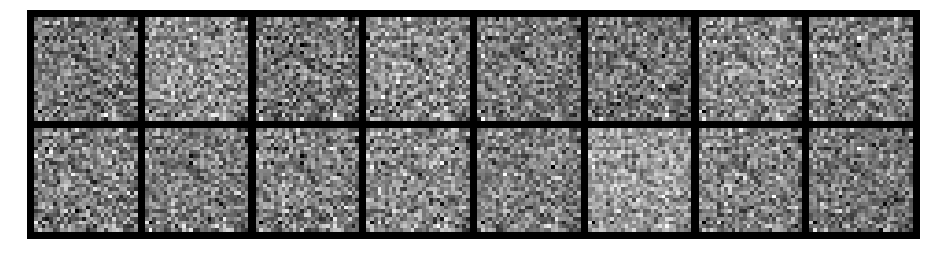

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.2763, Generator Loss: 0.7149
D(x): 0.5470, D(G(z)): 0.4897


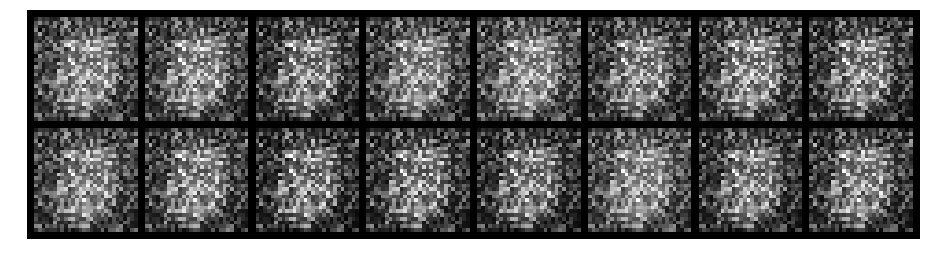

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.9010, Generator Loss: 0.5521
D(x): 0.7851, D(G(z)): 0.7893


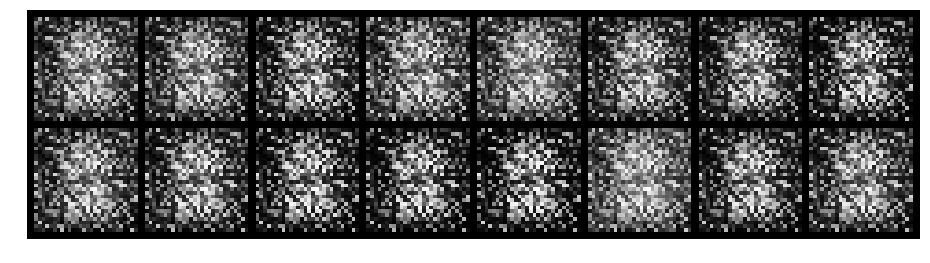

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.4201, Generator Loss: 4.4070
D(x): 0.8702, D(G(z)): 0.2025


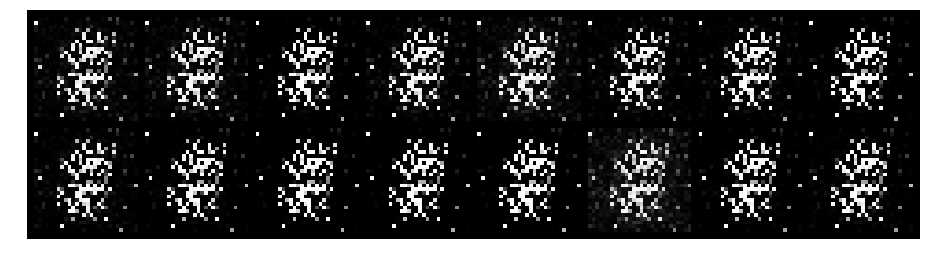

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.1529, Generator Loss: 5.4701
D(x): 0.9462, D(G(z)): 0.0646


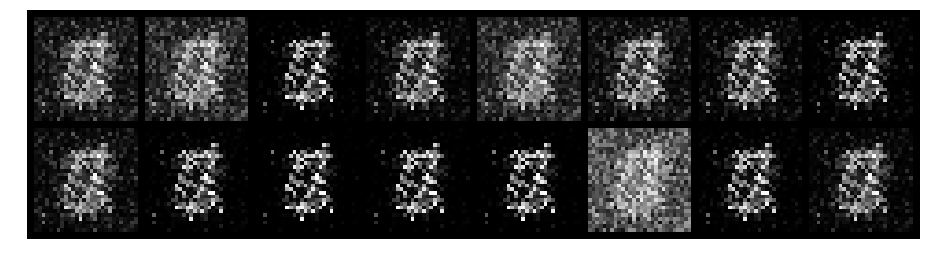

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 4.5882, Generator Loss: 0.2181
D(x): 0.5670, D(G(z)): 0.9464


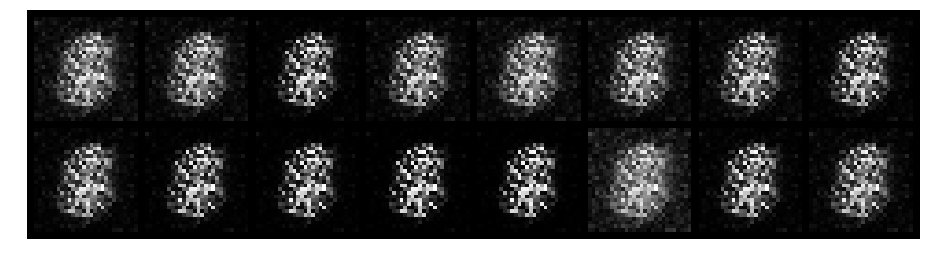

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 1.0278, Generator Loss: 3.0054
D(x): 0.5398, D(G(z)): 0.2071


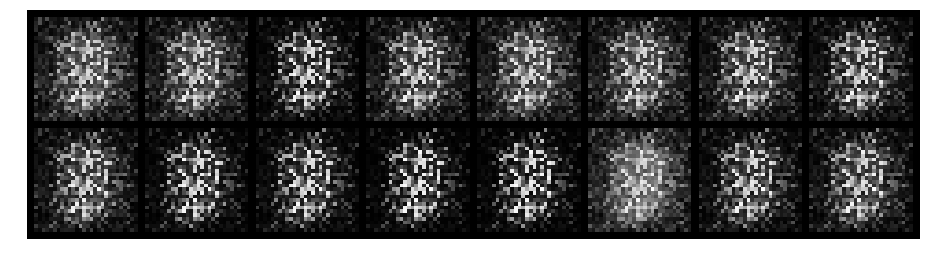

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.4377, Generator Loss: 4.0911
D(x): 0.8605, D(G(z)): 0.1815


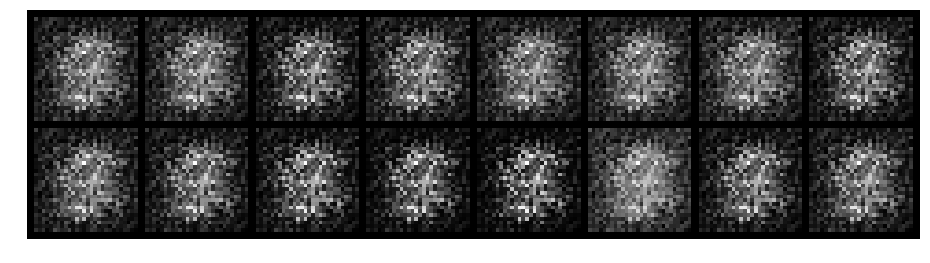

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.1064, Generator Loss: 1.0238
D(x): 0.7022, D(G(z)): 0.5014


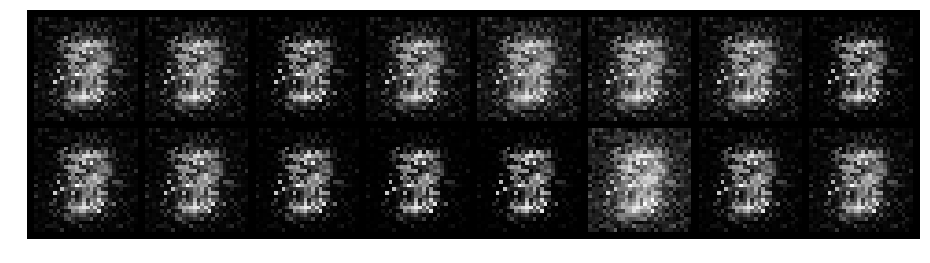

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.1652, Generator Loss: 1.7238
D(x): 0.5967, D(G(z)): 0.3408


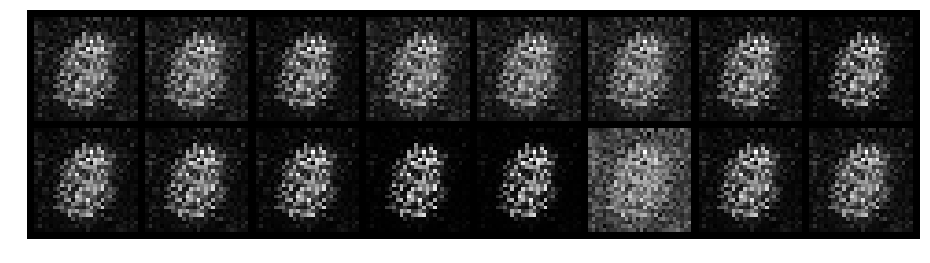

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 1.2511, Generator Loss: 1.1419
D(x): 0.5585, D(G(z)): 0.4115


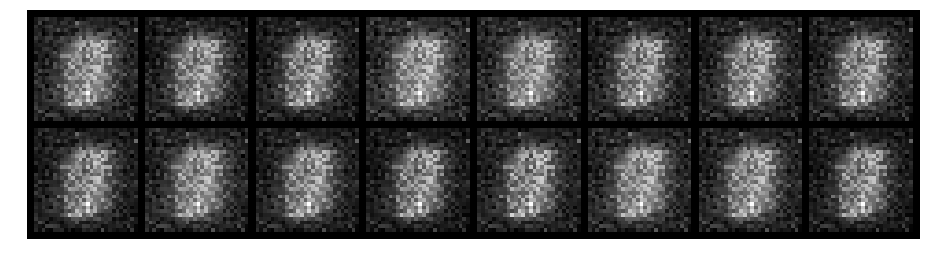

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.5028, Generator Loss: 2.9151
D(x): 0.8378, D(G(z)): 0.2049


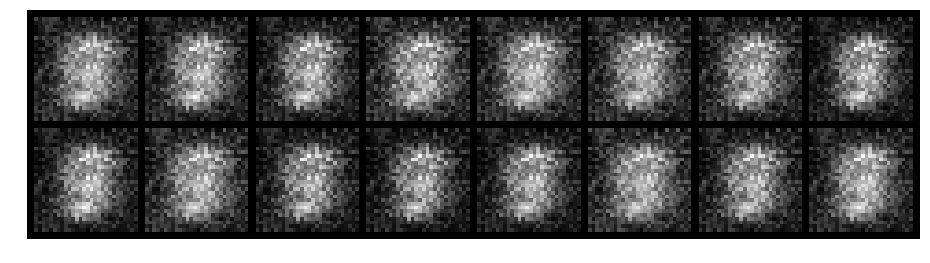

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 1.2250, Generator Loss: 0.6870
D(x): 0.6370, D(G(z)): 0.5241


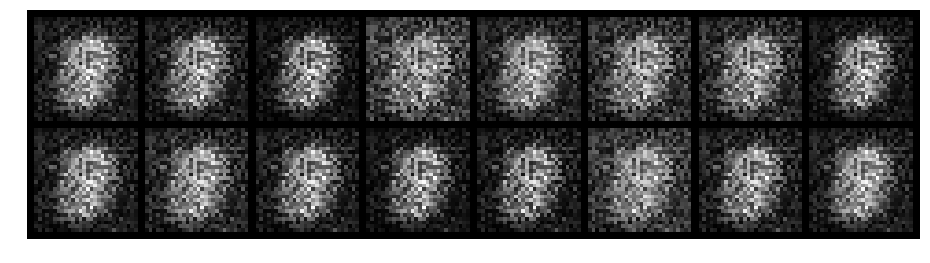

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 1.0499, Generator Loss: 1.4832
D(x): 0.7139, D(G(z)): 0.4365


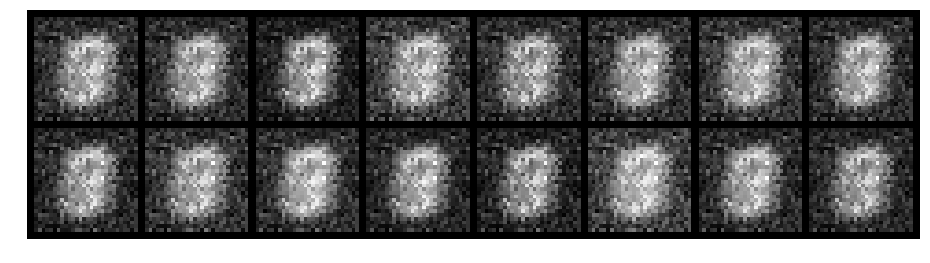

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.2256, Generator Loss: 2.7646
D(x): 0.9691, D(G(z)): 0.1611


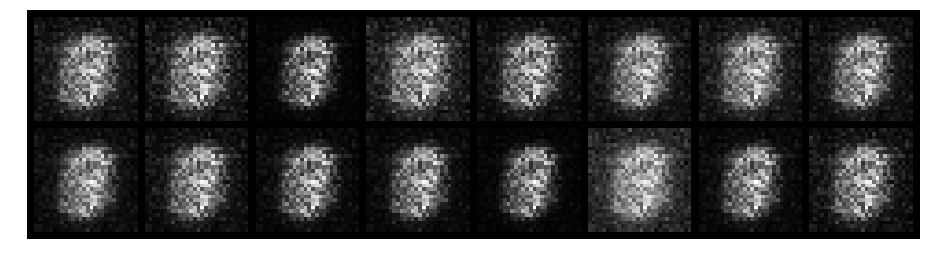

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.2997, Generator Loss: 2.5863
D(x): 0.9164, D(G(z)): 0.1702


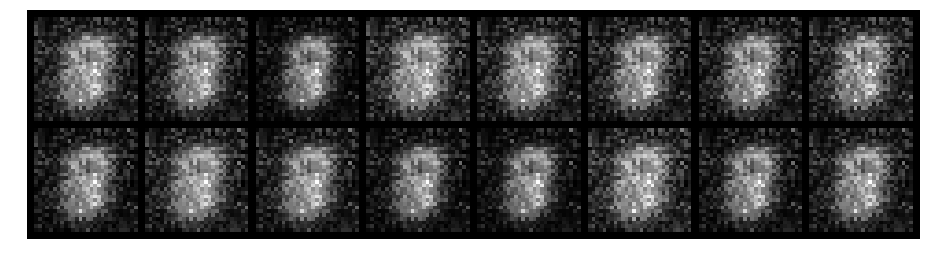

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.3656, Generator Loss: 3.2946
D(x): 0.9627, D(G(z)): 0.2444


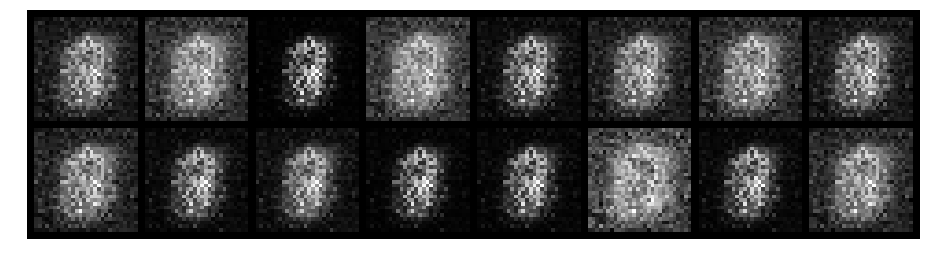

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.5649, Generator Loss: 2.0209
D(x): 0.8814, D(G(z)): 0.2867


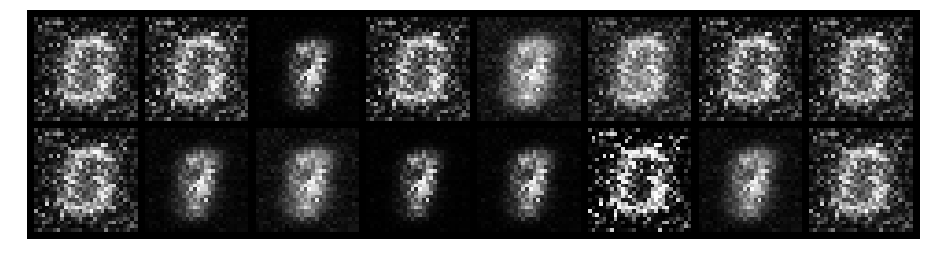

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.7170, Generator Loss: 3.1732
D(x): 0.7682, D(G(z)): 0.2230


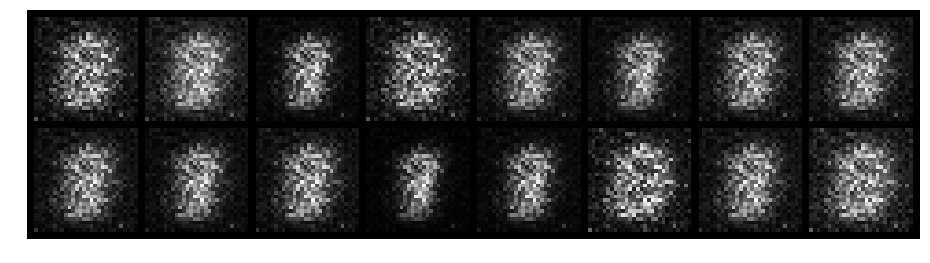

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.2842, Generator Loss: 5.1569
D(x): 0.8620, D(G(z)): 0.0404


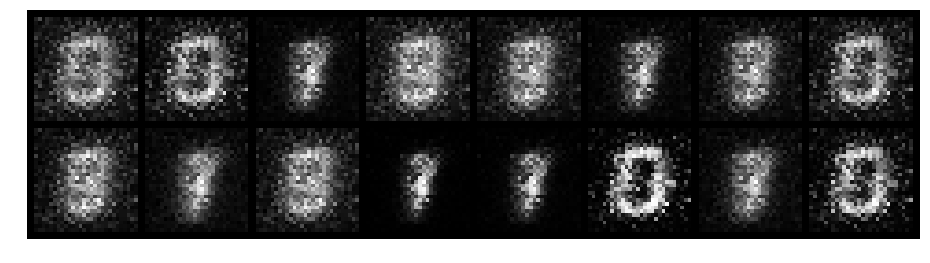

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.7153, Generator Loss: 2.8598
D(x): 0.7504, D(G(z)): 0.1806


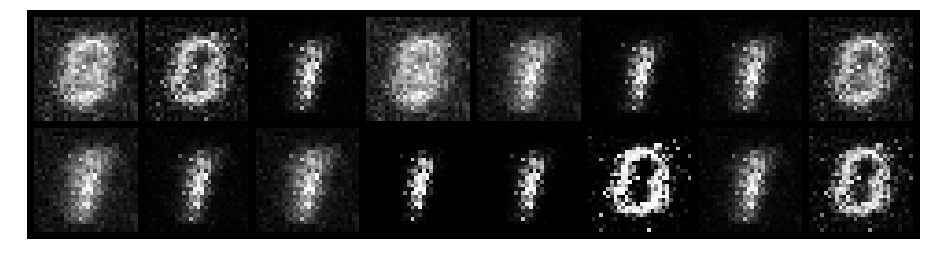

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.5874, Generator Loss: 2.4503
D(x): 0.7948, D(G(z)): 0.1261


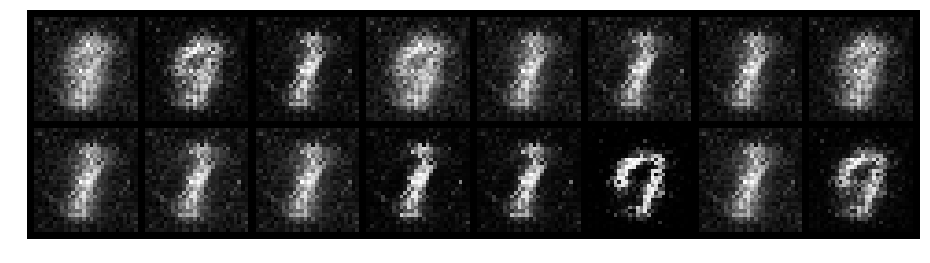

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.1918, Generator Loss: 3.8645
D(x): 0.9239, D(G(z)): 0.0694


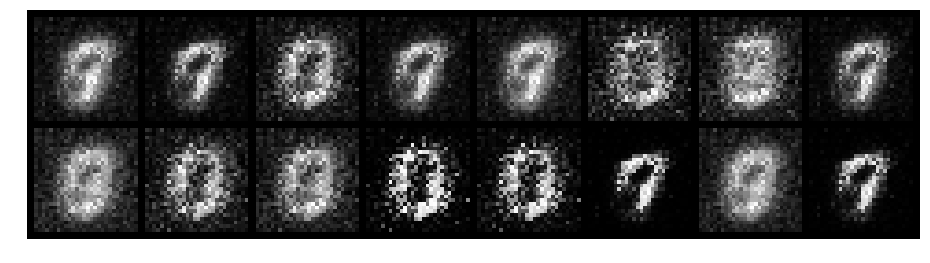

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.4497, Generator Loss: 4.0361
D(x): 0.8548, D(G(z)): 0.0845


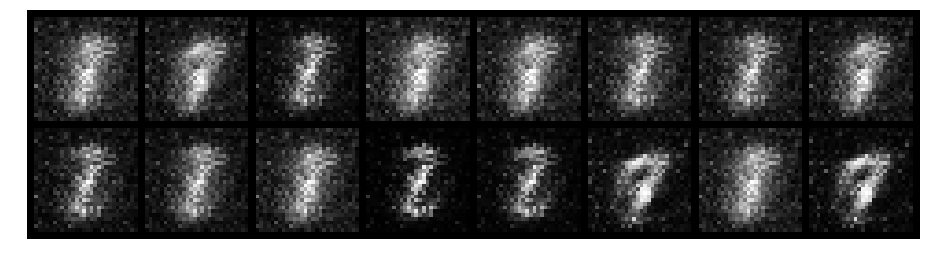

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.4252, Generator Loss: 3.4546
D(x): 0.8600, D(G(z)): 0.0631


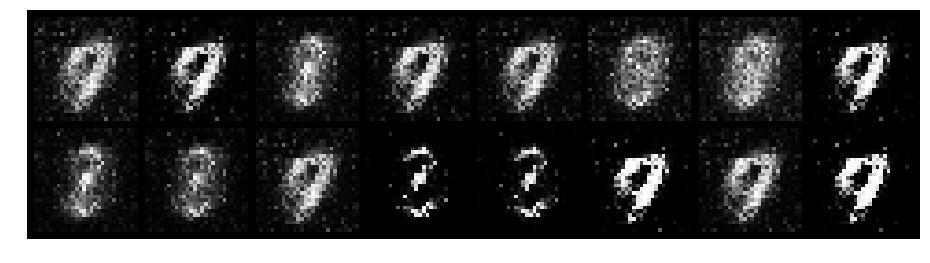

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.1415, Generator Loss: 5.9120
D(x): 0.9584, D(G(z)): 0.0464


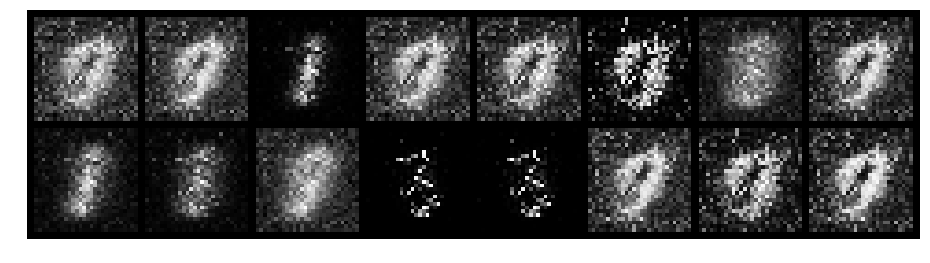

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.1527, Generator Loss: 3.6484
D(x): 0.9568, D(G(z)): 0.0776


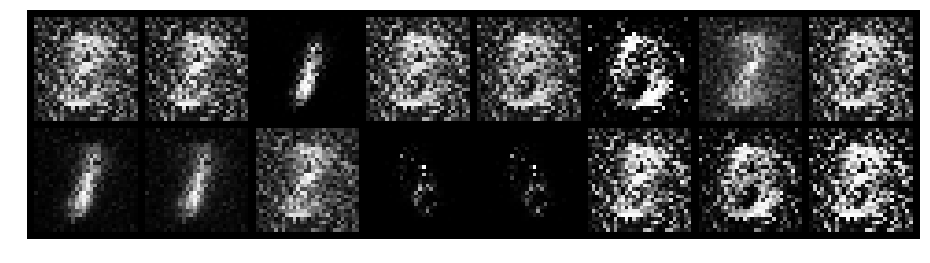

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.6148, Generator Loss: 3.7053
D(x): 0.9034, D(G(z)): 0.2582


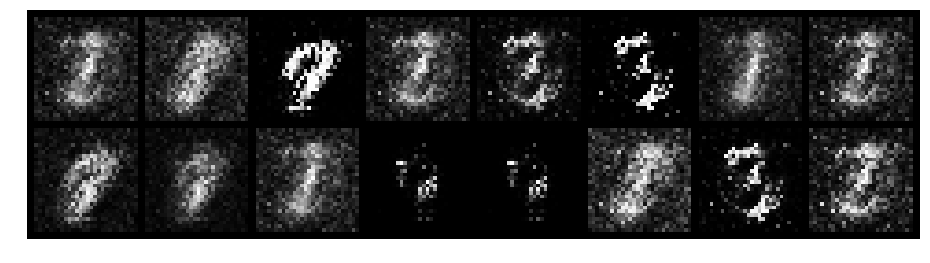

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.6591, Generator Loss: 2.2717
D(x): 0.8923, D(G(z)): 0.2472


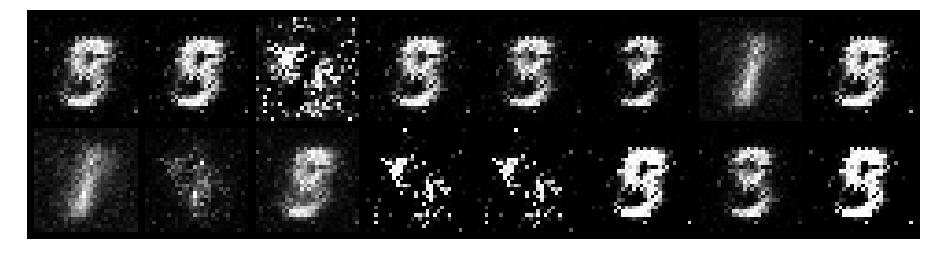

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.4896, Generator Loss: 3.8230
D(x): 0.8363, D(G(z)): 0.1074


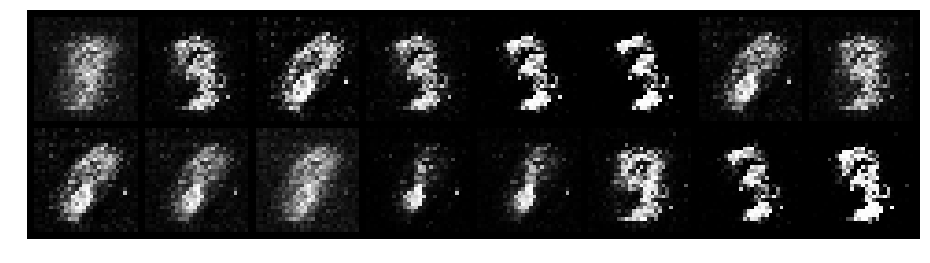

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.4708, Generator Loss: 3.8488
D(x): 0.8538, D(G(z)): 0.0688


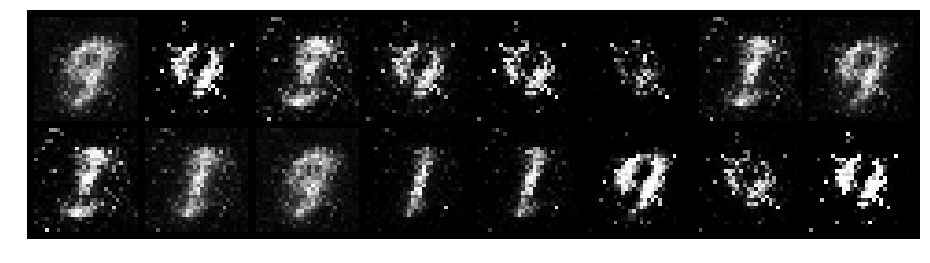

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.4427, Generator Loss: 3.2612
D(x): 0.8838, D(G(z)): 0.1225


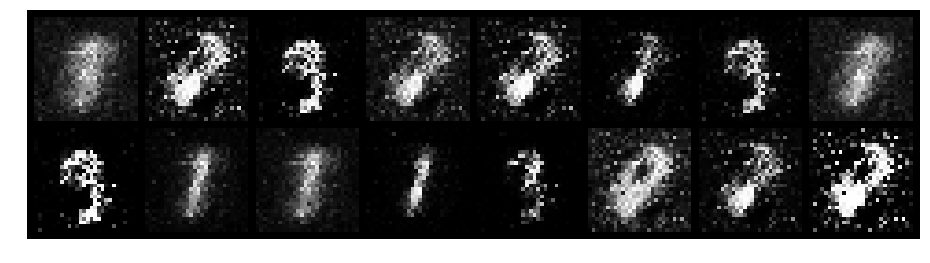

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.5141, Generator Loss: 3.4318
D(x): 0.9343, D(G(z)): 0.2495


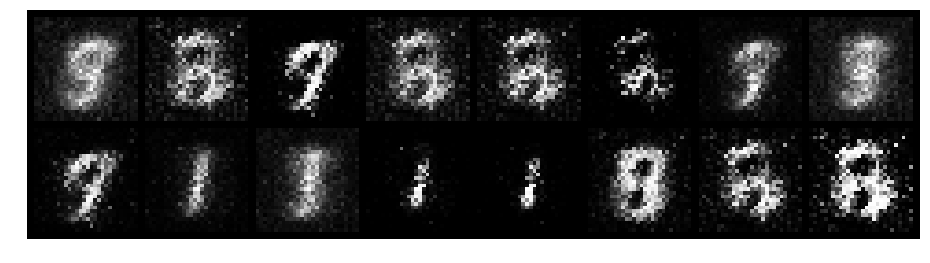

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3854, Generator Loss: 3.7522
D(x): 0.8498, D(G(z)): 0.0654


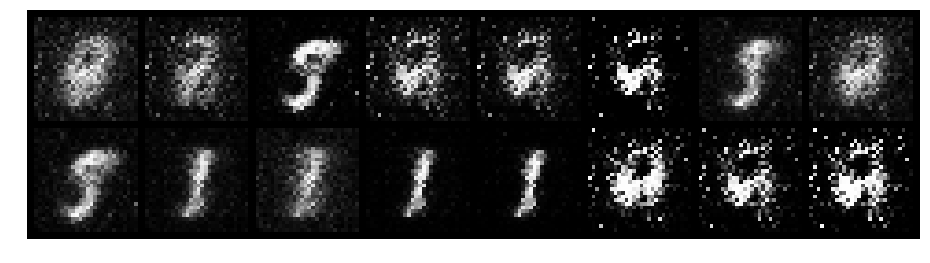

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.4453, Generator Loss: 2.7639
D(x): 0.8714, D(G(z)): 0.1519


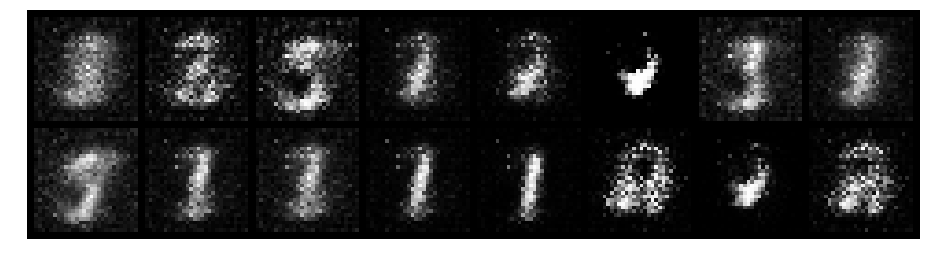

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.2990, Generator Loss: 3.7377
D(x): 0.9540, D(G(z)): 0.1350


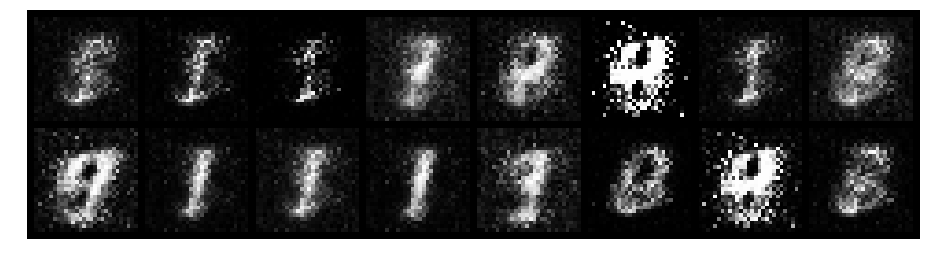

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.5428, Generator Loss: 3.8854
D(x): 0.8179, D(G(z)): 0.1153


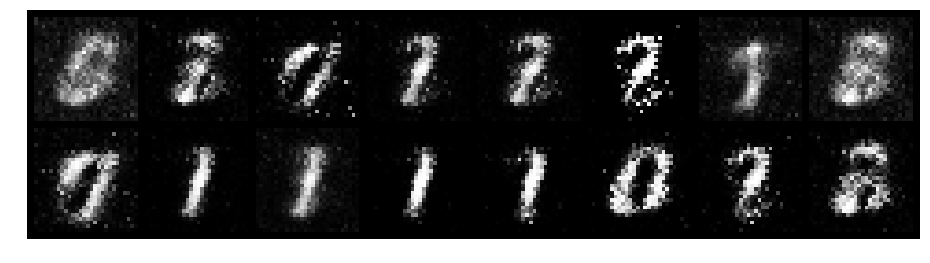

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.4765, Generator Loss: 2.6940
D(x): 0.8678, D(G(z)): 0.1784


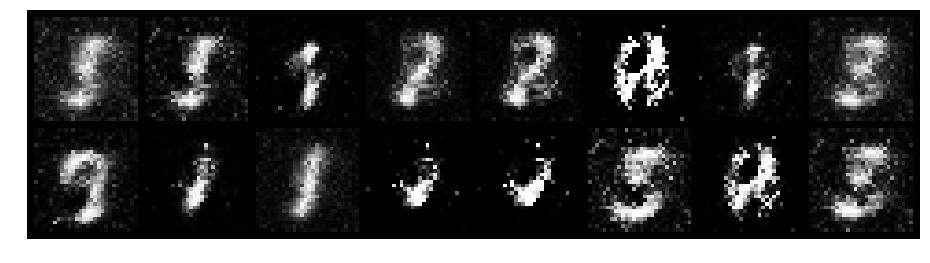

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.2686, Generator Loss: 3.2461
D(x): 0.9189, D(G(z)): 0.0981


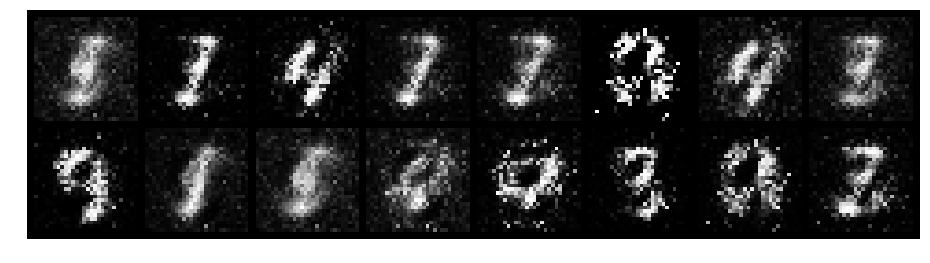

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.4360, Generator Loss: 2.3872
D(x): 0.8732, D(G(z)): 0.1400


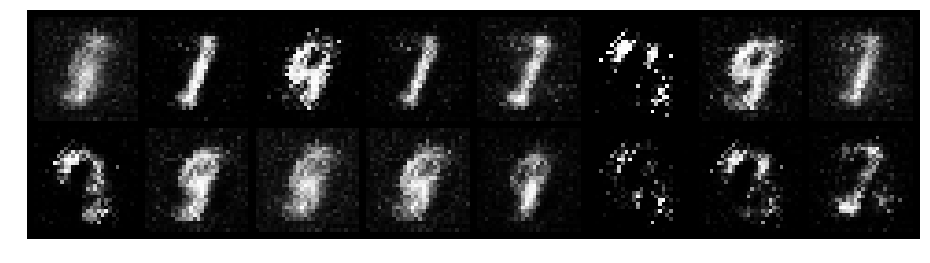

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.5983, Generator Loss: 2.8298
D(x): 0.8593, D(G(z)): 0.2086


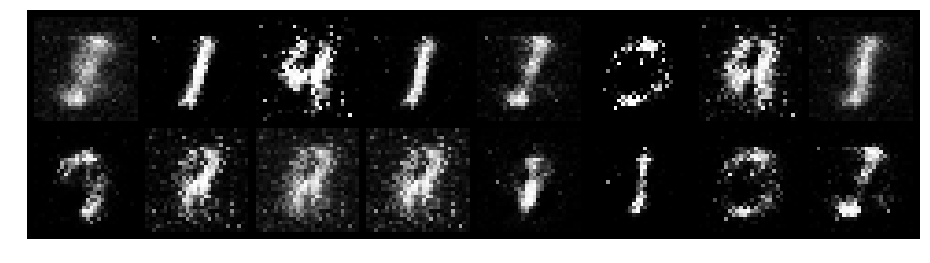

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.3666, Generator Loss: 3.2163
D(x): 0.9070, D(G(z)): 0.1473


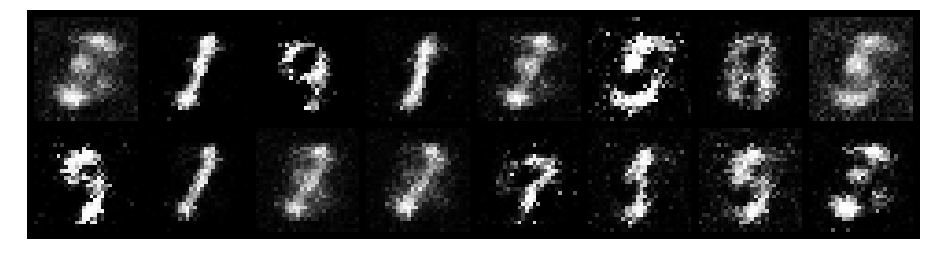

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.4344, Generator Loss: 3.0989
D(x): 0.8489, D(G(z)): 0.1234


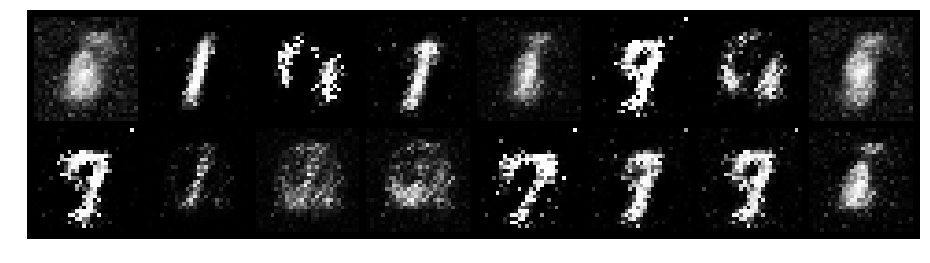

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.4192, Generator Loss: 2.4899
D(x): 0.8830, D(G(z)): 0.1485


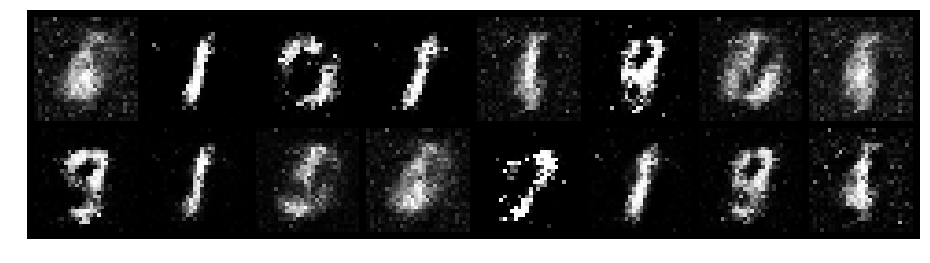

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.3585, Generator Loss: 2.9864
D(x): 0.9152, D(G(z)): 0.1600


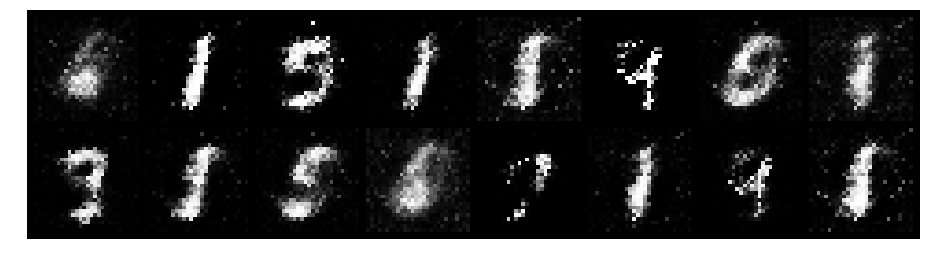

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.6616, Generator Loss: 2.4680
D(x): 0.7832, D(G(z)): 0.1202


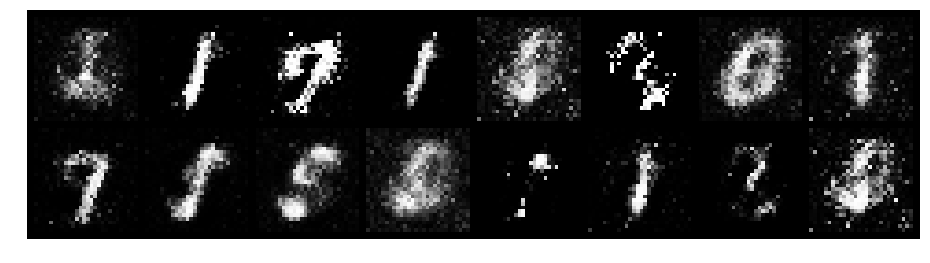

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.3963, Generator Loss: 3.9680
D(x): 0.8515, D(G(z)): 0.0831


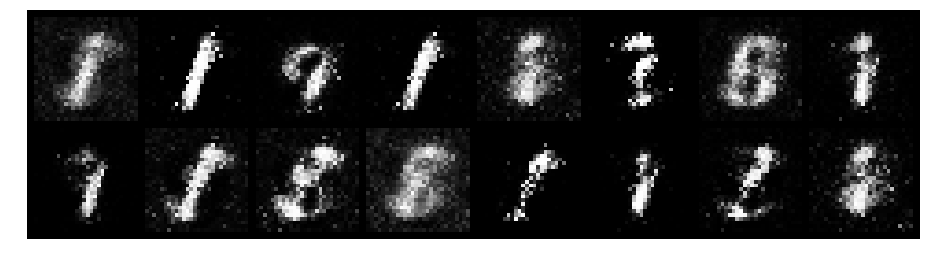

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.4138, Generator Loss: 3.3709
D(x): 0.8439, D(G(z)): 0.1003


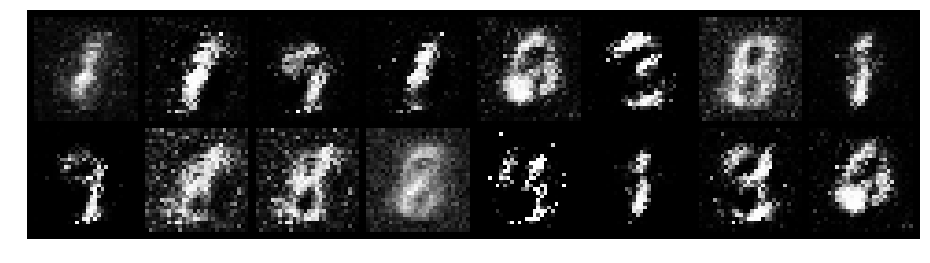

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.4716, Generator Loss: 2.4890
D(x): 0.8508, D(G(z)): 0.1740


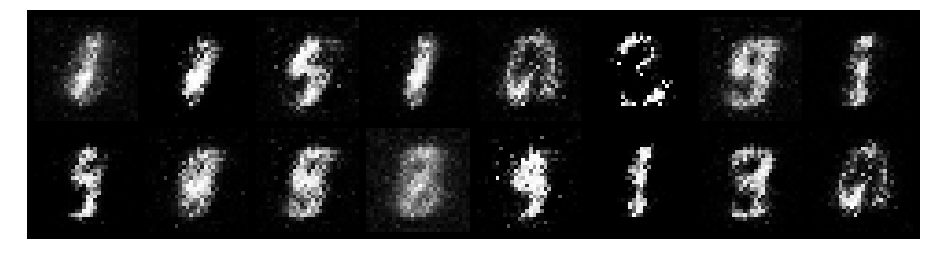

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.6143, Generator Loss: 1.9296
D(x): 0.7749, D(G(z)): 0.1566


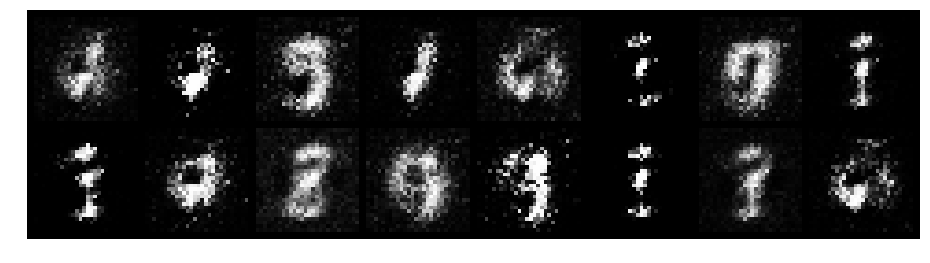

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.5364, Generator Loss: 2.6298
D(x): 0.8153, D(G(z)): 0.1595


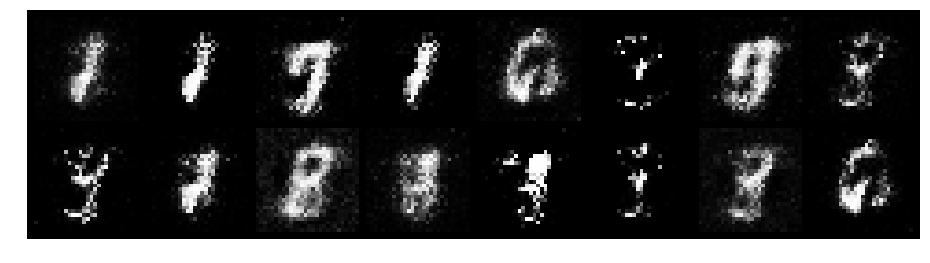

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.3291, Generator Loss: 2.9744
D(x): 0.9083, D(G(z)): 0.1387


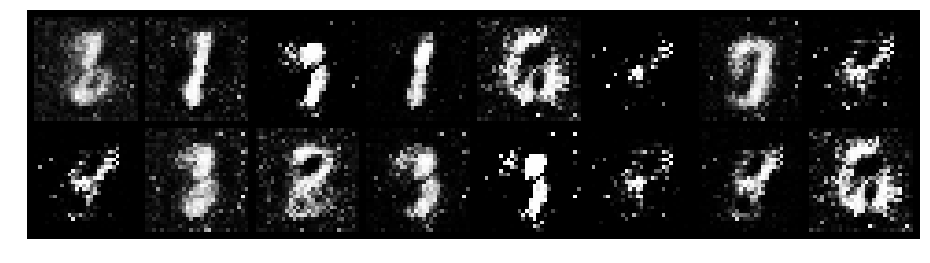

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.3104, Generator Loss: 2.8650
D(x): 0.9177, D(G(z)): 0.1573


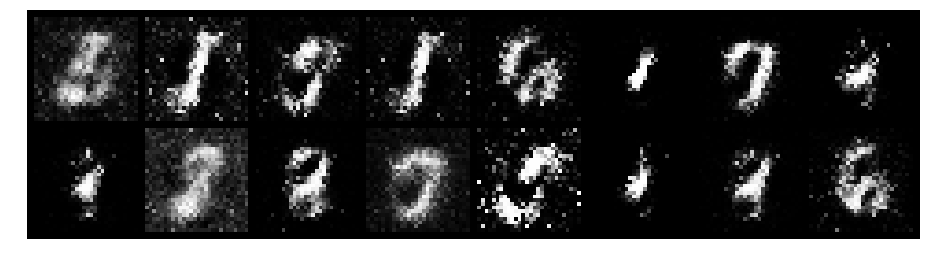

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.7598, Generator Loss: 2.9093
D(x): 0.8137, D(G(z)): 0.2084


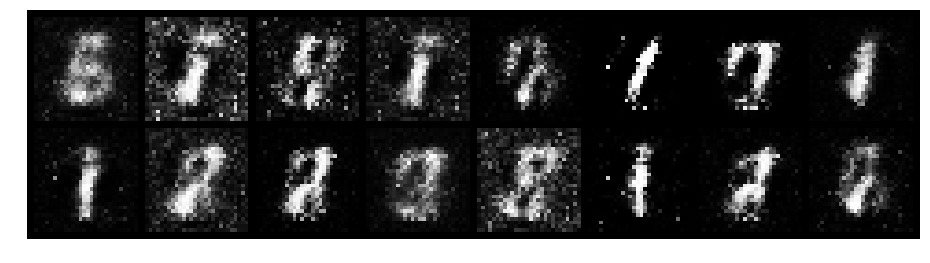

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5300, Generator Loss: 2.4359
D(x): 0.7776, D(G(z)): 0.0843


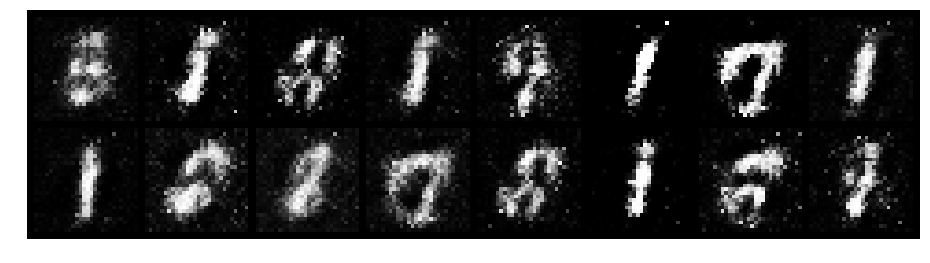

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7122, Generator Loss: 2.6655
D(x): 0.7593, D(G(z)): 0.1797


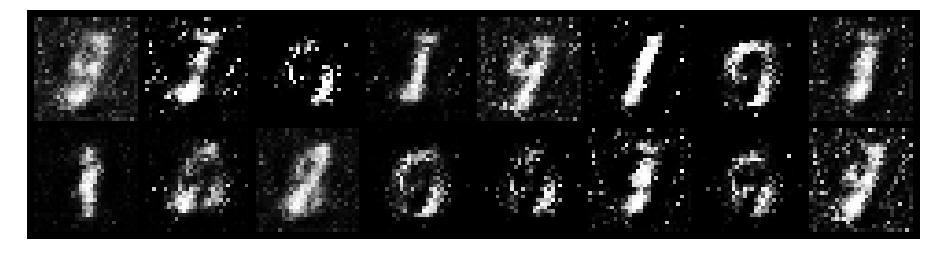

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.3724, Generator Loss: 2.6031
D(x): 0.8441, D(G(z)): 0.1200


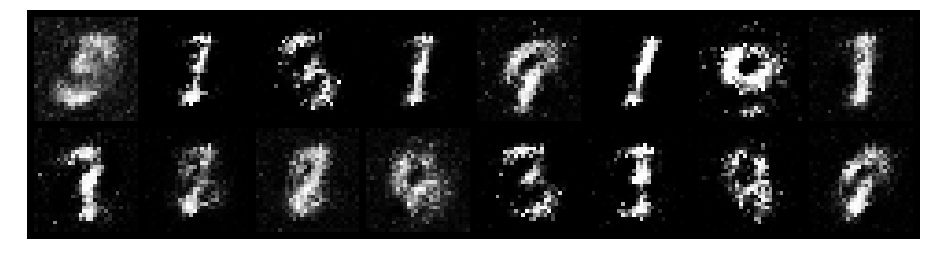

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.6978, Generator Loss: 2.3549
D(x): 0.7507, D(G(z)): 0.2133


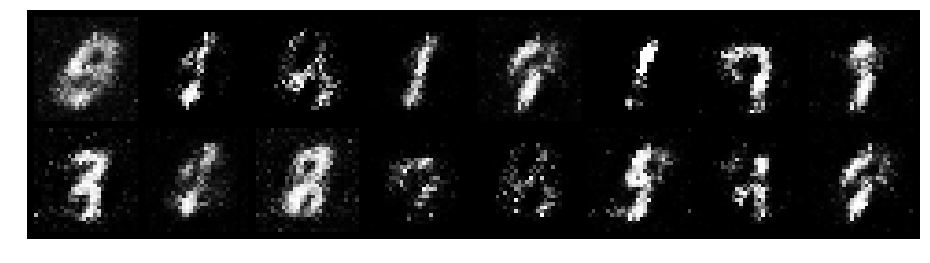

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.4965, Generator Loss: 3.5759
D(x): 0.8405, D(G(z)): 0.1356


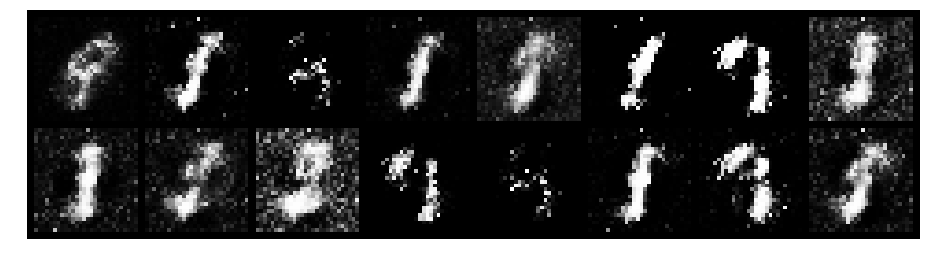

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.5293, Generator Loss: 2.8743
D(x): 0.8363, D(G(z)): 0.1704


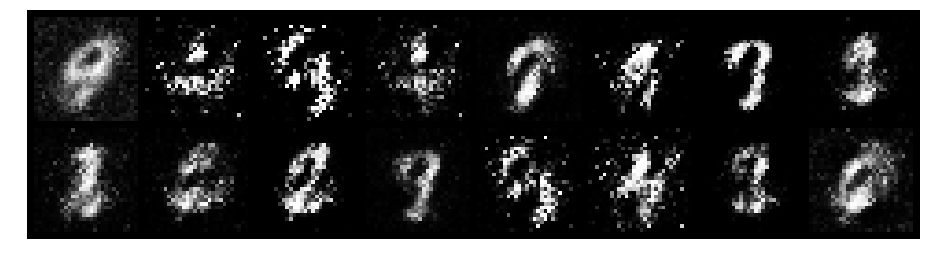

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.7713, Generator Loss: 2.9429
D(x): 0.8219, D(G(z)): 0.2557


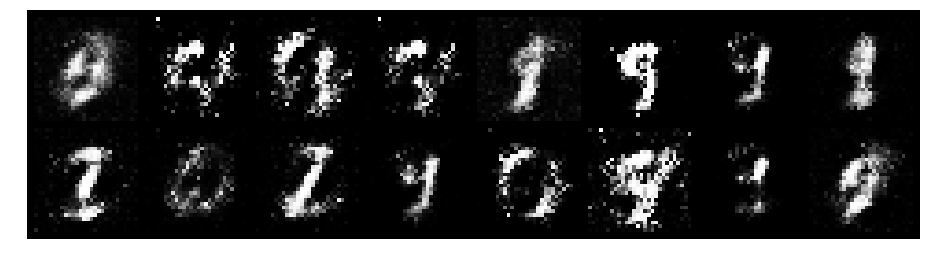

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.6287, Generator Loss: 2.0706
D(x): 0.7746, D(G(z)): 0.1709


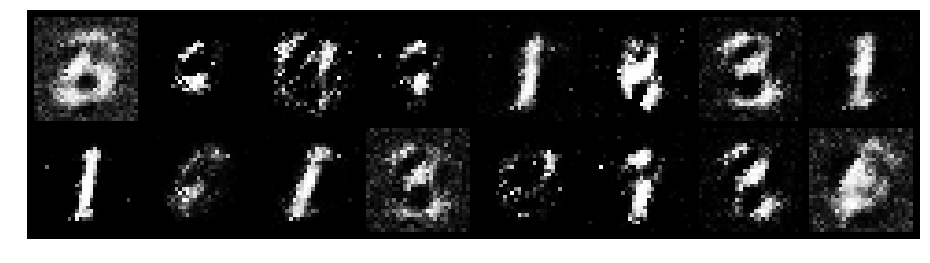

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.6631, Generator Loss: 2.0855
D(x): 0.7581, D(G(z)): 0.1875


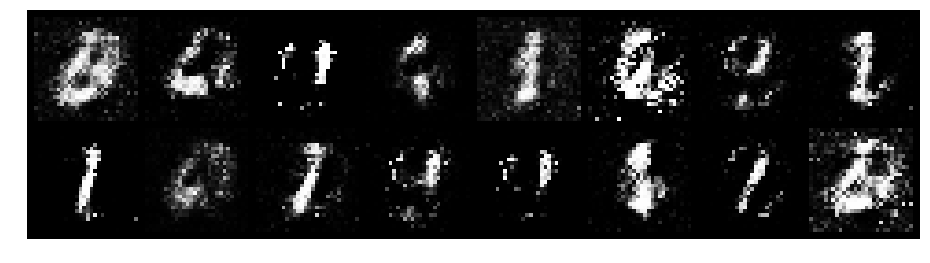

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.5007, Generator Loss: 3.0462
D(x): 0.7929, D(G(z)): 0.0914


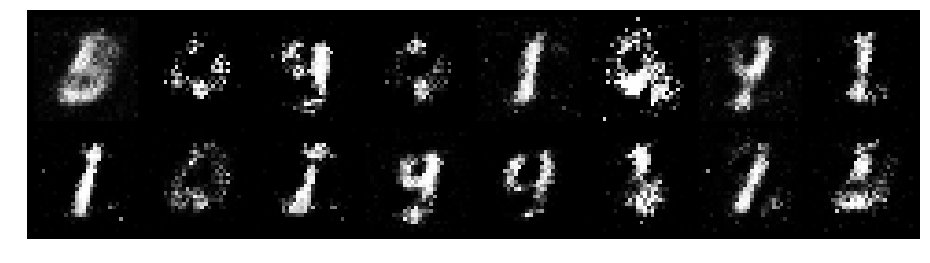

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.5771, Generator Loss: 2.4236
D(x): 0.9195, D(G(z)): 0.2474


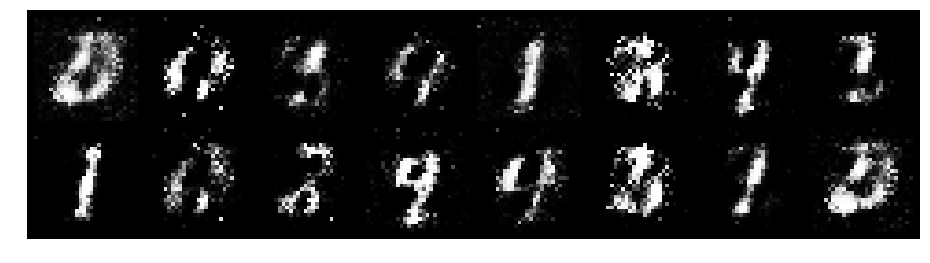

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.6087, Generator Loss: 3.0954
D(x): 0.7887, D(G(z)): 0.1937


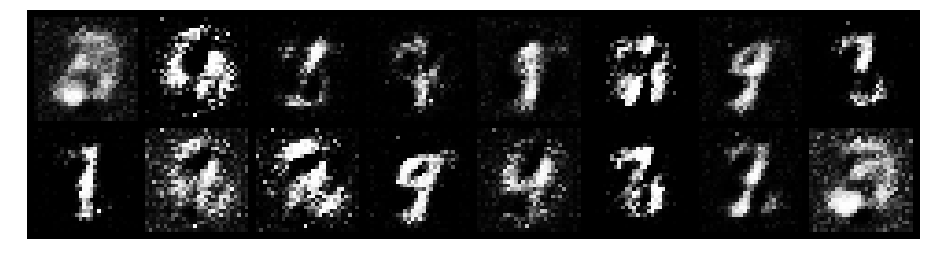

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.6706, Generator Loss: 2.1734
D(x): 0.8284, D(G(z)): 0.2529


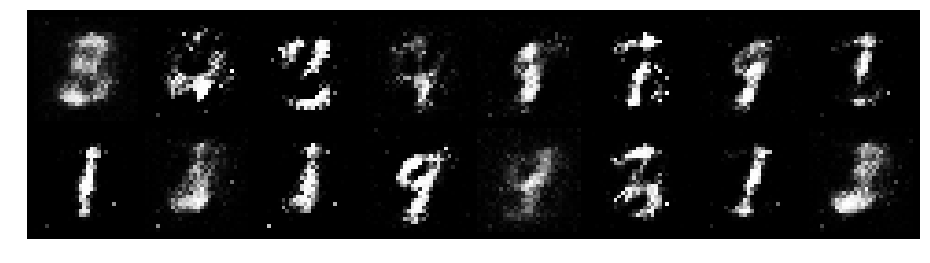

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.7168, Generator Loss: 1.8572
D(x): 0.8100, D(G(z)): 0.2608


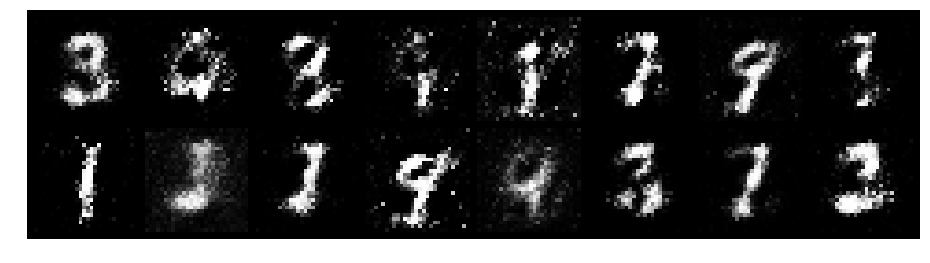

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.7206, Generator Loss: 2.5503
D(x): 0.8274, D(G(z)): 0.2625


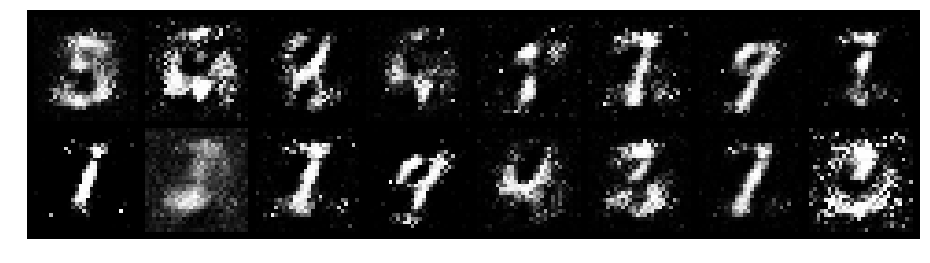

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.7795, Generator Loss: 2.5397
D(x): 0.8475, D(G(z)): 0.2851


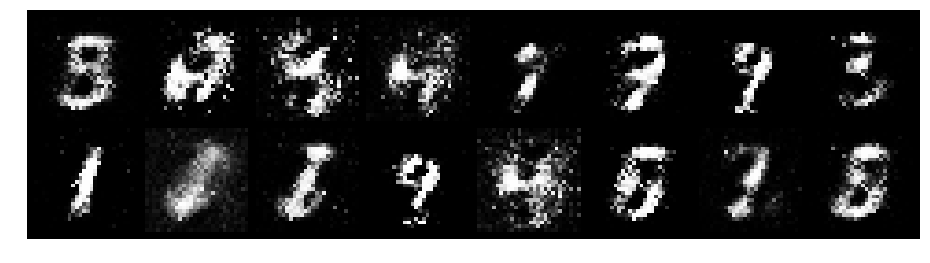

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.8440, Generator Loss: 1.8384
D(x): 0.8353, D(G(z)): 0.3233


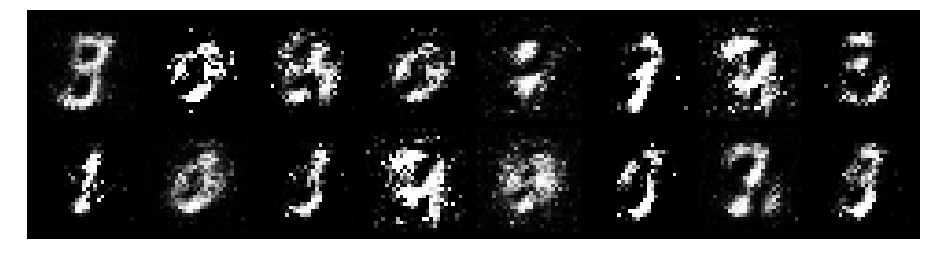

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 1.1362, Generator Loss: 2.5560
D(x): 0.5553, D(G(z)): 0.1552


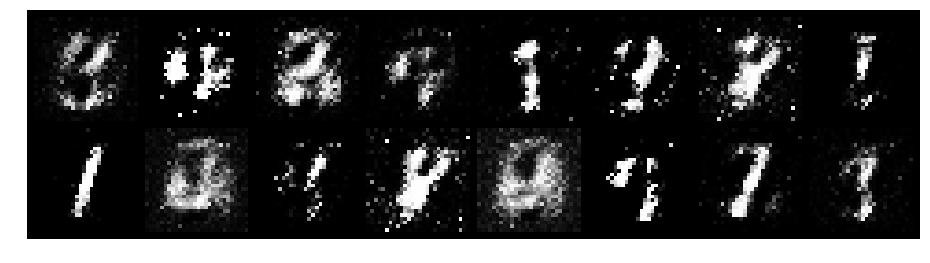

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.5707, Generator Loss: 2.3424
D(x): 0.8308, D(G(z)): 0.2156


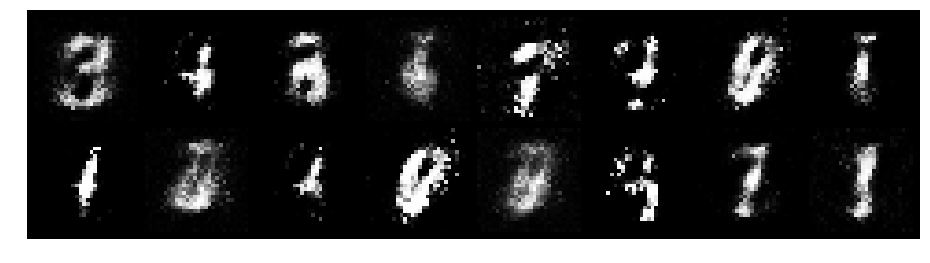

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.6233, Generator Loss: 2.8401
D(x): 0.8481, D(G(z)): 0.2437


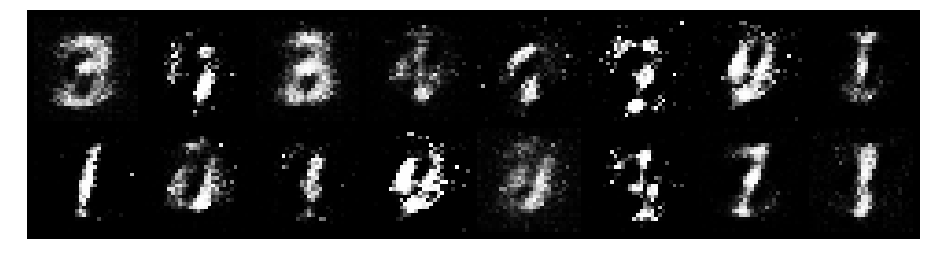

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.5145, Generator Loss: 2.1061
D(x): 0.8496, D(G(z)): 0.1848


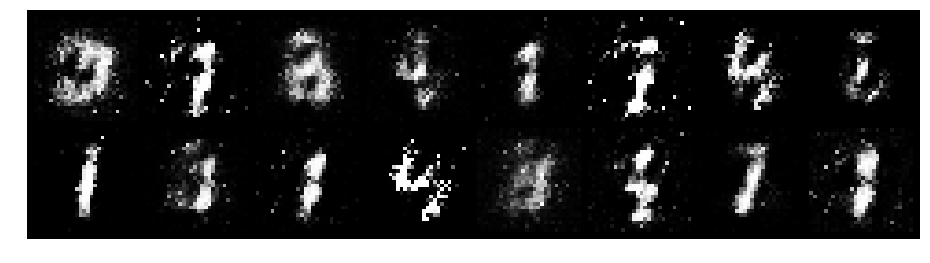

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.6116, Generator Loss: 2.2861
D(x): 0.7981, D(G(z)): 0.1736


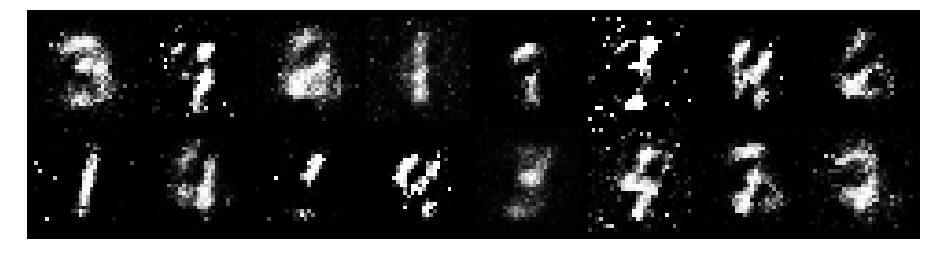

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 1.2099, Generator Loss: 2.5891
D(x): 0.6273, D(G(z)): 0.1872


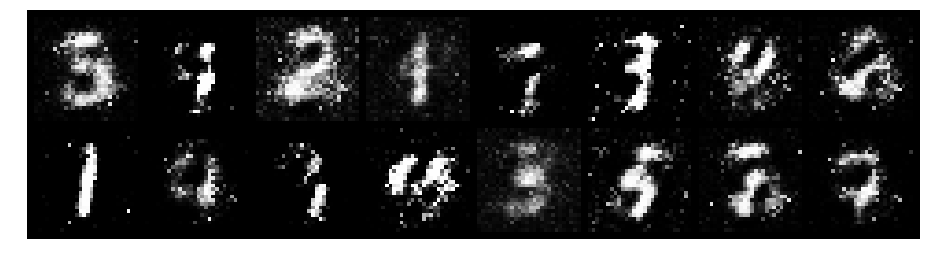

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.7019, Generator Loss: 2.5921
D(x): 0.7236, D(G(z)): 0.1613


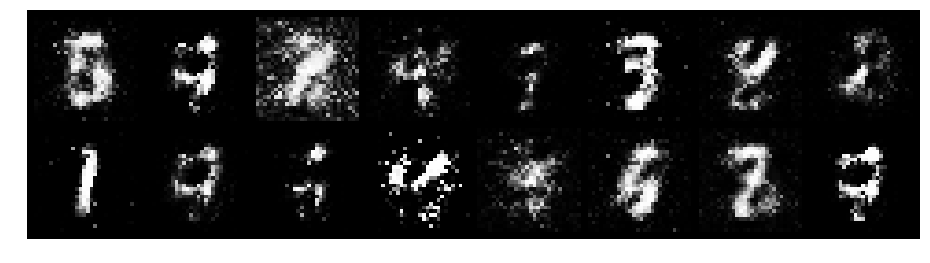

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.5134, Generator Loss: 2.0982
D(x): 0.8458, D(G(z)): 0.2006


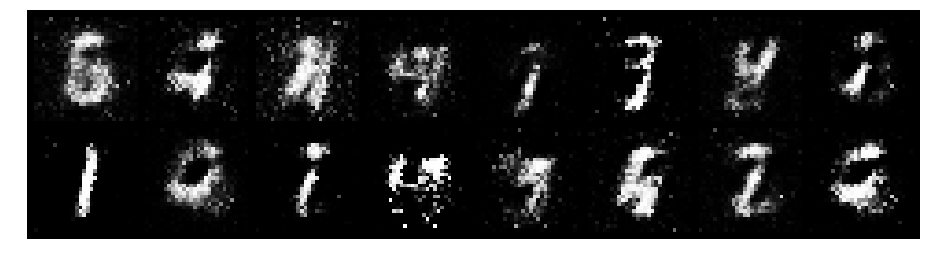

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.4638, Generator Loss: 2.5846
D(x): 0.8555, D(G(z)): 0.1554


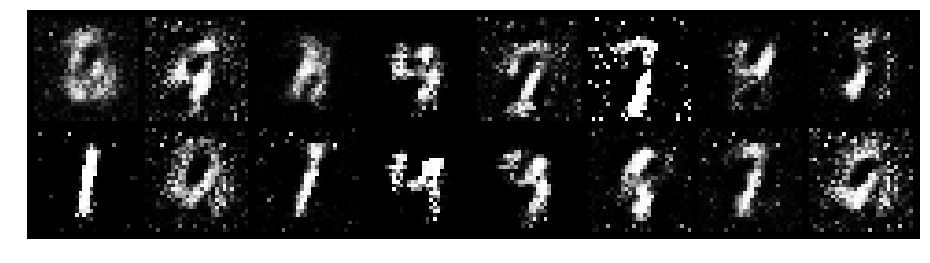

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.5536, Generator Loss: 2.6576
D(x): 0.8902, D(G(z)): 0.2577


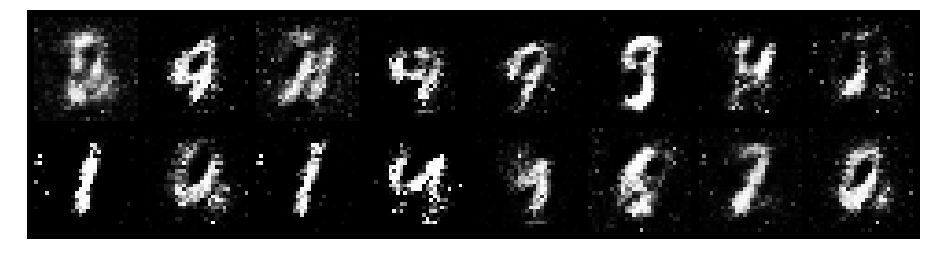

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.6819, Generator Loss: 1.8325
D(x): 0.7753, D(G(z)): 0.2262


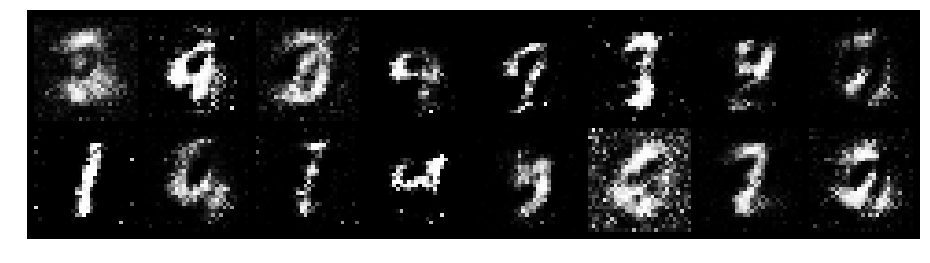

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.7716, Generator Loss: 1.7977
D(x): 0.7843, D(G(z)): 0.2713


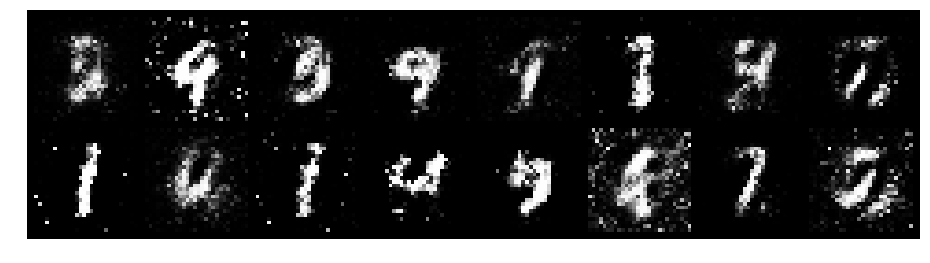

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.5904, Generator Loss: 2.5945
D(x): 0.7688, D(G(z)): 0.1762


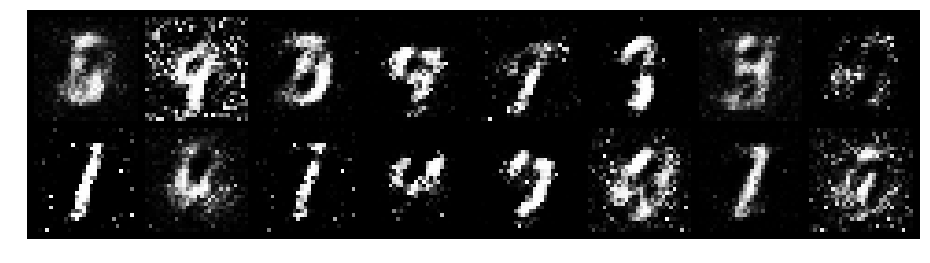

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.6238, Generator Loss: 1.9424
D(x): 0.7907, D(G(z)): 0.2374


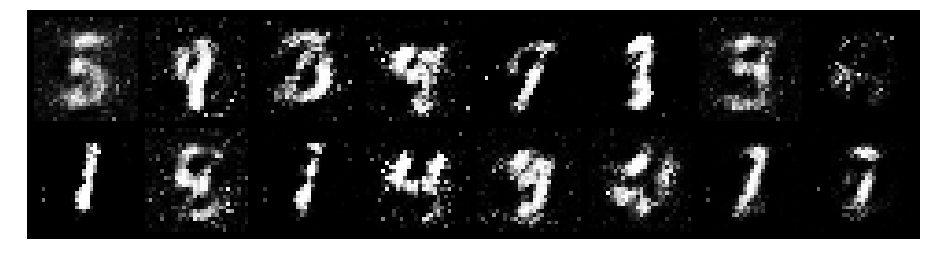

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.8177, Generator Loss: 2.3643
D(x): 0.7414, D(G(z)): 0.2286


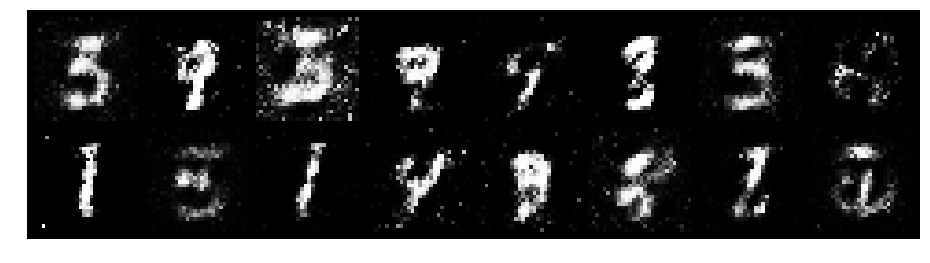

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.9183, Generator Loss: 2.4026
D(x): 0.8184, D(G(z)): 0.3253


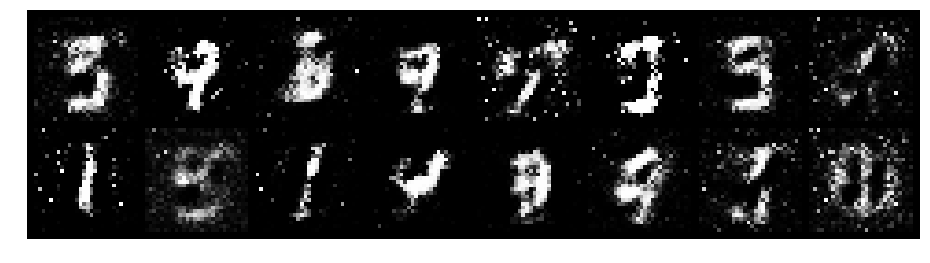

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.5385, Generator Loss: 2.7457
D(x): 0.8199, D(G(z)): 0.1905


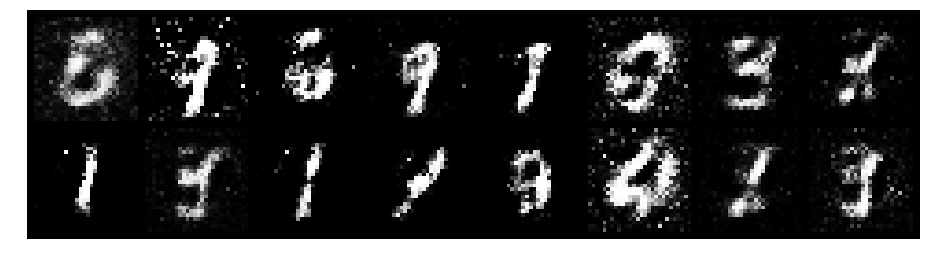

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.9530, Generator Loss: 1.8023
D(x): 0.7752, D(G(z)): 0.3534


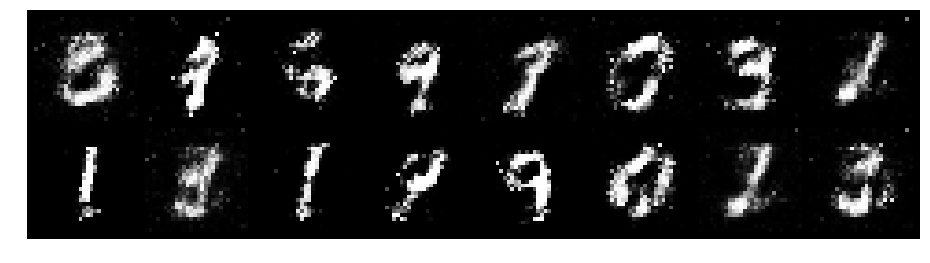

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.6350, Generator Loss: 2.1059
D(x): 0.7587, D(G(z)): 0.1850


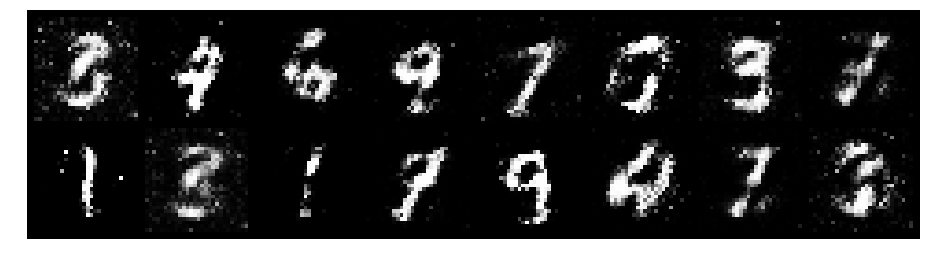

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.7897, Generator Loss: 1.6529
D(x): 0.7940, D(G(z)): 0.3082


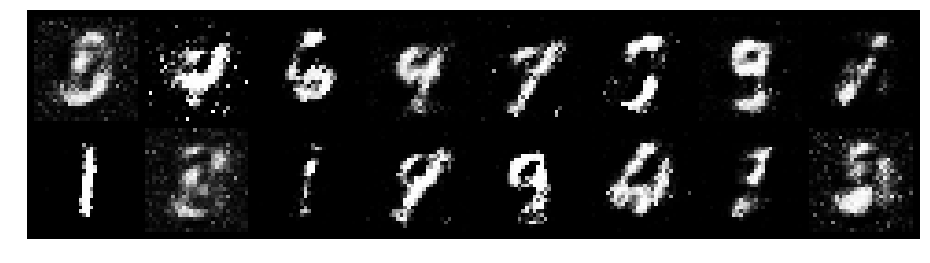

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.6845, Generator Loss: 2.4732
D(x): 0.7973, D(G(z)): 0.2182


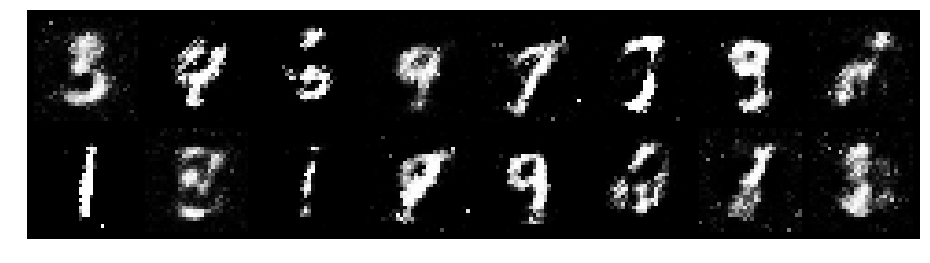

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.8602, Generator Loss: 1.5263
D(x): 0.7598, D(G(z)): 0.3020


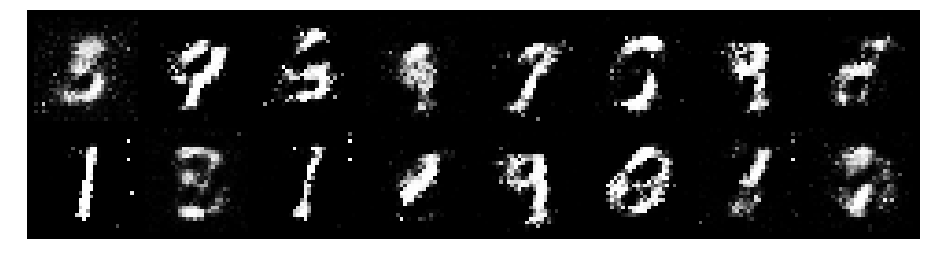

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.8447, Generator Loss: 1.5731
D(x): 0.7167, D(G(z)): 0.2377


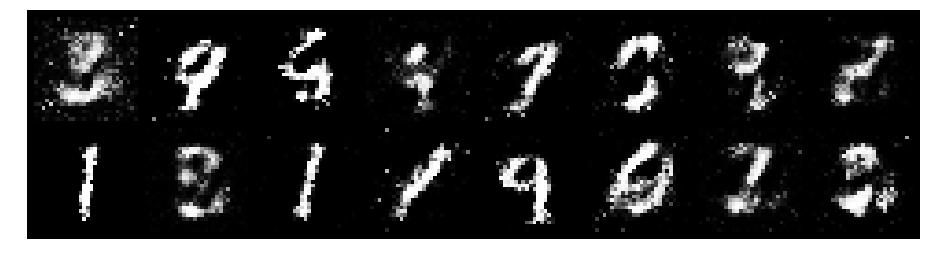

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.9710, Generator Loss: 1.9067
D(x): 0.6868, D(G(z)): 0.2921


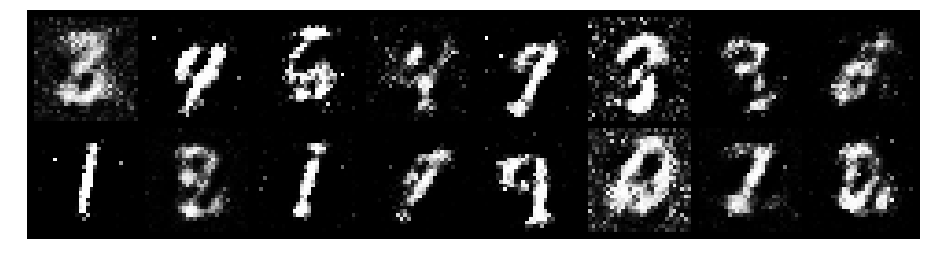

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.8197, Generator Loss: 2.0611
D(x): 0.7316, D(G(z)): 0.2431


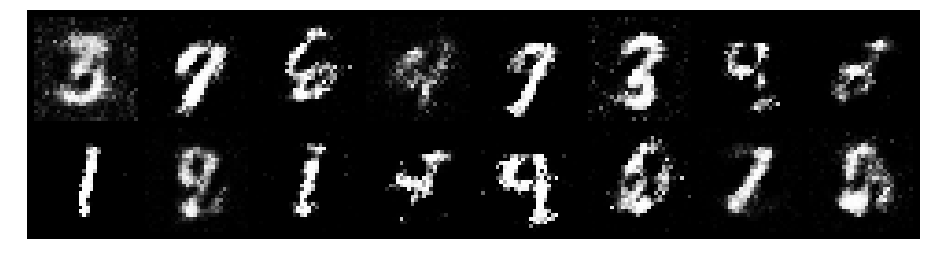

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.9675, Generator Loss: 1.3760
D(x): 0.8265, D(G(z)): 0.4248


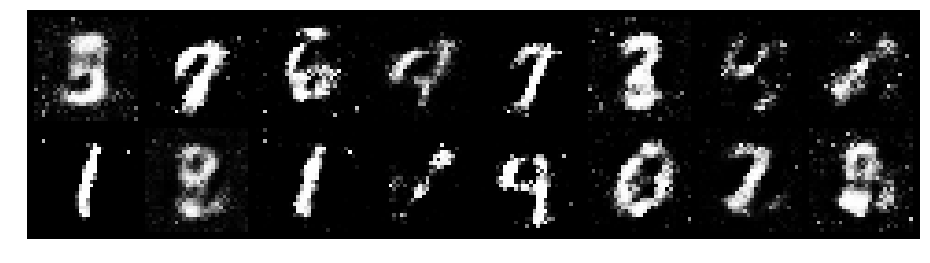

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.9254, Generator Loss: 1.9300
D(x): 0.7645, D(G(z)): 0.3226


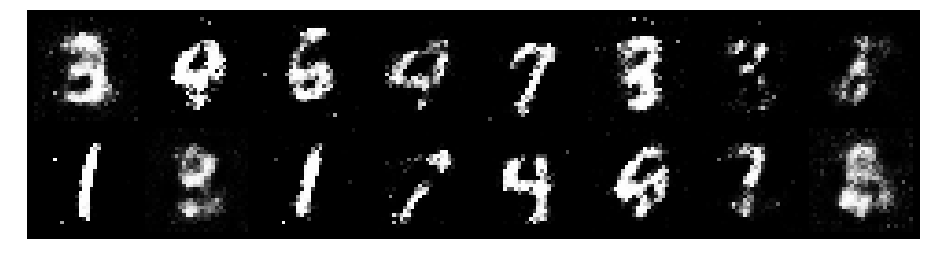

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.7789, Generator Loss: 2.1542
D(x): 0.7766, D(G(z)): 0.2833


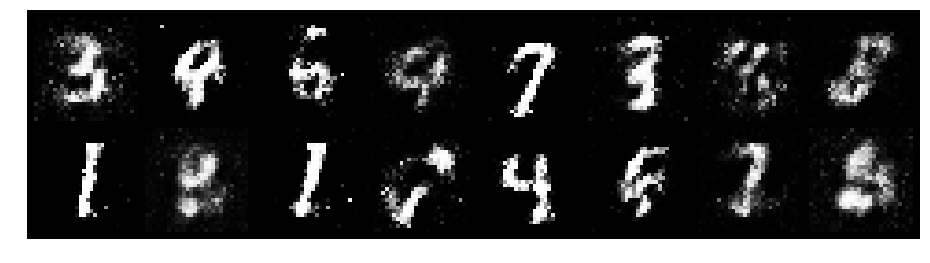

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.8266, Generator Loss: 2.2490
D(x): 0.7106, D(G(z)): 0.2132


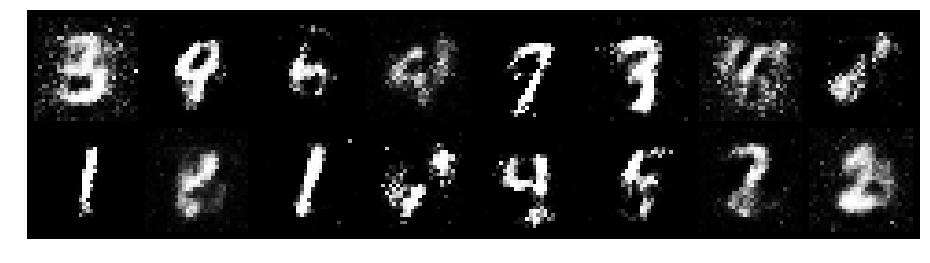

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.7829, Generator Loss: 1.9640
D(x): 0.7335, D(G(z)): 0.2691


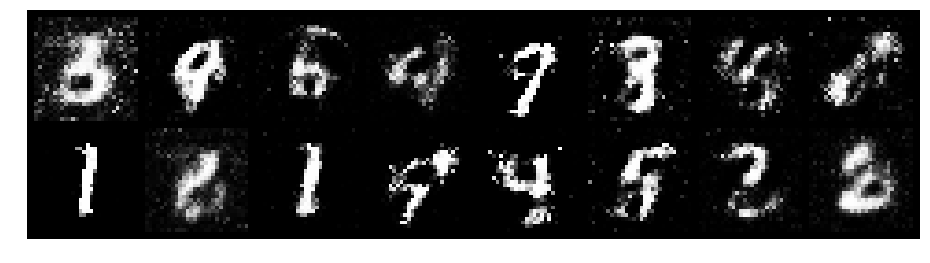

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.5519, Generator Loss: 2.0462
D(x): 0.8353, D(G(z)): 0.2304


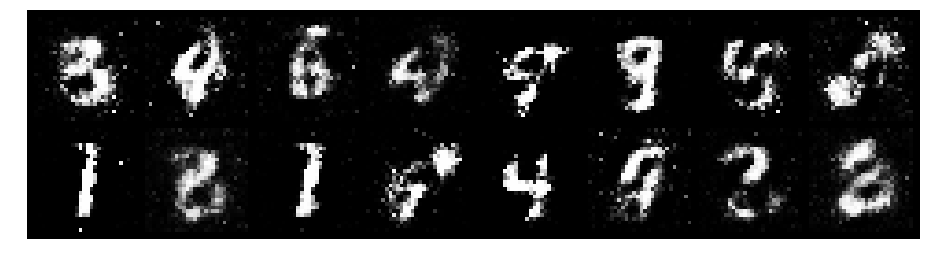

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.6847, Generator Loss: 2.2270
D(x): 0.7125, D(G(z)): 0.1531


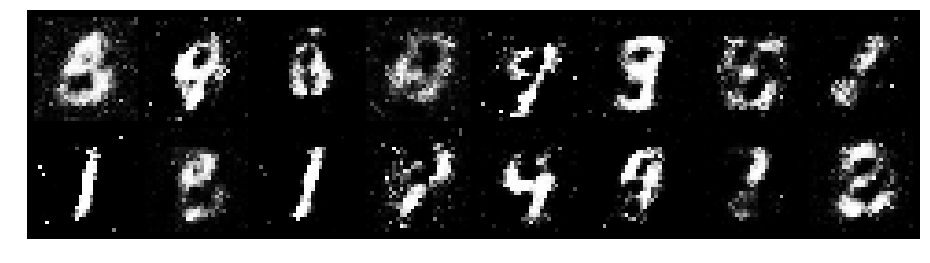

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.7554, Generator Loss: 1.9276
D(x): 0.7664, D(G(z)): 0.2493


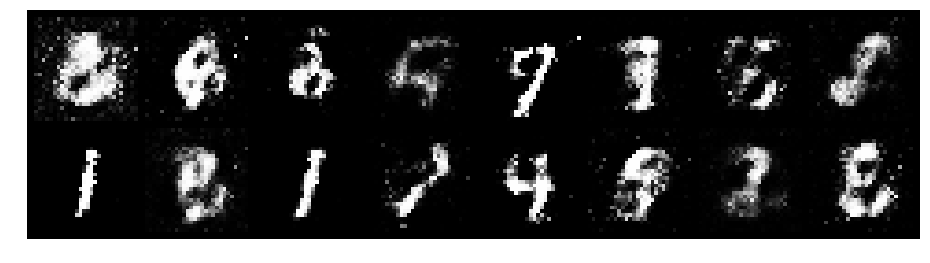

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.8028, Generator Loss: 1.9262
D(x): 0.8510, D(G(z)): 0.3570


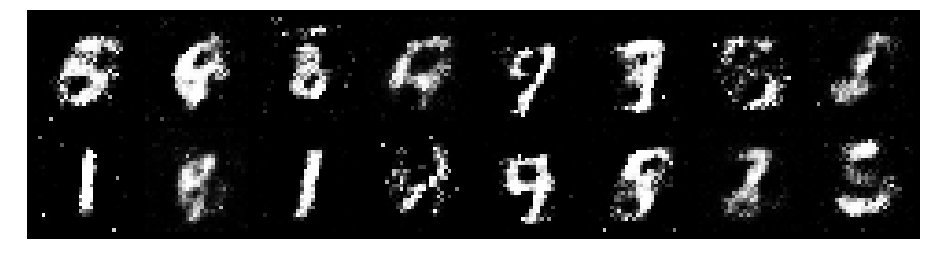

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.6259, Generator Loss: 2.3496
D(x): 0.8404, D(G(z)): 0.2612


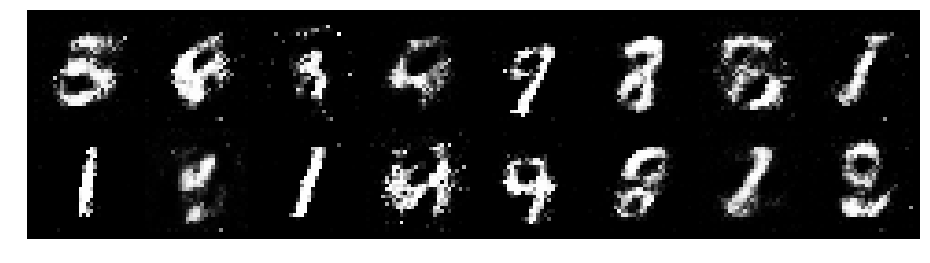

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.7302, Generator Loss: 1.9609
D(x): 0.7867, D(G(z)): 0.2960


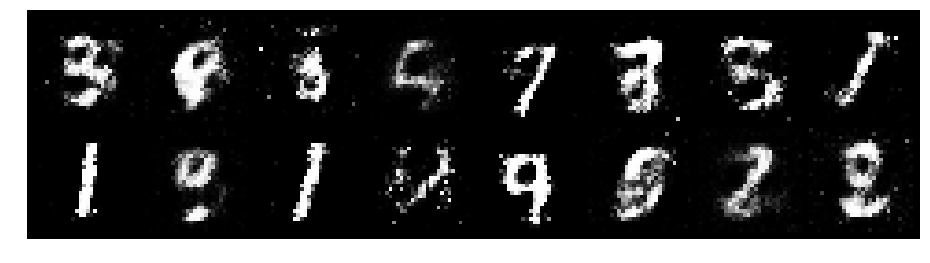

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.8131, Generator Loss: 1.9488
D(x): 0.7828, D(G(z)): 0.2806


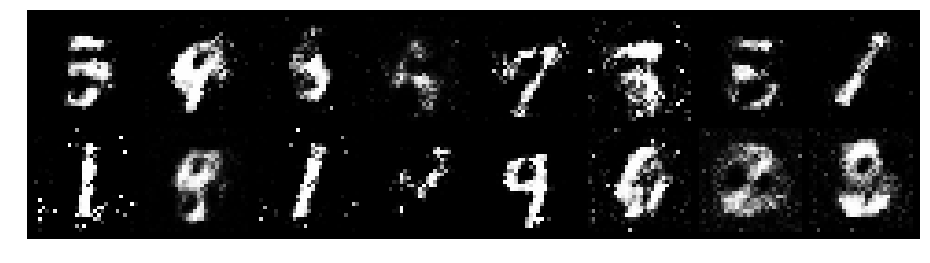

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.6136, Generator Loss: 1.7257
D(x): 0.8447, D(G(z)): 0.2394


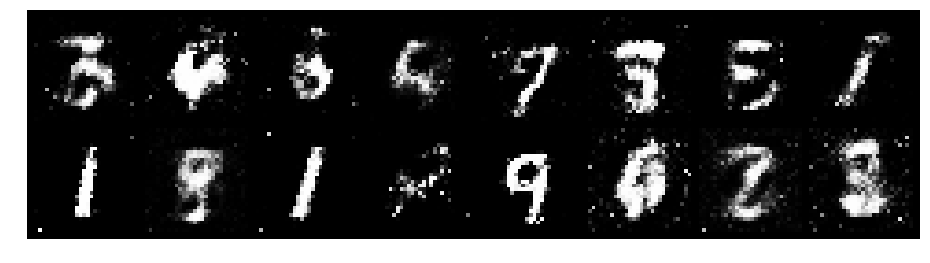

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.5593, Generator Loss: 2.3796
D(x): 0.7527, D(G(z)): 0.1124


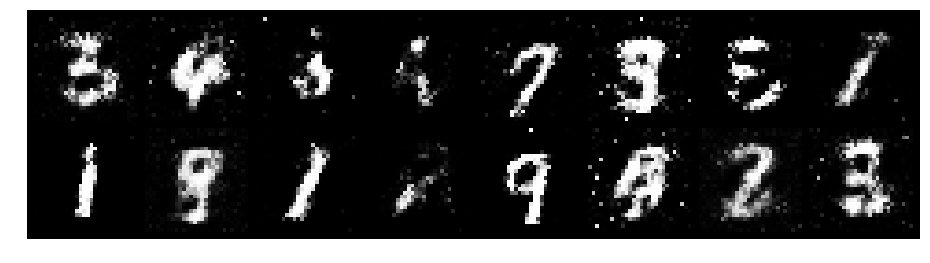

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.8063, Generator Loss: 1.3848
D(x): 0.7427, D(G(z)): 0.2968


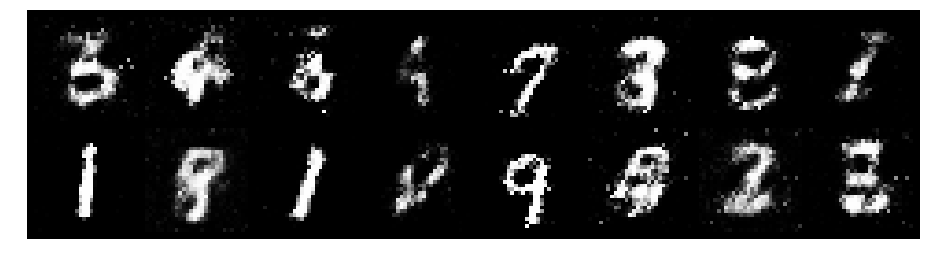

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8624, Generator Loss: 1.8379
D(x): 0.7215, D(G(z)): 0.3072


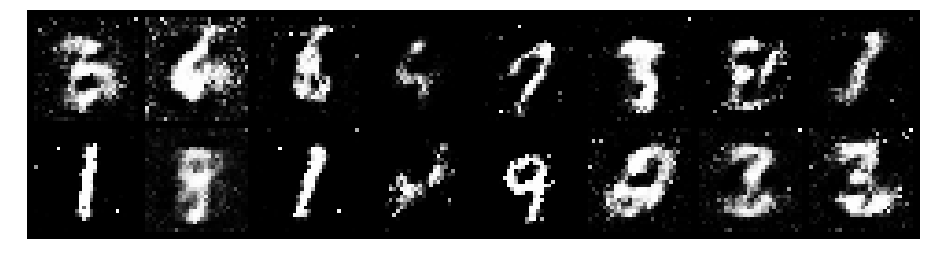

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.6949, Generator Loss: 1.7959
D(x): 0.8083, D(G(z)): 0.2827


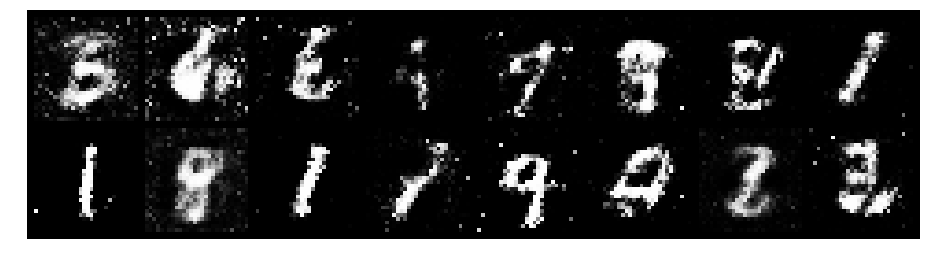

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.7403, Generator Loss: 2.4039
D(x): 0.7396, D(G(z)): 0.2356


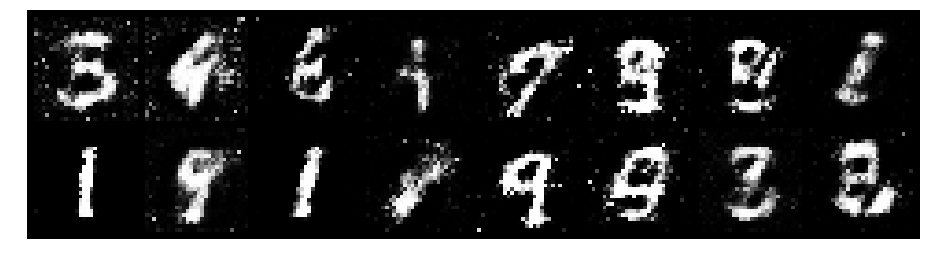

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 1.0331, Generator Loss: 1.8404
D(x): 0.6172, D(G(z)): 0.2461


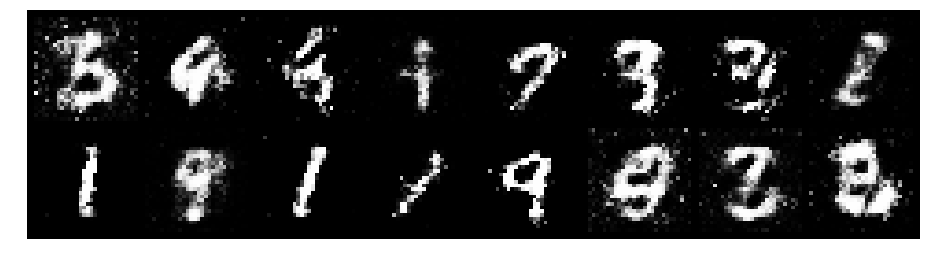

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.7353, Generator Loss: 1.9959
D(x): 0.7639, D(G(z)): 0.2391


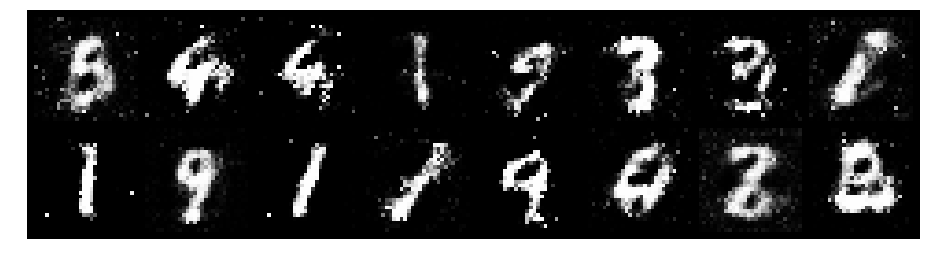

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 1.0022, Generator Loss: 1.5751
D(x): 0.5885, D(G(z)): 0.1858


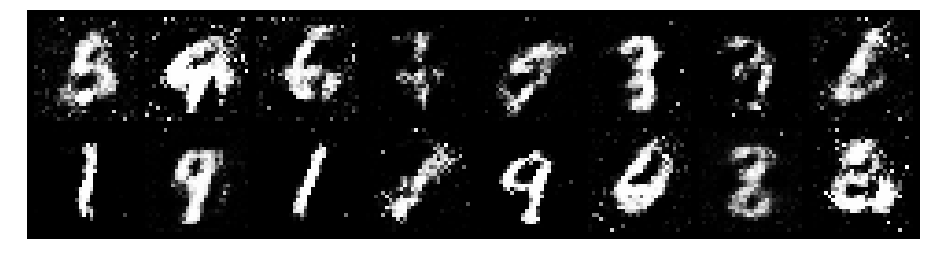

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.7642, Generator Loss: 1.8616
D(x): 0.7419, D(G(z)): 0.2684


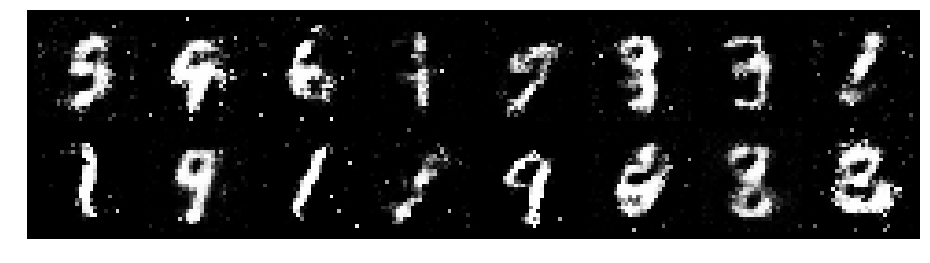

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.7633, Generator Loss: 1.9549
D(x): 0.7158, D(G(z)): 0.1945


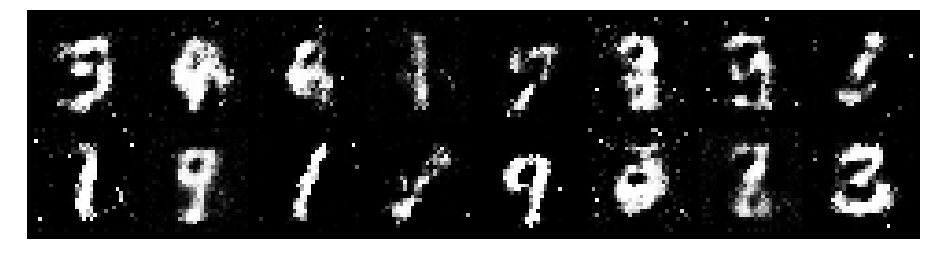

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.7504, Generator Loss: 1.9401
D(x): 0.7815, D(G(z)): 0.3000


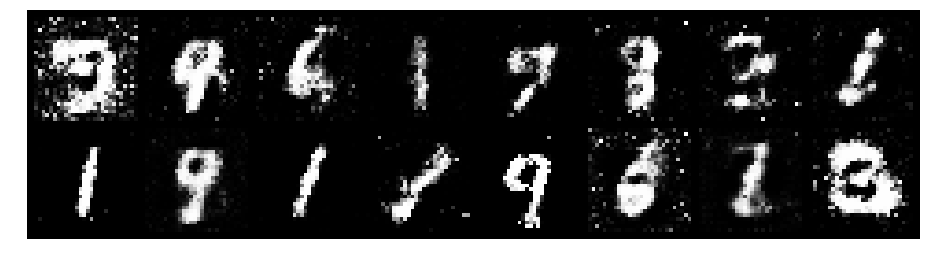

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.7893, Generator Loss: 2.0298
D(x): 0.7769, D(G(z)): 0.2771


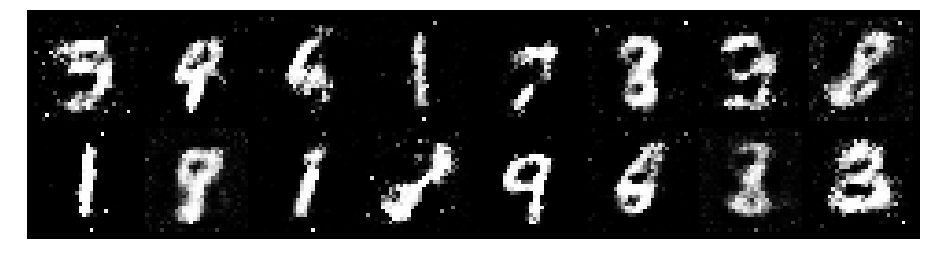

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 1.0485, Generator Loss: 1.5690
D(x): 0.7778, D(G(z)): 0.4165


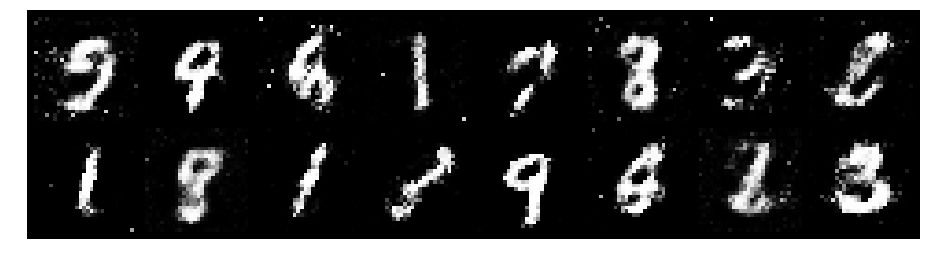

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.9390, Generator Loss: 1.2803
D(x): 0.7320, D(G(z)): 0.3231


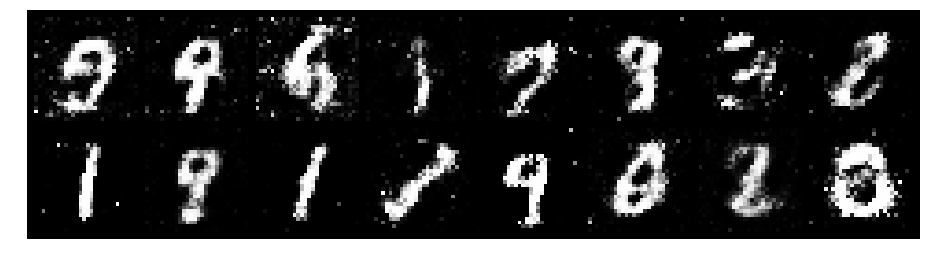

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 1.0233, Generator Loss: 1.5706
D(x): 0.6645, D(G(z)): 0.3355


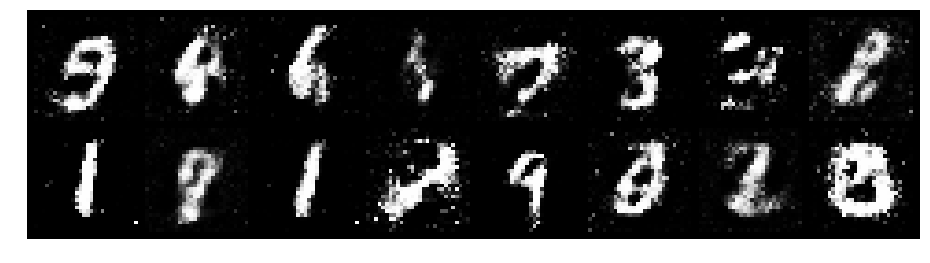

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 1.0160, Generator Loss: 1.4636
D(x): 0.7202, D(G(z)): 0.3731


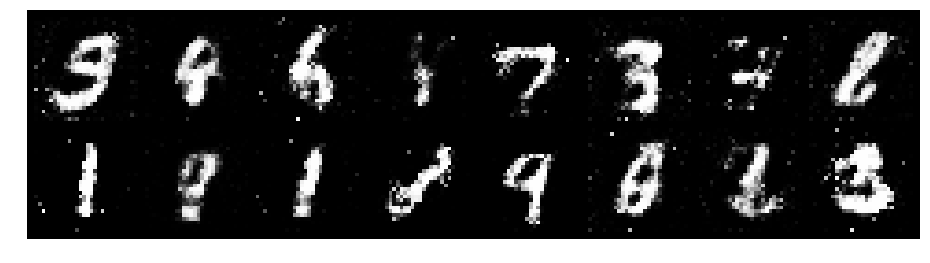

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.8748, Generator Loss: 1.5540
D(x): 0.7194, D(G(z)): 0.3070


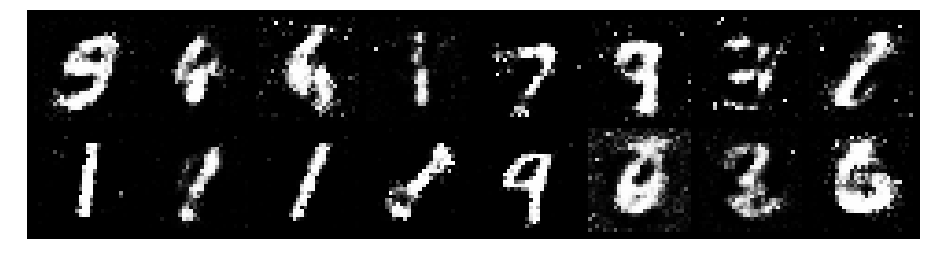

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 1.0727, Generator Loss: 1.1413
D(x): 0.6812, D(G(z)): 0.3461


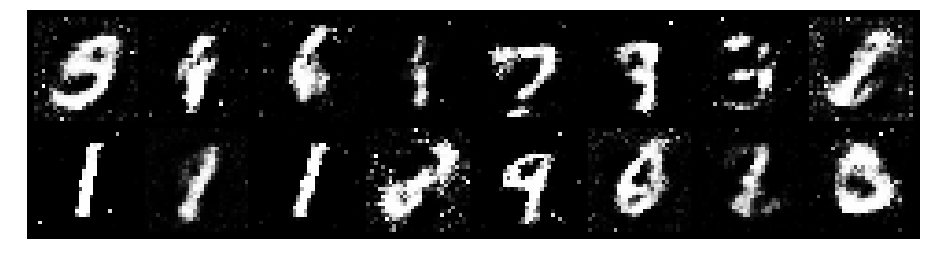

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.9652, Generator Loss: 1.0861
D(x): 0.7214, D(G(z)): 0.3428


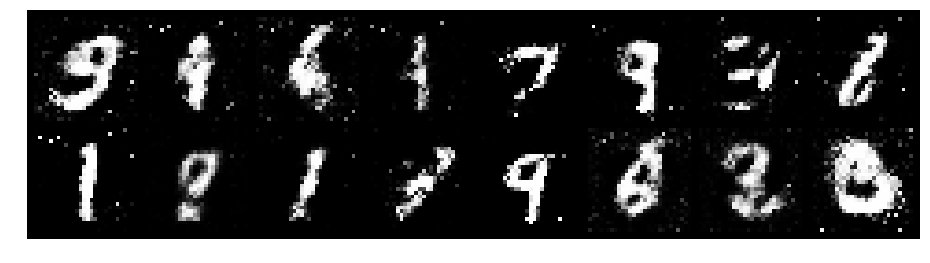

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.8852, Generator Loss: 1.3923
D(x): 0.7178, D(G(z)): 0.2881


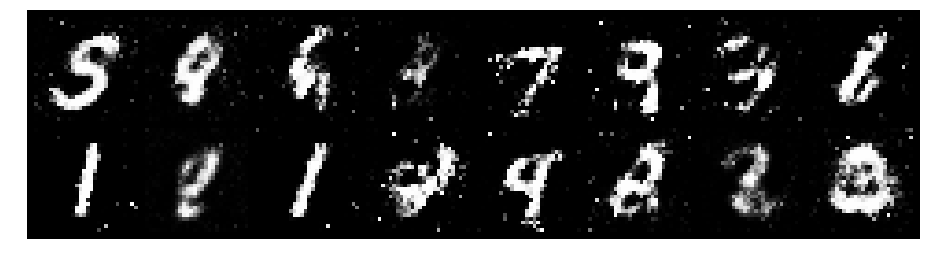

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.7995, Generator Loss: 1.8441
D(x): 0.7417, D(G(z)): 0.3031


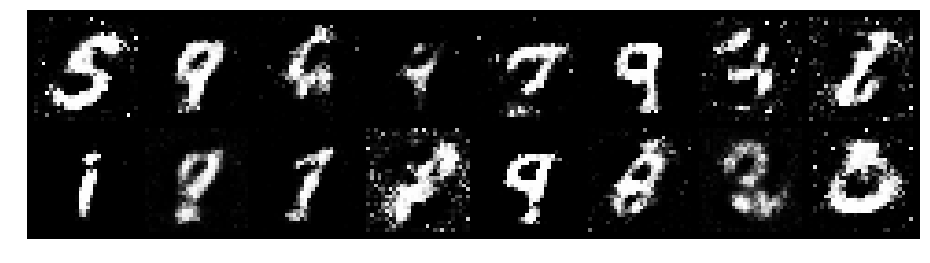

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8660, Generator Loss: 1.5779
D(x): 0.7496, D(G(z)): 0.3483


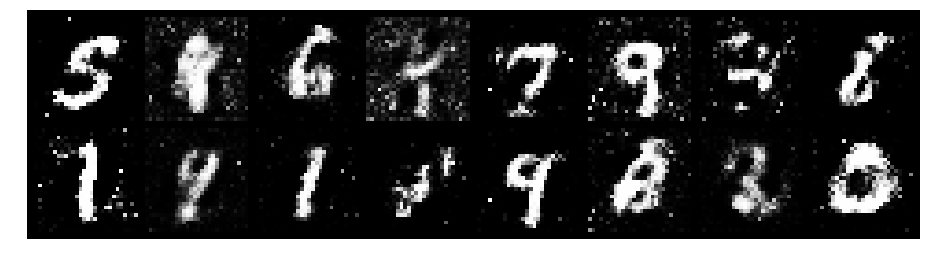

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 1.1598, Generator Loss: 1.6397
D(x): 0.6047, D(G(z)): 0.3061


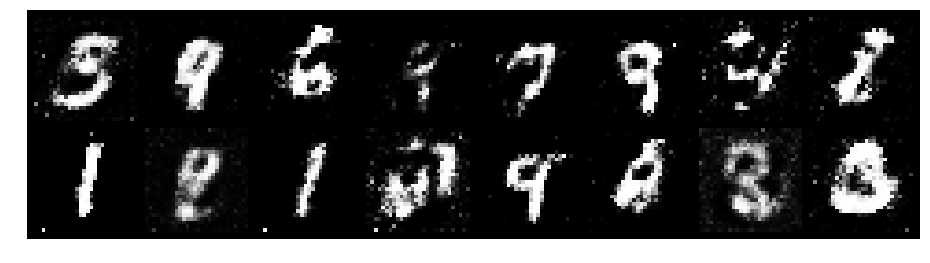

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.6759, Generator Loss: 1.5997
D(x): 0.7446, D(G(z)): 0.2361


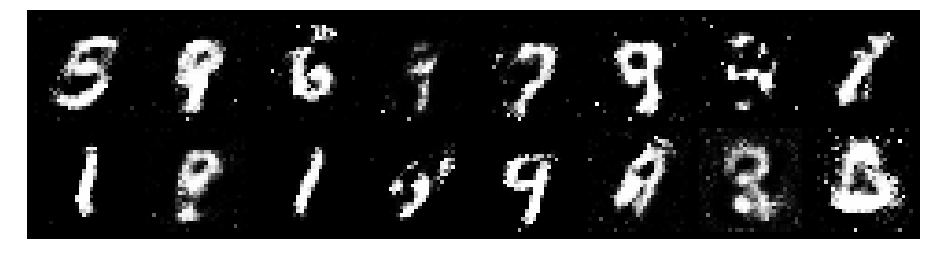

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.7326, Generator Loss: 1.6503
D(x): 0.7247, D(G(z)): 0.2425


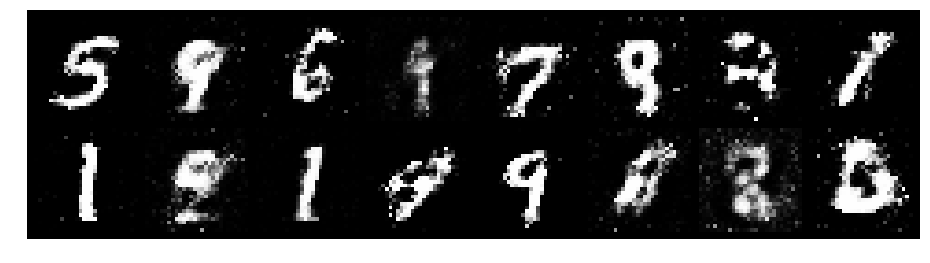

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.9293, Generator Loss: 1.7738
D(x): 0.6930, D(G(z)): 0.2372


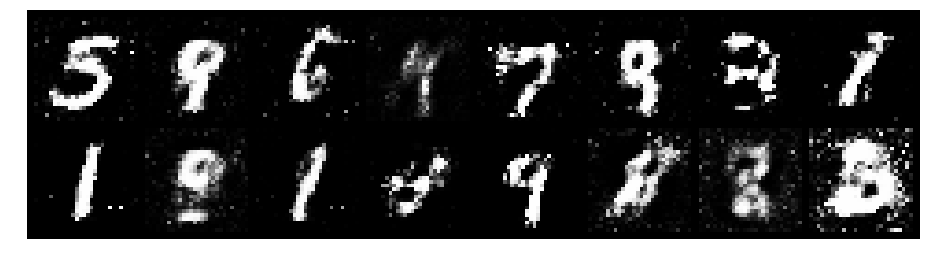

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.0022, Generator Loss: 2.1863
D(x): 0.6974, D(G(z)): 0.2879


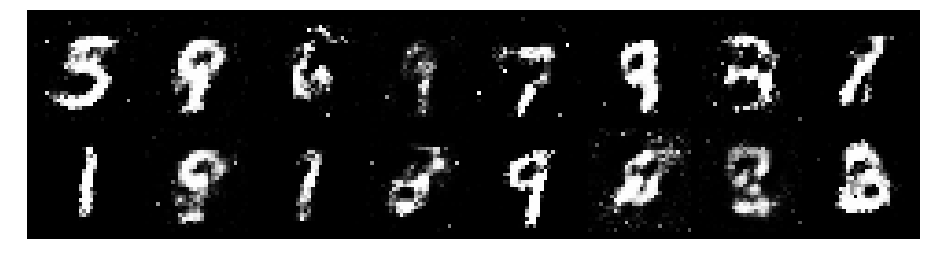

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.9425, Generator Loss: 1.6689
D(x): 0.6952, D(G(z)): 0.2745


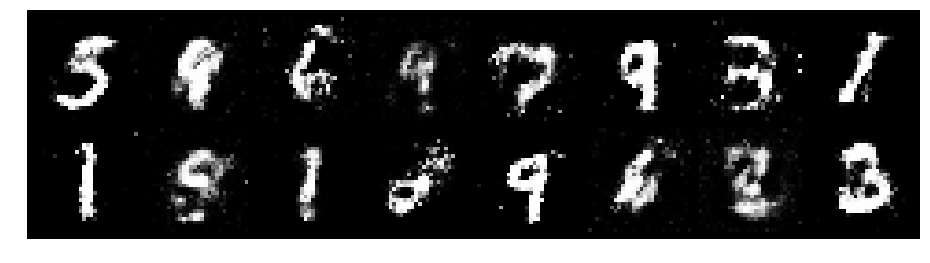

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9582, Generator Loss: 1.7692
D(x): 0.6655, D(G(z)): 0.2659


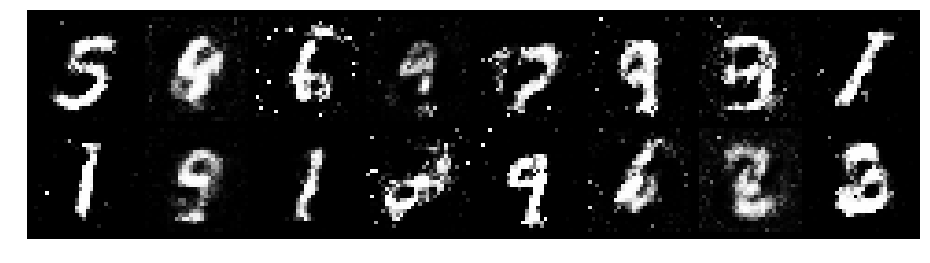

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.9584, Generator Loss: 1.9382
D(x): 0.6165, D(G(z)): 0.2225


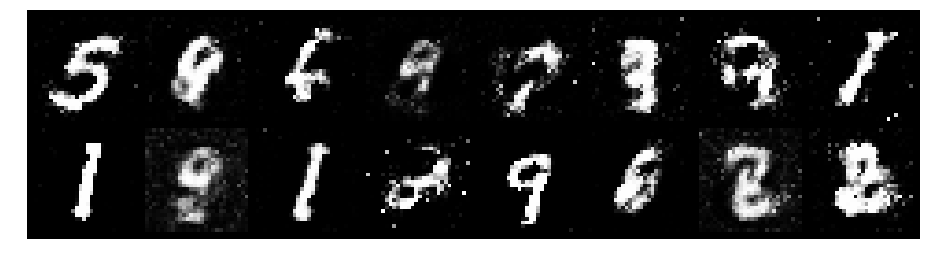

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.9386, Generator Loss: 1.7012
D(x): 0.6401, D(G(z)): 0.2041


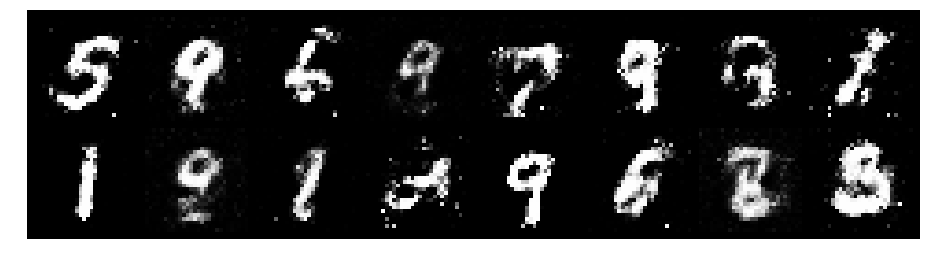

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 1.0333, Generator Loss: 1.5988
D(x): 0.7116, D(G(z)): 0.3746


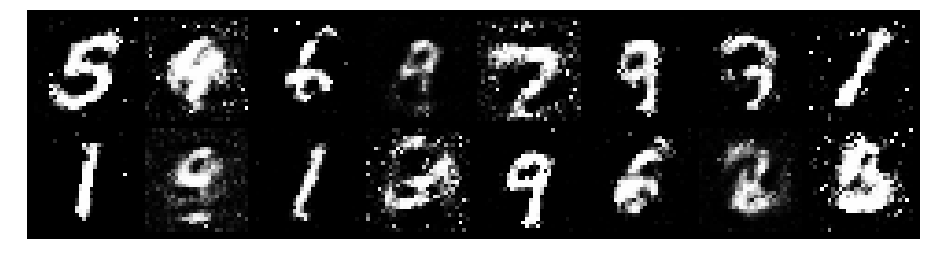

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.9232, Generator Loss: 1.6044
D(x): 0.7214, D(G(z)): 0.3066


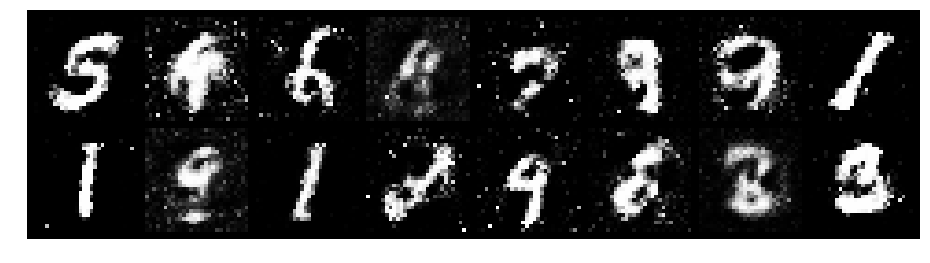

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9402, Generator Loss: 1.6699
D(x): 0.7274, D(G(z)): 0.3389


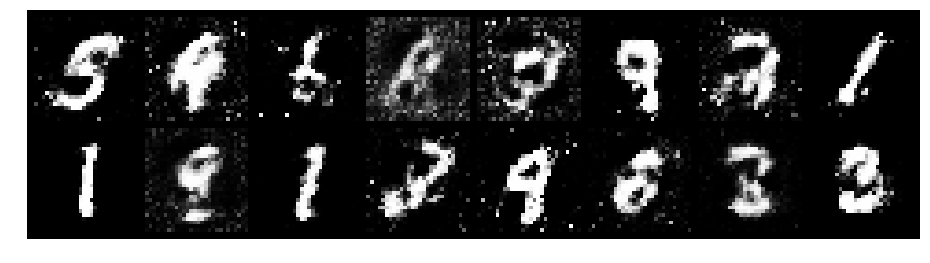

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.9221, Generator Loss: 1.5938
D(x): 0.7497, D(G(z)): 0.3351


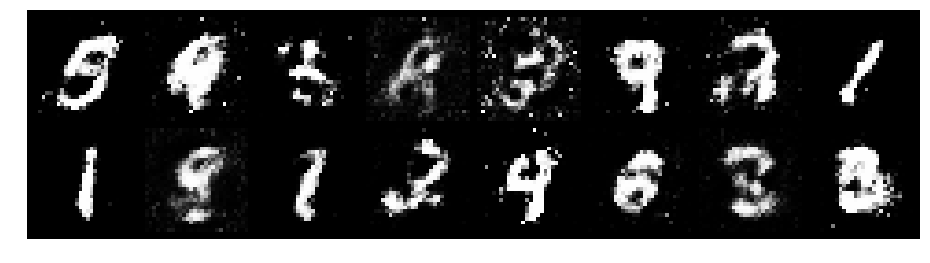

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.7755, Generator Loss: 1.7559
D(x): 0.7611, D(G(z)): 0.2920


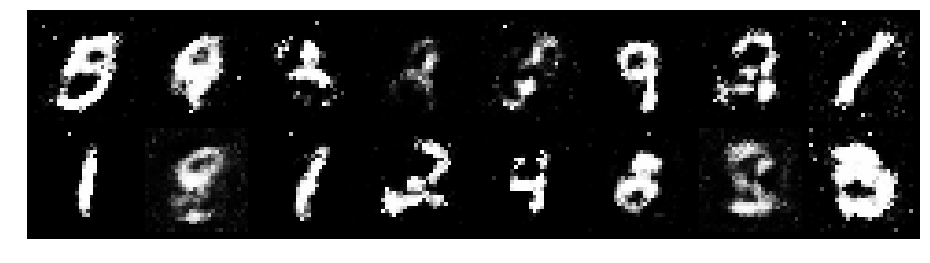

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.7736, Generator Loss: 1.7997
D(x): 0.7267, D(G(z)): 0.2536


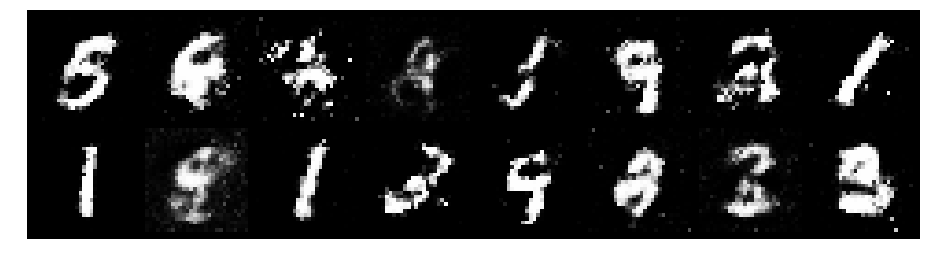

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.6845, Generator Loss: 1.5295
D(x): 0.7324, D(G(z)): 0.2103


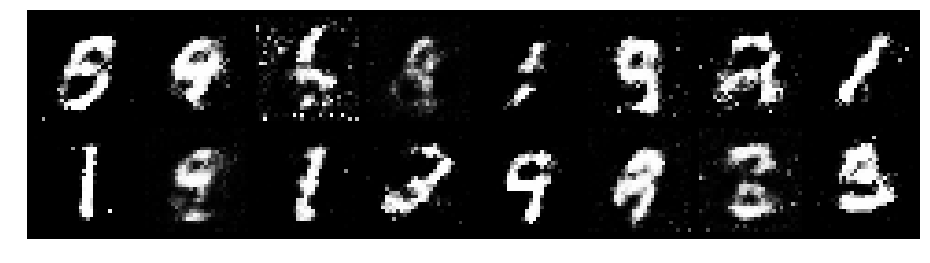

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.8326, Generator Loss: 1.7824
D(x): 0.7107, D(G(z)): 0.2220


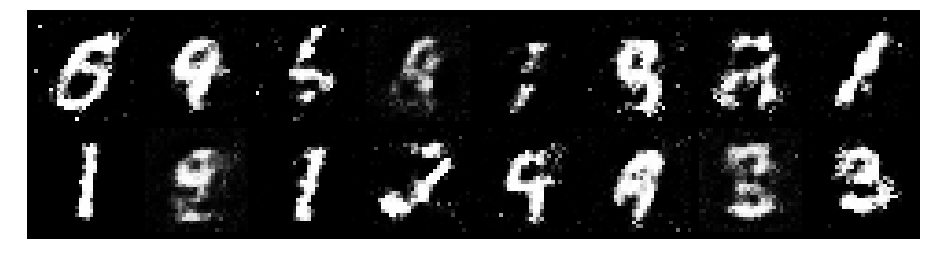

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 1.0058, Generator Loss: 1.3833
D(x): 0.7307, D(G(z)): 0.3468


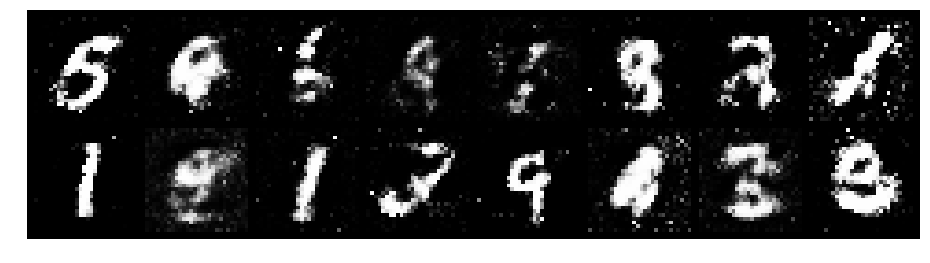

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 1.0856, Generator Loss: 1.6343
D(x): 0.7021, D(G(z)): 0.3727


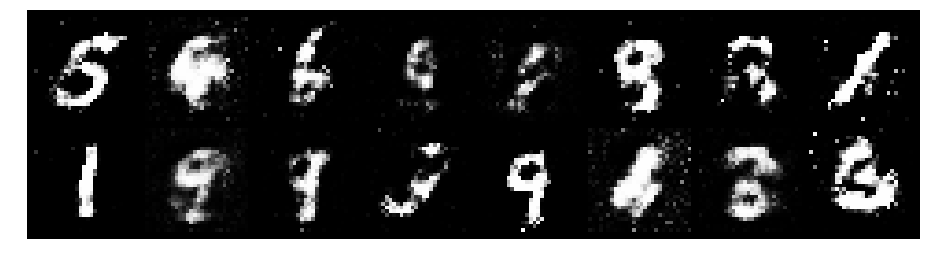

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.9935, Generator Loss: 1.4259
D(x): 0.6741, D(G(z)): 0.3238


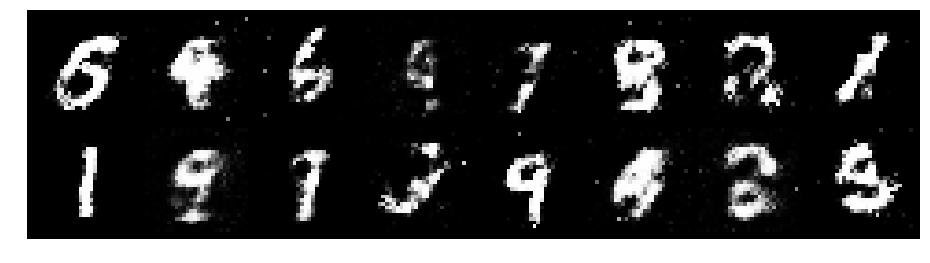

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 1.1031, Generator Loss: 1.6097
D(x): 0.6621, D(G(z)): 0.3562


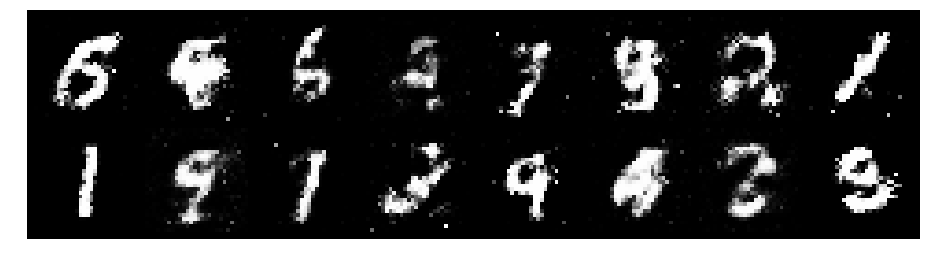

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.8434, Generator Loss: 1.6679
D(x): 0.6975, D(G(z)): 0.2908


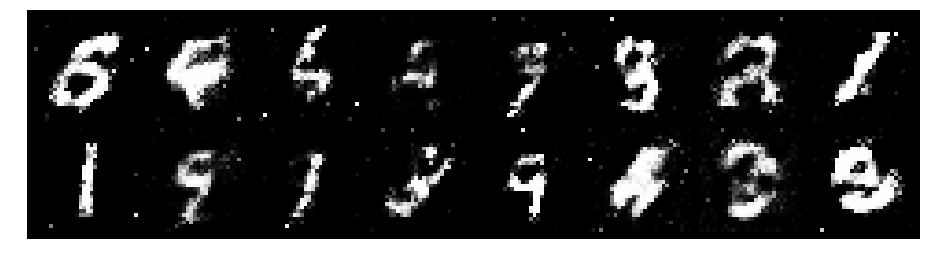

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9049, Generator Loss: 1.7294
D(x): 0.6560, D(G(z)): 0.2415


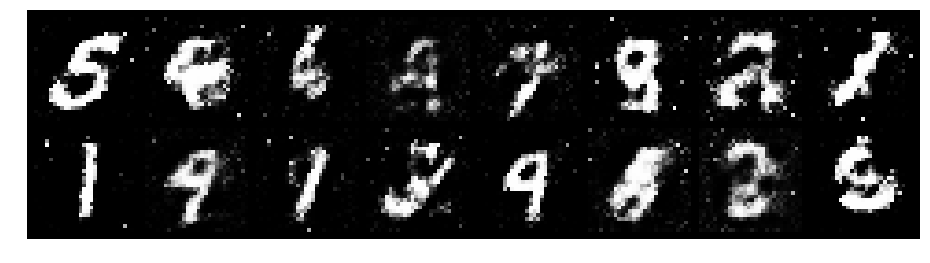

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.8077, Generator Loss: 1.7117
D(x): 0.7087, D(G(z)): 0.2380


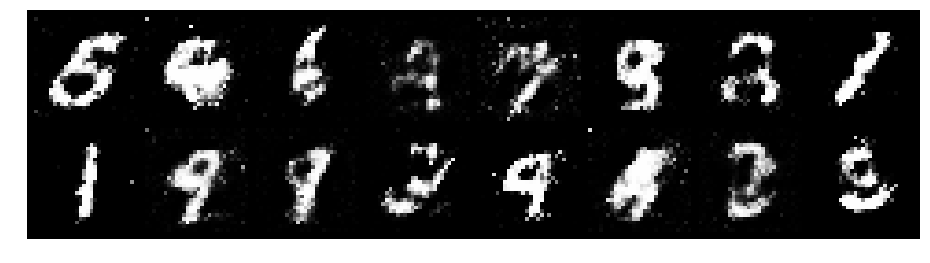

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.0050, Generator Loss: 1.3631
D(x): 0.6182, D(G(z)): 0.2605


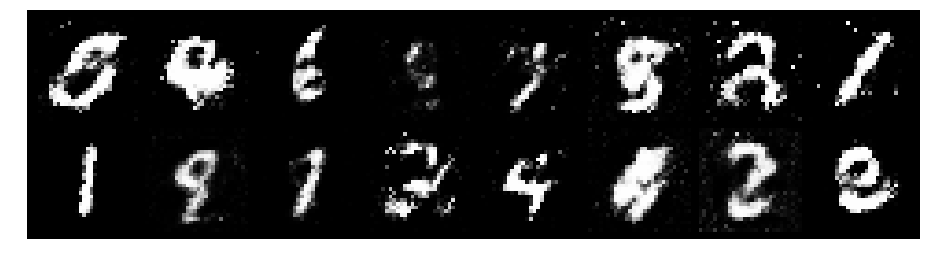

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0132, Generator Loss: 1.4498
D(x): 0.6458, D(G(z)): 0.2556


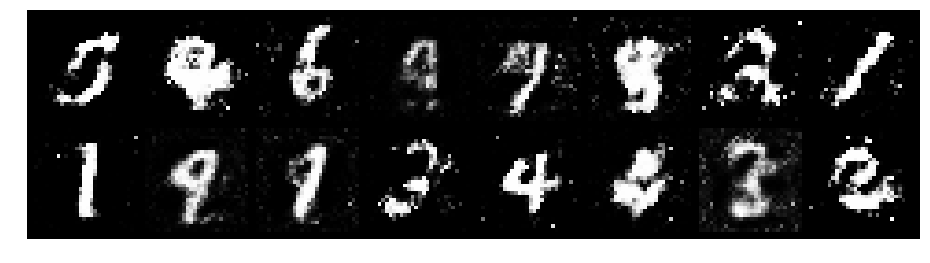

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.2073, Generator Loss: 1.5537
D(x): 0.7032, D(G(z)): 0.3982


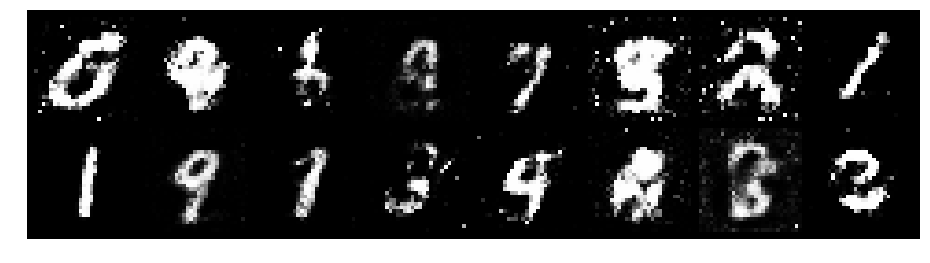

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.0428, Generator Loss: 1.8959
D(x): 0.6203, D(G(z)): 0.2605


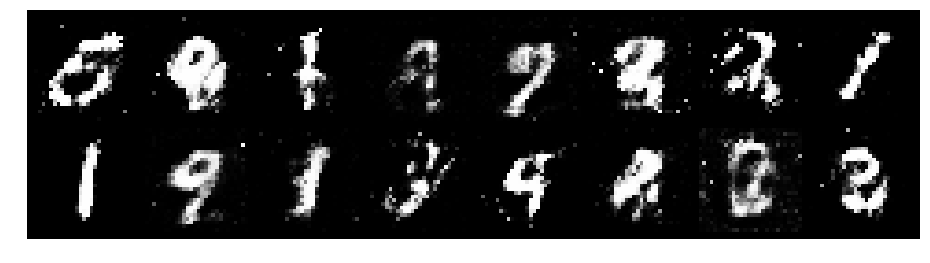

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.9201, Generator Loss: 1.0617
D(x): 0.7870, D(G(z)): 0.4159


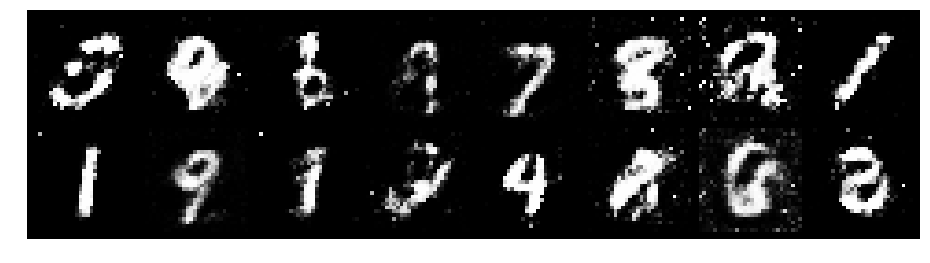

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.7854, Generator Loss: 1.7461
D(x): 0.7363, D(G(z)): 0.2995


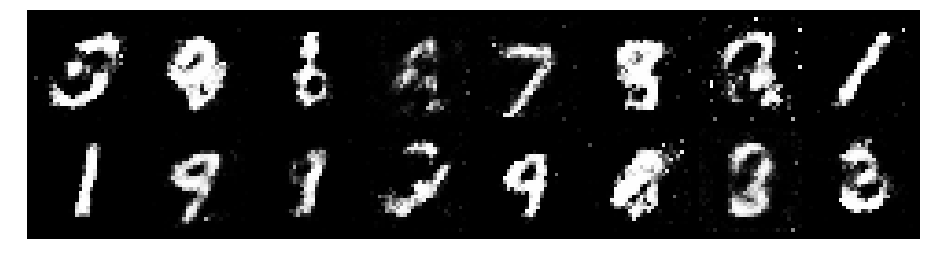

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0248, Generator Loss: 1.2876
D(x): 0.6381, D(G(z)): 0.3063


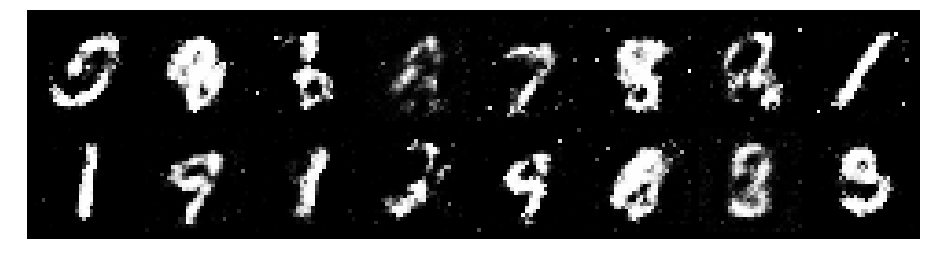

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.9396, Generator Loss: 1.5819
D(x): 0.6338, D(G(z)): 0.2578


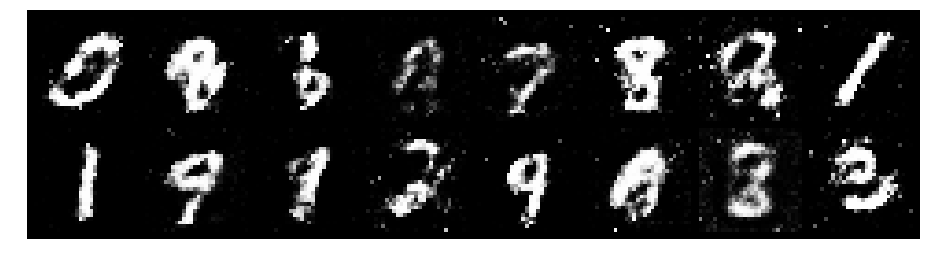

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.8345, Generator Loss: 1.3138
D(x): 0.8013, D(G(z)): 0.3580


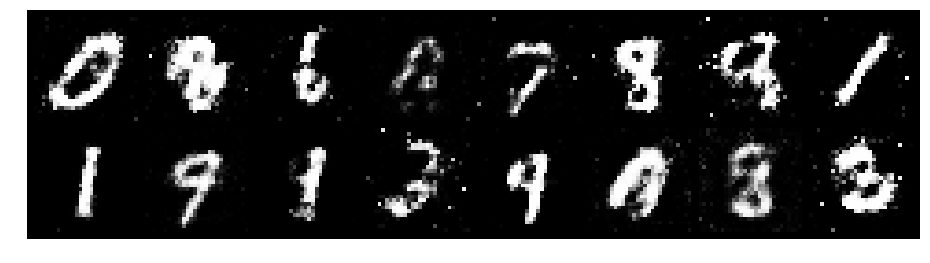

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.9128, Generator Loss: 1.2890
D(x): 0.7067, D(G(z)): 0.3290


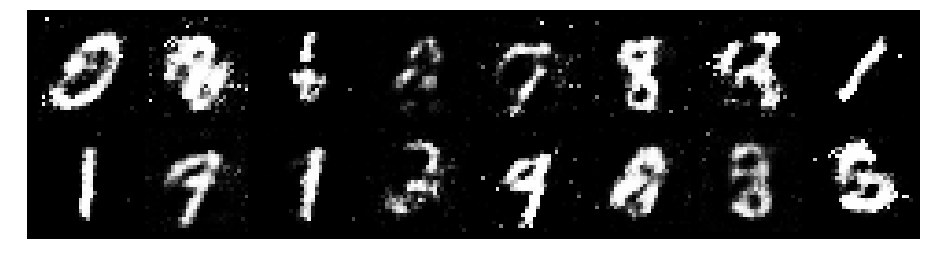

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.7914, Generator Loss: 1.5930
D(x): 0.7589, D(G(z)): 0.3007


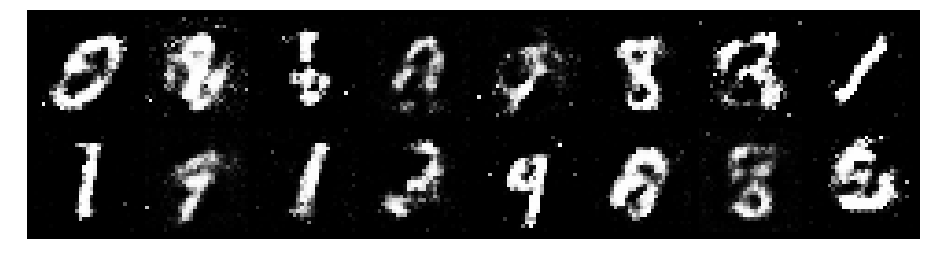

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8565, Generator Loss: 1.6169
D(x): 0.6882, D(G(z)): 0.2513


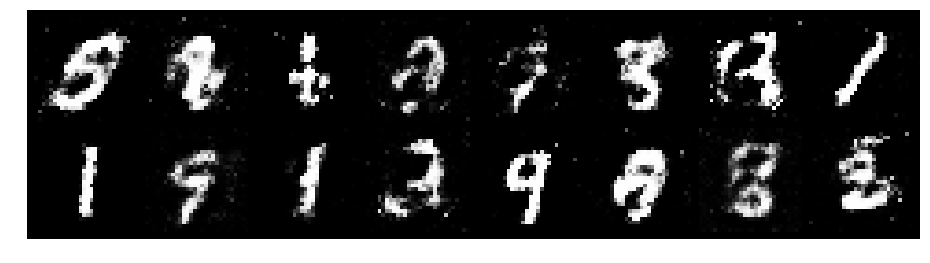

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.8408, Generator Loss: 1.9045
D(x): 0.6681, D(G(z)): 0.2573


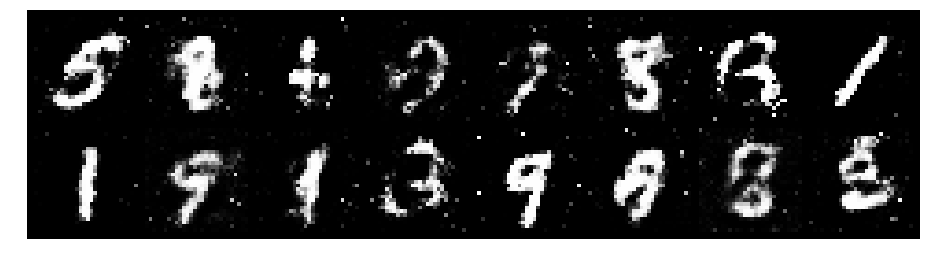

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.0516, Generator Loss: 1.4201
D(x): 0.7329, D(G(z)): 0.4221


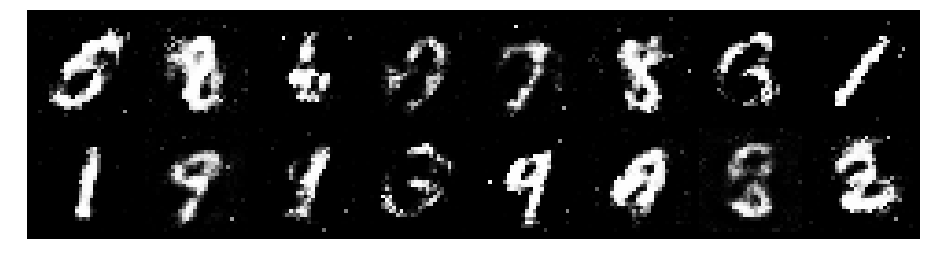

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.0471, Generator Loss: 1.4305
D(x): 0.6935, D(G(z)): 0.3644


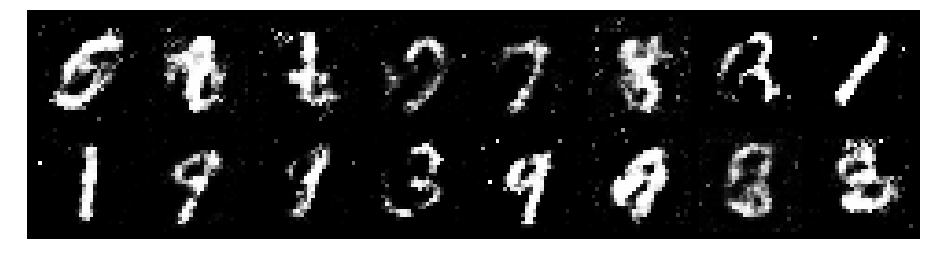

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 0.8716, Generator Loss: 1.7436
D(x): 0.7371, D(G(z)): 0.3444


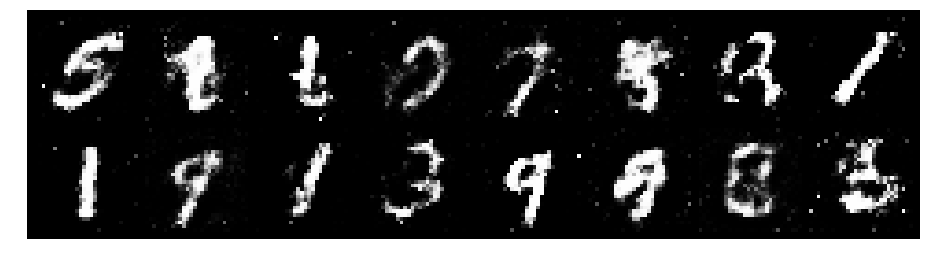

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.8679, Generator Loss: 1.4041
D(x): 0.7469, D(G(z)): 0.3522


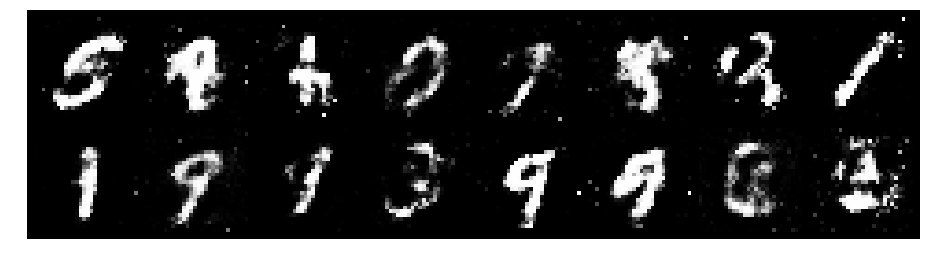

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9687, Generator Loss: 1.8792
D(x): 0.6656, D(G(z)): 0.2864


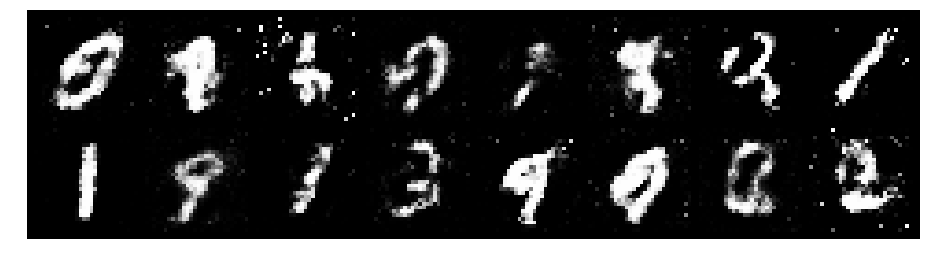

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.1532, Generator Loss: 1.1810
D(x): 0.6871, D(G(z)): 0.4312


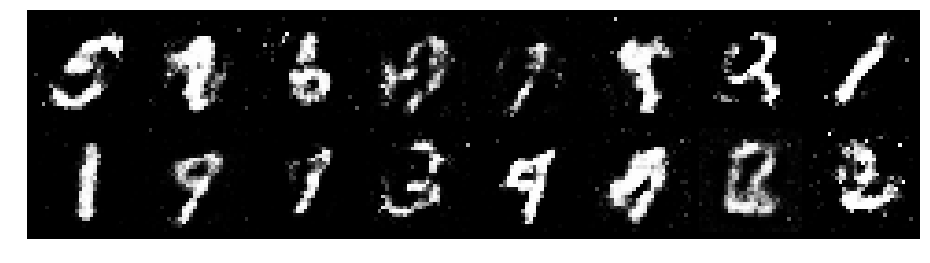

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.0484, Generator Loss: 1.2493
D(x): 0.6413, D(G(z)): 0.3334


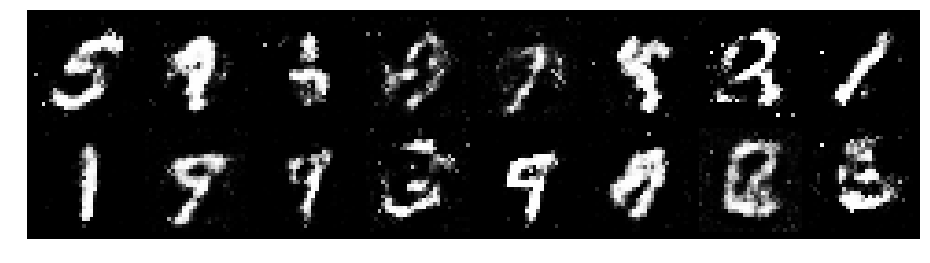

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 0.9609, Generator Loss: 1.6168
D(x): 0.7165, D(G(z)): 0.3661


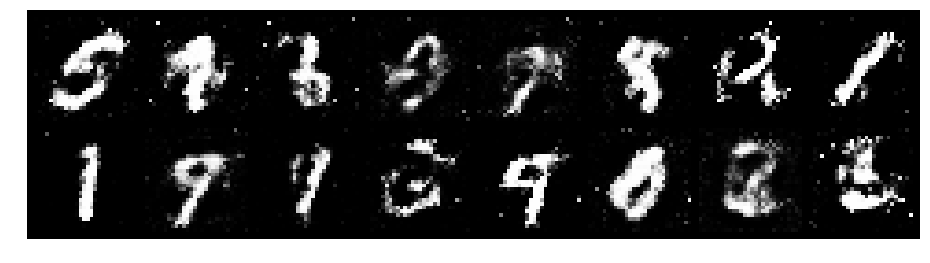

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.8722, Generator Loss: 1.8363
D(x): 0.7211, D(G(z)): 0.3055


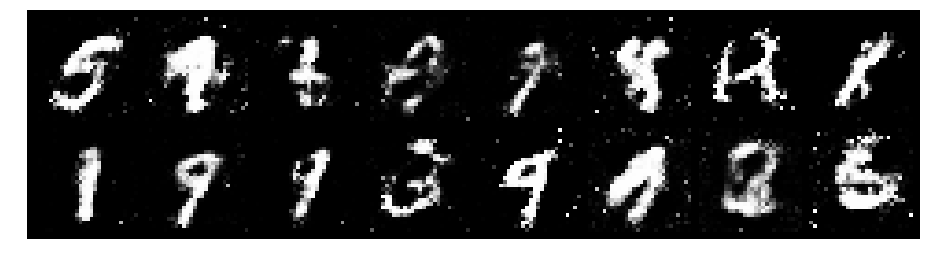

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.8409, Generator Loss: 1.3322
D(x): 0.7422, D(G(z)): 0.3007


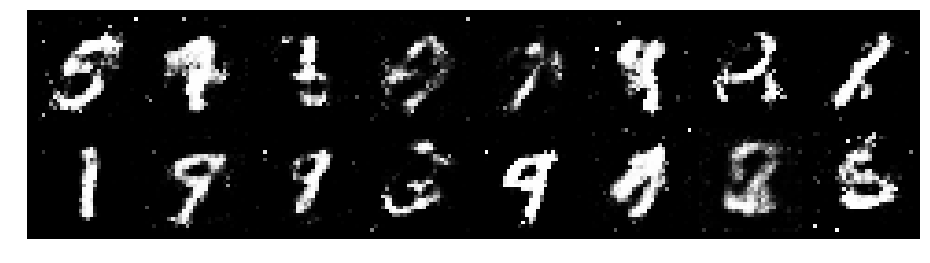

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9997, Generator Loss: 1.3916
D(x): 0.6270, D(G(z)): 0.3083


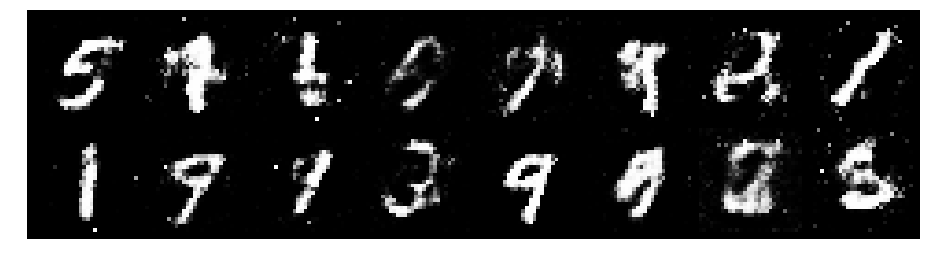

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.9545, Generator Loss: 1.0878
D(x): 0.6809, D(G(z)): 0.3392


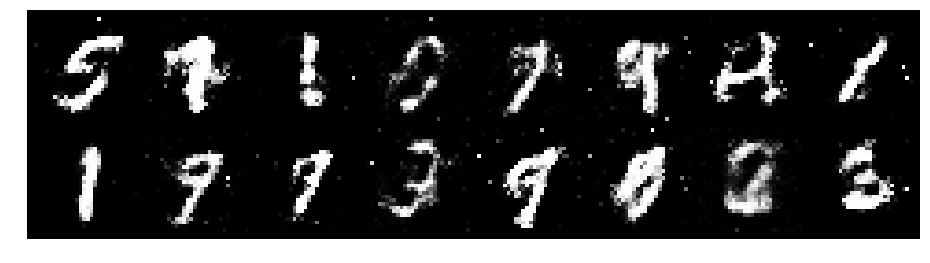

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.1522, Generator Loss: 1.2914
D(x): 0.5643, D(G(z)): 0.3262


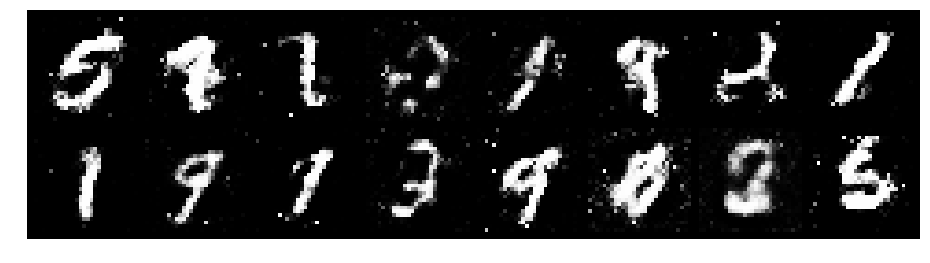

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.1817, Generator Loss: 1.2103
D(x): 0.6387, D(G(z)): 0.4024


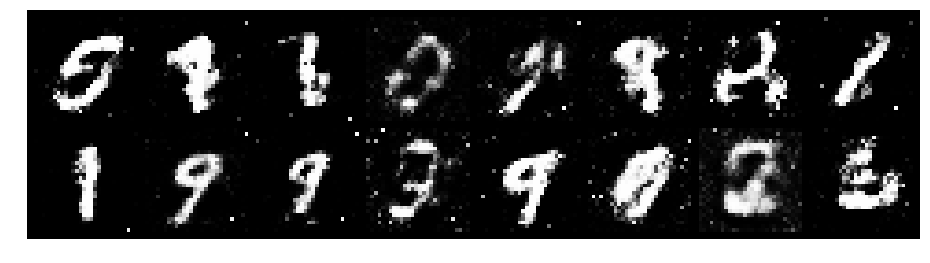

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.9909, Generator Loss: 1.3750
D(x): 0.6837, D(G(z)): 0.3336


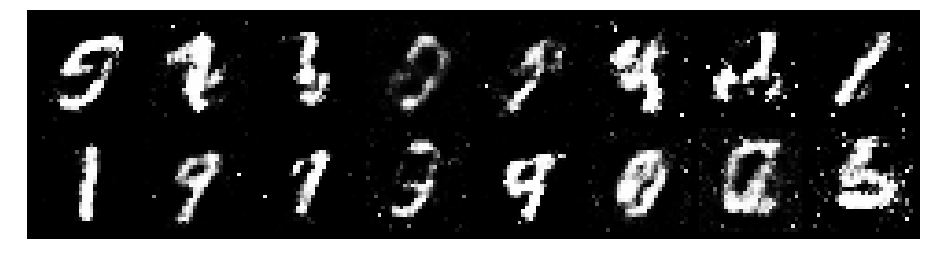

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 1.0223, Generator Loss: 1.3228
D(x): 0.6636, D(G(z)): 0.3474


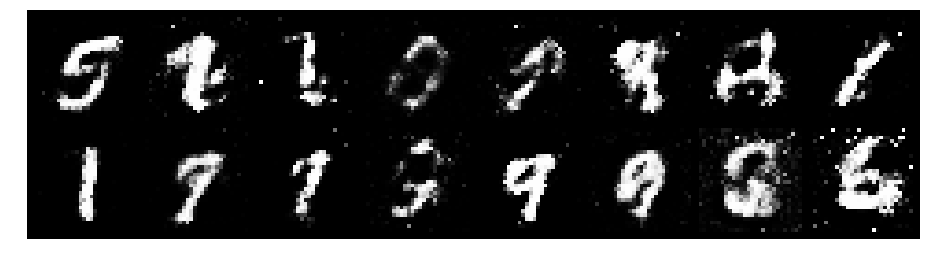

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.0083, Generator Loss: 1.2693
D(x): 0.6457, D(G(z)): 0.3118


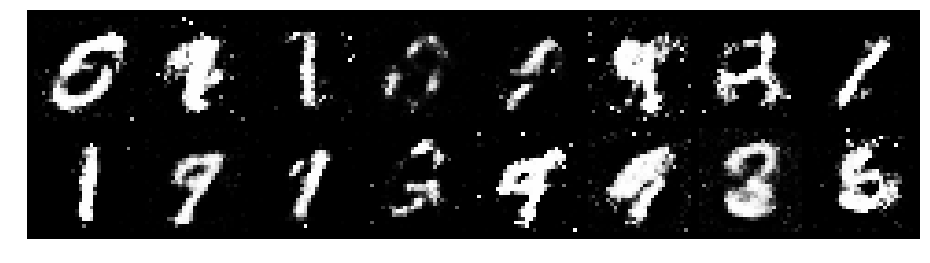

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.0703, Generator Loss: 1.6042
D(x): 0.6509, D(G(z)): 0.3449


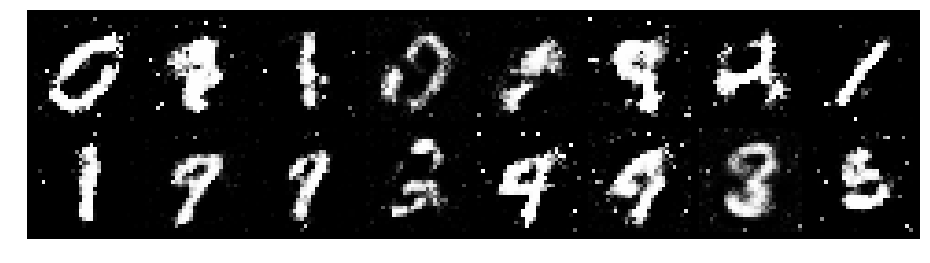

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.9097, Generator Loss: 1.6378
D(x): 0.7210, D(G(z)): 0.3277


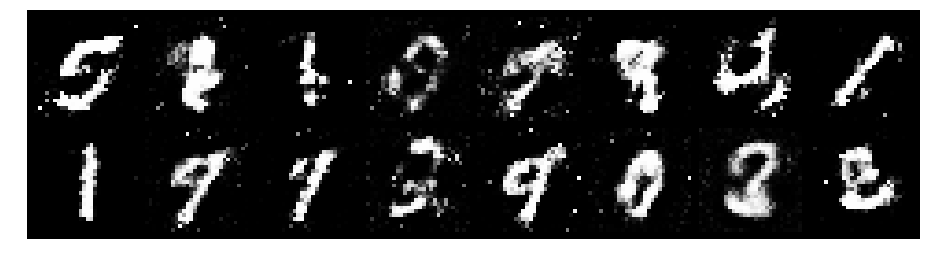

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.1353, Generator Loss: 0.9845
D(x): 0.6275, D(G(z)): 0.4130


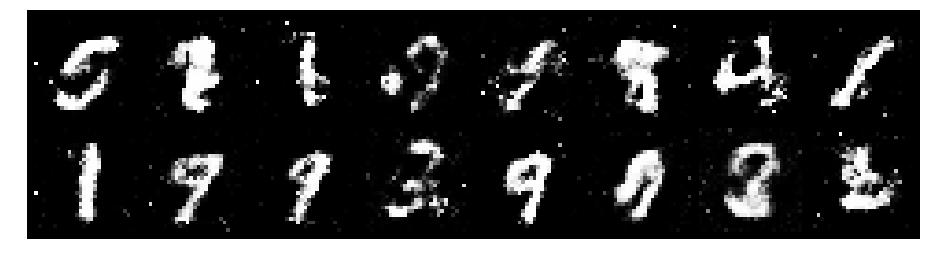

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.8638, Generator Loss: 1.4805
D(x): 0.6469, D(G(z)): 0.2495


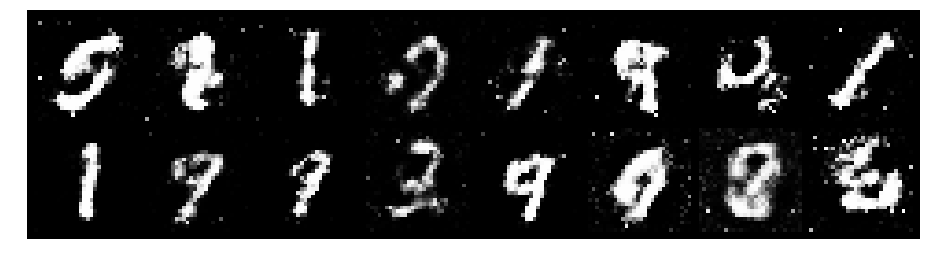

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1503, Generator Loss: 1.1448
D(x): 0.7077, D(G(z)): 0.4288


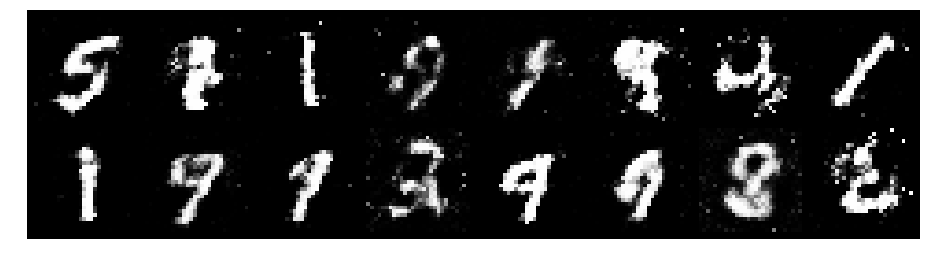

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.0771, Generator Loss: 1.4658
D(x): 0.6442, D(G(z)): 0.3474


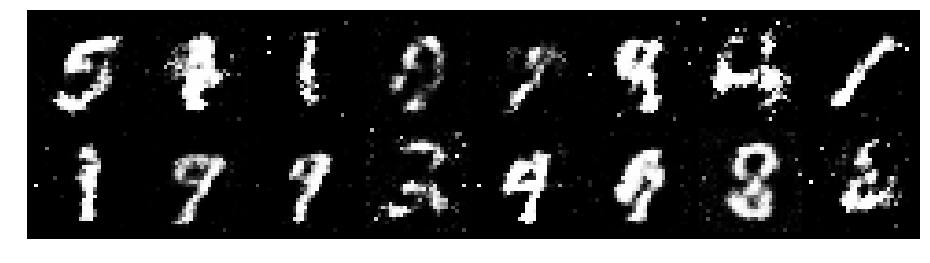

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.9075, Generator Loss: 1.5651
D(x): 0.6102, D(G(z)): 0.2565


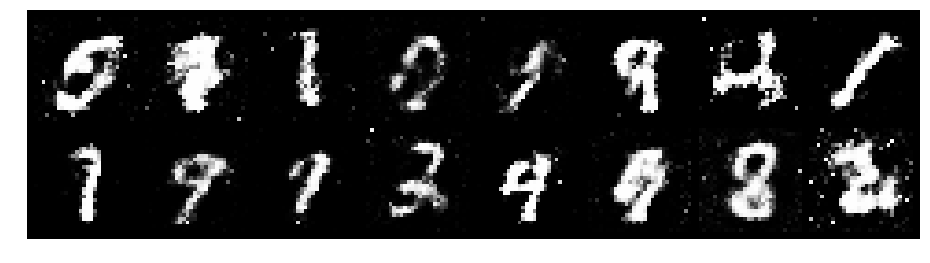

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.9418, Generator Loss: 1.6526
D(x): 0.6077, D(G(z)): 0.2315


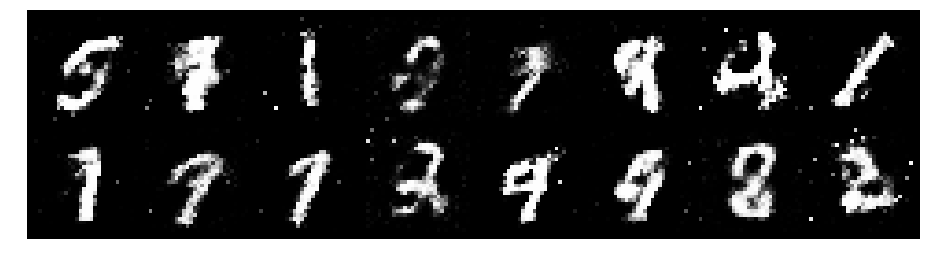

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0119, Generator Loss: 1.5072
D(x): 0.6762, D(G(z)): 0.3606


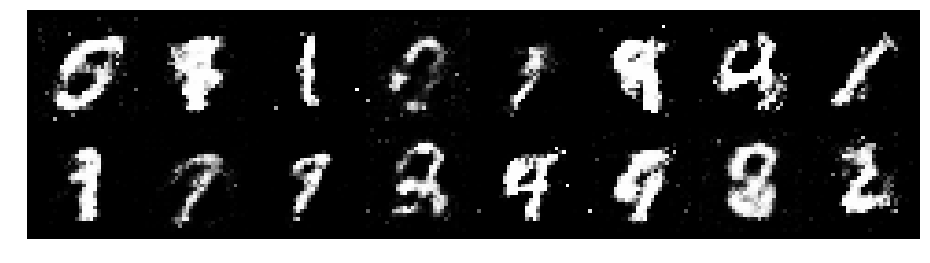

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.0642, Generator Loss: 1.8352
D(x): 0.5918, D(G(z)): 0.2568


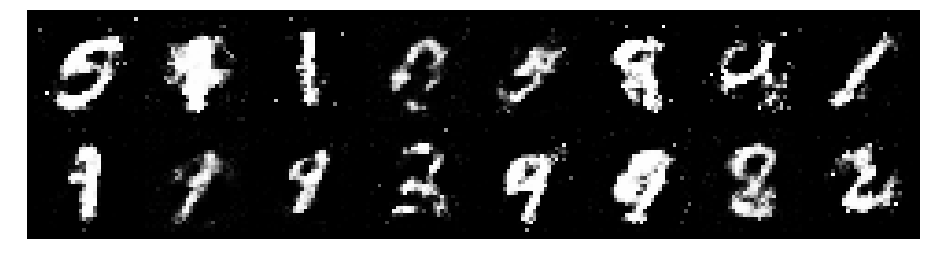

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.1384, Generator Loss: 1.1909
D(x): 0.6185, D(G(z)): 0.3897


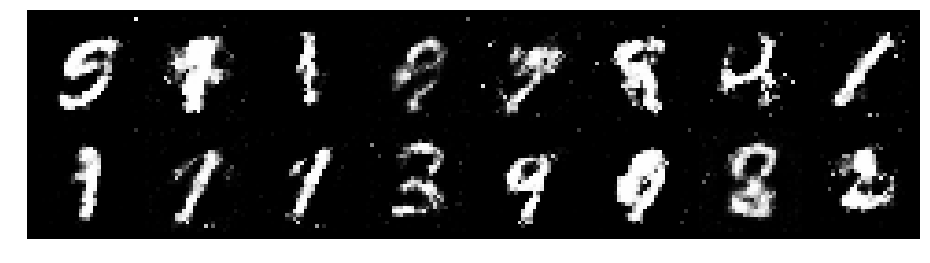

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.9326, Generator Loss: 1.3248
D(x): 0.7046, D(G(z)): 0.3667


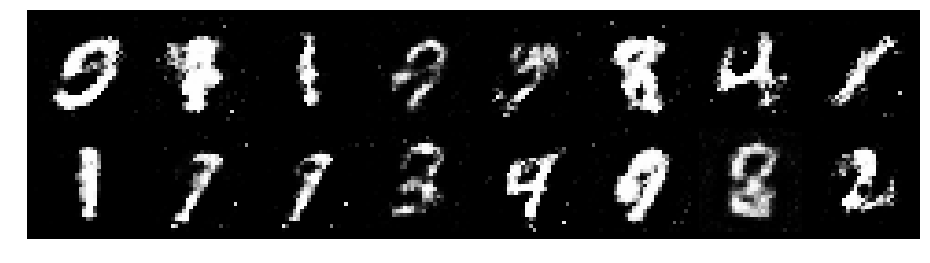

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 0.9403, Generator Loss: 1.3454
D(x): 0.6685, D(G(z)): 0.3317


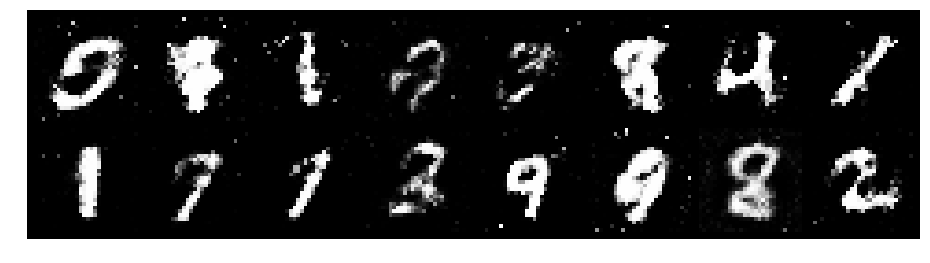

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.7887, Generator Loss: 1.8641
D(x): 0.7021, D(G(z)): 0.2439


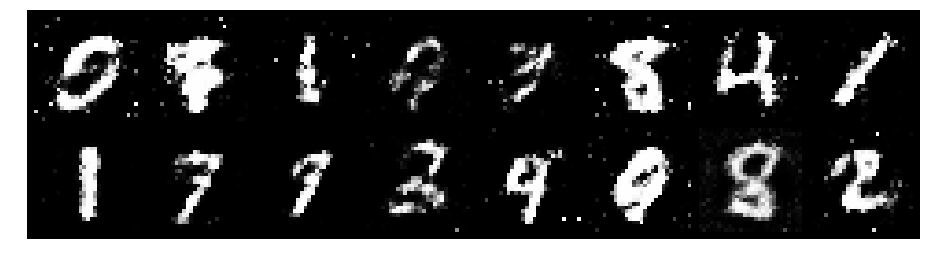

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 0.8612, Generator Loss: 1.1987
D(x): 0.6987, D(G(z)): 0.3067


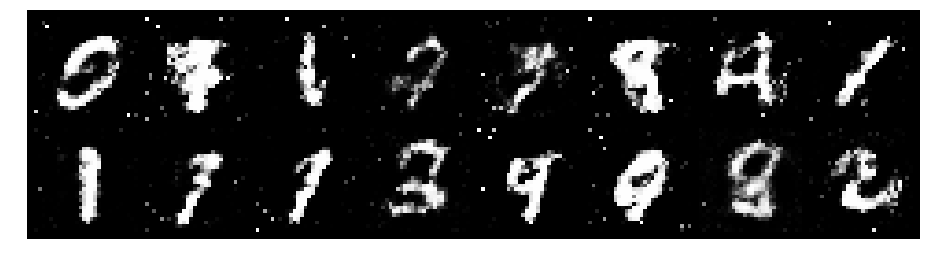

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.1766, Generator Loss: 1.4158
D(x): 0.6469, D(G(z)): 0.3871


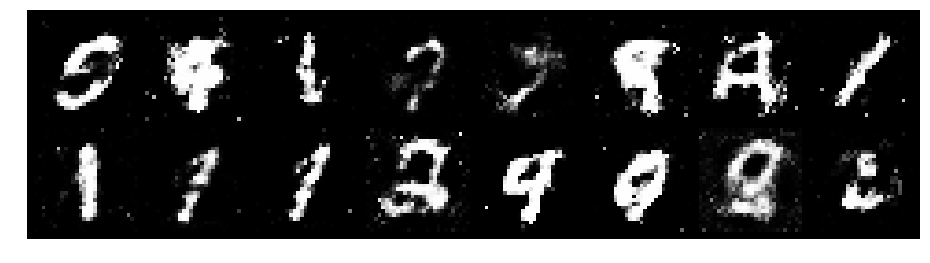

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0633, Generator Loss: 1.5144
D(x): 0.6354, D(G(z)): 0.3345


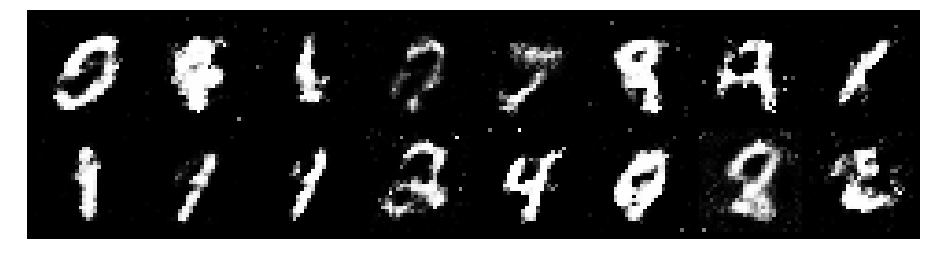

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.0598, Generator Loss: 1.4730
D(x): 0.6603, D(G(z)): 0.3394


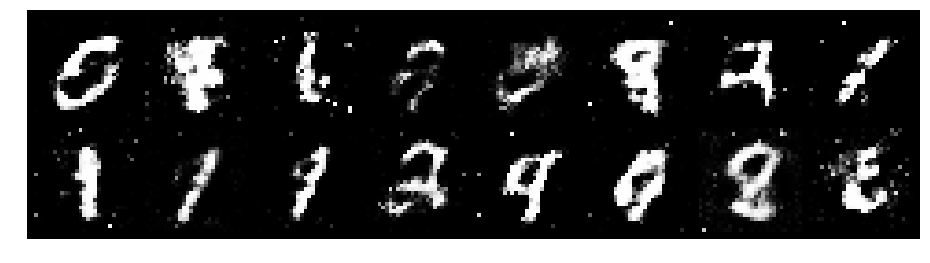

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.1734, Generator Loss: 1.2913
D(x): 0.5923, D(G(z)): 0.3455


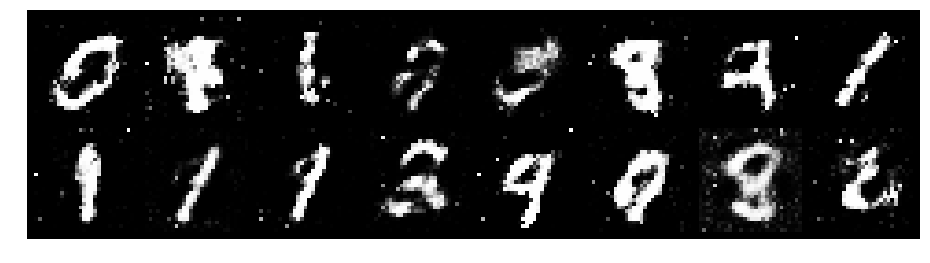

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 0.9125, Generator Loss: 1.4675
D(x): 0.6424, D(G(z)): 0.2771


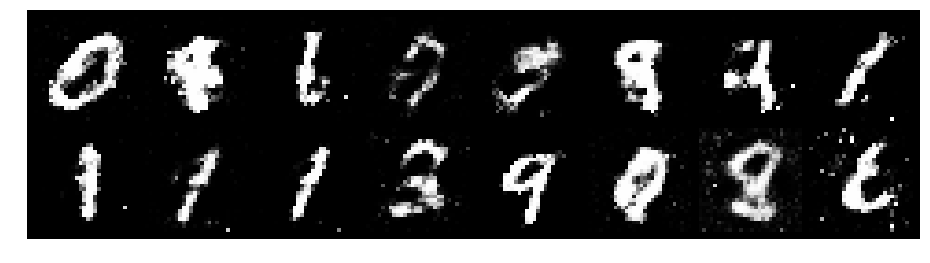

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 0.9875, Generator Loss: 1.3329
D(x): 0.6761, D(G(z)): 0.3621


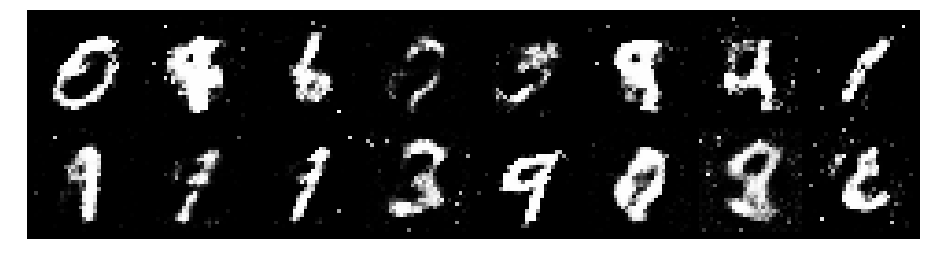

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.0944, Generator Loss: 1.3037
D(x): 0.6447, D(G(z)): 0.3734


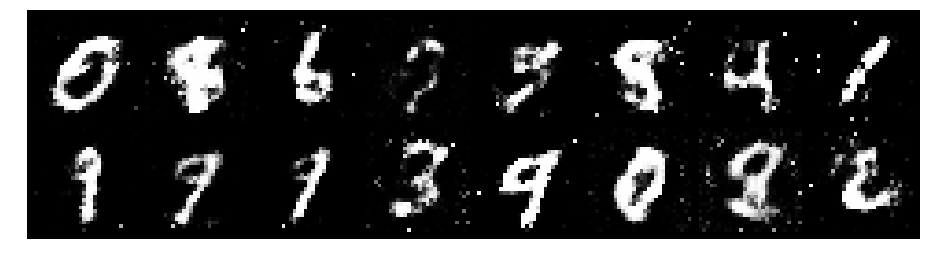

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.1016, Generator Loss: 1.1767
D(x): 0.6340, D(G(z)): 0.3850


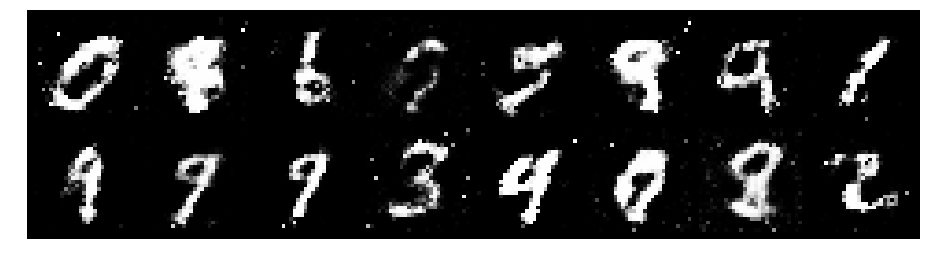

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.1508, Generator Loss: 1.0447
D(x): 0.6592, D(G(z)): 0.4105


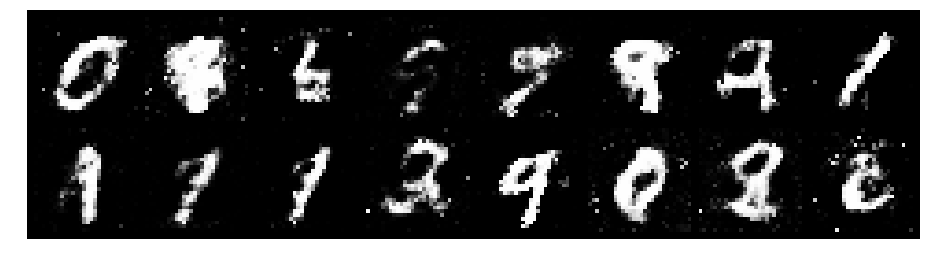

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.9991, Generator Loss: 1.2861
D(x): 0.6399, D(G(z)): 0.3348


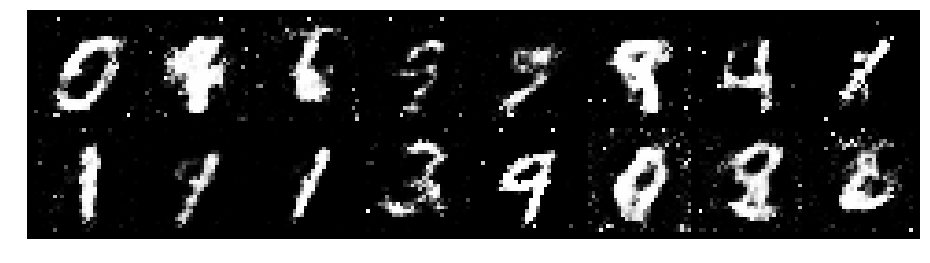

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9509, Generator Loss: 1.2516
D(x): 0.6711, D(G(z)): 0.3330


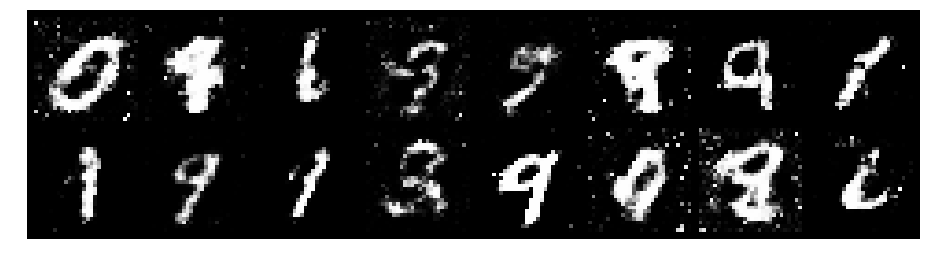

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 0.9410, Generator Loss: 1.4171
D(x): 0.6905, D(G(z)): 0.3508


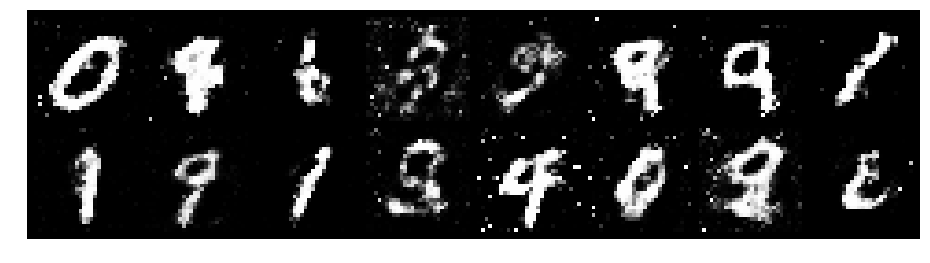

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.0488, Generator Loss: 1.2723
D(x): 0.6211, D(G(z)): 0.3326


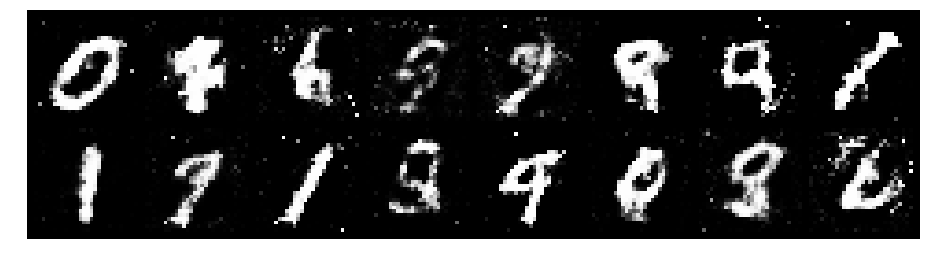

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.1914, Generator Loss: 1.4486
D(x): 0.6494, D(G(z)): 0.4155


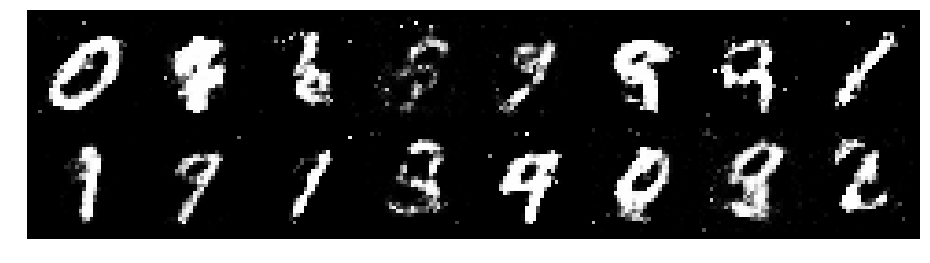

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 0.8941, Generator Loss: 1.4400
D(x): 0.7589, D(G(z)): 0.3721


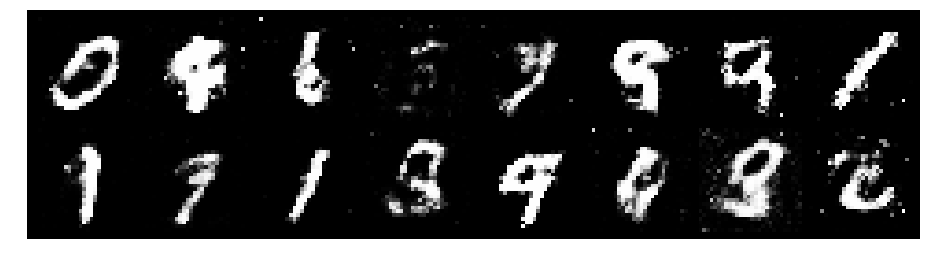

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.0670, Generator Loss: 1.0660
D(x): 0.7006, D(G(z)): 0.4296


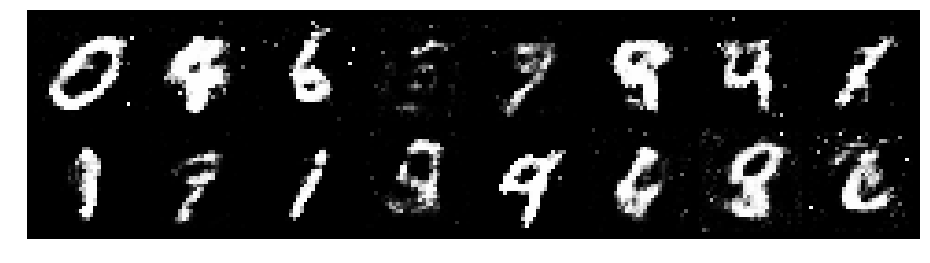

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 0.9888, Generator Loss: 1.2855
D(x): 0.6688, D(G(z)): 0.3589


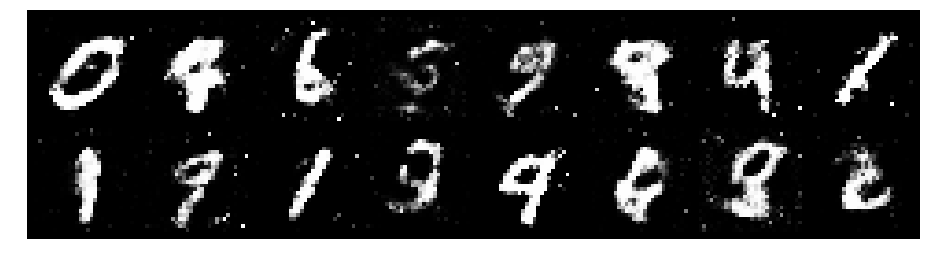

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1554, Generator Loss: 1.2825
D(x): 0.5420, D(G(z)): 0.3275


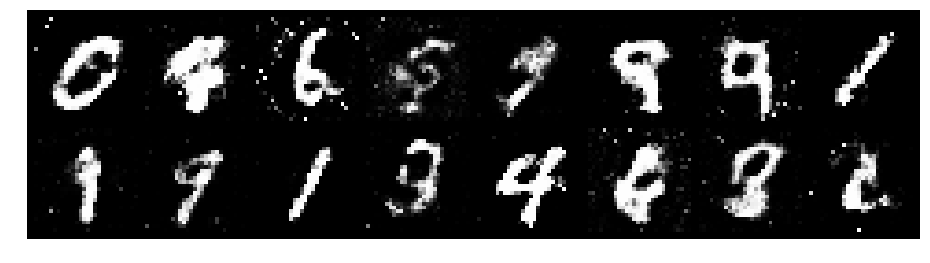

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.0918, Generator Loss: 1.3517
D(x): 0.6233, D(G(z)): 0.3514


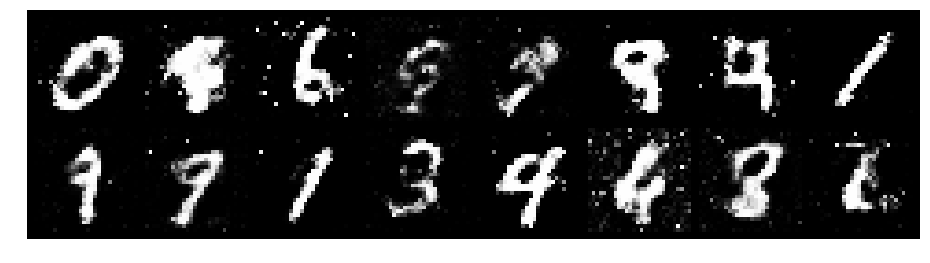

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 0.9519, Generator Loss: 1.5734
D(x): 0.6316, D(G(z)): 0.2548


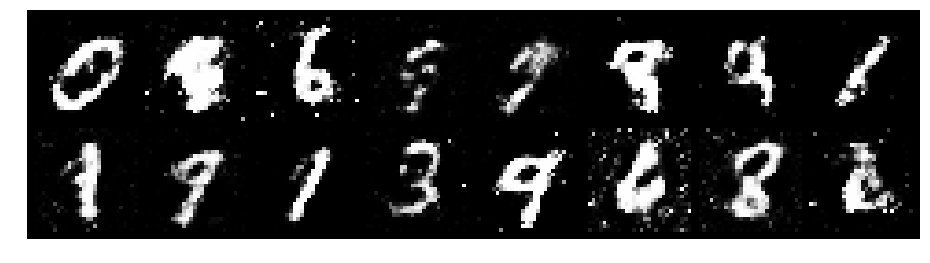

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.1610, Generator Loss: 1.2065
D(x): 0.5943, D(G(z)): 0.3336


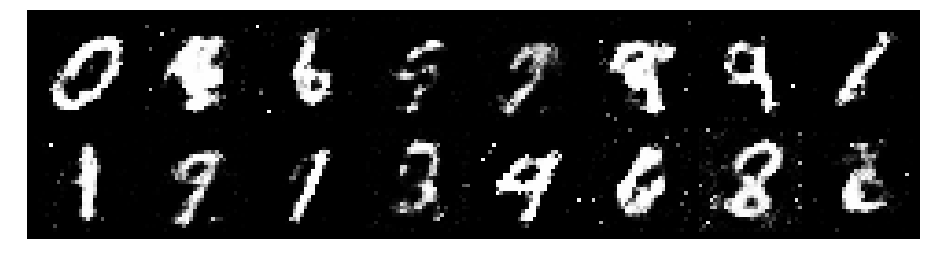

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.2371, Generator Loss: 1.1416
D(x): 0.6141, D(G(z)): 0.3989


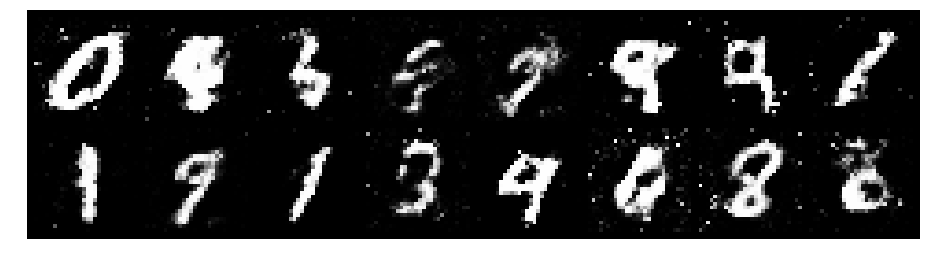

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.0263, Generator Loss: 1.3008
D(x): 0.6762, D(G(z)): 0.3739


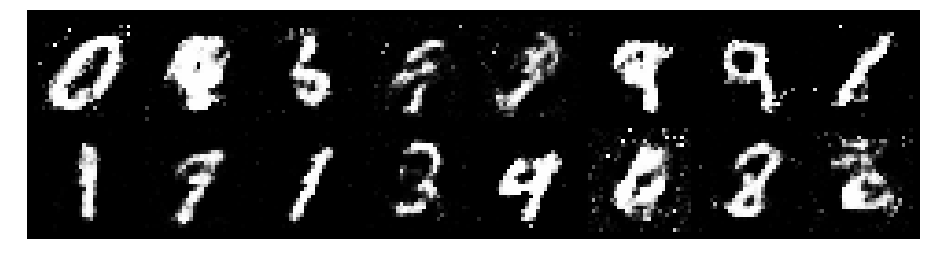

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 0.9255, Generator Loss: 1.3084
D(x): 0.6755, D(G(z)): 0.3336


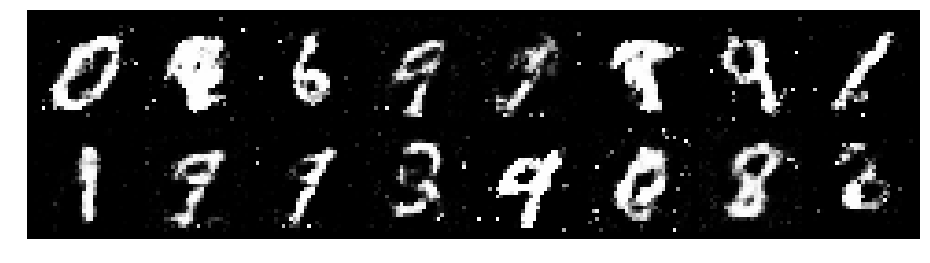

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.1494, Generator Loss: 1.0076
D(x): 0.6325, D(G(z)): 0.4258


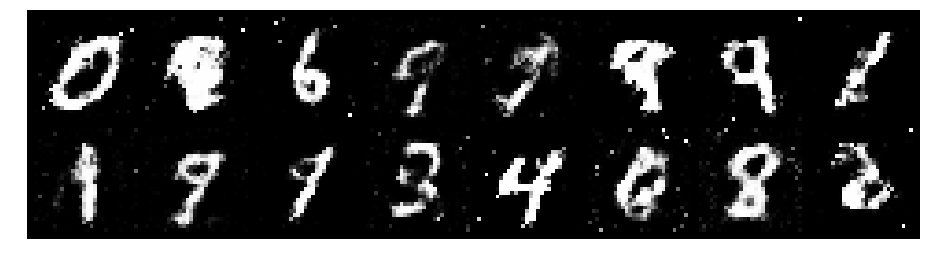

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.2355, Generator Loss: 0.9535
D(x): 0.6263, D(G(z)): 0.4777


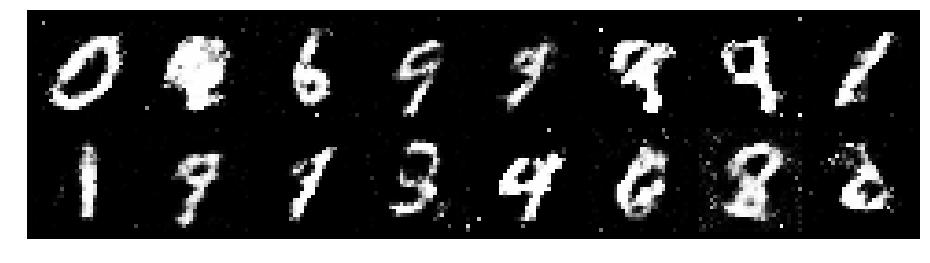

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.0722, Generator Loss: 1.3157
D(x): 0.6603, D(G(z)): 0.3873


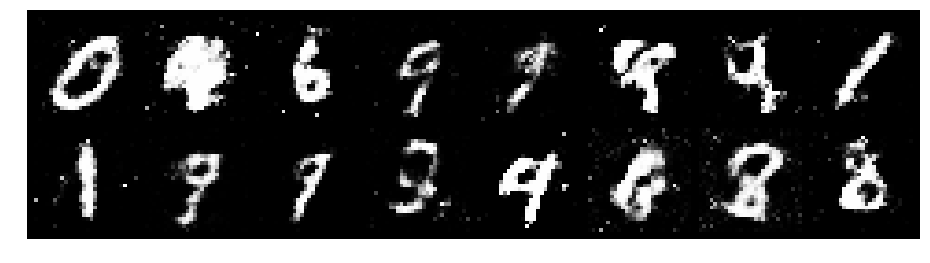

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.1135, Generator Loss: 1.2031
D(x): 0.6544, D(G(z)): 0.3928


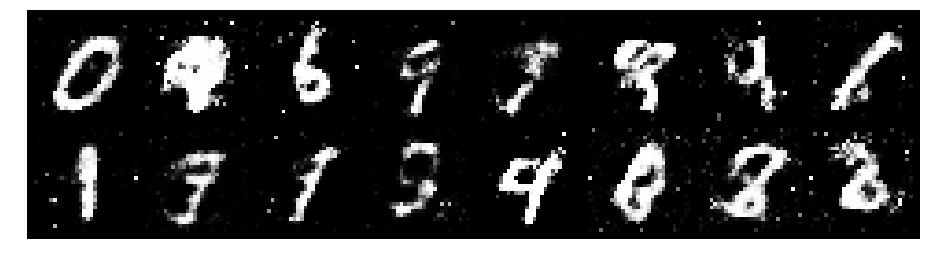

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1527, Generator Loss: 1.2741
D(x): 0.6143, D(G(z)): 0.3886


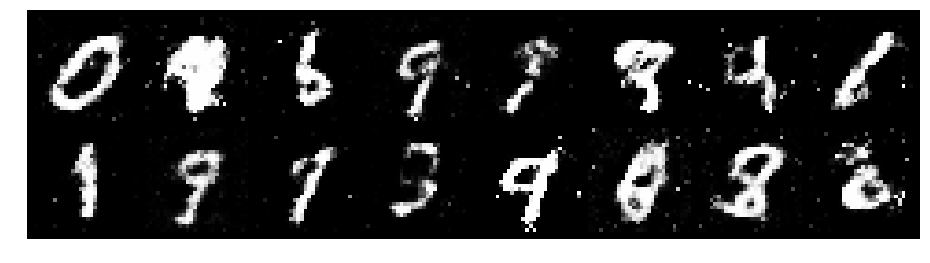

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 0.9793, Generator Loss: 1.5748
D(x): 0.6643, D(G(z)): 0.3324


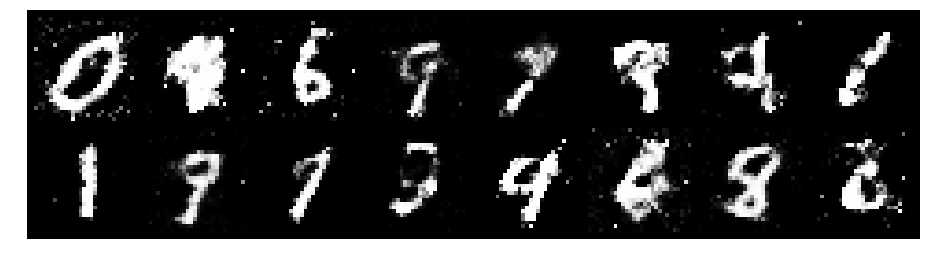

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1130, Generator Loss: 1.3121
D(x): 0.6103, D(G(z)): 0.3327


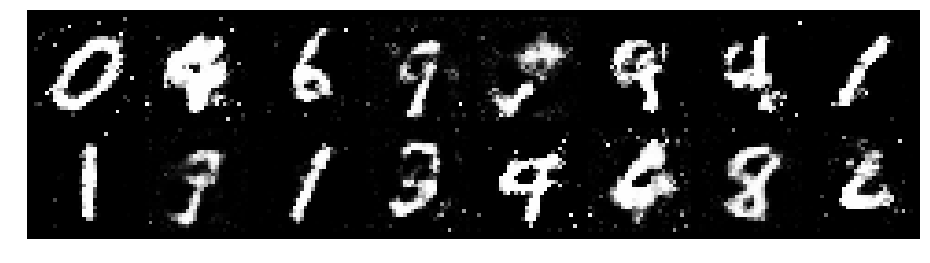

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 0.9449, Generator Loss: 1.3803
D(x): 0.6659, D(G(z)): 0.3435


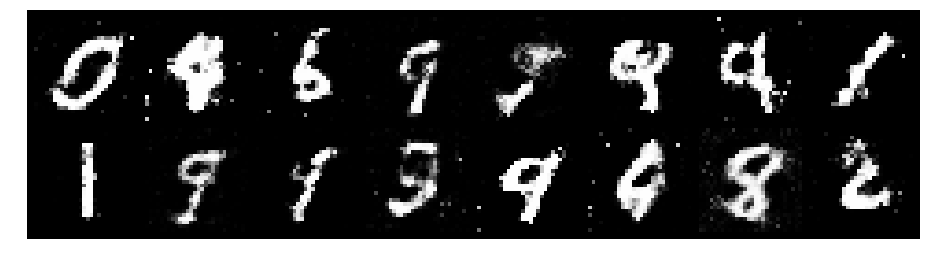

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.1542, Generator Loss: 1.0747
D(x): 0.6143, D(G(z)): 0.3832


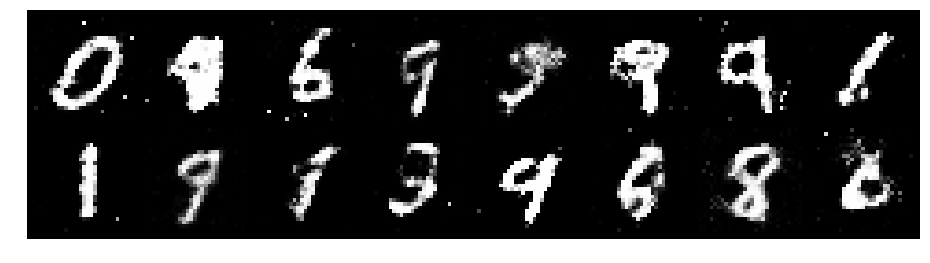

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.0495, Generator Loss: 1.0844
D(x): 0.6353, D(G(z)): 0.3551


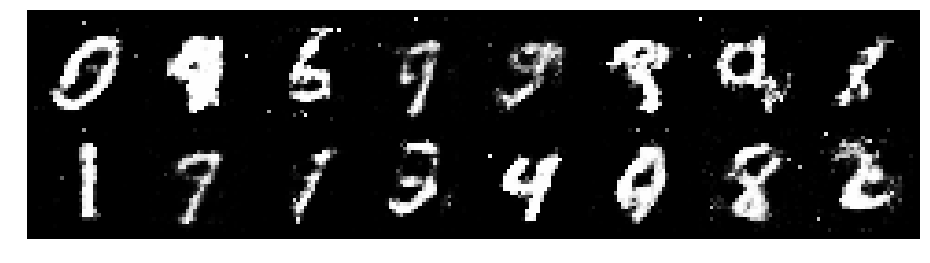

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 0.9660, Generator Loss: 1.0435
D(x): 0.6839, D(G(z)): 0.3938


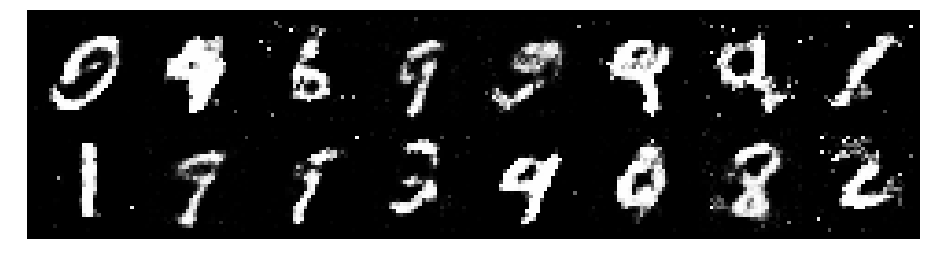

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.0148, Generator Loss: 1.2727
D(x): 0.6915, D(G(z)): 0.3726


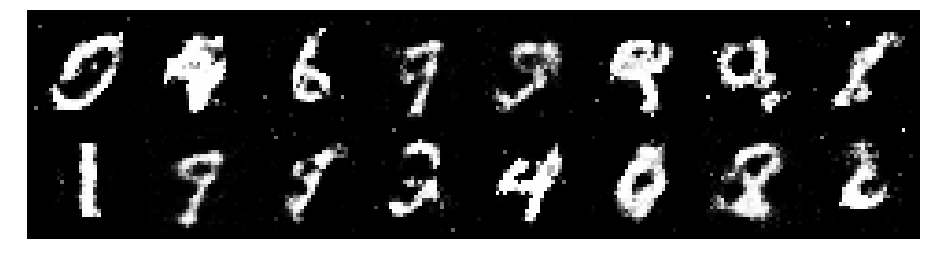

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 0.9150, Generator Loss: 1.2855
D(x): 0.7081, D(G(z)): 0.3687


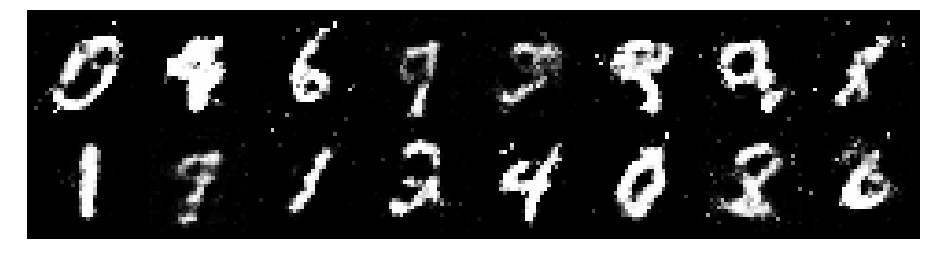

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.1678, Generator Loss: 1.0816
D(x): 0.6394, D(G(z)): 0.4198


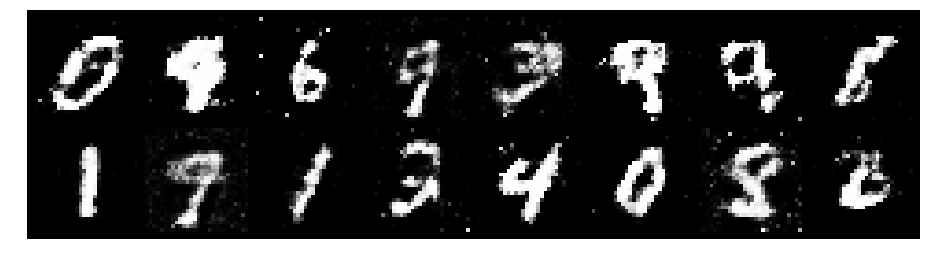

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.1670, Generator Loss: 1.1655
D(x): 0.6582, D(G(z)): 0.4441


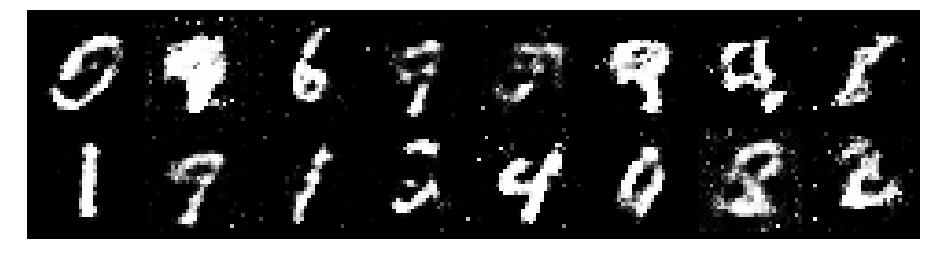

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.1445, Generator Loss: 1.1610
D(x): 0.5835, D(G(z)): 0.3522


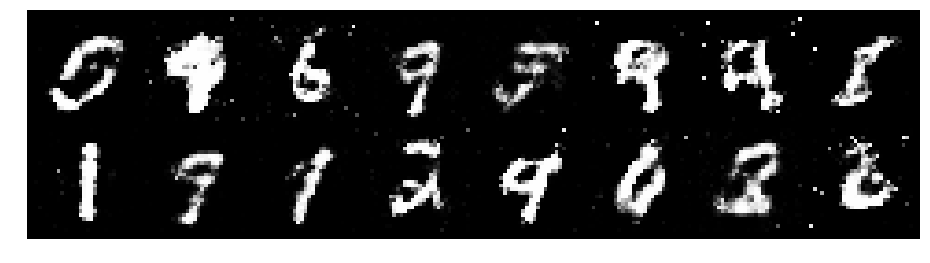

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.1512, Generator Loss: 1.1302
D(x): 0.6230, D(G(z)): 0.3856


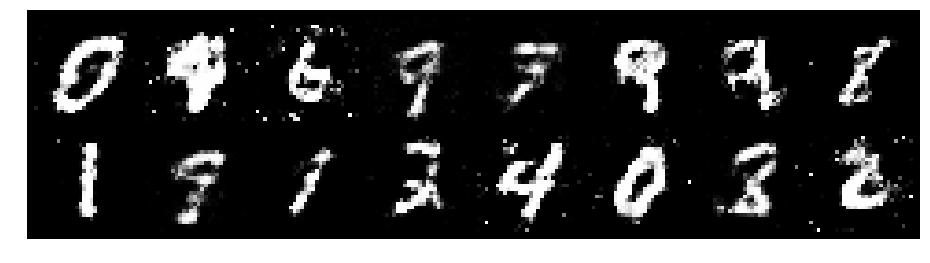

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1727, Generator Loss: 0.9886
D(x): 0.6211, D(G(z)): 0.4178


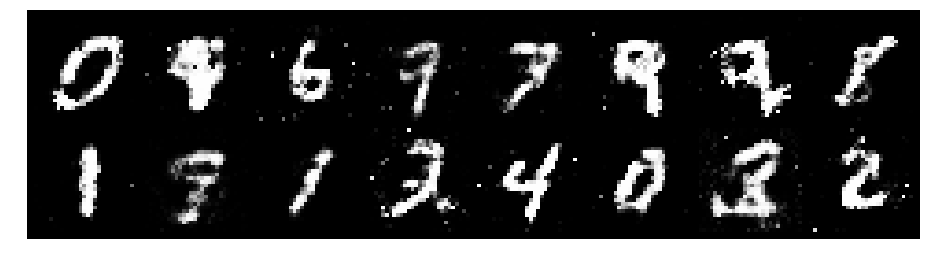

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0762, Generator Loss: 1.0968
D(x): 0.6361, D(G(z)): 0.3929


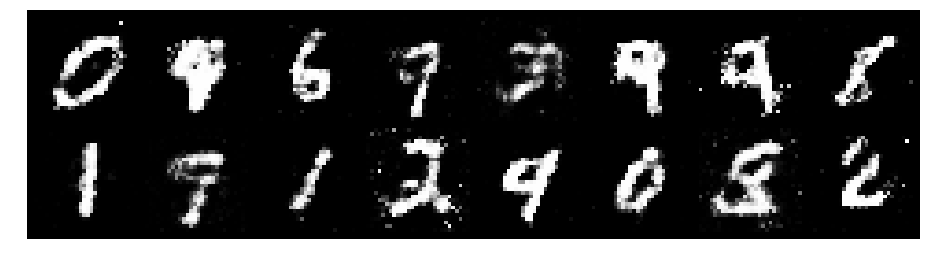

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.0503, Generator Loss: 1.0840
D(x): 0.6674, D(G(z)): 0.4013


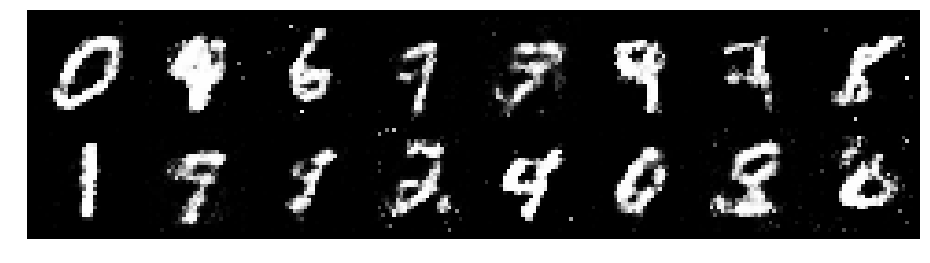

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.1246, Generator Loss: 1.5552
D(x): 0.5732, D(G(z)): 0.3034


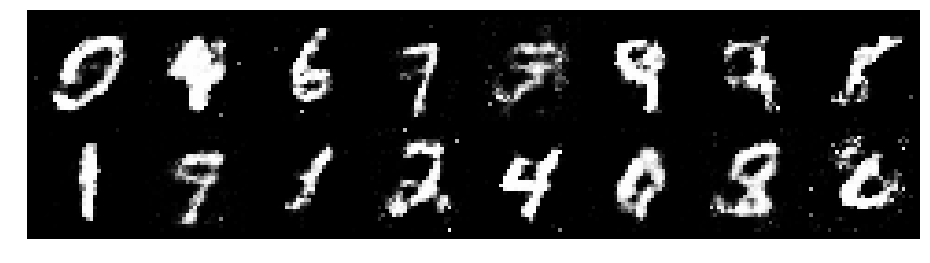

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0964, Generator Loss: 0.9548
D(x): 0.6523, D(G(z)): 0.4193


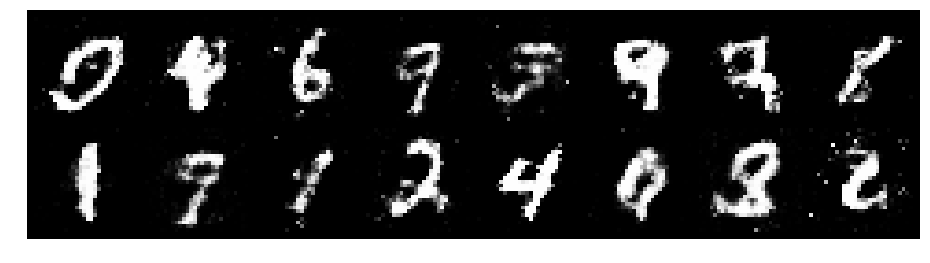

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.0647, Generator Loss: 1.0029
D(x): 0.6803, D(G(z)): 0.4152


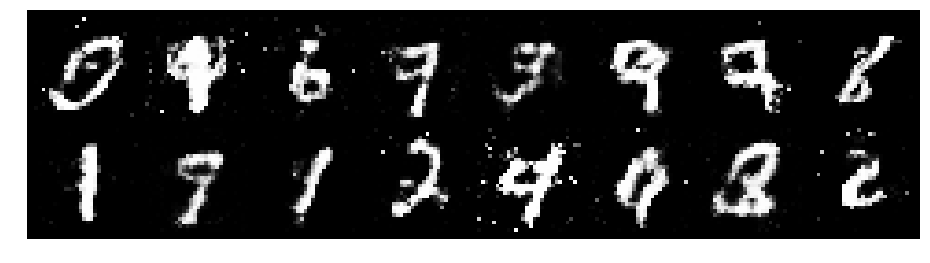

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.0589, Generator Loss: 1.4068
D(x): 0.6502, D(G(z)): 0.3520


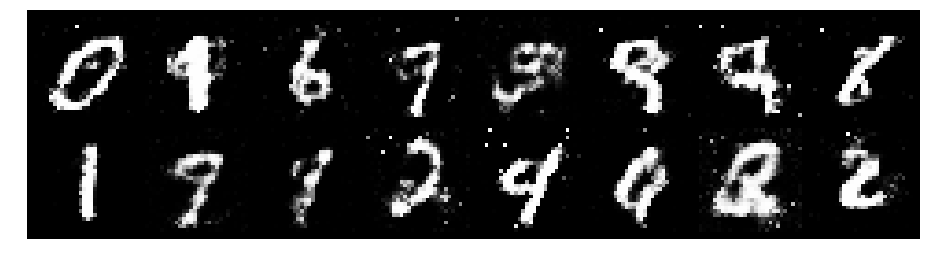

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.0934, Generator Loss: 1.1603
D(x): 0.7557, D(G(z)): 0.4592


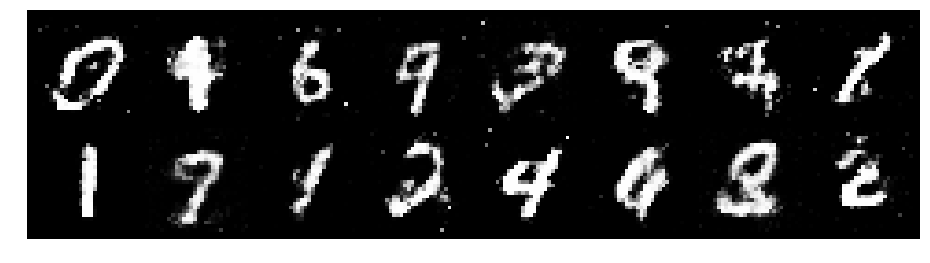

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 0.9128, Generator Loss: 1.7685
D(x): 0.7298, D(G(z)): 0.3469


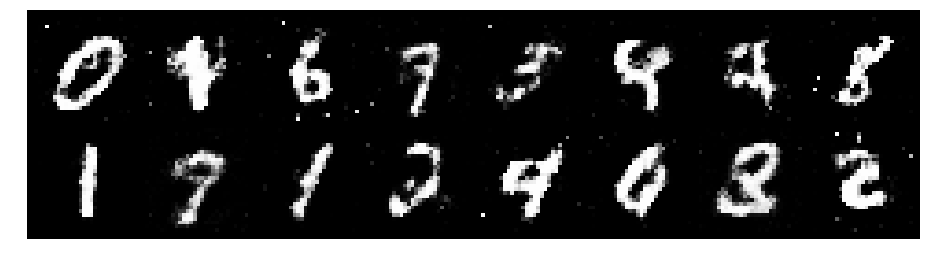

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 0.9868, Generator Loss: 1.2908
D(x): 0.6046, D(G(z)): 0.2763


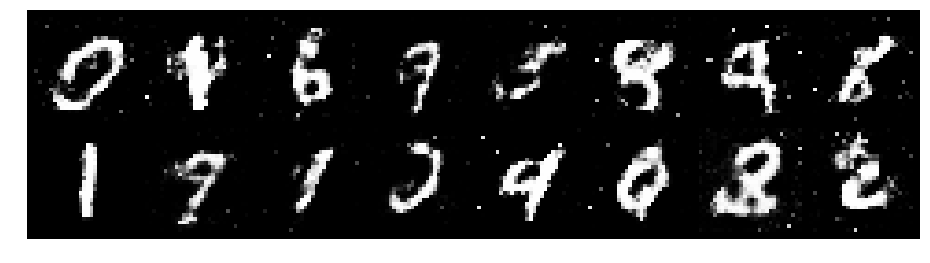

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1797, Generator Loss: 1.3851
D(x): 0.5277, D(G(z)): 0.3045


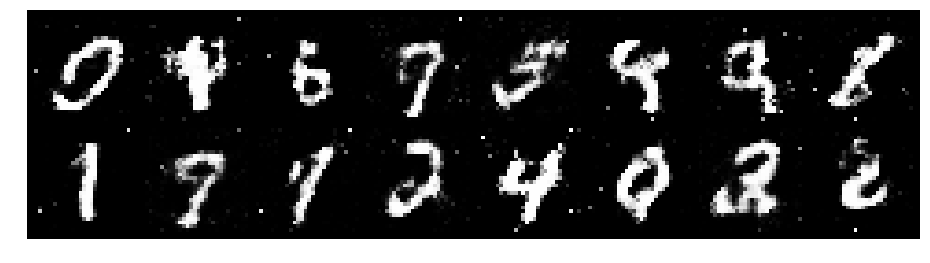

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.0278, Generator Loss: 1.2958
D(x): 0.6072, D(G(z)): 0.3419


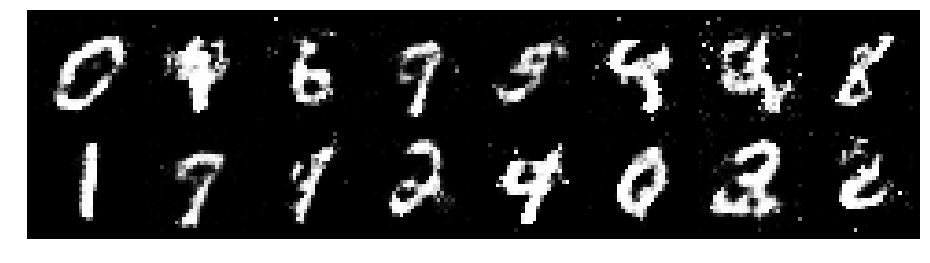

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.1454, Generator Loss: 1.0089
D(x): 0.6761, D(G(z)): 0.4084


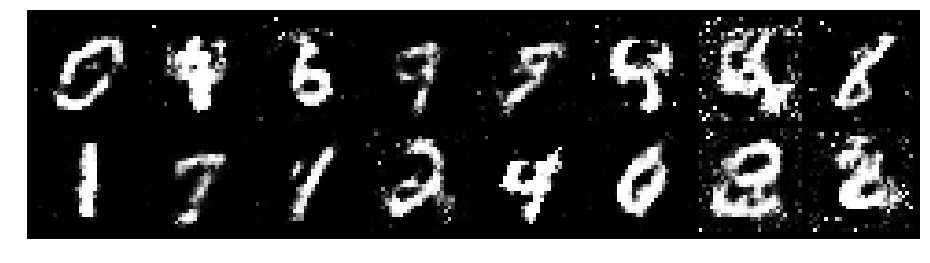

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1788, Generator Loss: 1.1756
D(x): 0.5936, D(G(z)): 0.3812


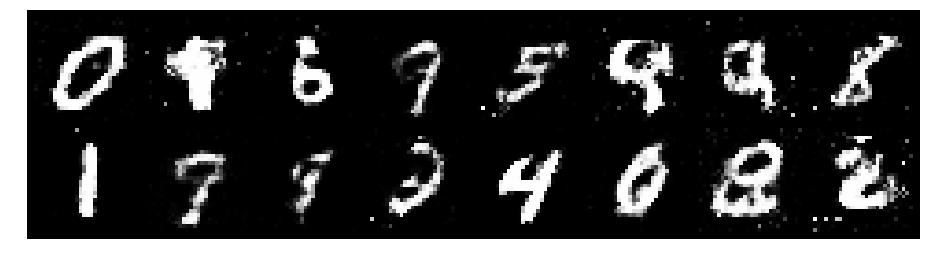

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1187, Generator Loss: 1.1133
D(x): 0.6546, D(G(z)): 0.4011


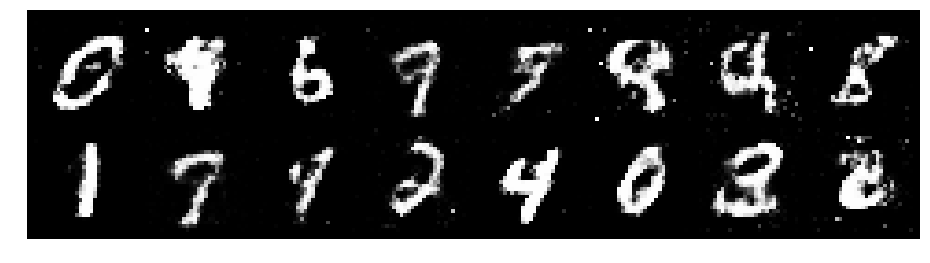

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1794, Generator Loss: 0.9978
D(x): 0.6168, D(G(z)): 0.4403


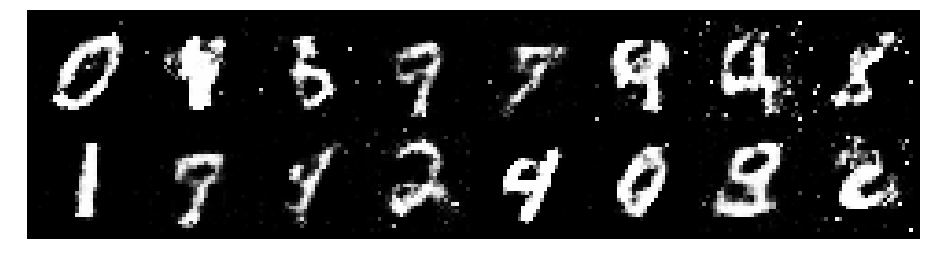

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 0.9434, Generator Loss: 1.2422
D(x): 0.6202, D(G(z)): 0.2908


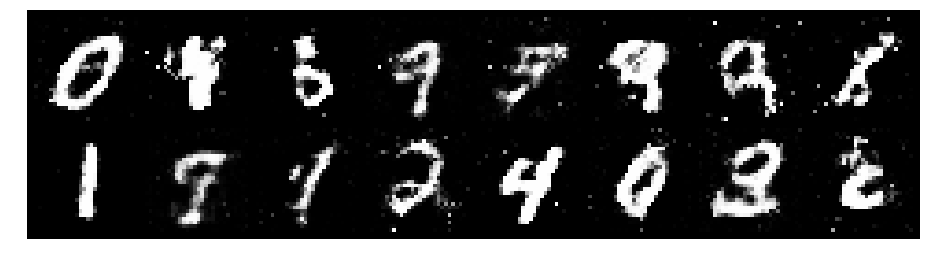

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 0.9889, Generator Loss: 1.4295
D(x): 0.5955, D(G(z)): 0.2918


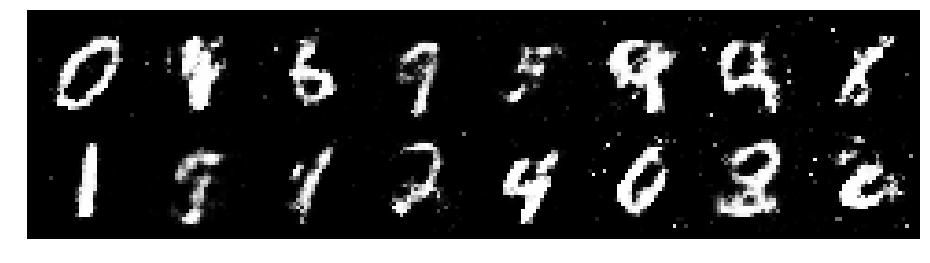

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 0.9456, Generator Loss: 1.2768
D(x): 0.6970, D(G(z)): 0.3672


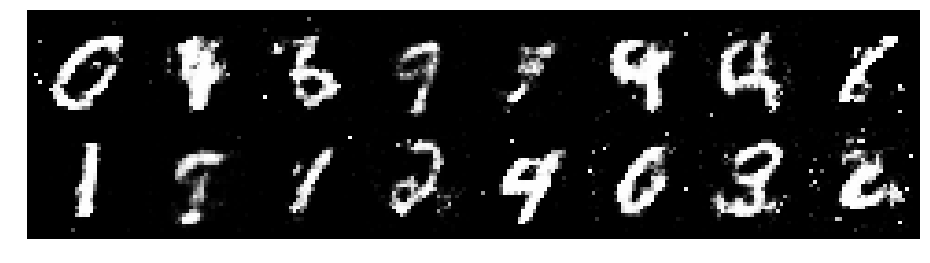

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.0561, Generator Loss: 1.3355
D(x): 0.5735, D(G(z)): 0.3107


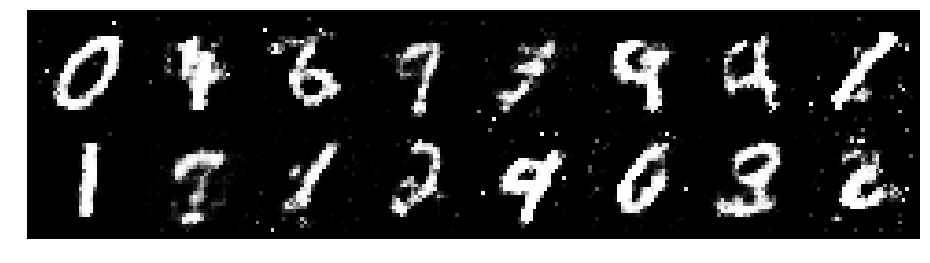

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.0692, Generator Loss: 1.2113
D(x): 0.5905, D(G(z)): 0.3288


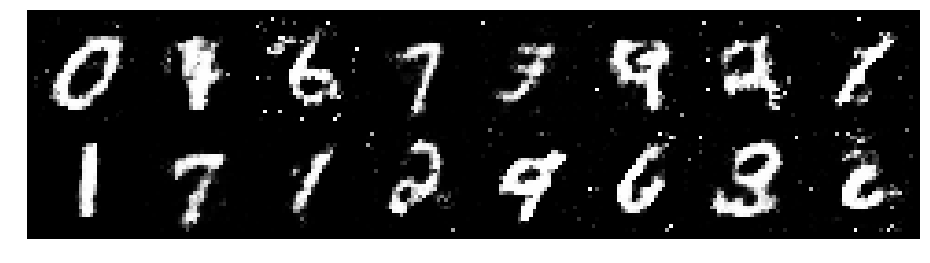

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.0970, Generator Loss: 1.1253
D(x): 0.5980, D(G(z)): 0.3719


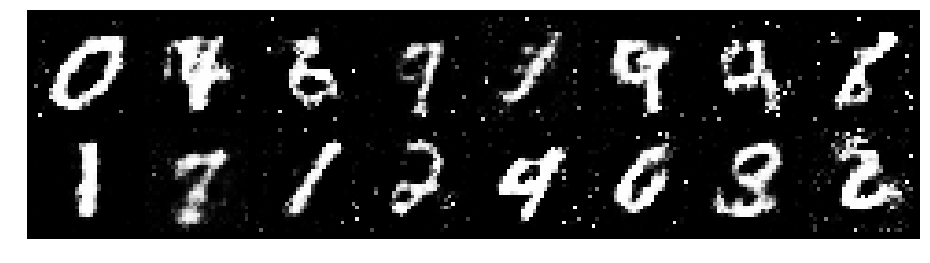

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.1392, Generator Loss: 1.0368
D(x): 0.6262, D(G(z)): 0.4175


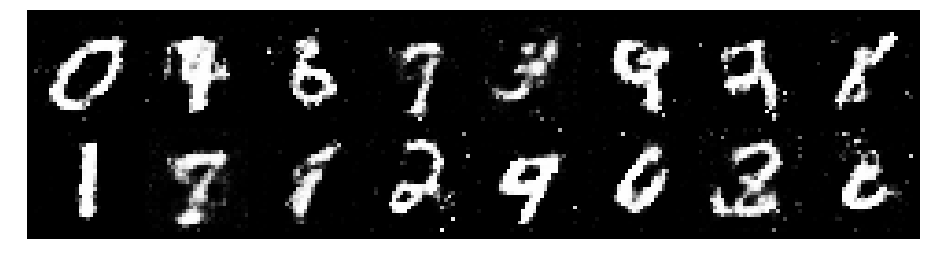

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.2080, Generator Loss: 1.1417
D(x): 0.5889, D(G(z)): 0.4063


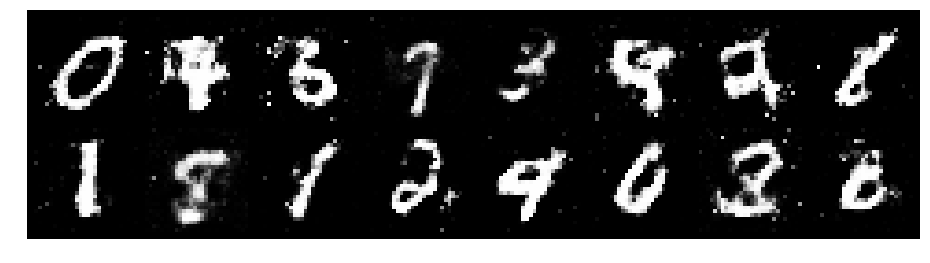

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.1533, Generator Loss: 1.0249
D(x): 0.6407, D(G(z)): 0.4407


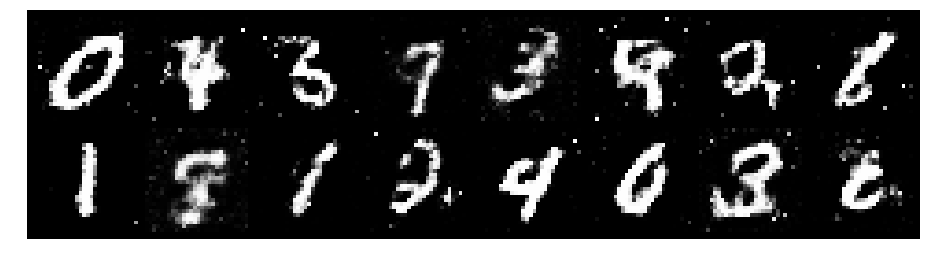

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.1483, Generator Loss: 0.9942
D(x): 0.6559, D(G(z)): 0.4471


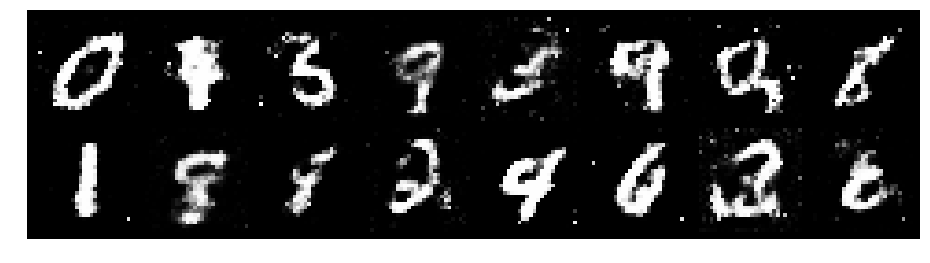

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.1041, Generator Loss: 1.0689
D(x): 0.6084, D(G(z)): 0.3728


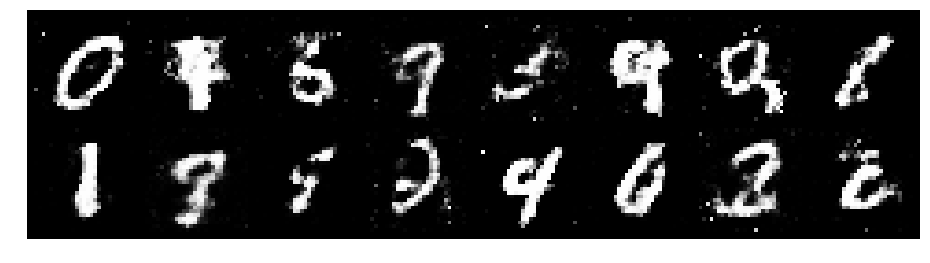

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 0.9328, Generator Loss: 1.5828
D(x): 0.7294, D(G(z)): 0.3607


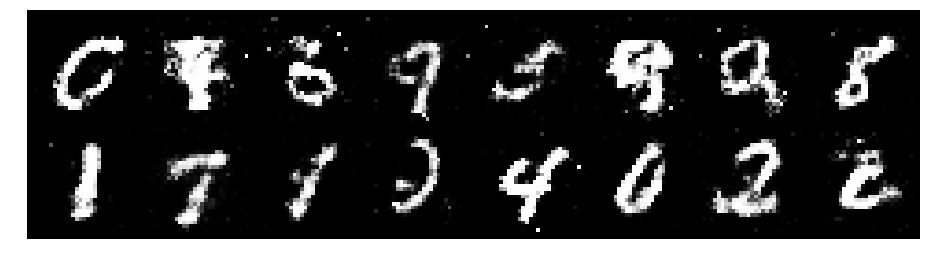

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.0253, Generator Loss: 1.4331
D(x): 0.6561, D(G(z)): 0.3580


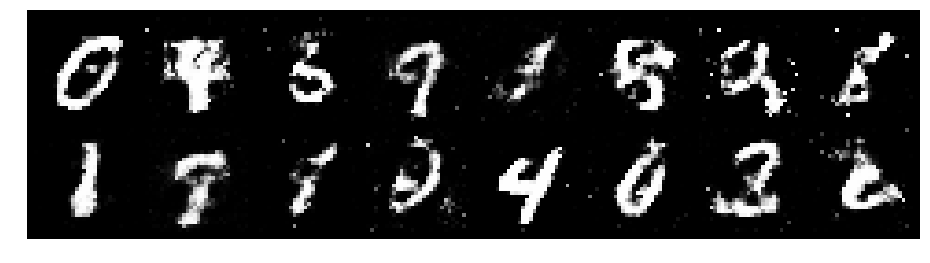

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2350, Generator Loss: 1.0387
D(x): 0.6466, D(G(z)): 0.4583


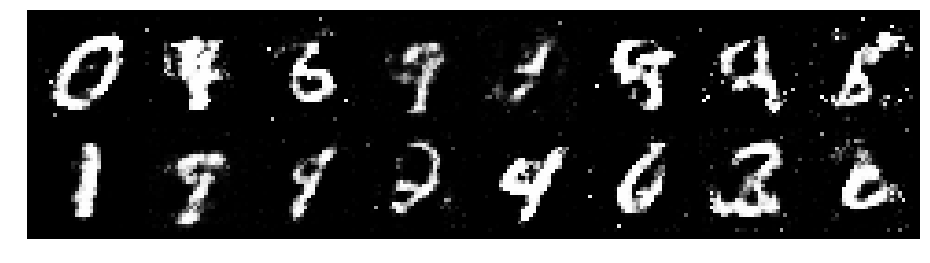

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.1448, Generator Loss: 1.0522
D(x): 0.5978, D(G(z)): 0.3796


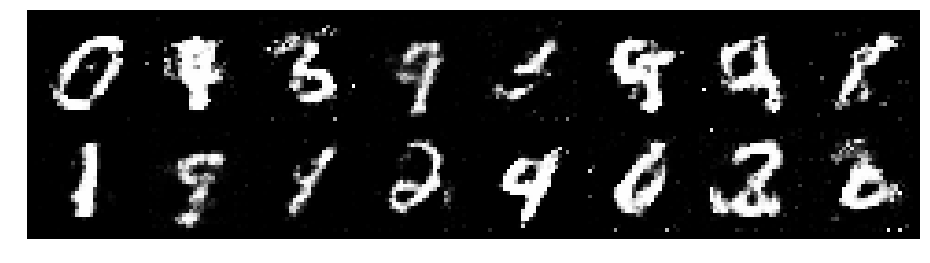

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.2021, Generator Loss: 1.2549
D(x): 0.5986, D(G(z)): 0.3999


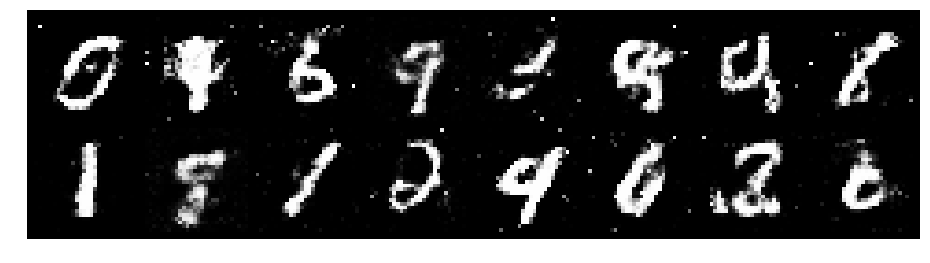

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1403, Generator Loss: 1.1486
D(x): 0.6338, D(G(z)): 0.4058


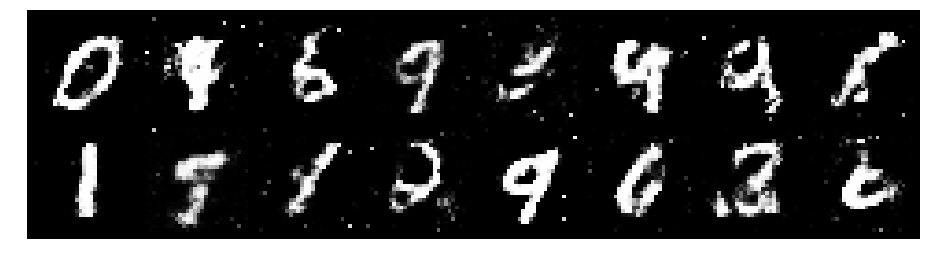

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.2982, Generator Loss: 1.0848
D(x): 0.6152, D(G(z)): 0.4515


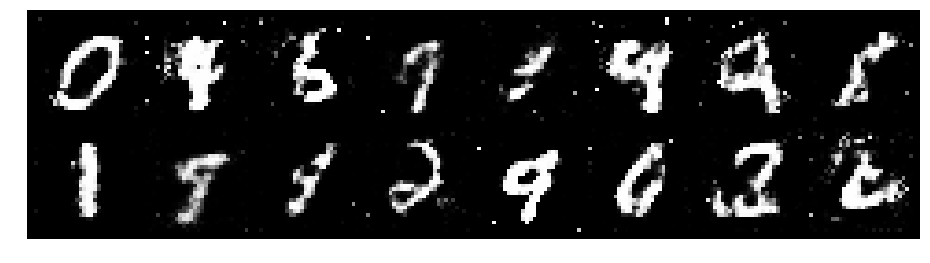

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1044, Generator Loss: 1.2293
D(x): 0.5984, D(G(z)): 0.3718


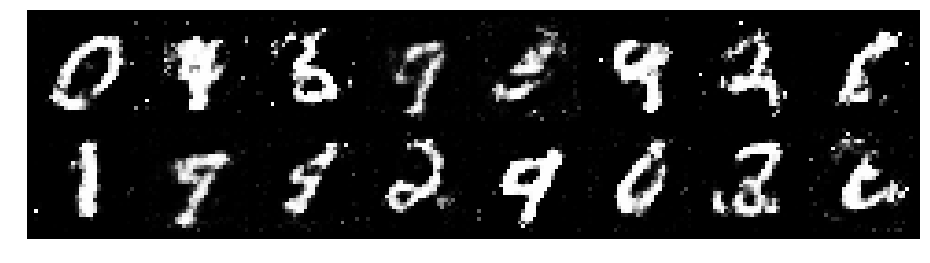

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.0387, Generator Loss: 1.2281
D(x): 0.6676, D(G(z)): 0.3902


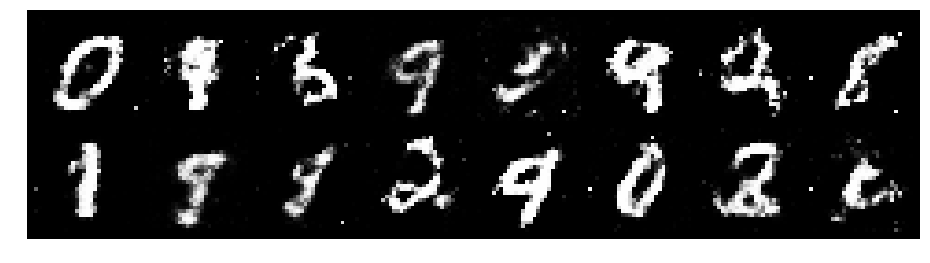

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.0838, Generator Loss: 1.2338
D(x): 0.6187, D(G(z)): 0.3389


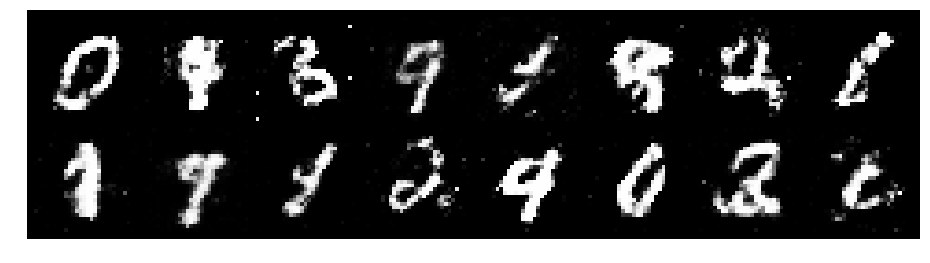

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0403, Generator Loss: 1.0310
D(x): 0.6435, D(G(z)): 0.3717


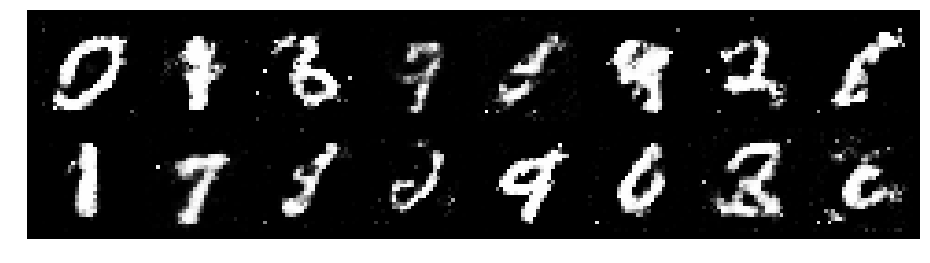

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.0153, Generator Loss: 1.6783
D(x): 0.6256, D(G(z)): 0.3281


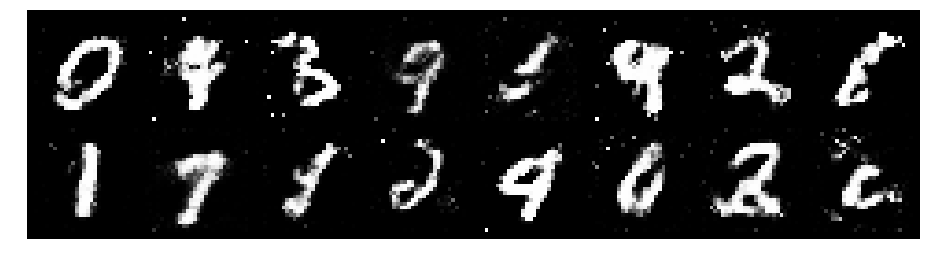

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.0840, Generator Loss: 1.4907
D(x): 0.5965, D(G(z)): 0.3336


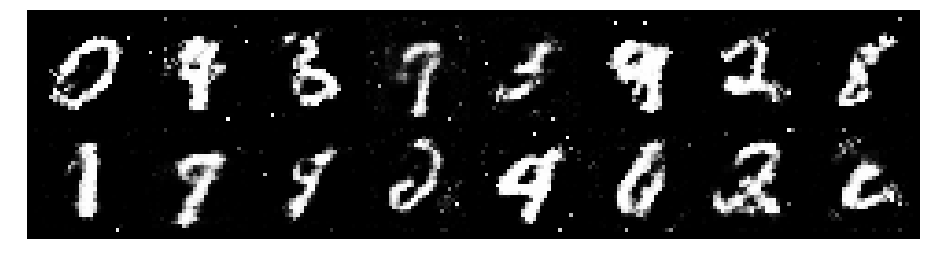

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.0726, Generator Loss: 1.1730
D(x): 0.6431, D(G(z)): 0.3748


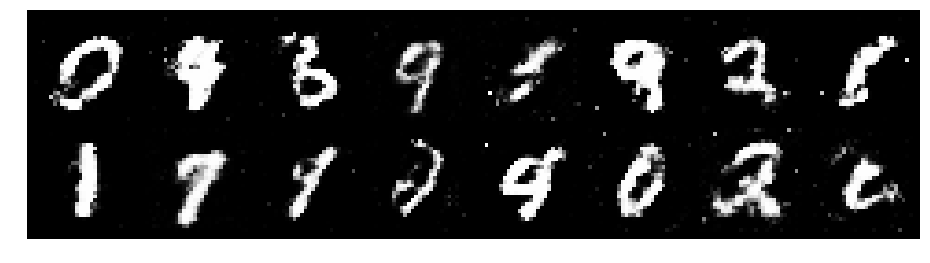

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.0944, Generator Loss: 1.1768
D(x): 0.6177, D(G(z)): 0.3688


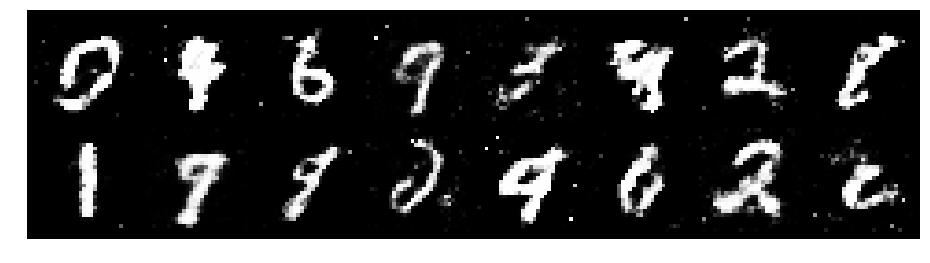

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1478, Generator Loss: 1.0875
D(x): 0.5781, D(G(z)): 0.3896


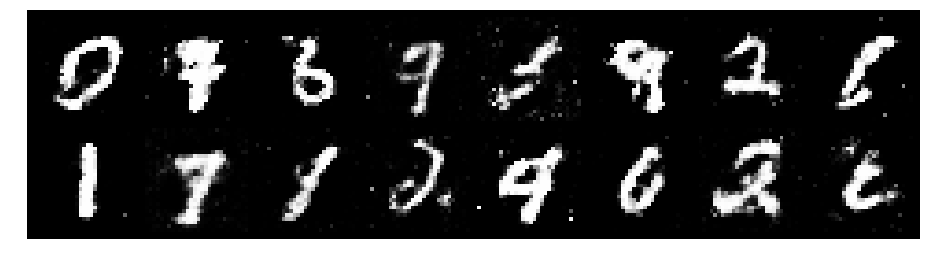

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.0709, Generator Loss: 1.3158
D(x): 0.5865, D(G(z)): 0.3089


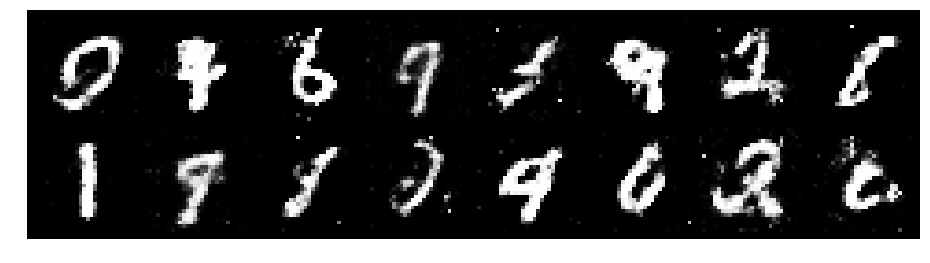

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.0654, Generator Loss: 1.1330
D(x): 0.6490, D(G(z)): 0.4051


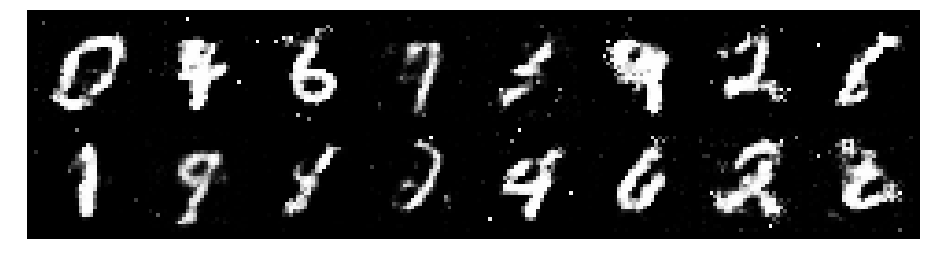

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1288, Generator Loss: 0.9877
D(x): 0.5782, D(G(z)): 0.3543


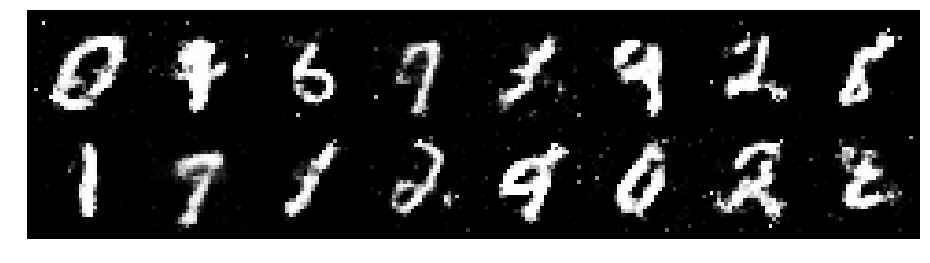

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1345, Generator Loss: 1.1098
D(x): 0.5796, D(G(z)): 0.3456


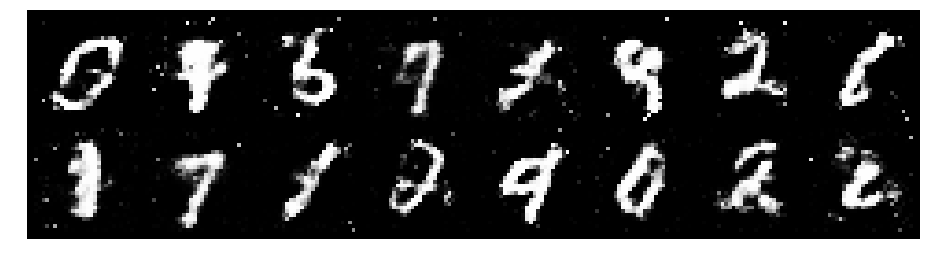

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1725, Generator Loss: 1.1164
D(x): 0.5810, D(G(z)): 0.3972


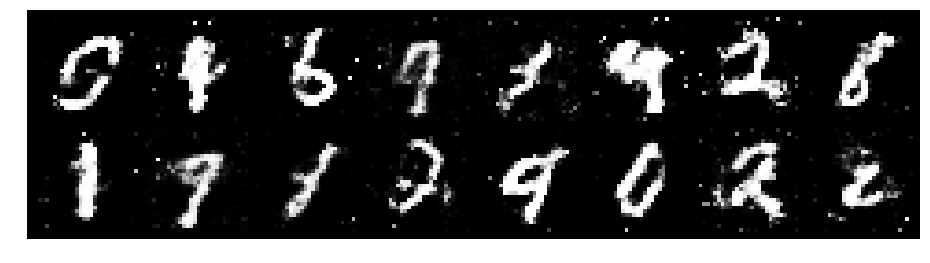

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1283, Generator Loss: 1.1796
D(x): 0.5737, D(G(z)): 0.3713


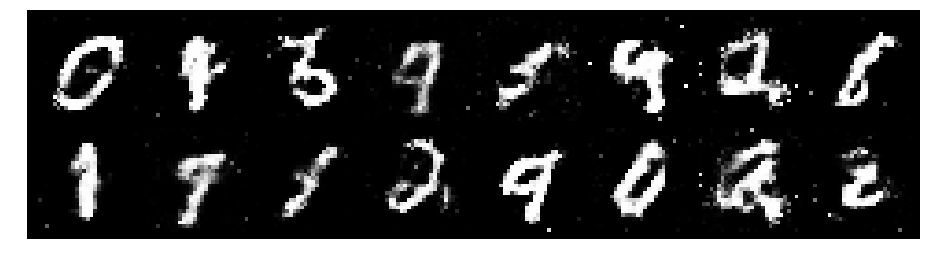

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0402, Generator Loss: 1.2215
D(x): 0.5813, D(G(z)): 0.3106


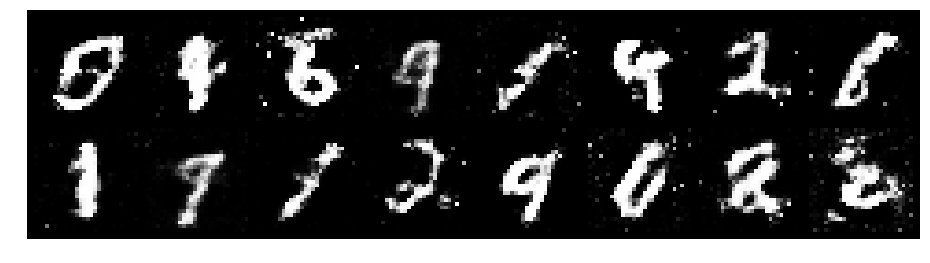

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1088, Generator Loss: 1.0285
D(x): 0.6305, D(G(z)): 0.3902


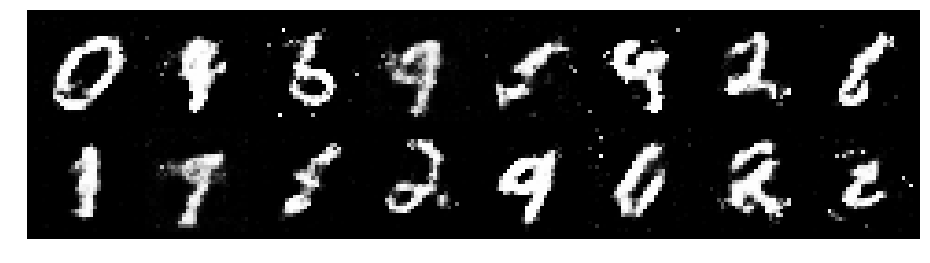

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.2194, Generator Loss: 1.1821
D(x): 0.5567, D(G(z)): 0.3444


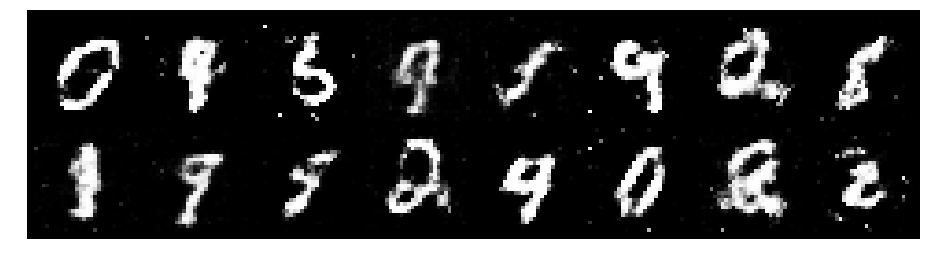

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.0510, Generator Loss: 1.0826
D(x): 0.6509, D(G(z)): 0.3952


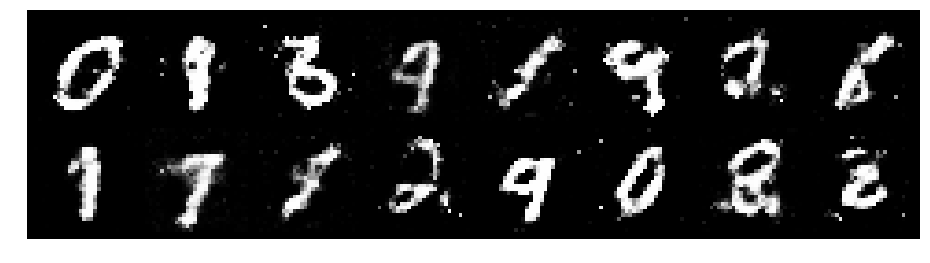

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1196, Generator Loss: 0.8507
D(x): 0.6050, D(G(z)): 0.3997


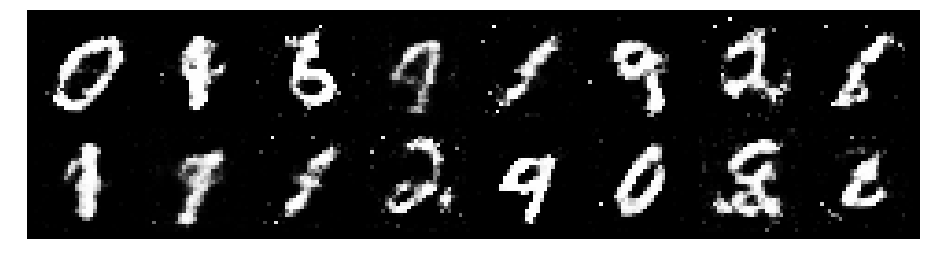

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1780, Generator Loss: 1.5511
D(x): 0.5545, D(G(z)): 0.2940


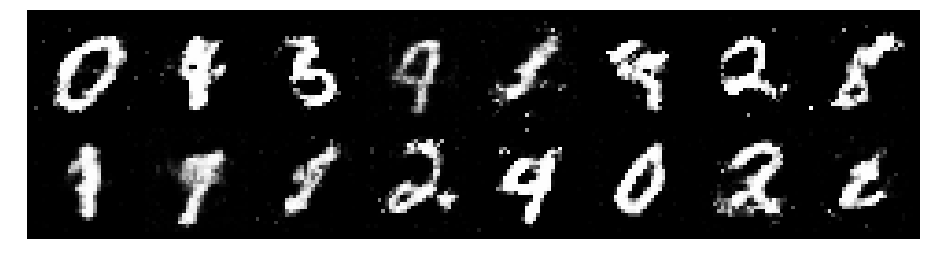

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.1925, Generator Loss: 1.0780
D(x): 0.5920, D(G(z)): 0.3965


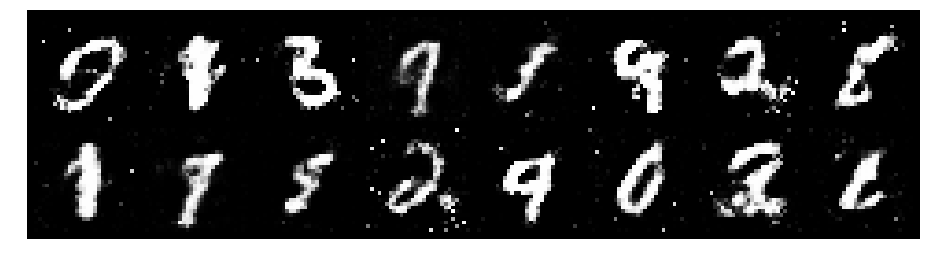

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.3299, Generator Loss: 0.8863
D(x): 0.5787, D(G(z)): 0.4724


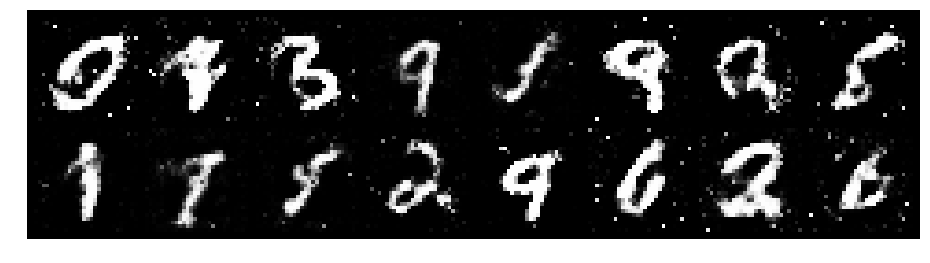

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1672, Generator Loss: 0.8673
D(x): 0.6420, D(G(z)): 0.4533


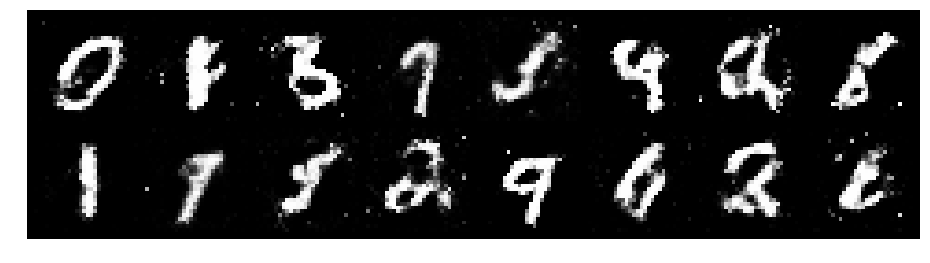

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.2331, Generator Loss: 0.9278
D(x): 0.6348, D(G(z)): 0.4709


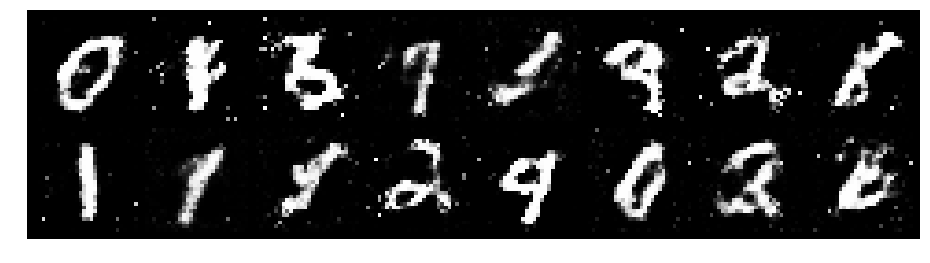

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.1835, Generator Loss: 0.8735
D(x): 0.7126, D(G(z)): 0.4882


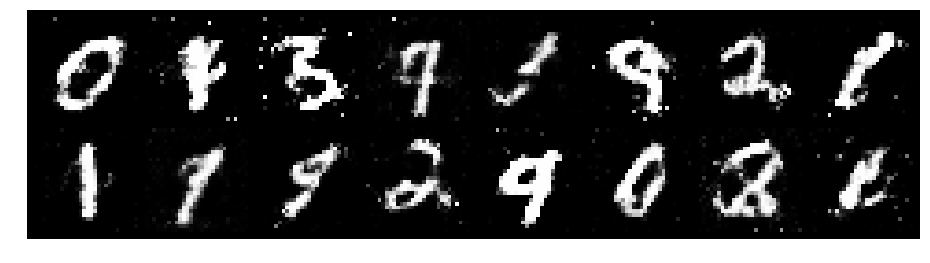

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.2608, Generator Loss: 1.2694
D(x): 0.6035, D(G(z)): 0.4212


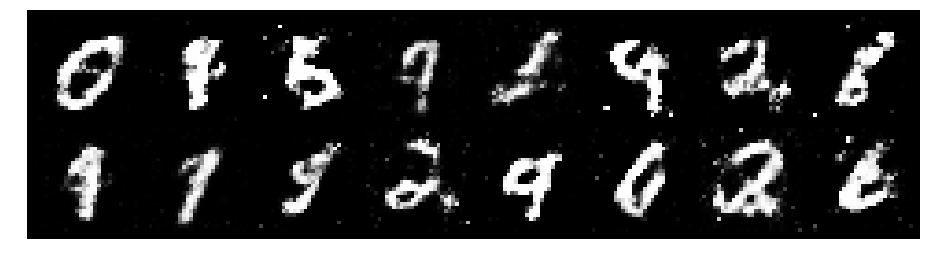

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.1626, Generator Loss: 1.1690
D(x): 0.6777, D(G(z)): 0.4387


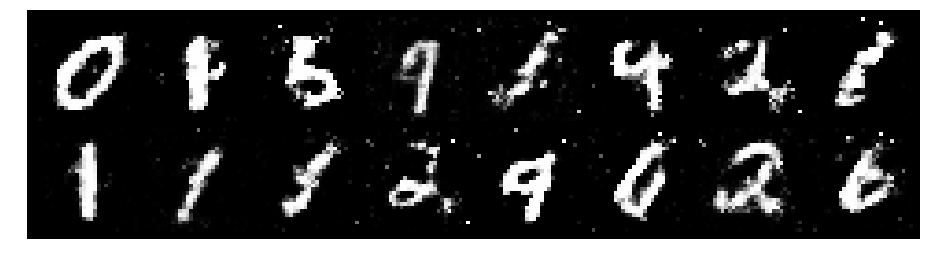

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.1050, Generator Loss: 1.1486
D(x): 0.6341, D(G(z)): 0.3934


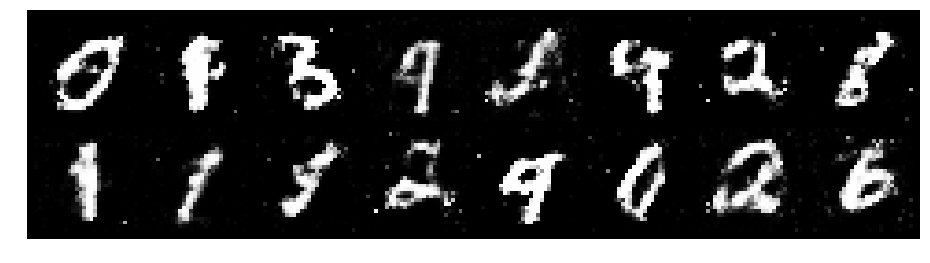

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.3211, Generator Loss: 1.0461
D(x): 0.5784, D(G(z)): 0.4521


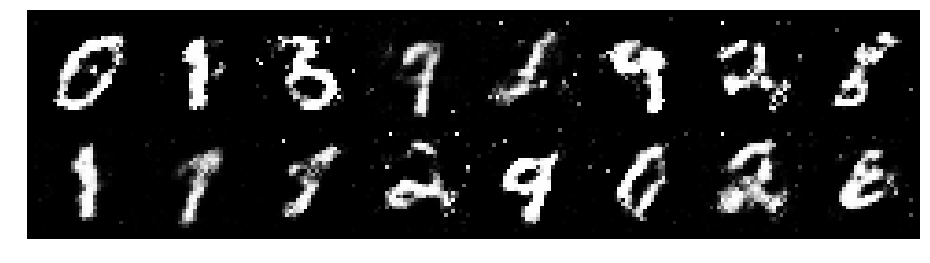

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.2092, Generator Loss: 1.0522
D(x): 0.5995, D(G(z)): 0.4329


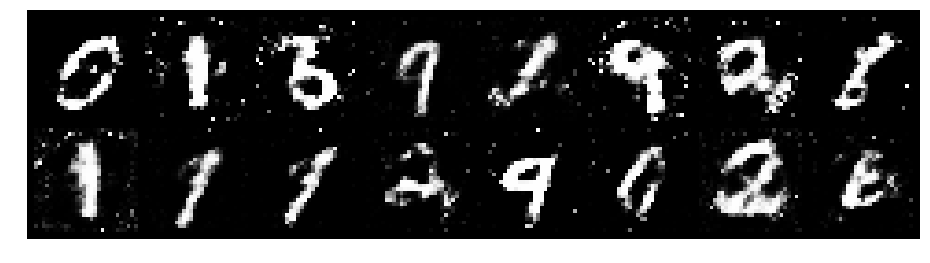

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.2239, Generator Loss: 0.8565
D(x): 0.6111, D(G(z)): 0.4700


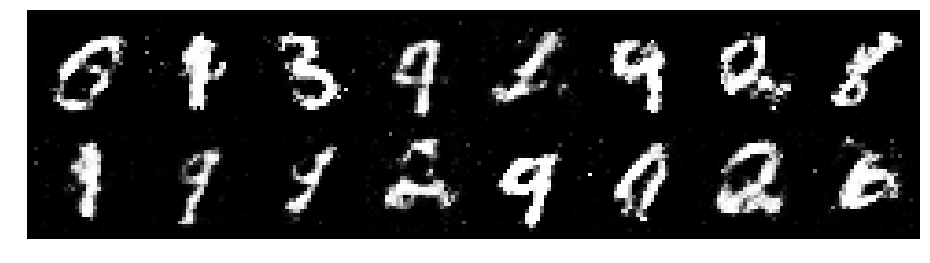

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1582, Generator Loss: 1.1079
D(x): 0.6007, D(G(z)): 0.3727


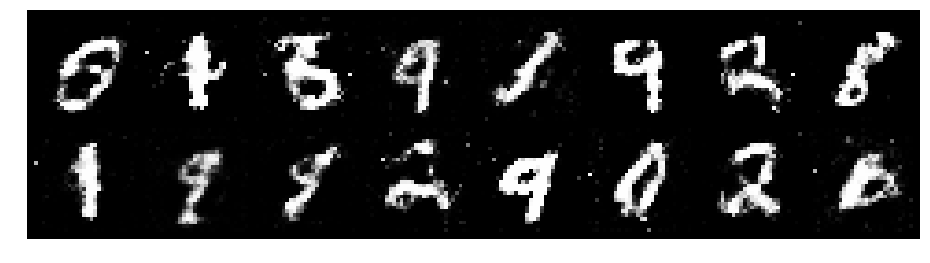

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1746, Generator Loss: 1.0948
D(x): 0.5719, D(G(z)): 0.4019


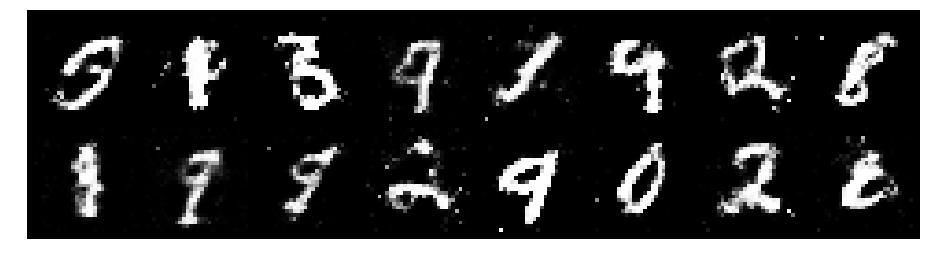

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.2591, Generator Loss: 1.0020
D(x): 0.5653, D(G(z)): 0.3846


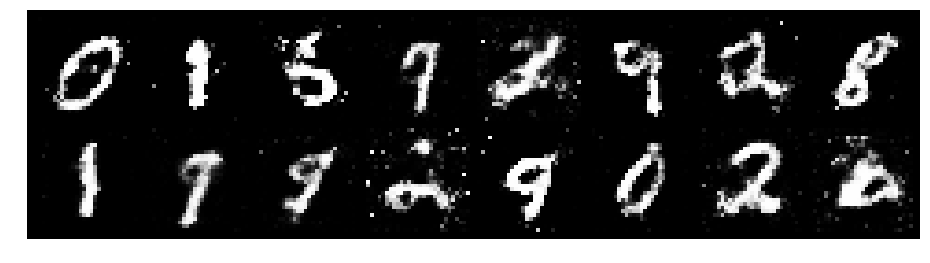

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1513, Generator Loss: 1.3484
D(x): 0.5980, D(G(z)): 0.3386


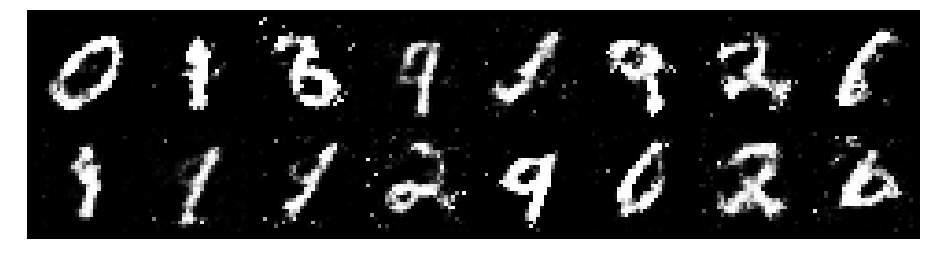

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1219, Generator Loss: 1.2351
D(x): 0.5928, D(G(z)): 0.3651


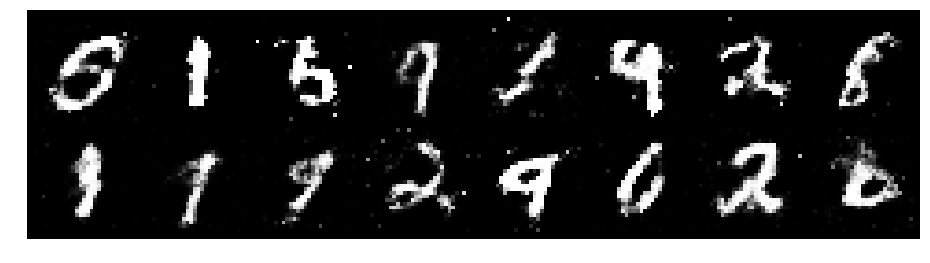

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1871, Generator Loss: 1.3271
D(x): 0.5717, D(G(z)): 0.3860


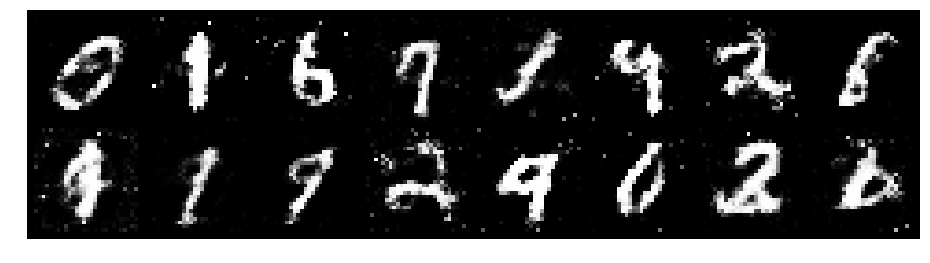

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.0287, Generator Loss: 1.0040
D(x): 0.6341, D(G(z)): 0.3639


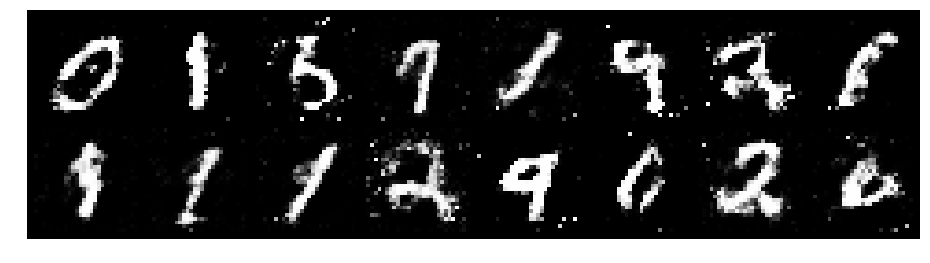

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.0381, Generator Loss: 1.1220
D(x): 0.6107, D(G(z)): 0.3539


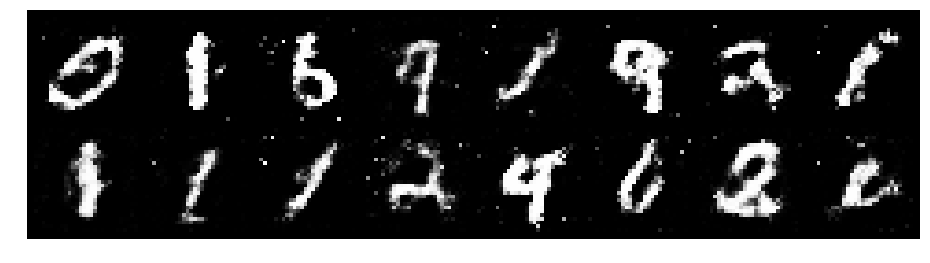

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1070, Generator Loss: 1.2322
D(x): 0.6508, D(G(z)): 0.4080


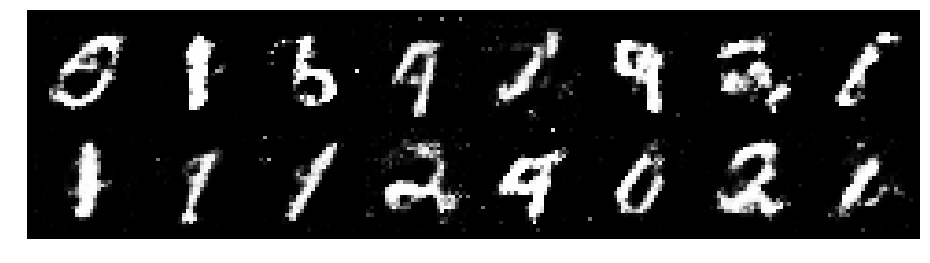

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1331, Generator Loss: 1.2780
D(x): 0.5885, D(G(z)): 0.3721


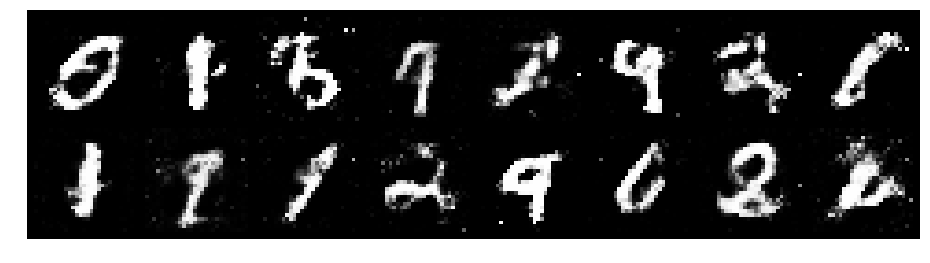

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2681, Generator Loss: 1.0059
D(x): 0.5389, D(G(z)): 0.3804


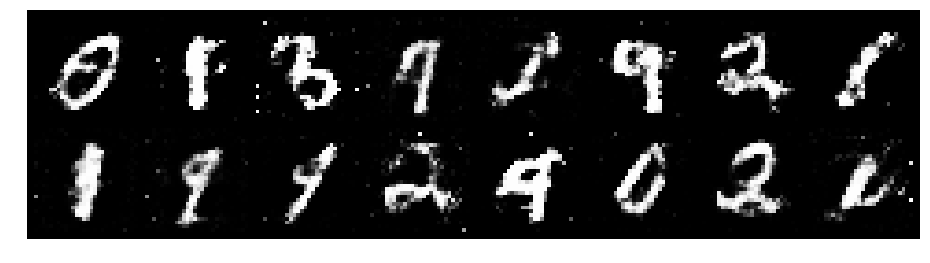

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.2605, Generator Loss: 1.1118
D(x): 0.5420, D(G(z)): 0.3895


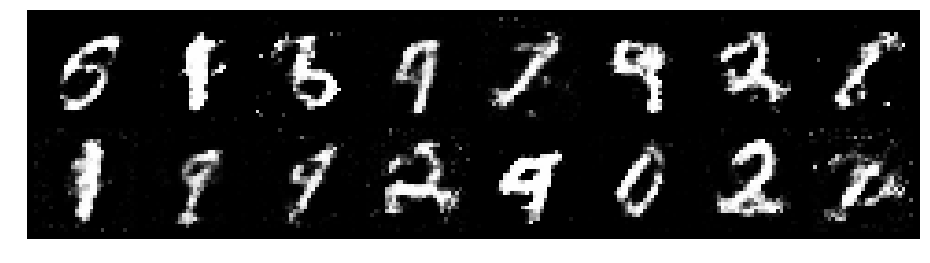

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.1667, Generator Loss: 1.2356
D(x): 0.5553, D(G(z)): 0.3629


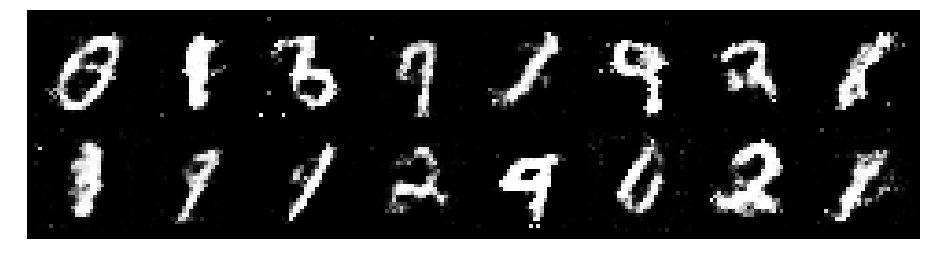

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.1551, Generator Loss: 0.9079
D(x): 0.6061, D(G(z)): 0.4293


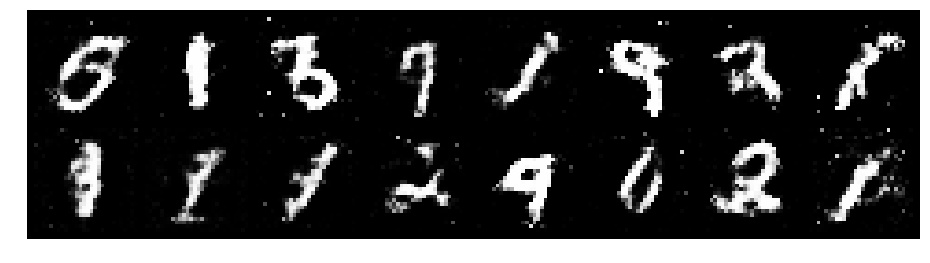

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.2735, Generator Loss: 1.1082
D(x): 0.5814, D(G(z)): 0.4279


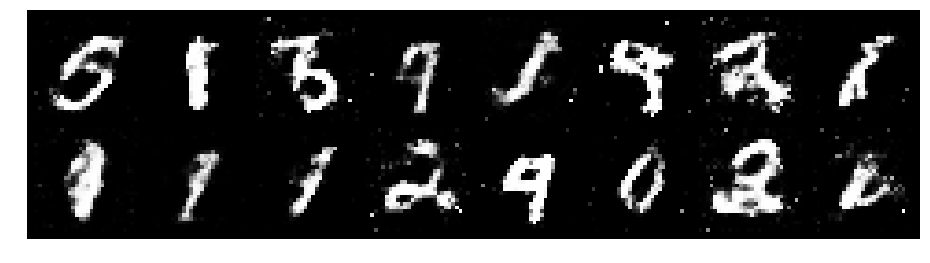

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.2915, Generator Loss: 0.9324
D(x): 0.5812, D(G(z)): 0.4449


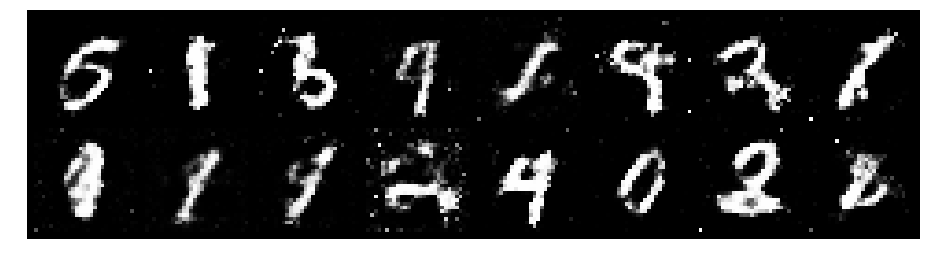

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.2374, Generator Loss: 1.0334
D(x): 0.5702, D(G(z)): 0.3993


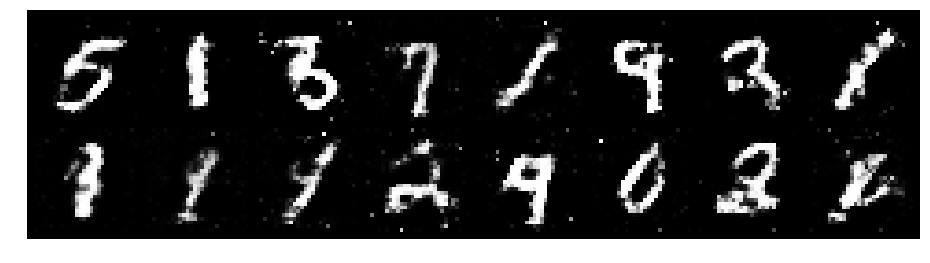

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.1132, Generator Loss: 1.0567
D(x): 0.5879, D(G(z)): 0.3770


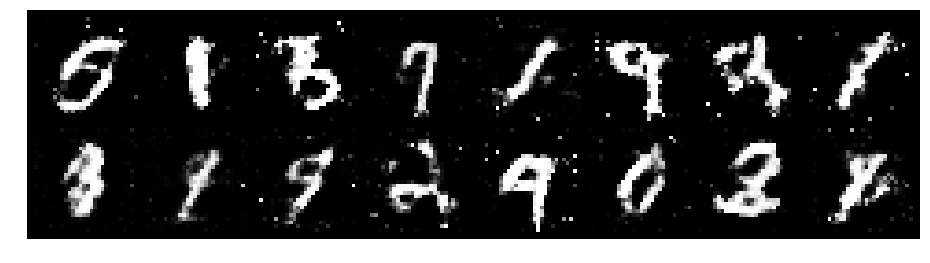

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1842, Generator Loss: 1.0564
D(x): 0.6061, D(G(z)): 0.4176


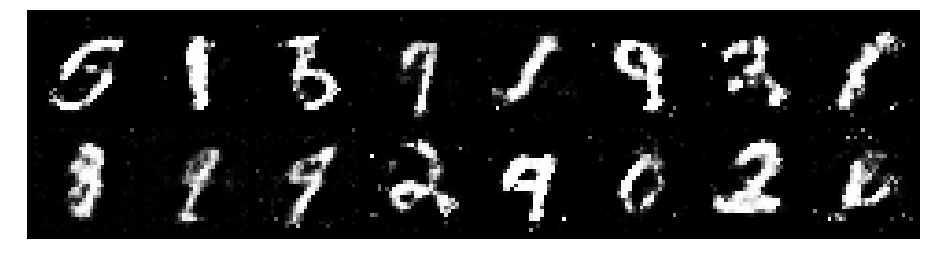

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.1678, Generator Loss: 1.1696
D(x): 0.6047, D(G(z)): 0.4119


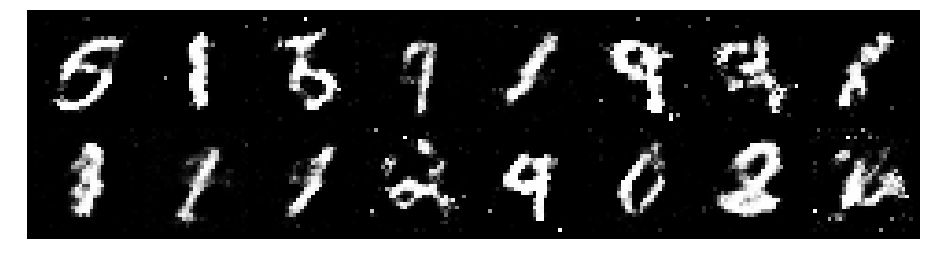

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2487, Generator Loss: 1.1145
D(x): 0.5720, D(G(z)): 0.4185


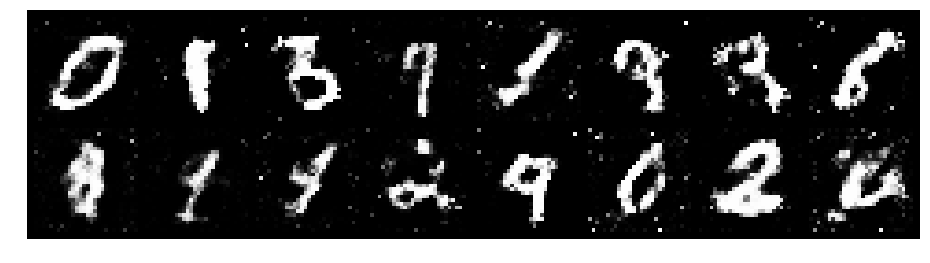

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.0718, Generator Loss: 1.0713
D(x): 0.6208, D(G(z)): 0.3915


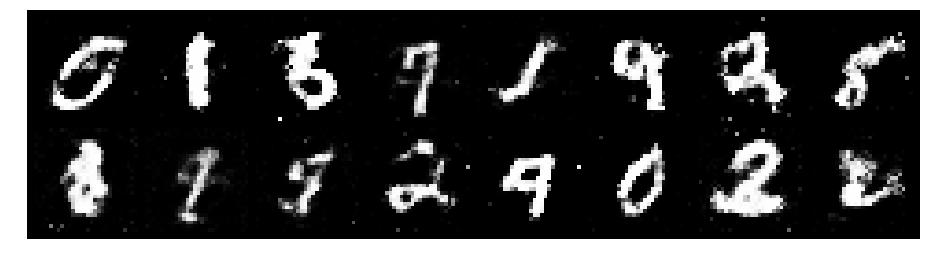

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.0196, Generator Loss: 1.3123
D(x): 0.6482, D(G(z)): 0.3460


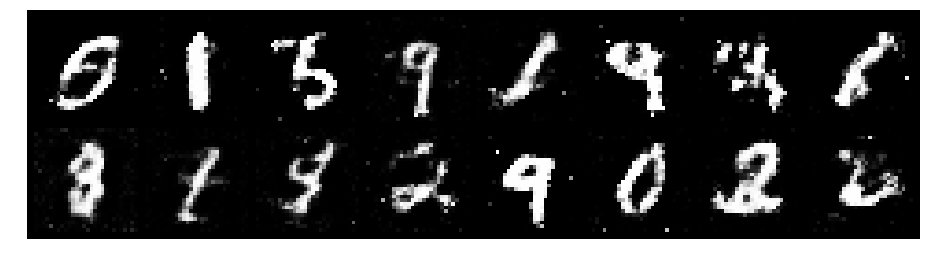

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1419, Generator Loss: 1.0393
D(x): 0.5352, D(G(z)): 0.3417


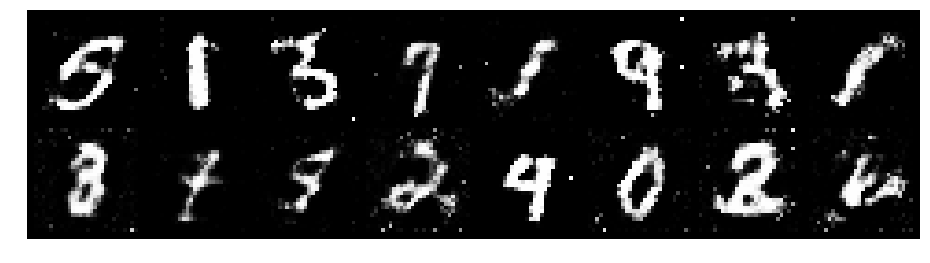

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.0767, Generator Loss: 0.9242
D(x): 0.5976, D(G(z)): 0.3680


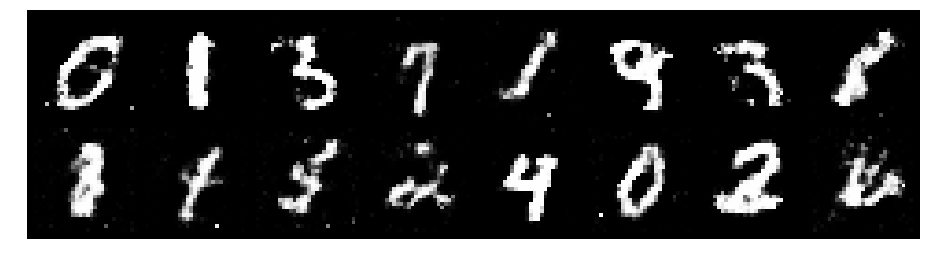

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2982, Generator Loss: 0.9483
D(x): 0.6739, D(G(z)): 0.4768


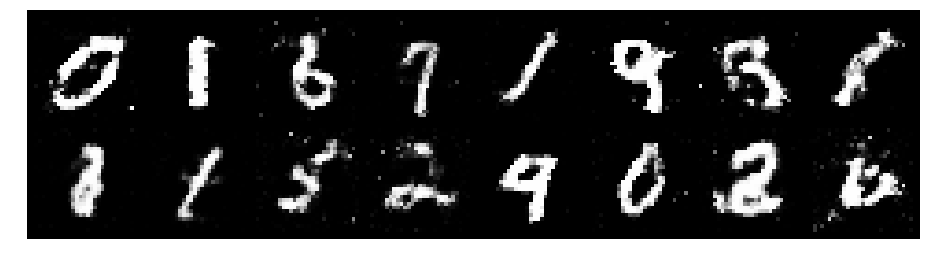

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.0181, Generator Loss: 1.0869
D(x): 0.6201, D(G(z)): 0.3639


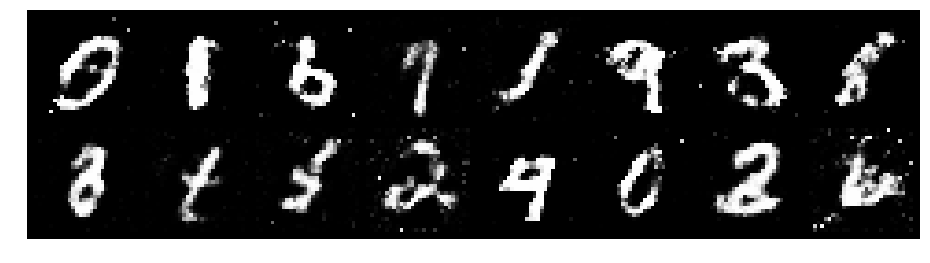

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1342, Generator Loss: 1.0911
D(x): 0.6130, D(G(z)): 0.4050


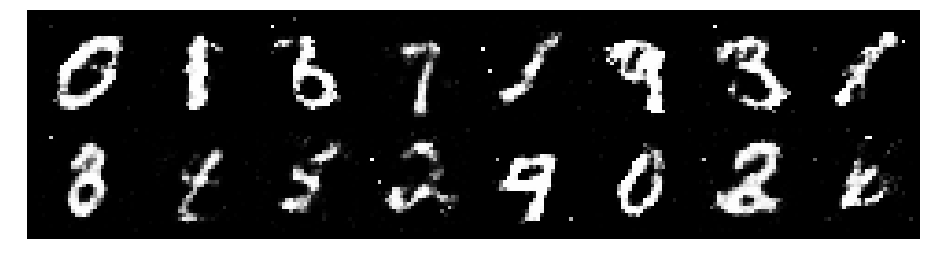

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.2539, Generator Loss: 1.0204
D(x): 0.5513, D(G(z)): 0.4098


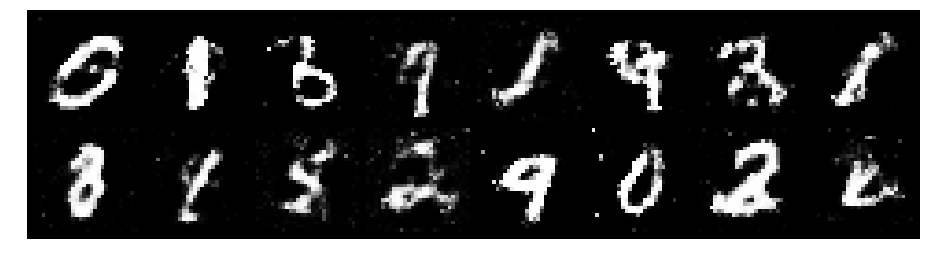

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.2252, Generator Loss: 0.9885
D(x): 0.5583, D(G(z)): 0.4164


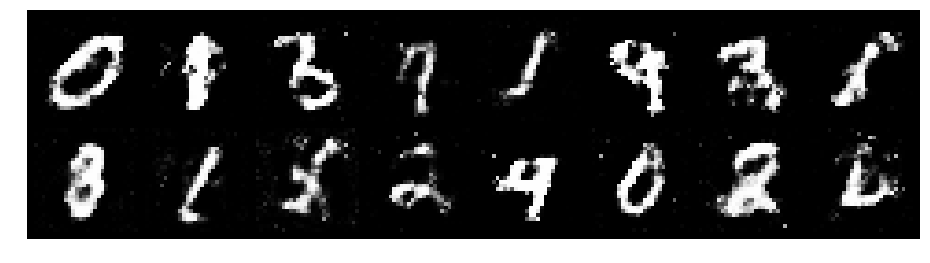

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.2534, Generator Loss: 0.8660
D(x): 0.5806, D(G(z)): 0.4508


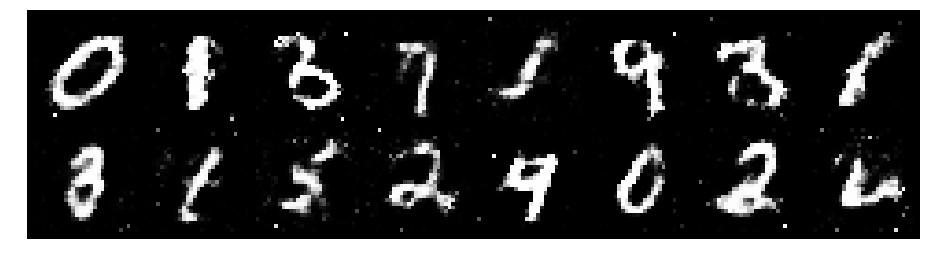

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.2679, Generator Loss: 0.8669
D(x): 0.5966, D(G(z)): 0.4577


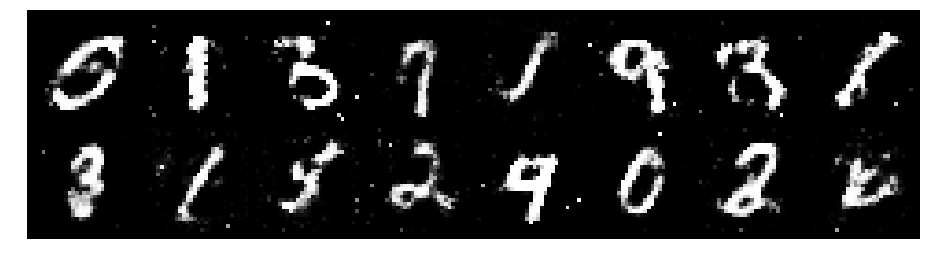

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1558, Generator Loss: 0.9878
D(x): 0.5711, D(G(z)): 0.3855


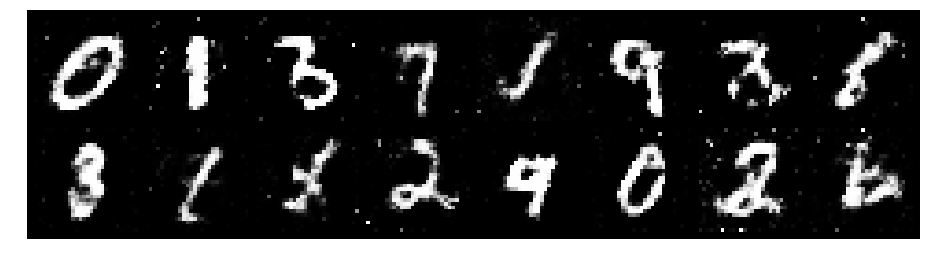

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.2702, Generator Loss: 1.1554
D(x): 0.5542, D(G(z)): 0.4034


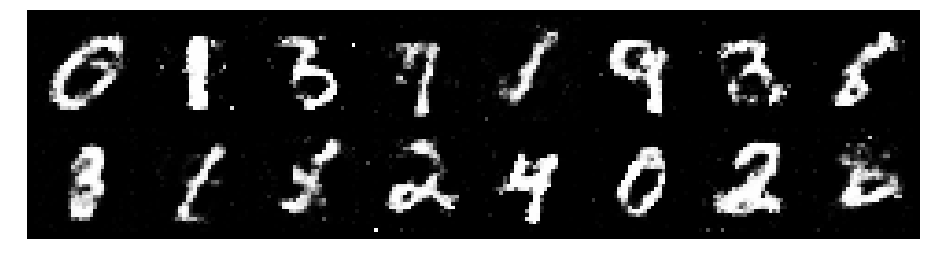

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.2878, Generator Loss: 0.8612
D(x): 0.6235, D(G(z)): 0.4931


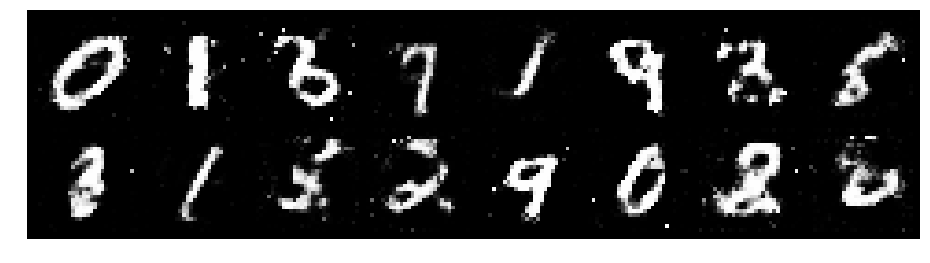

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.2991, Generator Loss: 0.8407
D(x): 0.5469, D(G(z)): 0.4442


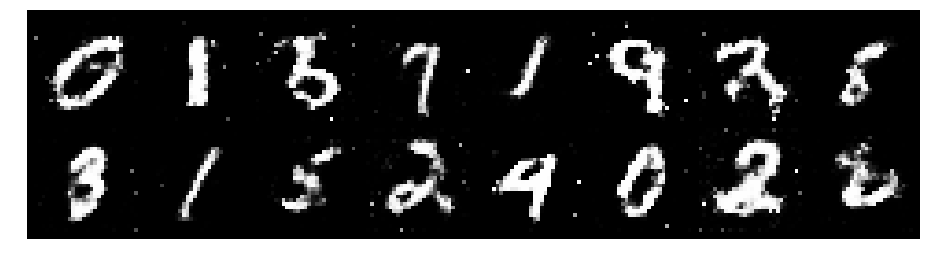

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.1842, Generator Loss: 0.8642
D(x): 0.6060, D(G(z)): 0.4184


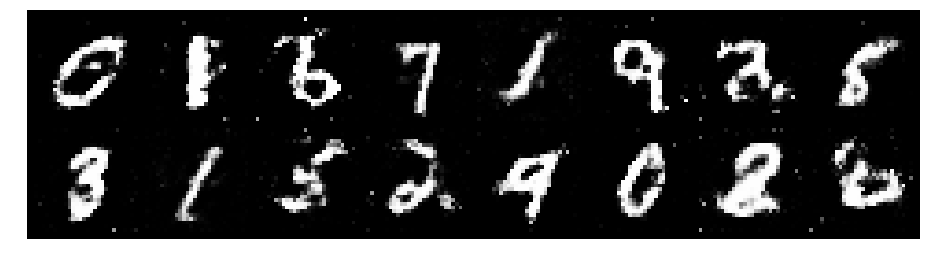

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.2038, Generator Loss: 0.9514
D(x): 0.5685, D(G(z)): 0.4143


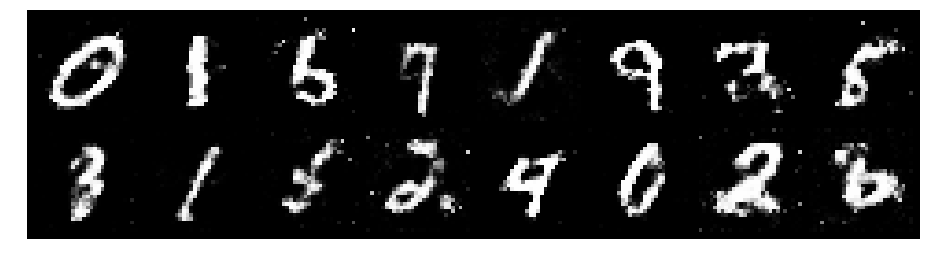

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.1293, Generator Loss: 0.9268
D(x): 0.6078, D(G(z)): 0.4018


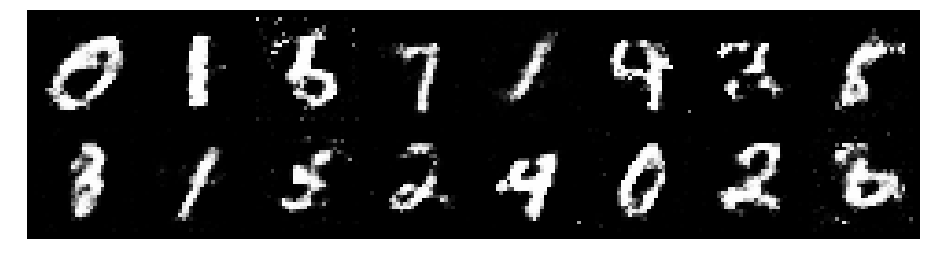

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1638, Generator Loss: 1.0307
D(x): 0.6140, D(G(z)): 0.4163


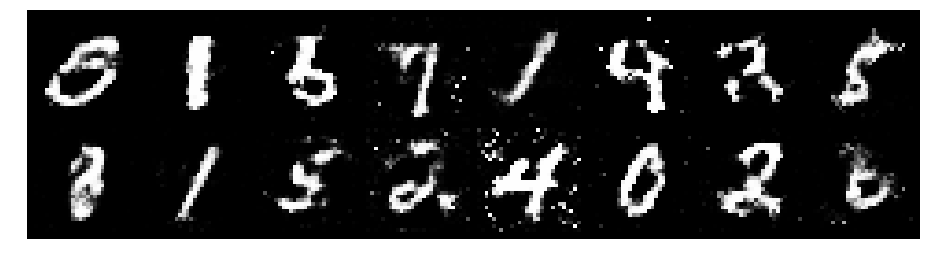

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.3021, Generator Loss: 0.9366
D(x): 0.5681, D(G(z)): 0.4424


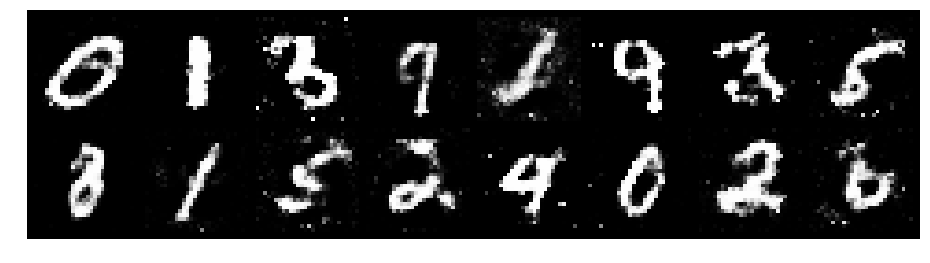

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.3338, Generator Loss: 0.9001
D(x): 0.5664, D(G(z)): 0.4460


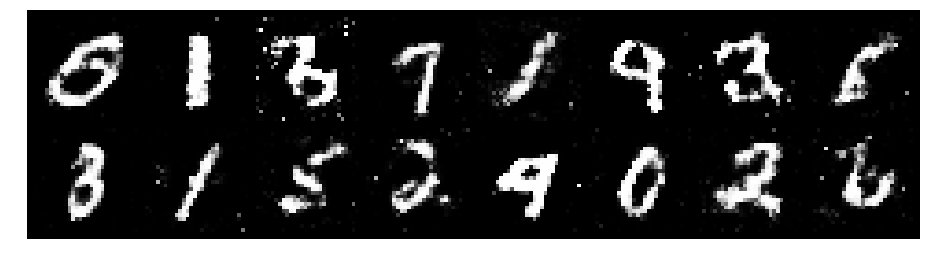

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1532, Generator Loss: 1.3231
D(x): 0.5490, D(G(z)): 0.3413


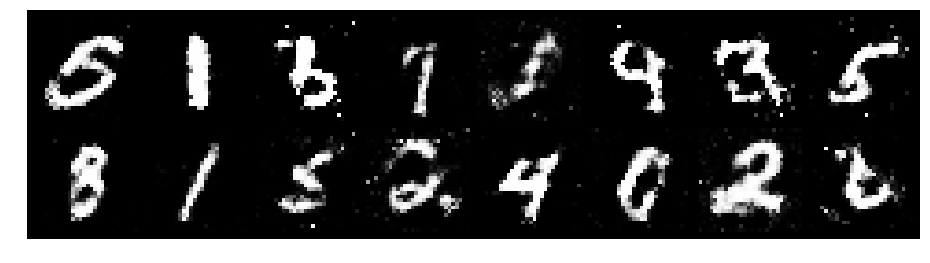

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.0583, Generator Loss: 1.2010
D(x): 0.6365, D(G(z)): 0.3720


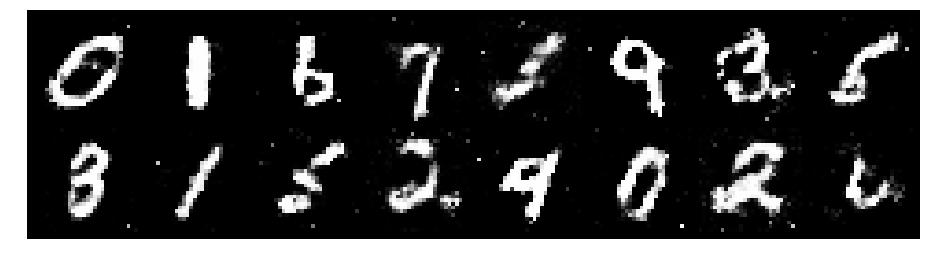

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.2346, Generator Loss: 1.0149
D(x): 0.5878, D(G(z)): 0.4094


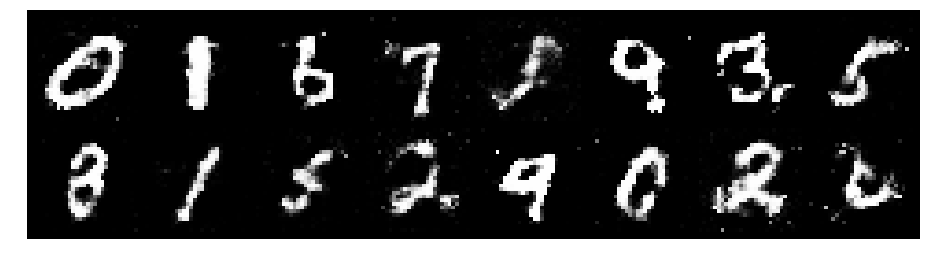

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1780, Generator Loss: 1.2333
D(x): 0.5360, D(G(z)): 0.3443


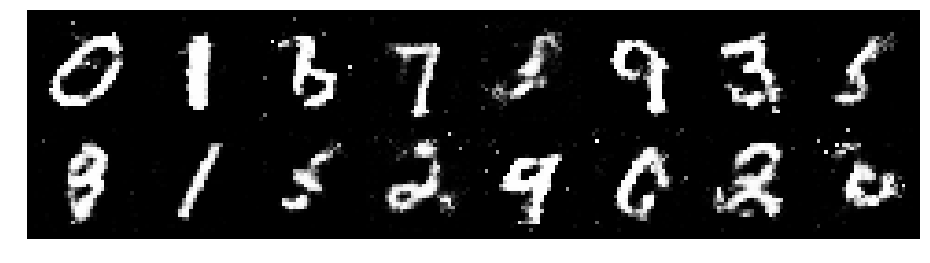

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.2416, Generator Loss: 0.8519
D(x): 0.6705, D(G(z)): 0.4612


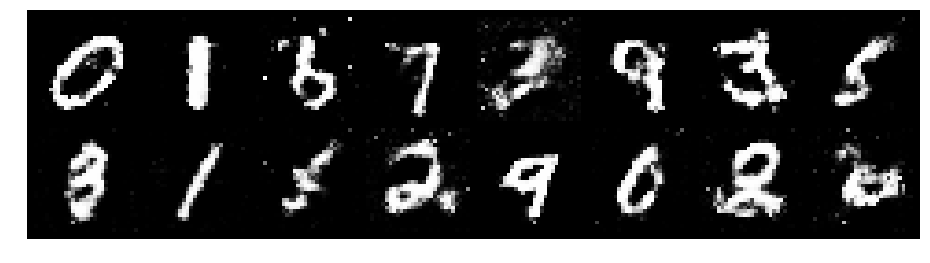

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2171, Generator Loss: 0.9470
D(x): 0.5786, D(G(z)): 0.4295


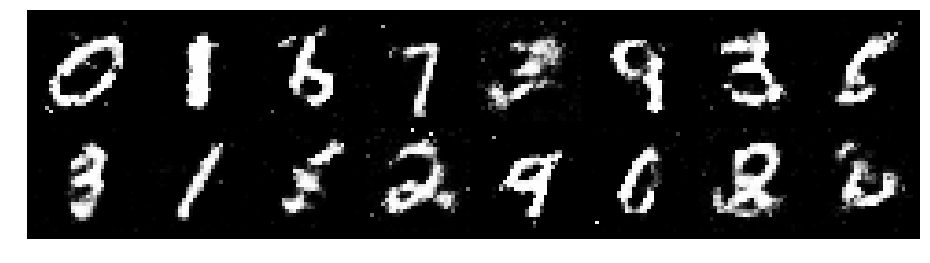

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1286, Generator Loss: 0.9422
D(x): 0.6143, D(G(z)): 0.4202


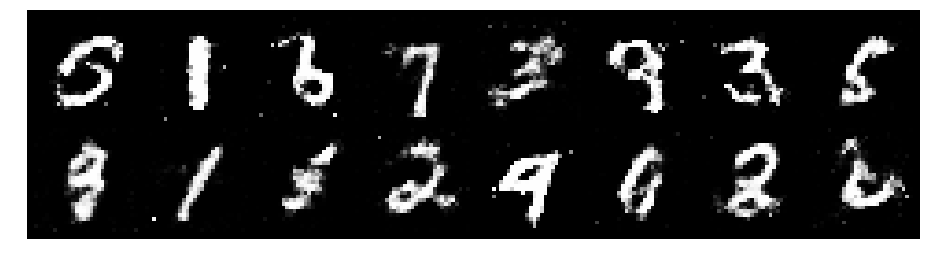

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.1781, Generator Loss: 0.8475
D(x): 0.5961, D(G(z)): 0.4426


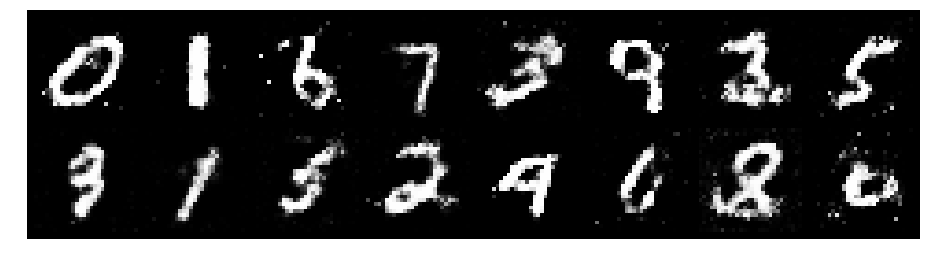

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1615, Generator Loss: 0.9999
D(x): 0.5683, D(G(z)): 0.3970


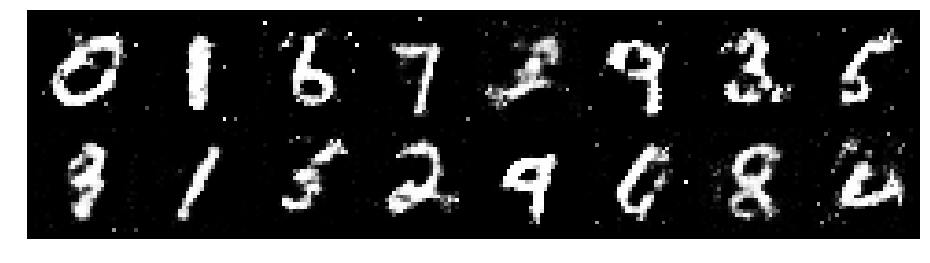

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2400, Generator Loss: 0.9355
D(x): 0.5736, D(G(z)): 0.4206


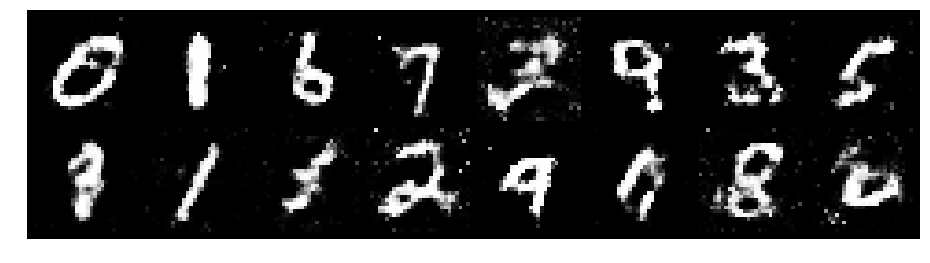

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2130, Generator Loss: 1.0338
D(x): 0.6218, D(G(z)): 0.4492


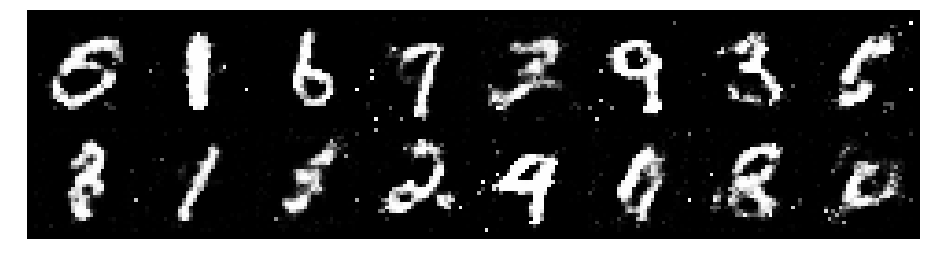

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1541, Generator Loss: 0.9312
D(x): 0.6089, D(G(z)): 0.4185


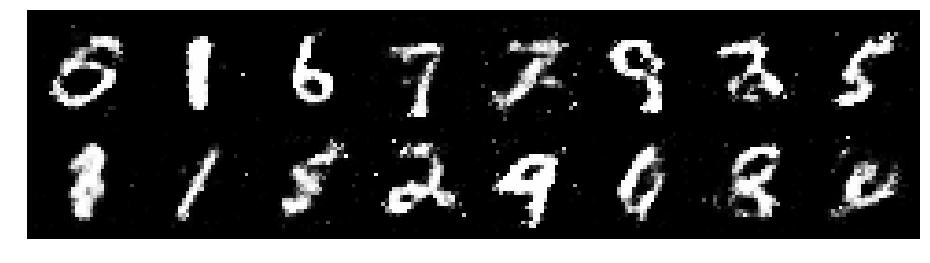

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.2568, Generator Loss: 0.9282
D(x): 0.5888, D(G(z)): 0.4442


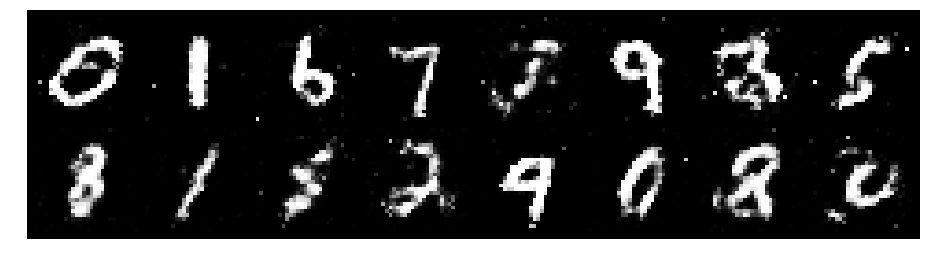

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1257, Generator Loss: 1.0365
D(x): 0.5860, D(G(z)): 0.3779


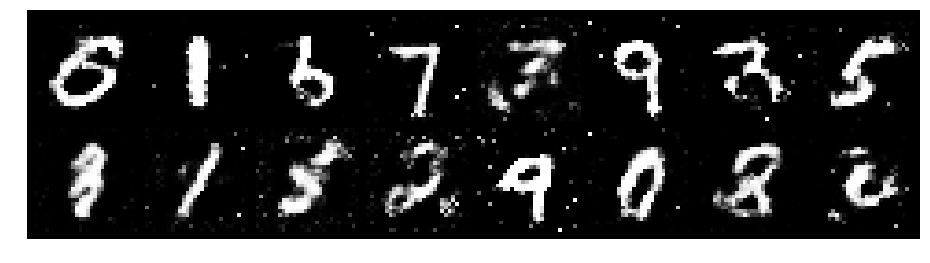

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1598, Generator Loss: 1.1592
D(x): 0.5543, D(G(z)): 0.3626


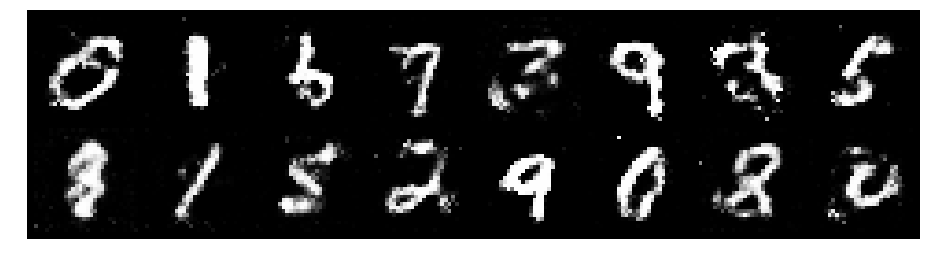

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1355, Generator Loss: 0.9887
D(x): 0.5819, D(G(z)): 0.3972


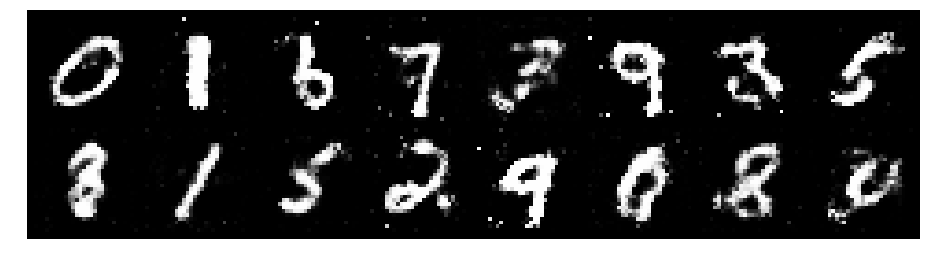

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.2598, Generator Loss: 0.9769
D(x): 0.5493, D(G(z)): 0.4289


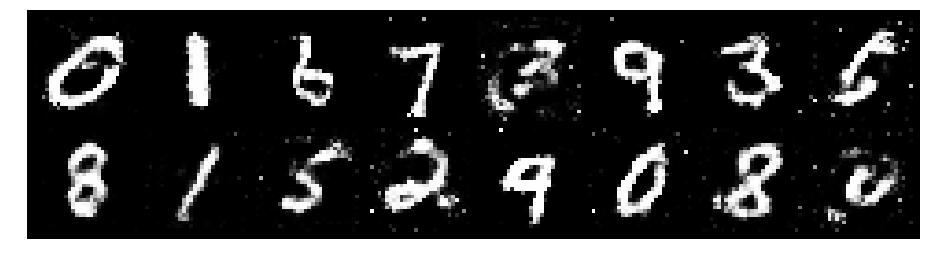

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.1497, Generator Loss: 1.0611
D(x): 0.5825, D(G(z)): 0.4084


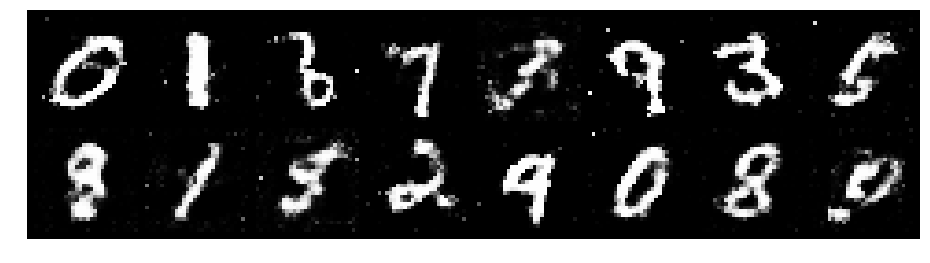

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.1794, Generator Loss: 0.9840
D(x): 0.5994, D(G(z)): 0.4128


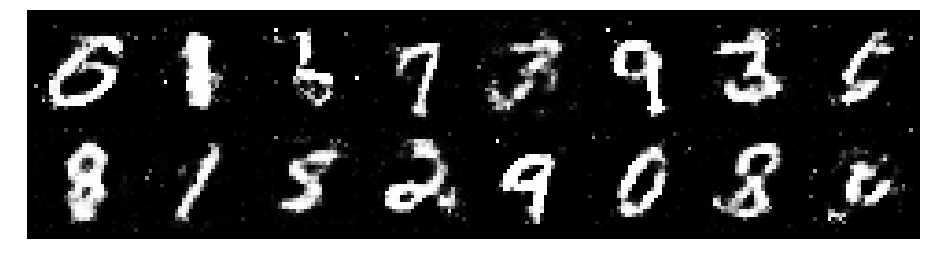

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1759, Generator Loss: 1.0830
D(x): 0.6363, D(G(z)): 0.4305


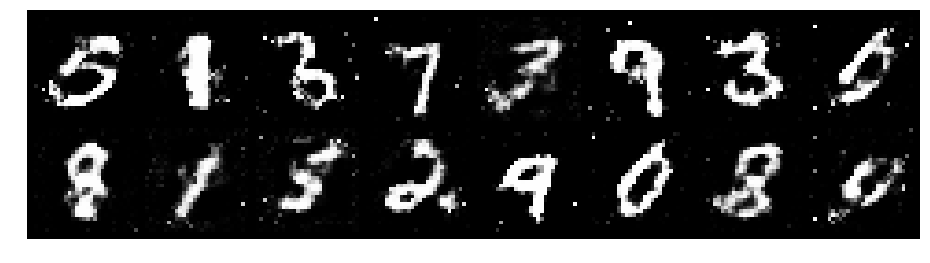

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1669, Generator Loss: 1.1834
D(x): 0.5599, D(G(z)): 0.3491


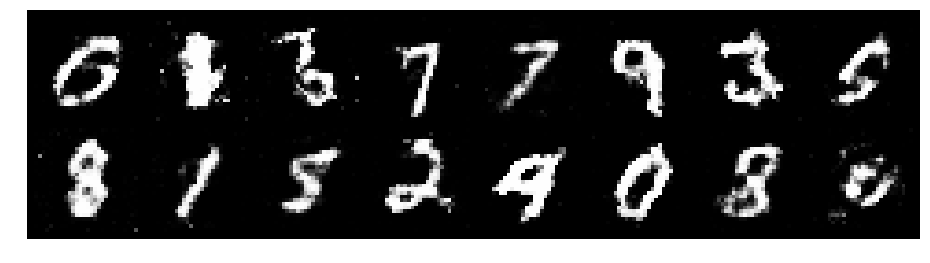

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2038, Generator Loss: 0.9128
D(x): 0.6385, D(G(z)): 0.4502


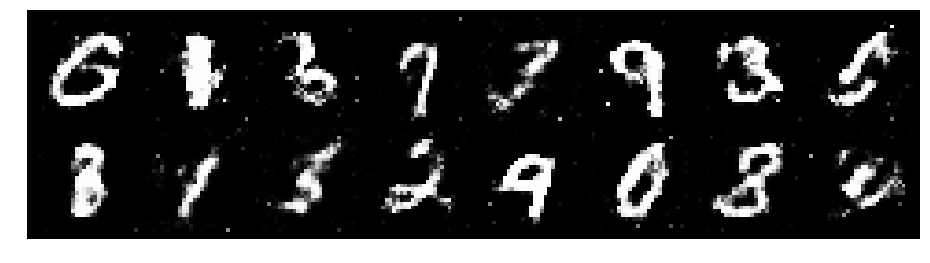

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.0830, Generator Loss: 1.0256
D(x): 0.6415, D(G(z)): 0.4129


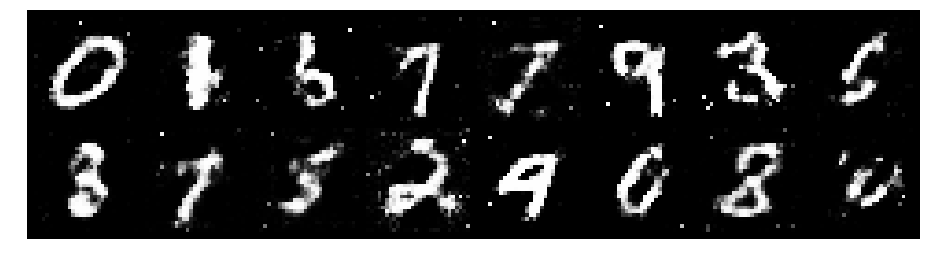

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.1624, Generator Loss: 1.1094
D(x): 0.5519, D(G(z)): 0.3745


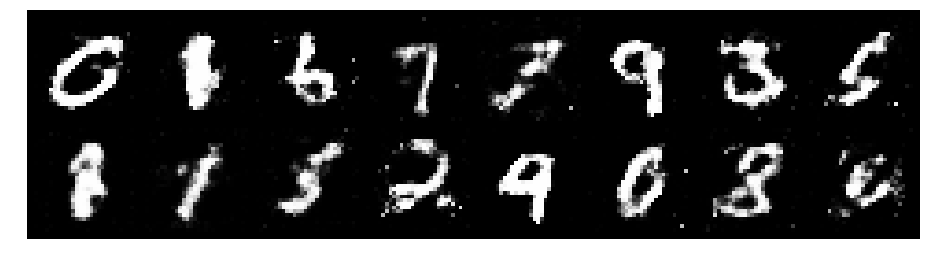

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 0.9972, Generator Loss: 1.2164
D(x): 0.6280, D(G(z)): 0.3384


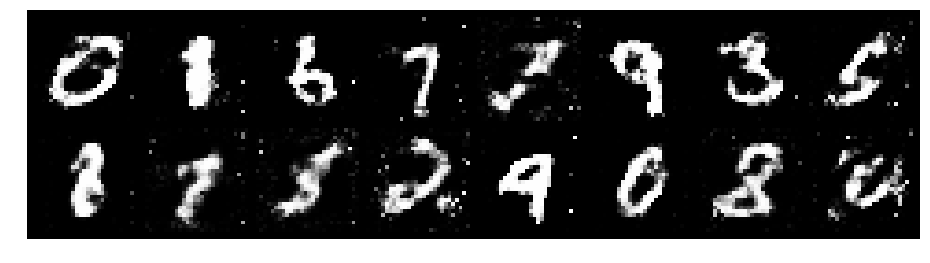

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.2271, Generator Loss: 1.0655
D(x): 0.5880, D(G(z)): 0.4498


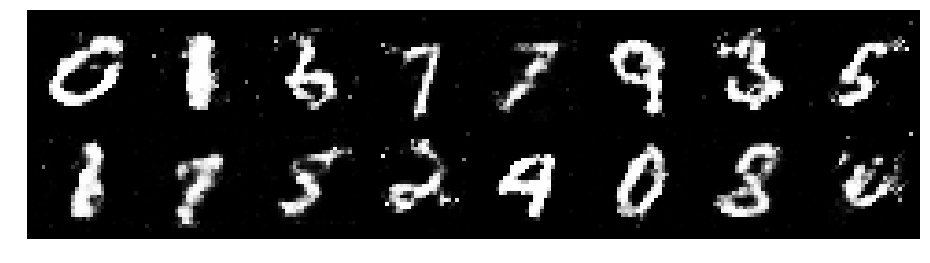

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.2666, Generator Loss: 0.8822
D(x): 0.6127, D(G(z)): 0.4847


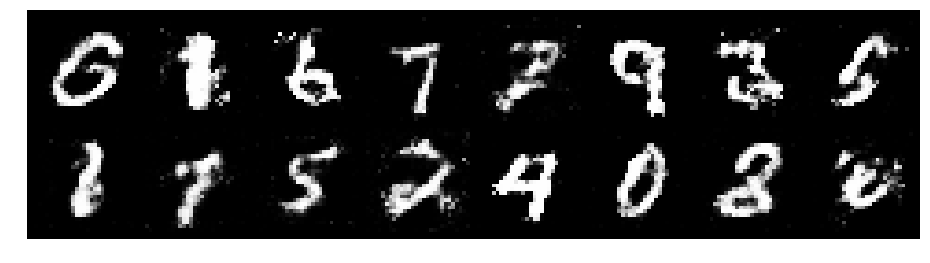

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.1238, Generator Loss: 0.9326
D(x): 0.6465, D(G(z)): 0.4188


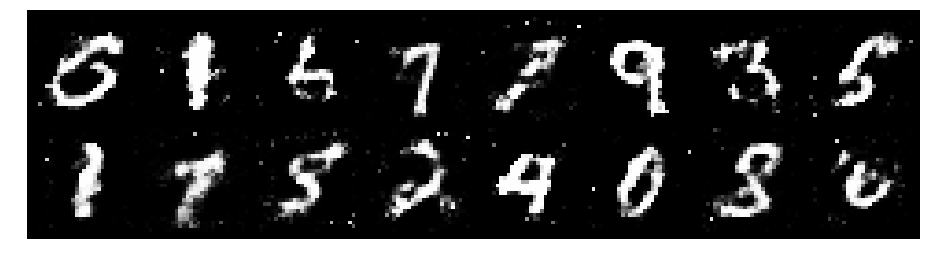

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.1895, Generator Loss: 1.1017
D(x): 0.5792, D(G(z)): 0.3865


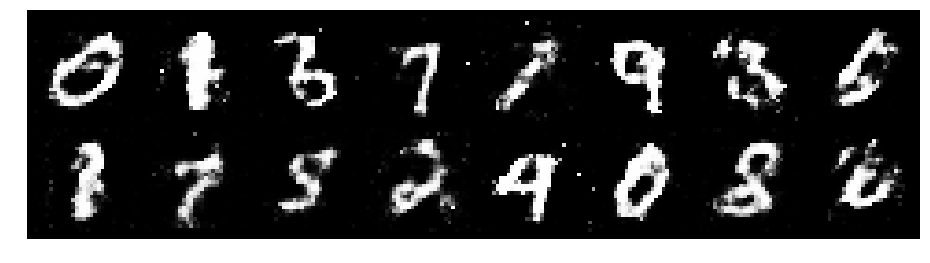

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.1884, Generator Loss: 1.1483
D(x): 0.6019, D(G(z)): 0.3916


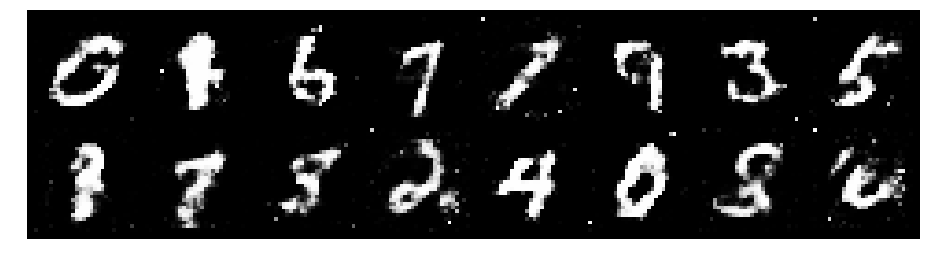

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.1245, Generator Loss: 1.1931
D(x): 0.6912, D(G(z)): 0.4216


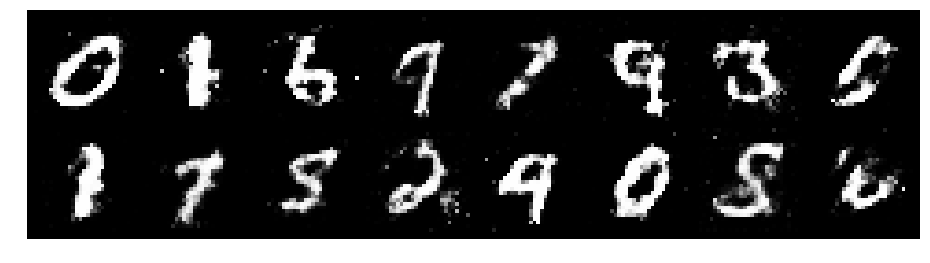

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.0611, Generator Loss: 1.2131
D(x): 0.6281, D(G(z)): 0.3667


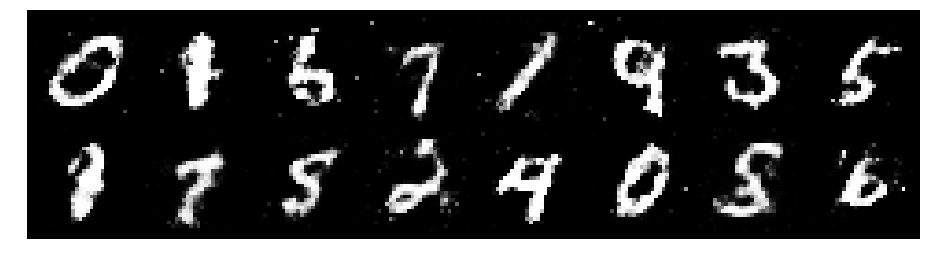

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2178, Generator Loss: 0.9723
D(x): 0.5628, D(G(z)): 0.4019


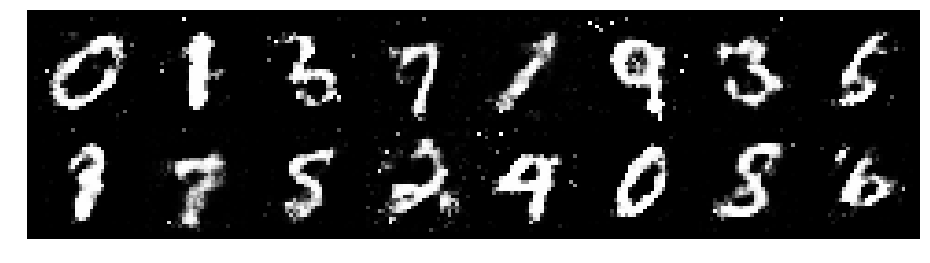

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1314, Generator Loss: 0.9957
D(x): 0.6139, D(G(z)): 0.4002


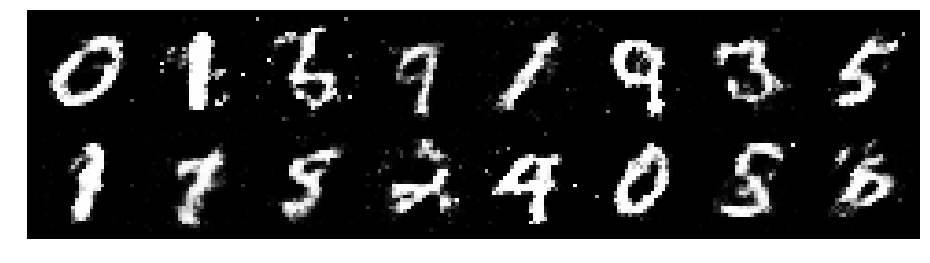

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.0968, Generator Loss: 0.8644
D(x): 0.6242, D(G(z)): 0.4250


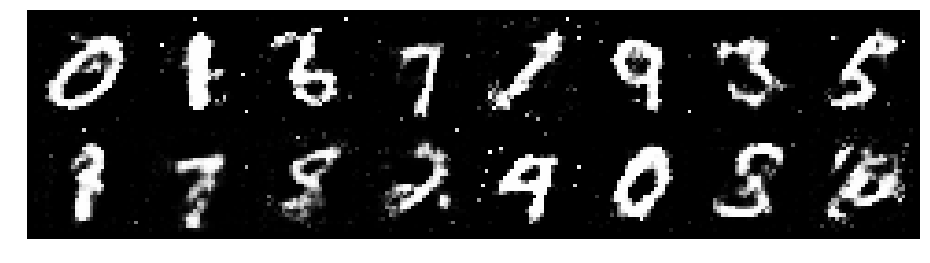

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2140, Generator Loss: 0.9575
D(x): 0.6057, D(G(z)): 0.4516


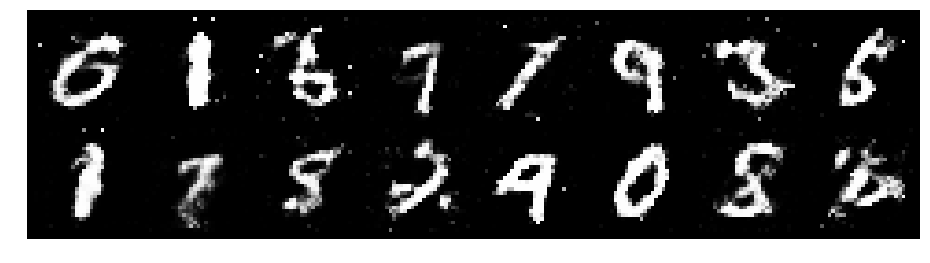

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.1945, Generator Loss: 1.0542
D(x): 0.6365, D(G(z)): 0.4174


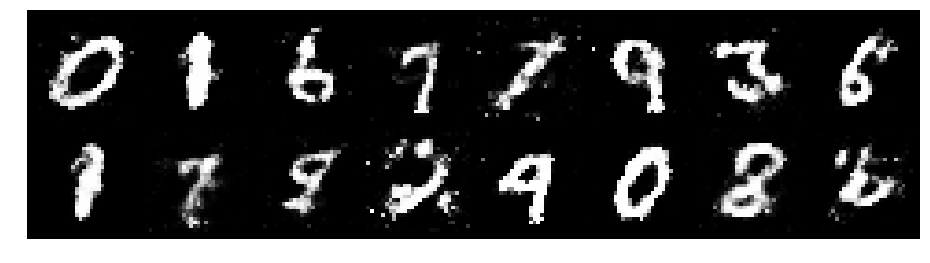

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.2689, Generator Loss: 1.1234
D(x): 0.5954, D(G(z)): 0.4486


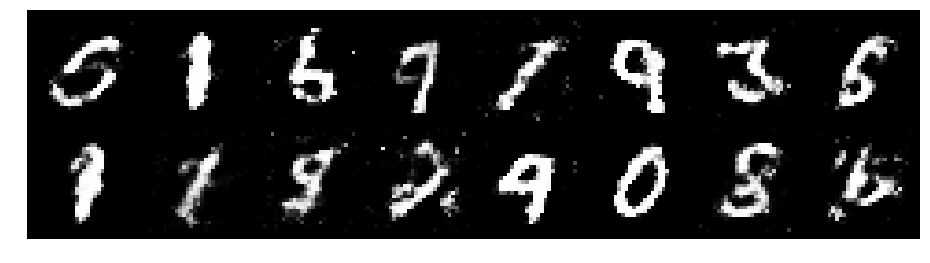

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.0962, Generator Loss: 0.9958
D(x): 0.6056, D(G(z)): 0.3859


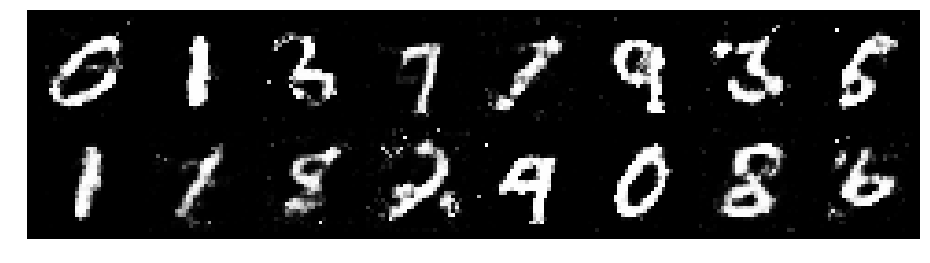

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.1044, Generator Loss: 1.1067
D(x): 0.5899, D(G(z)): 0.3761


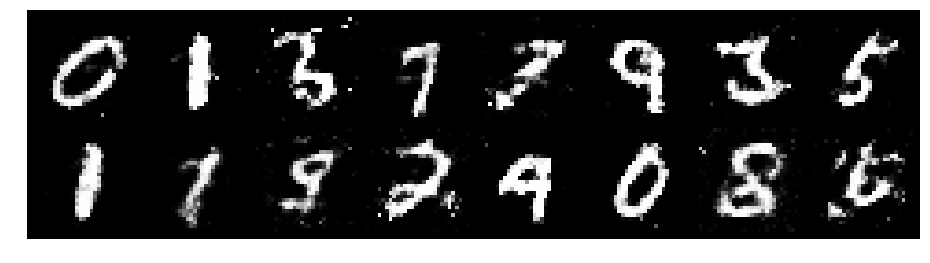

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.1996, Generator Loss: 0.9609
D(x): 0.6018, D(G(z)): 0.4178


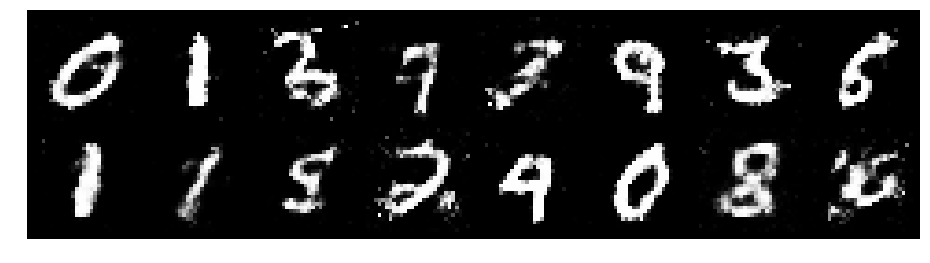

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2379, Generator Loss: 0.9010
D(x): 0.5918, D(G(z)): 0.4339


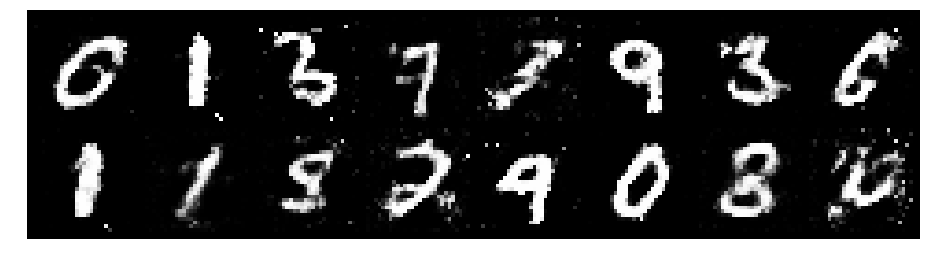

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2567, Generator Loss: 1.1793
D(x): 0.6032, D(G(z)): 0.4167


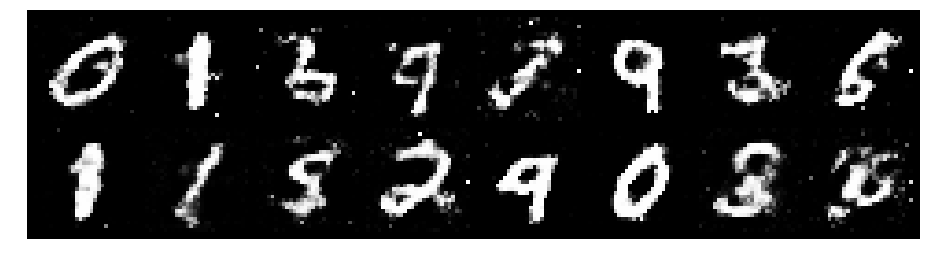

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2551, Generator Loss: 1.1569
D(x): 0.5762, D(G(z)): 0.4064


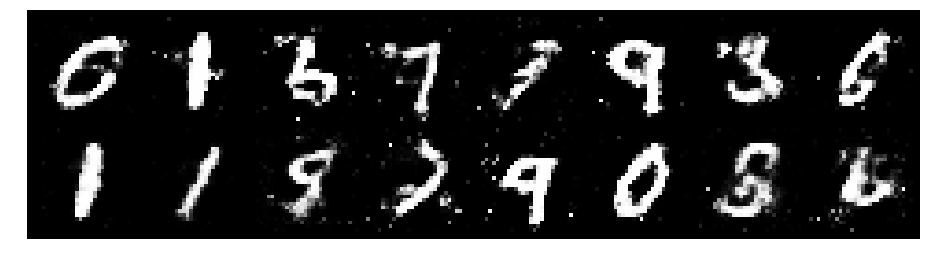

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2613, Generator Loss: 1.0085
D(x): 0.5251, D(G(z)): 0.3876


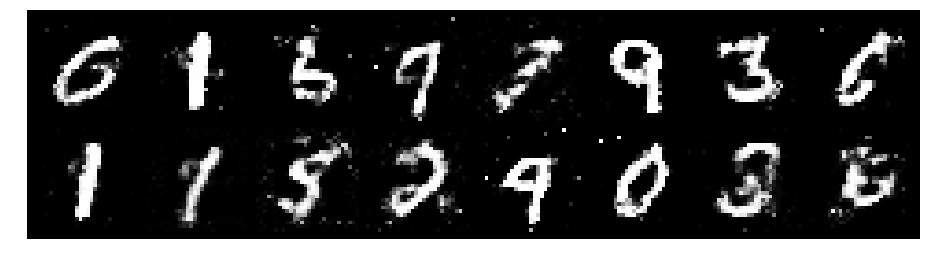

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.2217, Generator Loss: 0.9619
D(x): 0.5633, D(G(z)): 0.4102


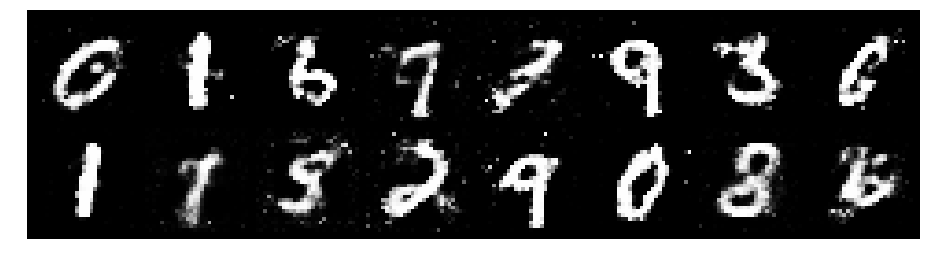

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2049, Generator Loss: 1.0179
D(x): 0.6128, D(G(z)): 0.4242


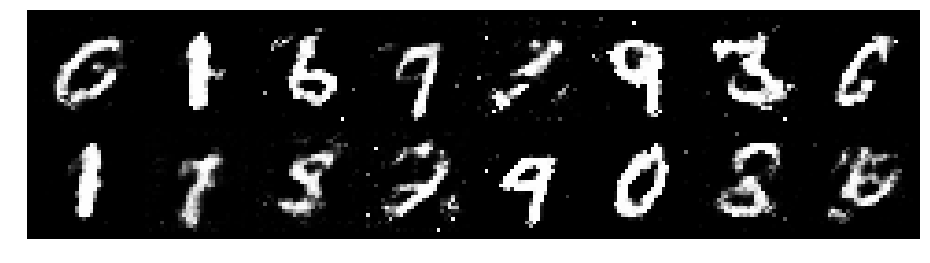

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.3175, Generator Loss: 0.9608
D(x): 0.5607, D(G(z)): 0.4580


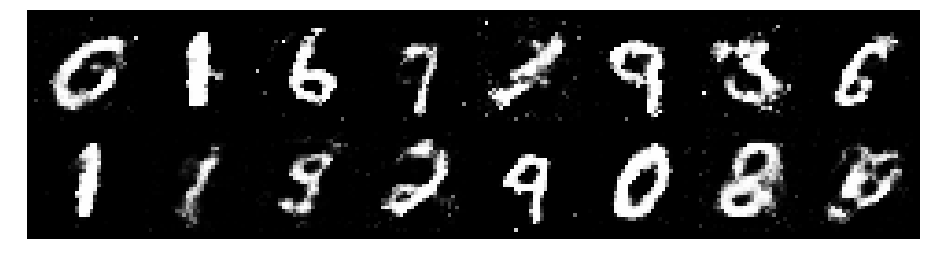

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2508, Generator Loss: 1.0949
D(x): 0.6189, D(G(z)): 0.4524


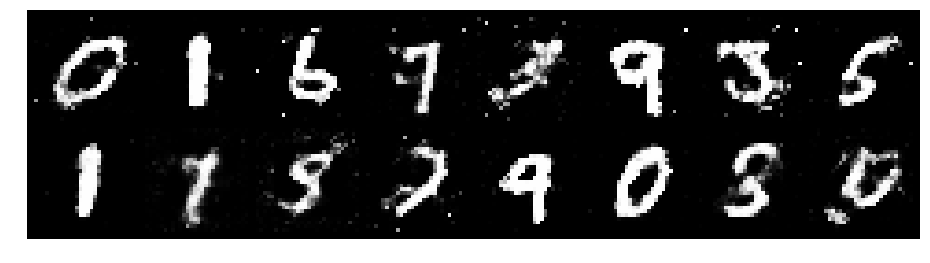

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.3662, Generator Loss: 0.7530
D(x): 0.6241, D(G(z)): 0.5370


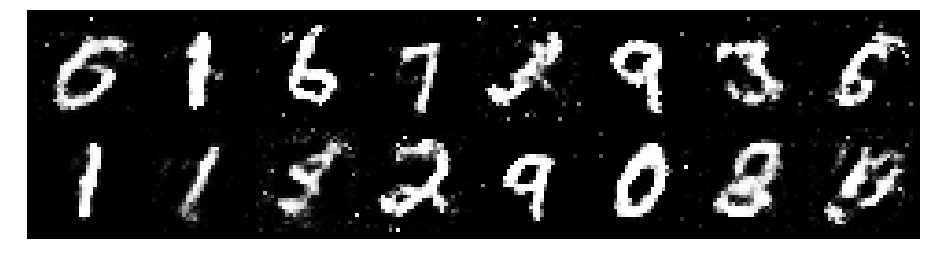

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2089, Generator Loss: 0.9506
D(x): 0.6122, D(G(z)): 0.4275


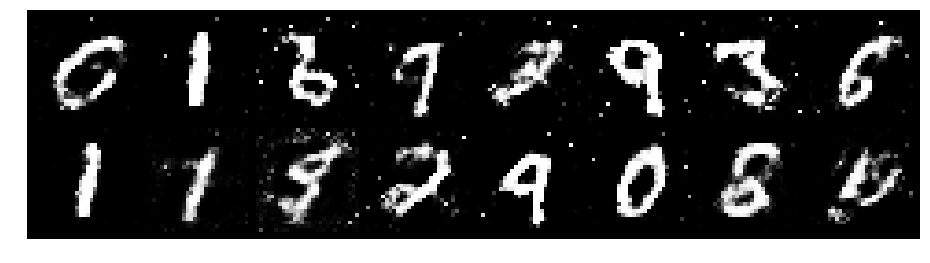

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.1385, Generator Loss: 1.1419
D(x): 0.6066, D(G(z)): 0.3892


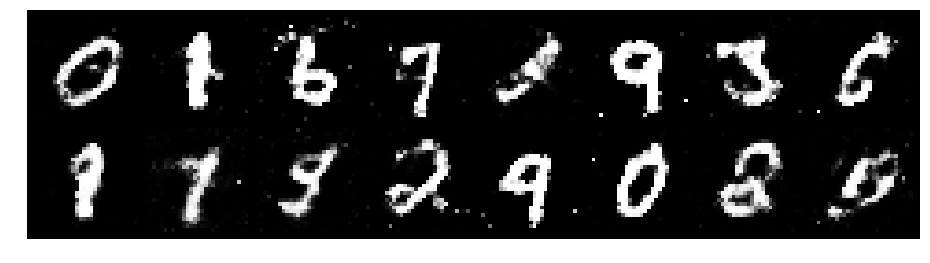

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2102, Generator Loss: 1.0290
D(x): 0.5402, D(G(z)): 0.3735


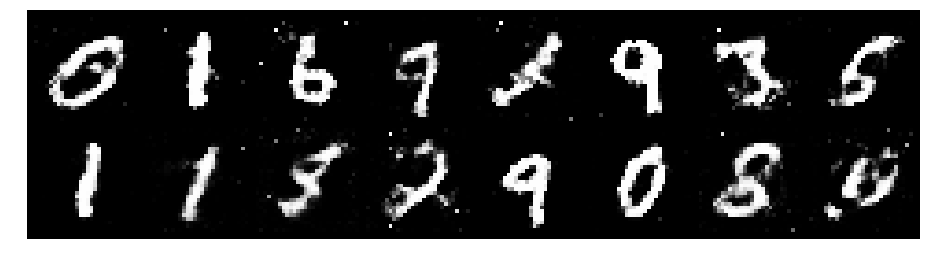

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.1879, Generator Loss: 1.0392
D(x): 0.5736, D(G(z)): 0.3939


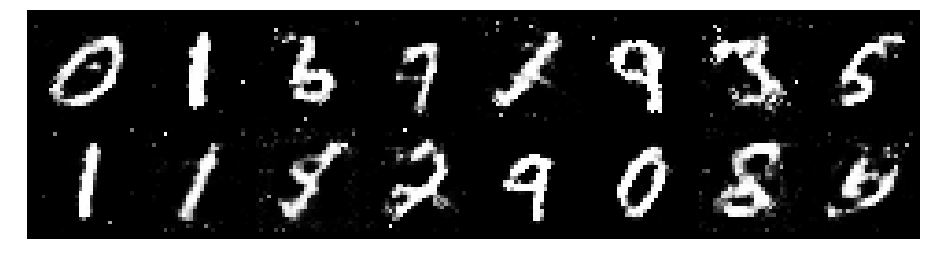

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.3564, Generator Loss: 0.8791
D(x): 0.5246, D(G(z)): 0.4448


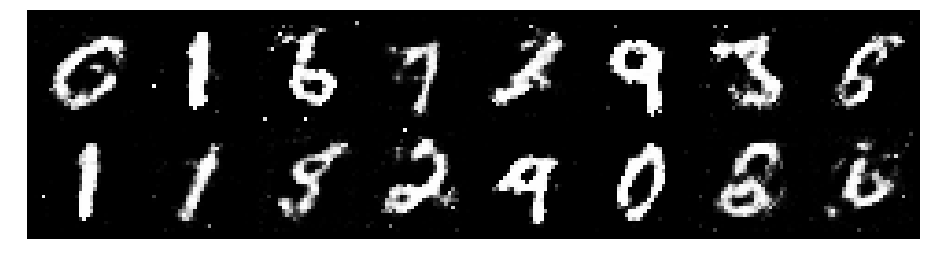

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.3647, Generator Loss: 0.9766
D(x): 0.5032, D(G(z)): 0.4339


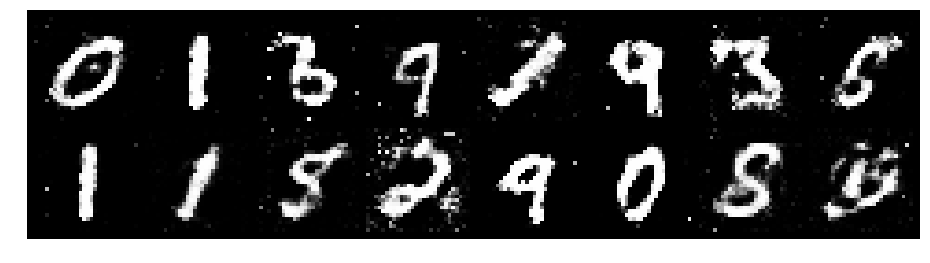

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2733, Generator Loss: 0.8188
D(x): 0.6523, D(G(z)): 0.4919


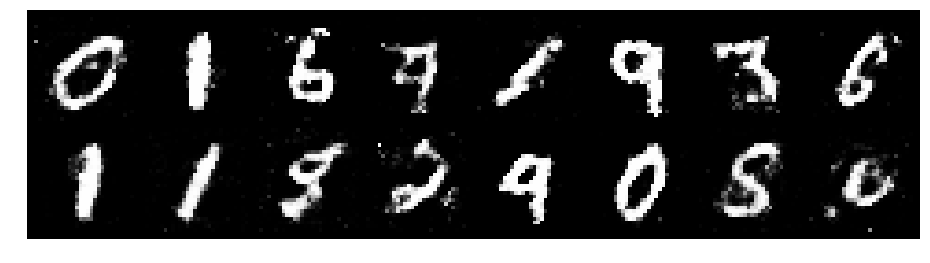

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1595, Generator Loss: 1.0009
D(x): 0.5818, D(G(z)): 0.4138


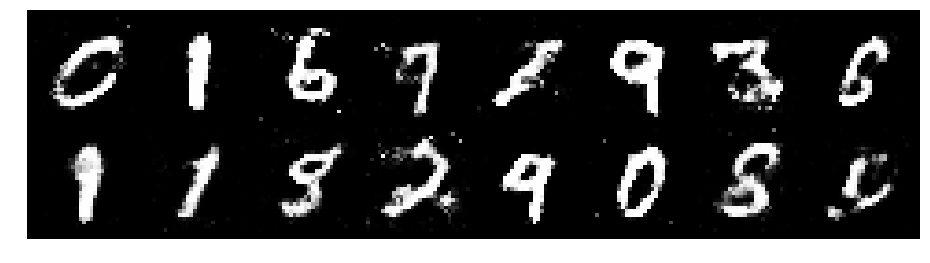

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.2148, Generator Loss: 0.8952
D(x): 0.5824, D(G(z)): 0.4501


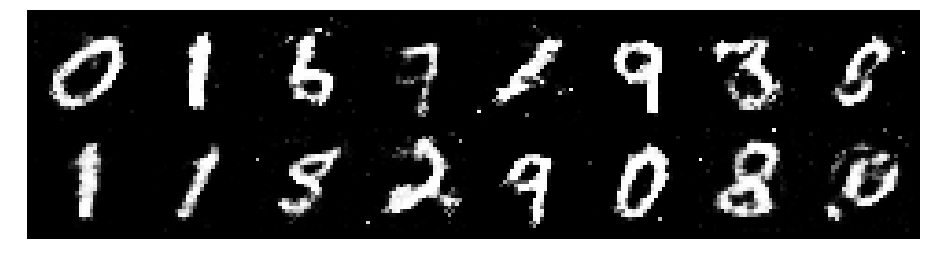

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.2193, Generator Loss: 0.8657
D(x): 0.5727, D(G(z)): 0.4481


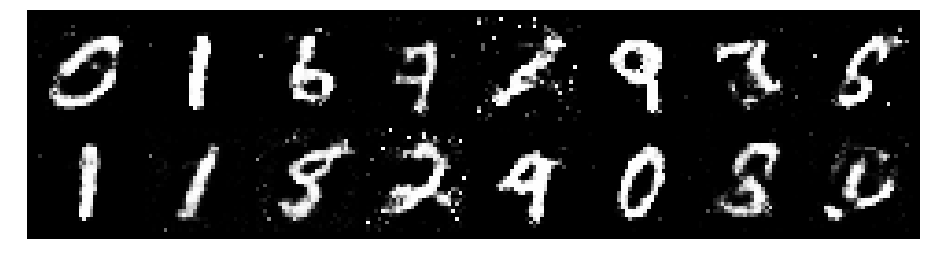

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2931, Generator Loss: 1.1487
D(x): 0.5549, D(G(z)): 0.4360


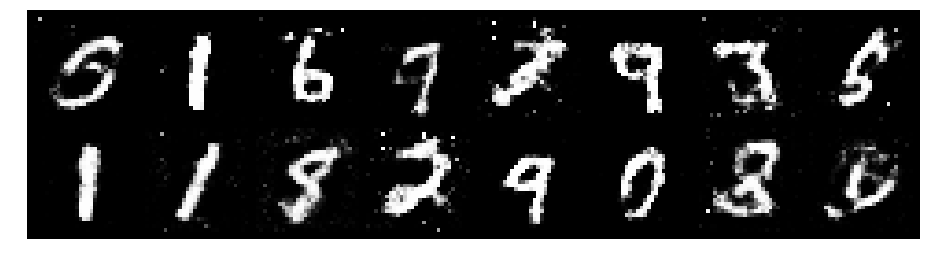

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.1843, Generator Loss: 0.9269
D(x): 0.5458, D(G(z)): 0.3769


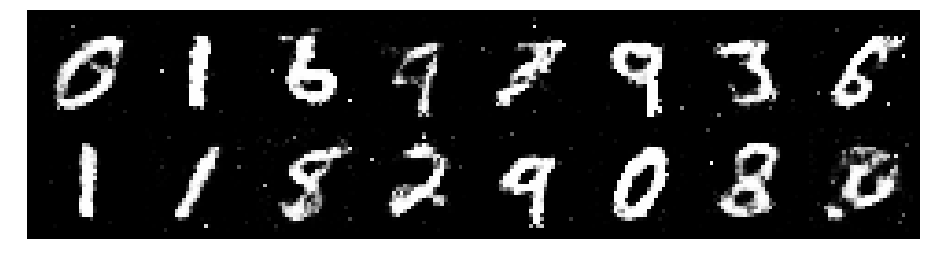

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2165, Generator Loss: 0.9832
D(x): 0.5543, D(G(z)): 0.3973


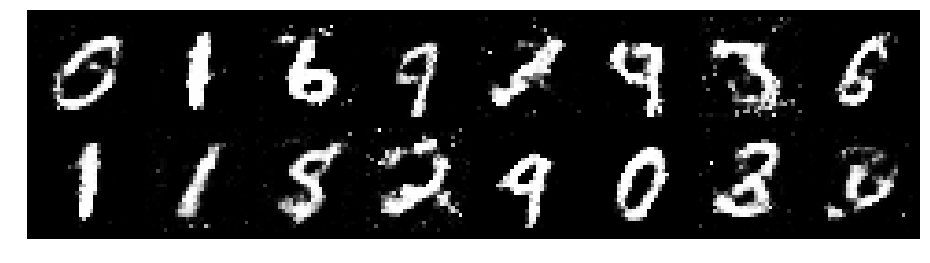

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2262, Generator Loss: 0.9886
D(x): 0.6106, D(G(z)): 0.4574


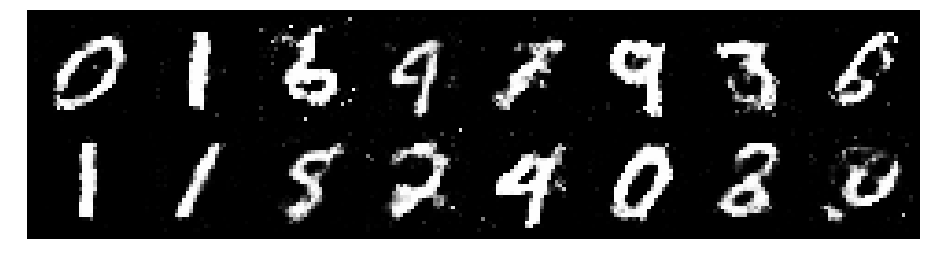

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.1884, Generator Loss: 0.9459
D(x): 0.6196, D(G(z)): 0.4452


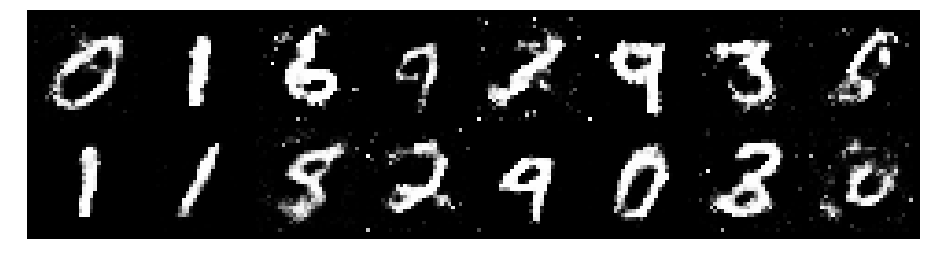

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.4085, Generator Loss: 1.0938
D(x): 0.5033, D(G(z)): 0.4183


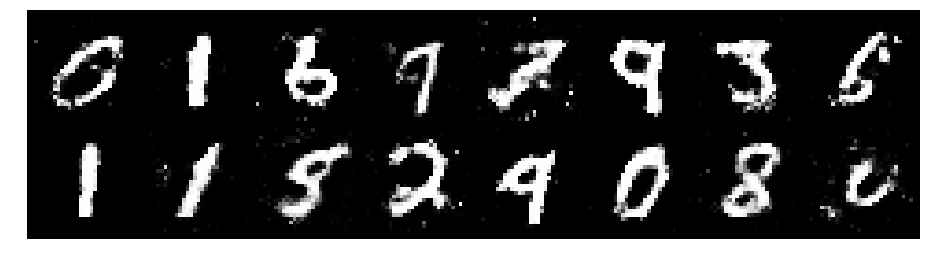

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.1783, Generator Loss: 0.9498
D(x): 0.5735, D(G(z)): 0.4125


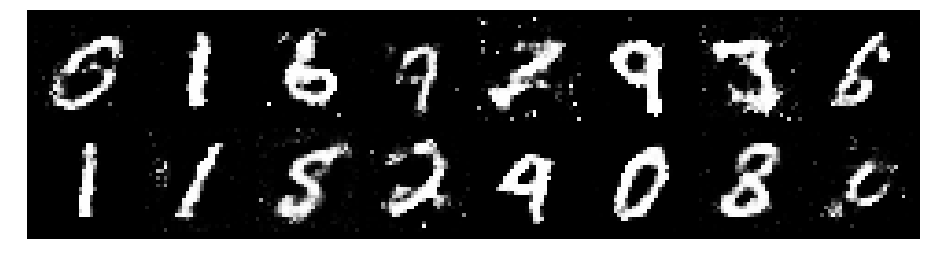

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.2879, Generator Loss: 1.1084
D(x): 0.5685, D(G(z)): 0.4422


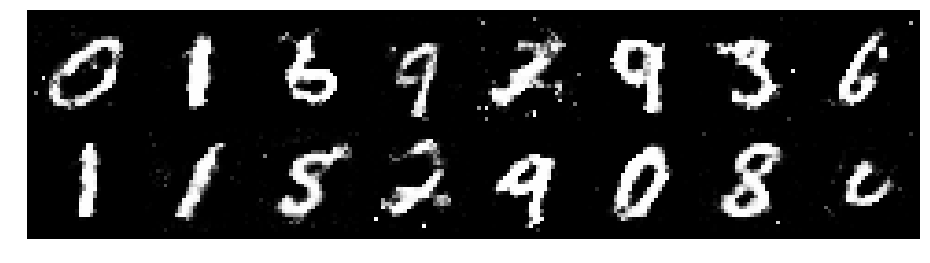

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2237, Generator Loss: 0.9556
D(x): 0.6040, D(G(z)): 0.4476


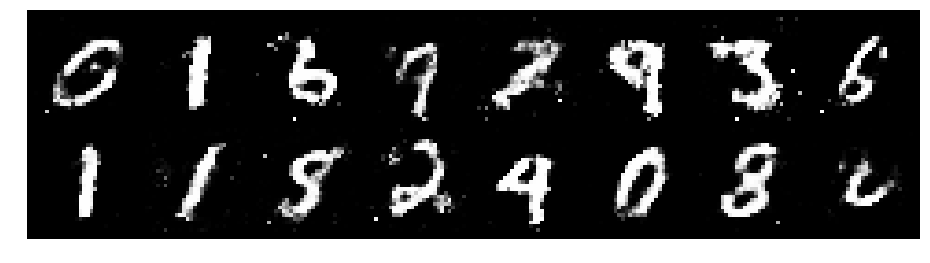

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.2406, Generator Loss: 0.8472
D(x): 0.5506, D(G(z)): 0.4261


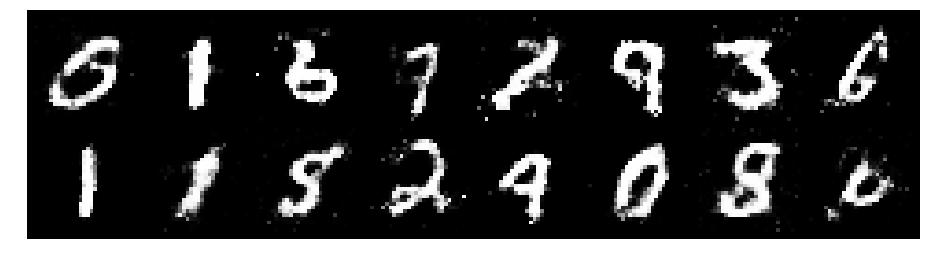

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.2326, Generator Loss: 0.8115
D(x): 0.5745, D(G(z)): 0.4519


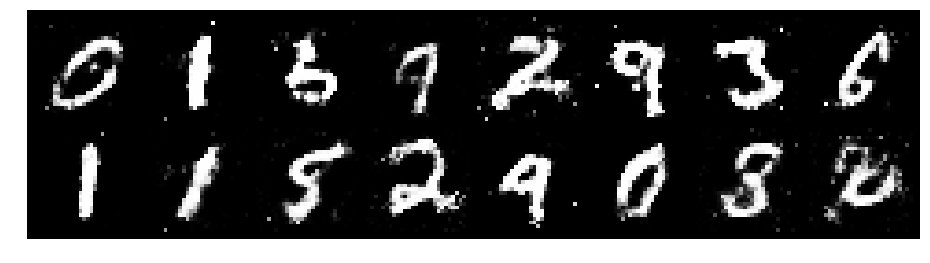

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2937, Generator Loss: 0.9468
D(x): 0.5688, D(G(z)): 0.4621


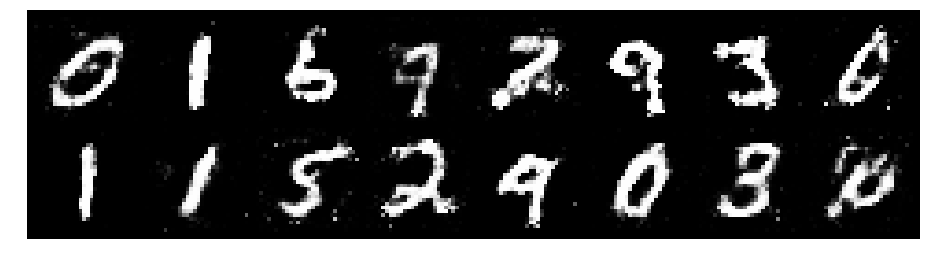

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.4340, Generator Loss: 0.8560
D(x): 0.5022, D(G(z)): 0.4416


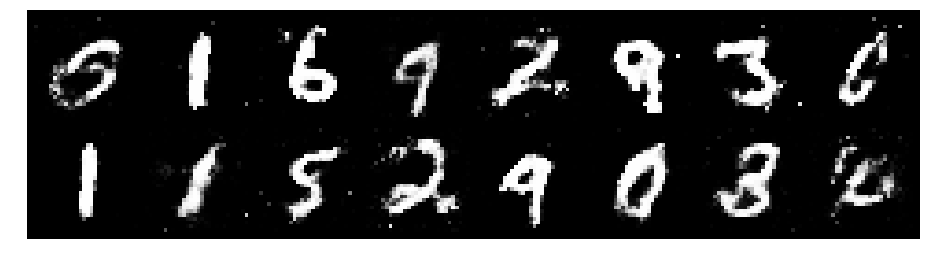

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.5198, Generator Loss: 0.7680
D(x): 0.5161, D(G(z)): 0.4873


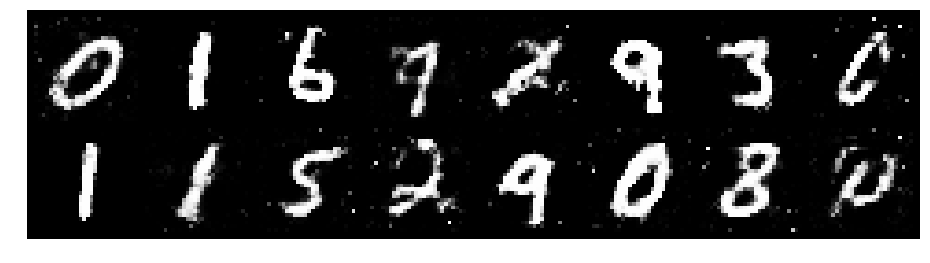

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1943, Generator Loss: 1.0720
D(x): 0.6003, D(G(z)): 0.3945


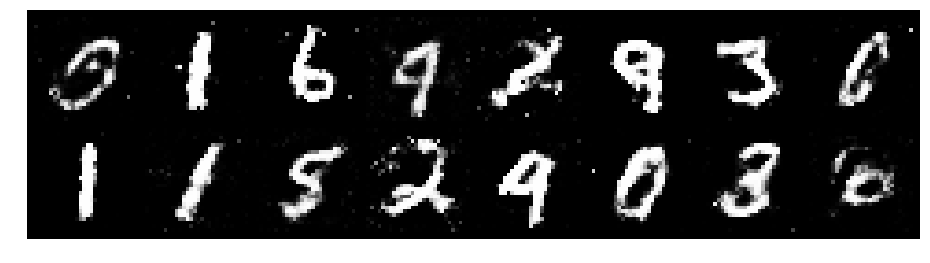

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1476, Generator Loss: 1.0961
D(x): 0.5642, D(G(z)): 0.3645


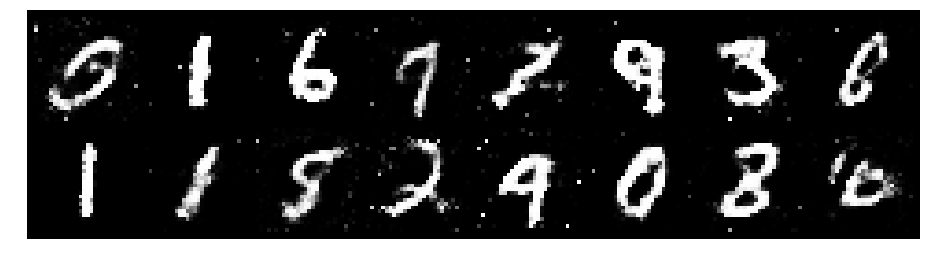

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.3045, Generator Loss: 0.9695
D(x): 0.5689, D(G(z)): 0.4516


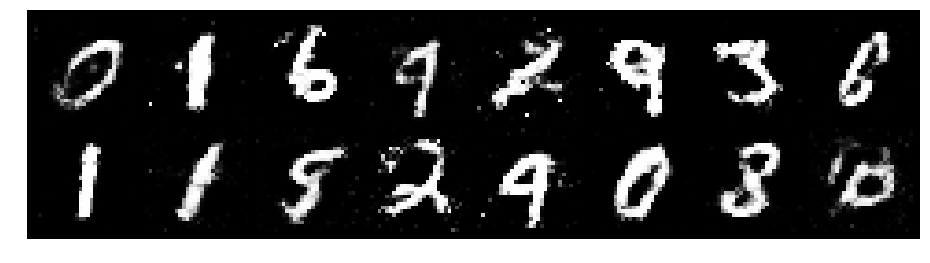

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.2468, Generator Loss: 0.8903
D(x): 0.5527, D(G(z)): 0.4093


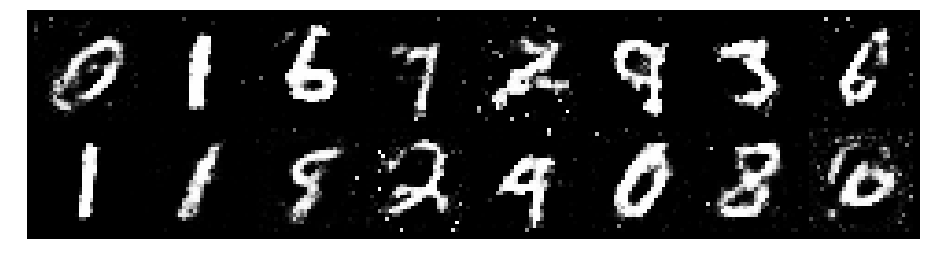

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2028, Generator Loss: 0.9520
D(x): 0.5724, D(G(z)): 0.4379


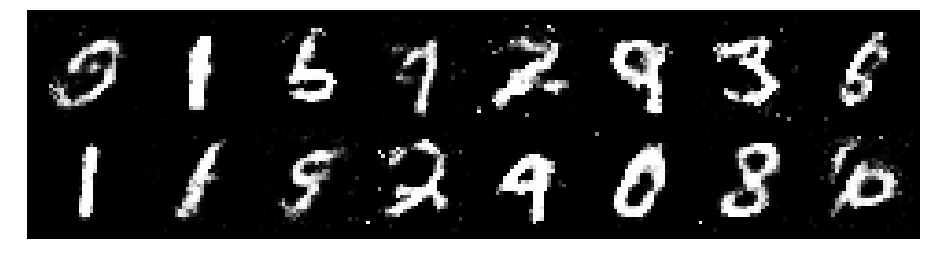

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.3054, Generator Loss: 0.8601
D(x): 0.6038, D(G(z)): 0.4793


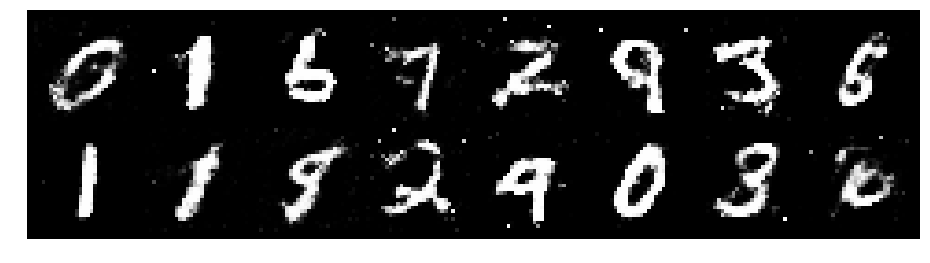

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2277, Generator Loss: 1.0380
D(x): 0.5889, D(G(z)): 0.4107


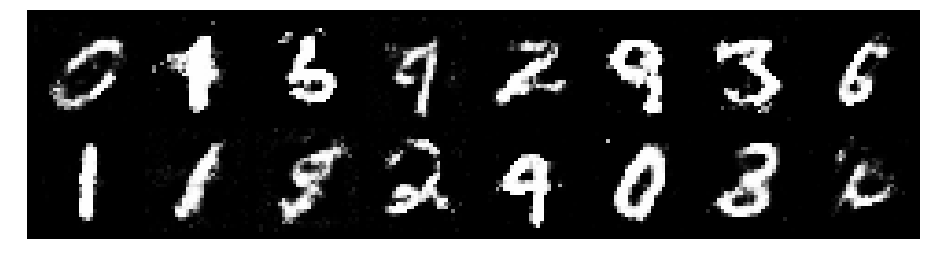

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.2064, Generator Loss: 0.8539
D(x): 0.5587, D(G(z)): 0.4028


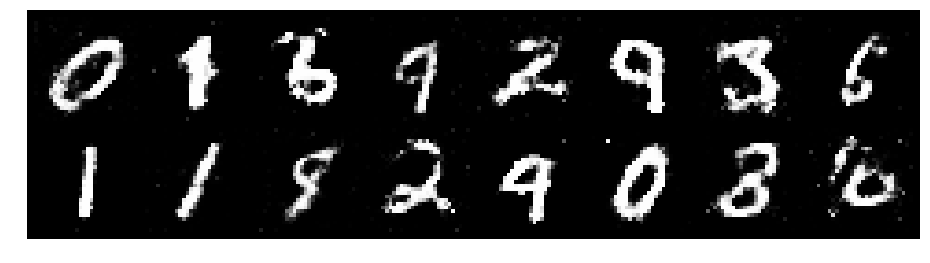

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.1736, Generator Loss: 1.0150
D(x): 0.5778, D(G(z)): 0.3827


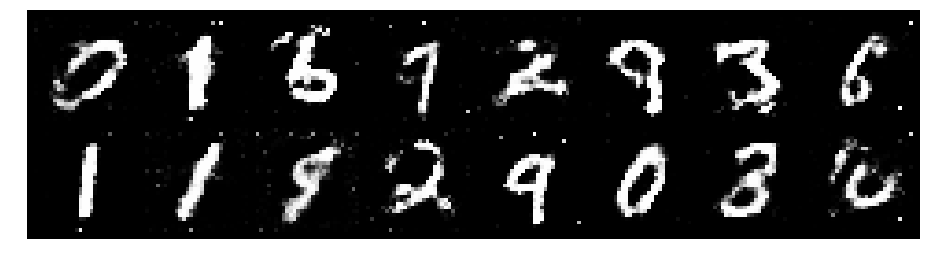

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2189, Generator Loss: 1.2294
D(x): 0.5834, D(G(z)): 0.3663


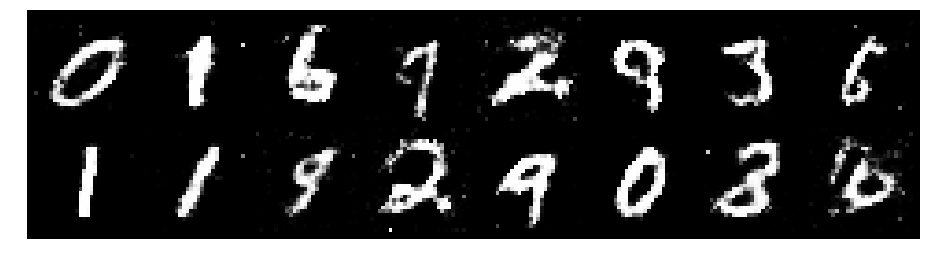

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1091, Generator Loss: 1.0986
D(x): 0.6334, D(G(z)): 0.4088


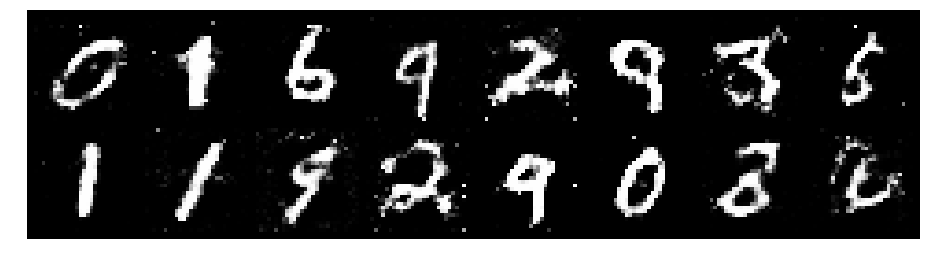

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.2901, Generator Loss: 0.8332
D(x): 0.5817, D(G(z)): 0.4667


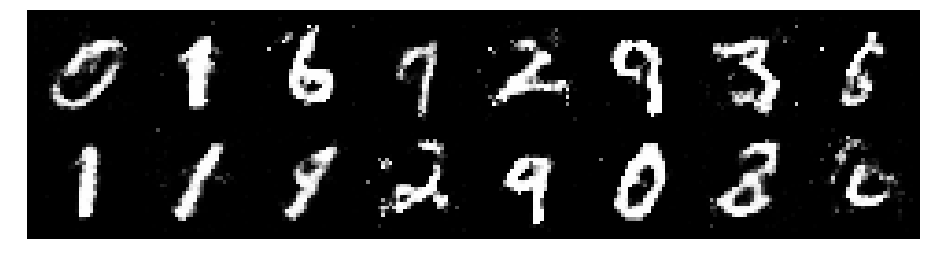

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1809, Generator Loss: 0.9600
D(x): 0.5836, D(G(z)): 0.3987


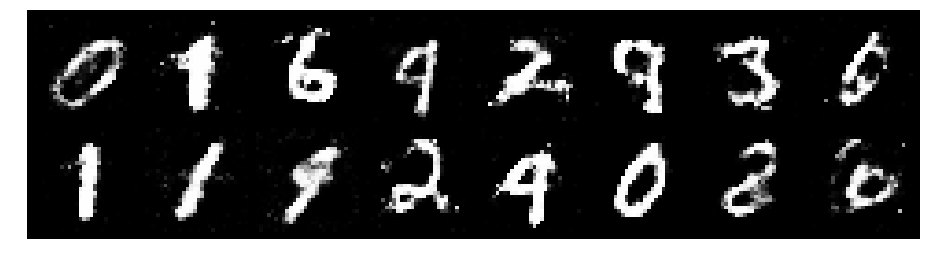

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.1903, Generator Loss: 0.8695
D(x): 0.5784, D(G(z)): 0.4343


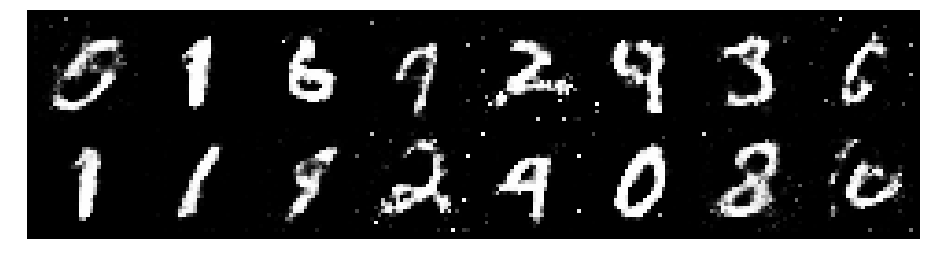

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.1484, Generator Loss: 0.9332
D(x): 0.5866, D(G(z)): 0.4163


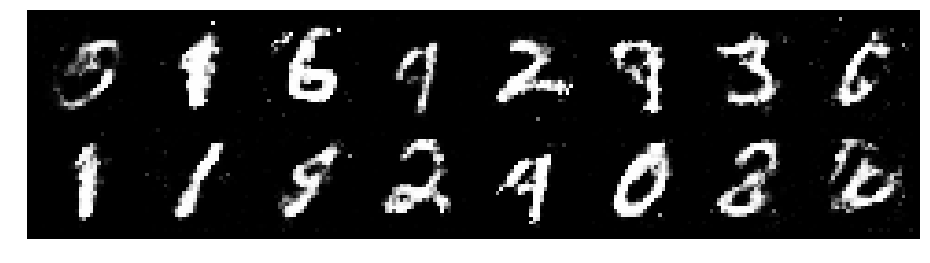

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.2729, Generator Loss: 0.9018
D(x): 0.5534, D(G(z)): 0.4483


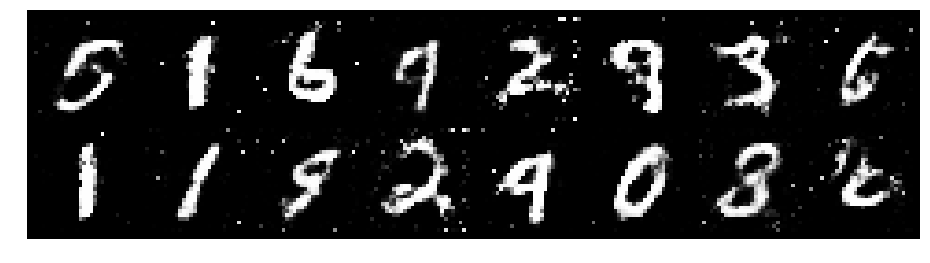

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1675, Generator Loss: 1.0832
D(x): 0.5869, D(G(z)): 0.3959


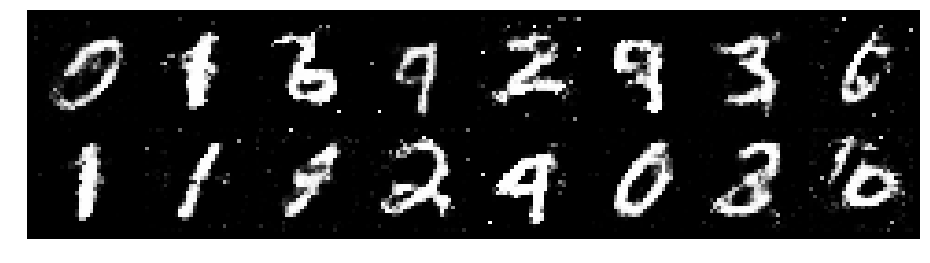

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1830, Generator Loss: 1.0355
D(x): 0.5885, D(G(z)): 0.4177


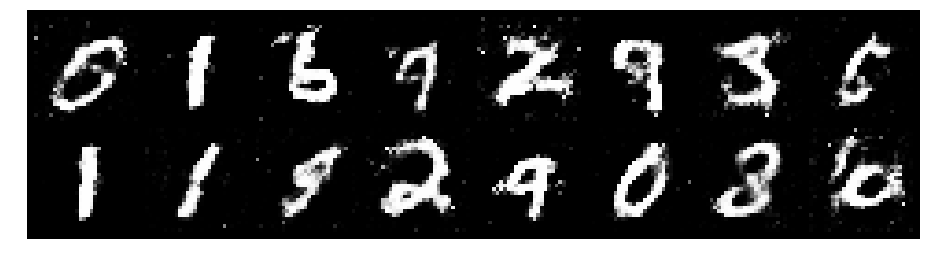

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.4005, Generator Loss: 1.0490
D(x): 0.5667, D(G(z)): 0.4813


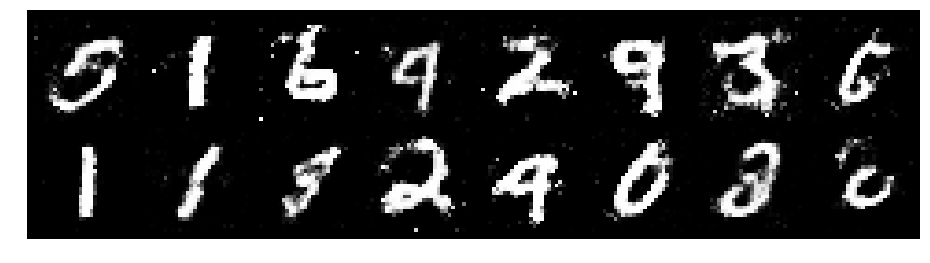

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2239, Generator Loss: 1.1067
D(x): 0.6398, D(G(z)): 0.4569


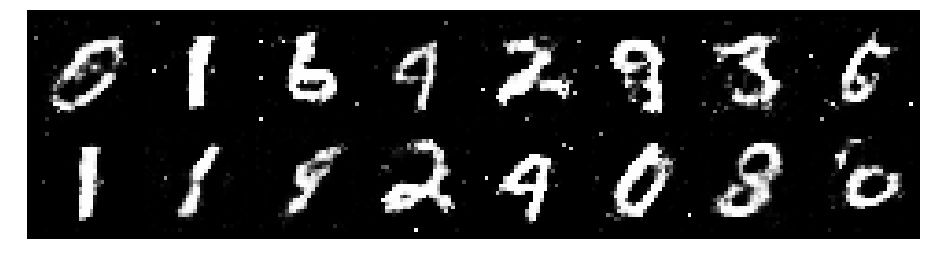

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.1351, Generator Loss: 0.9117
D(x): 0.5978, D(G(z)): 0.4102


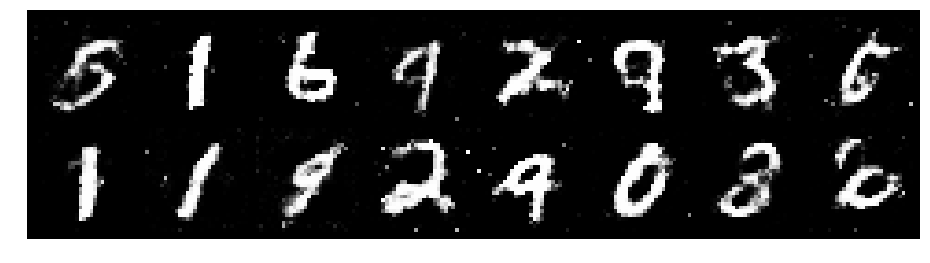

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.1828, Generator Loss: 1.0936
D(x): 0.5947, D(G(z)): 0.3839


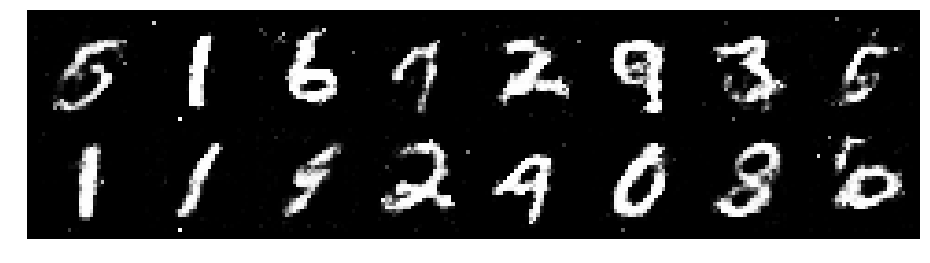

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2713, Generator Loss: 0.9147
D(x): 0.5853, D(G(z)): 0.4326


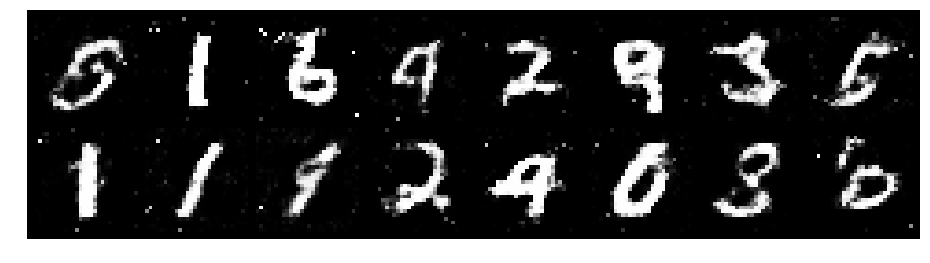

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1455, Generator Loss: 1.0960
D(x): 0.5835, D(G(z)): 0.3882


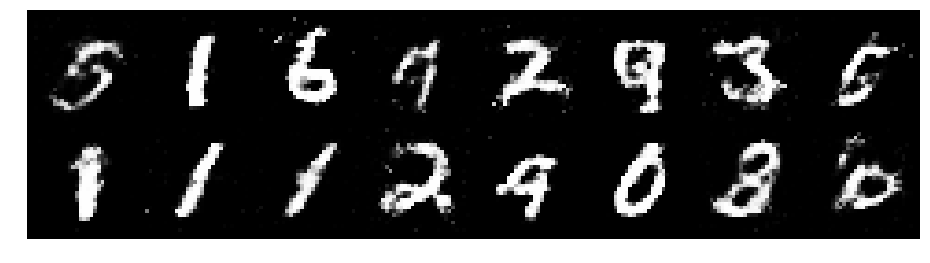

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.1641, Generator Loss: 0.9362
D(x): 0.5601, D(G(z)): 0.3931


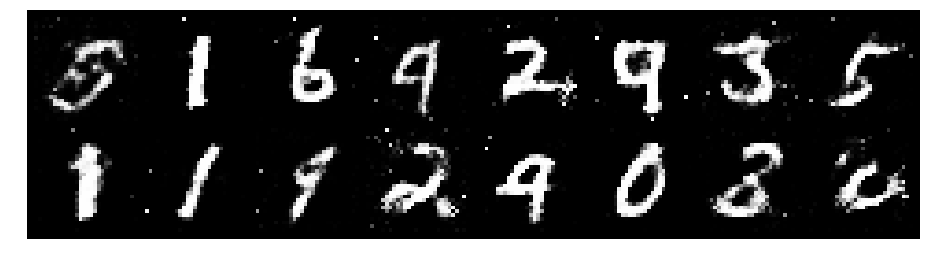

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.2027, Generator Loss: 0.9430
D(x): 0.6084, D(G(z)): 0.4514


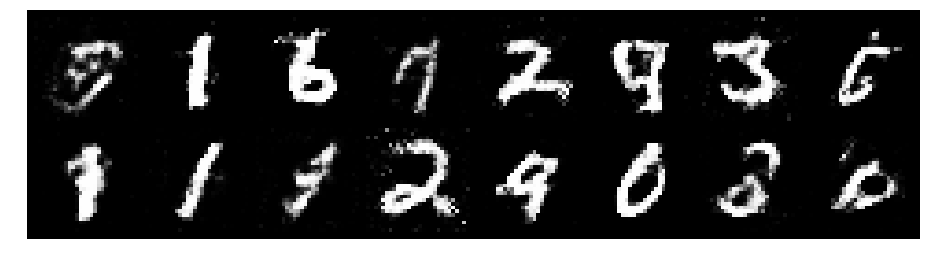

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.3318, Generator Loss: 0.9645
D(x): 0.5725, D(G(z)): 0.4458


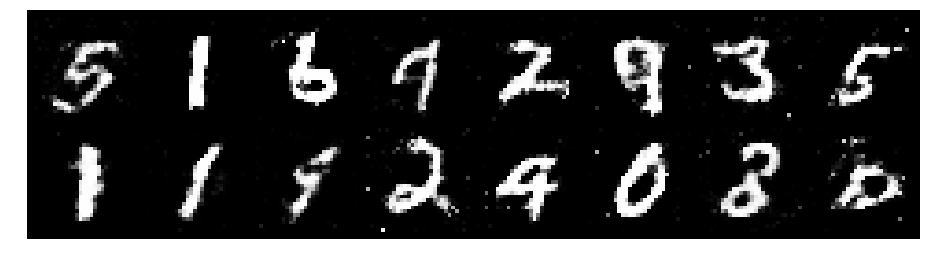

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2352, Generator Loss: 0.9242
D(x): 0.5679, D(G(z)): 0.4009


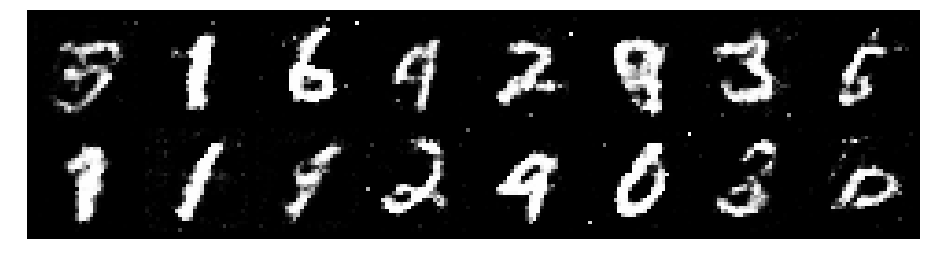

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.1097, Generator Loss: 0.9743
D(x): 0.6524, D(G(z)): 0.4023


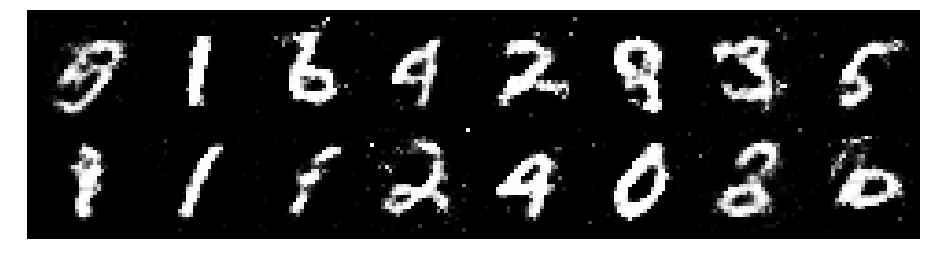

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1899, Generator Loss: 1.1811
D(x): 0.6166, D(G(z)): 0.4229


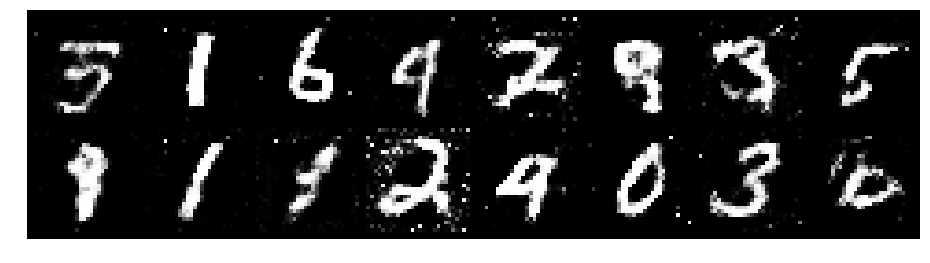

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2404, Generator Loss: 0.9286
D(x): 0.5910, D(G(z)): 0.4355


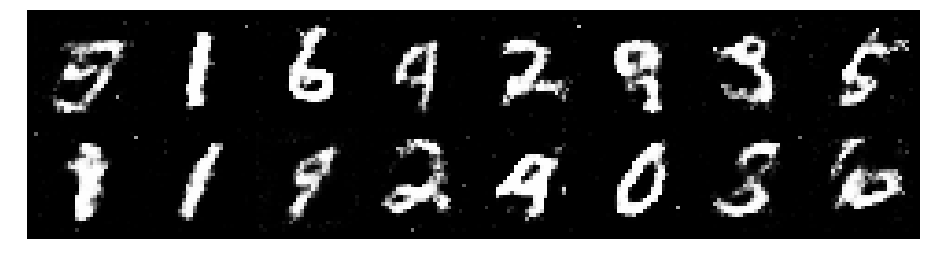

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2004, Generator Loss: 1.0251
D(x): 0.5872, D(G(z)): 0.4401


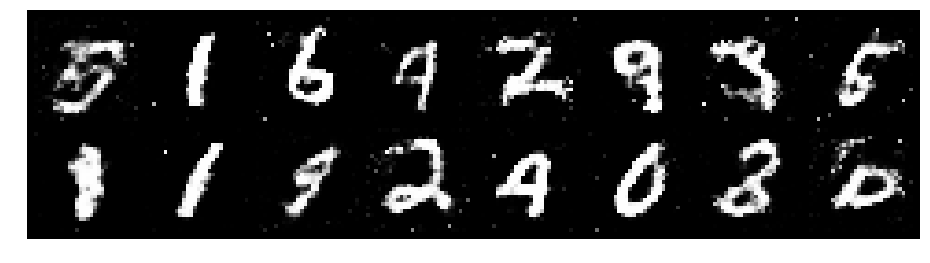

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2771, Generator Loss: 0.8706
D(x): 0.5581, D(G(z)): 0.4278


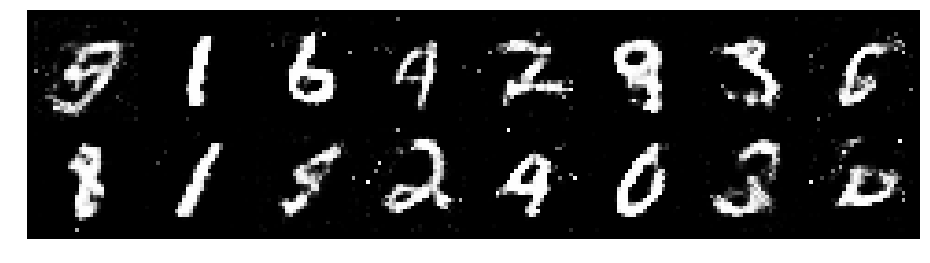

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.1867, Generator Loss: 1.1236
D(x): 0.5694, D(G(z)): 0.3918


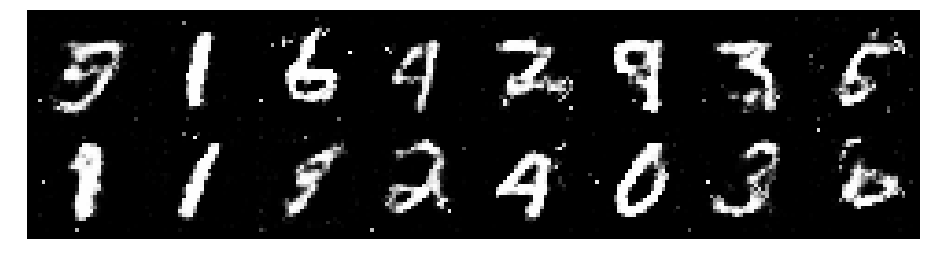

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.2487, Generator Loss: 0.8542
D(x): 0.5934, D(G(z)): 0.4518


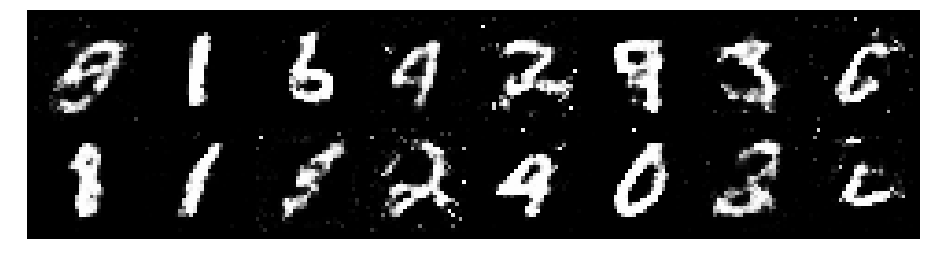

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.3943, Generator Loss: 0.8018
D(x): 0.5218, D(G(z)): 0.4711


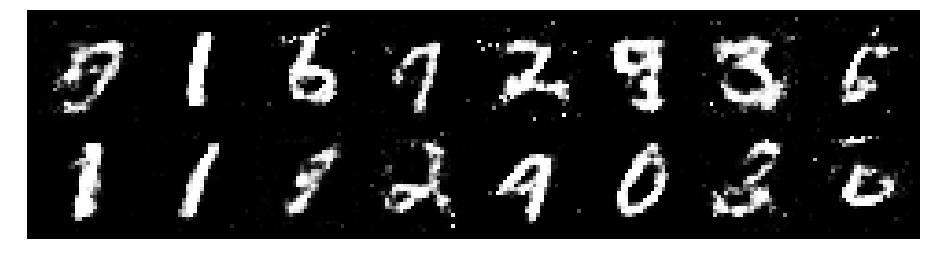

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.3167, Generator Loss: 0.8451
D(x): 0.5379, D(G(z)): 0.4635


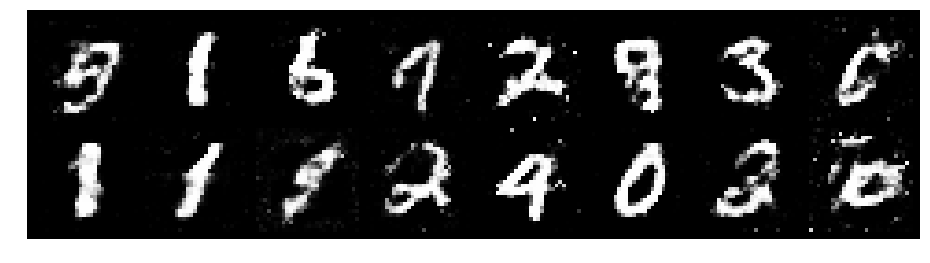

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.3190, Generator Loss: 0.9128
D(x): 0.5214, D(G(z)): 0.4215


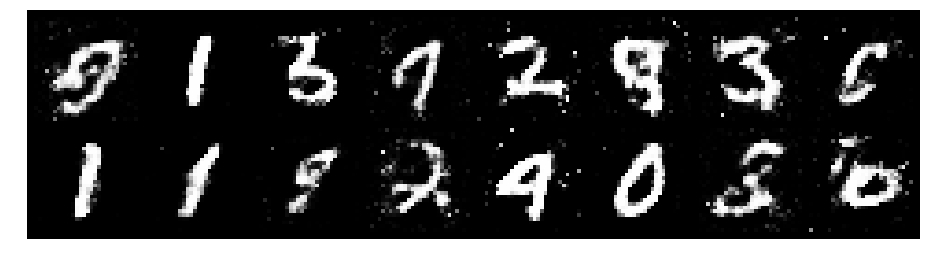

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2386, Generator Loss: 0.8529
D(x): 0.5649, D(G(z)): 0.4477


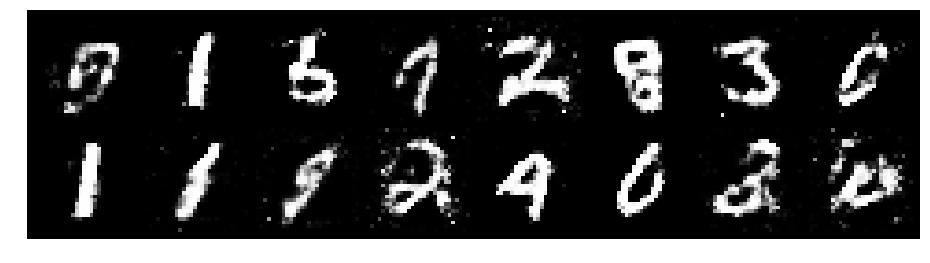

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2128, Generator Loss: 0.9275
D(x): 0.5849, D(G(z)): 0.4314


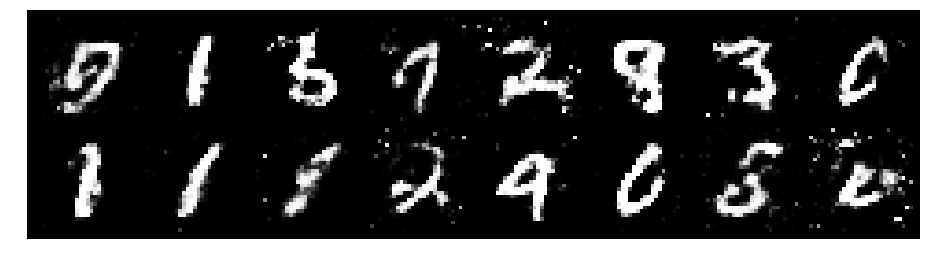

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2239, Generator Loss: 0.9063
D(x): 0.5287, D(G(z)): 0.3950


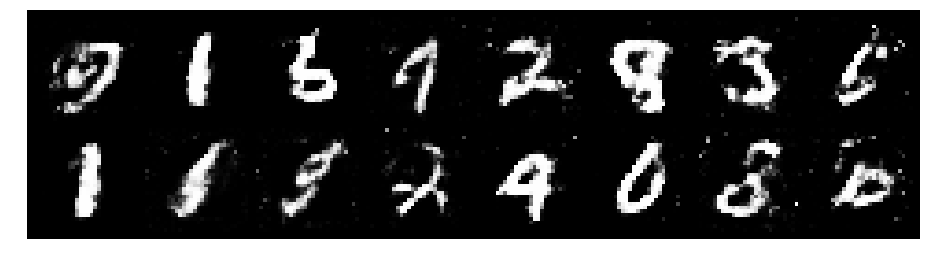

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2179, Generator Loss: 1.0583
D(x): 0.5678, D(G(z)): 0.3980


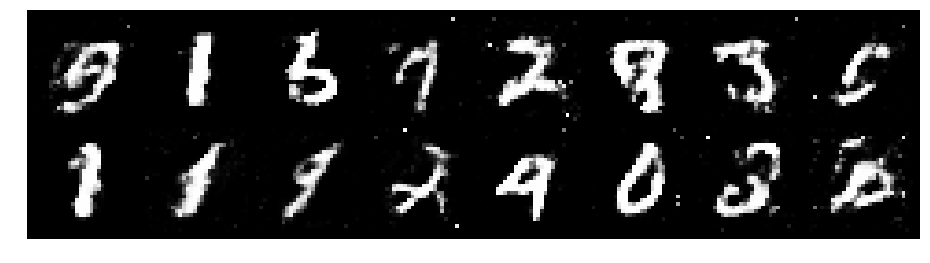

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.1376, Generator Loss: 1.0267
D(x): 0.5890, D(G(z)): 0.3952


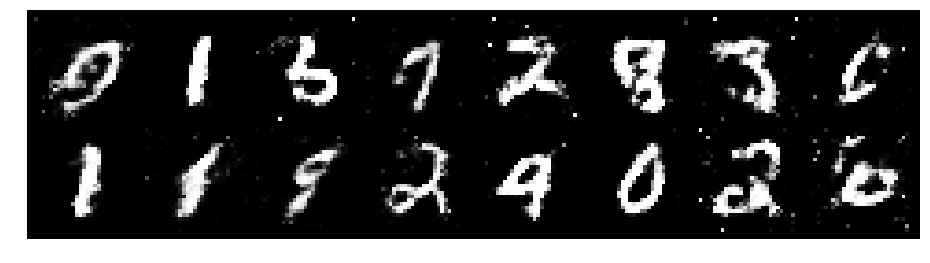

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.1837, Generator Loss: 0.8991
D(x): 0.5796, D(G(z)): 0.4174


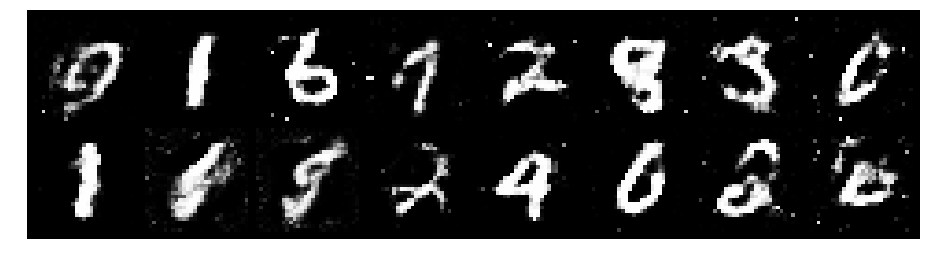

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.1686, Generator Loss: 0.9255
D(x): 0.5957, D(G(z)): 0.4284


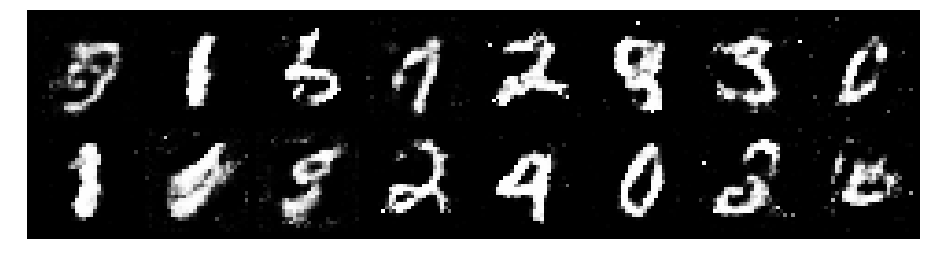

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.1913, Generator Loss: 0.9363
D(x): 0.5632, D(G(z)): 0.4052


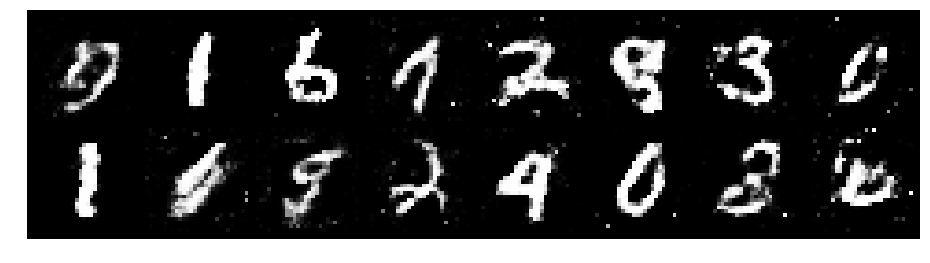

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2210, Generator Loss: 0.9829
D(x): 0.5901, D(G(z)): 0.4275


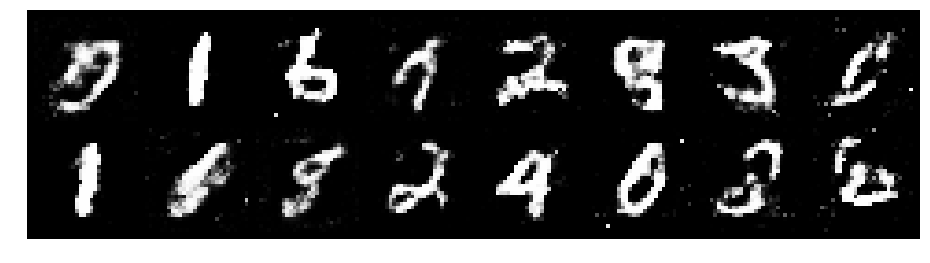

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.4588, Generator Loss: 0.9859
D(x): 0.5728, D(G(z)): 0.4906


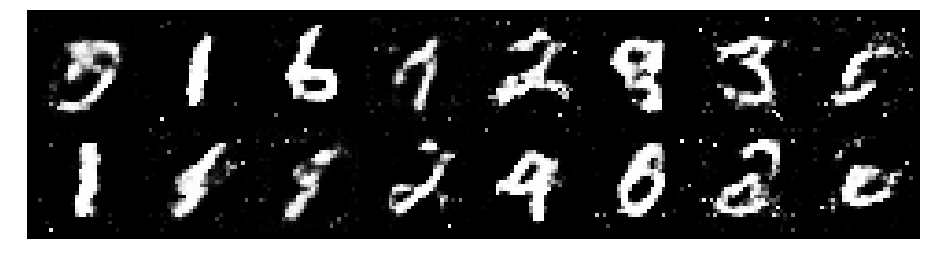

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2780, Generator Loss: 1.1267
D(x): 0.5389, D(G(z)): 0.3664


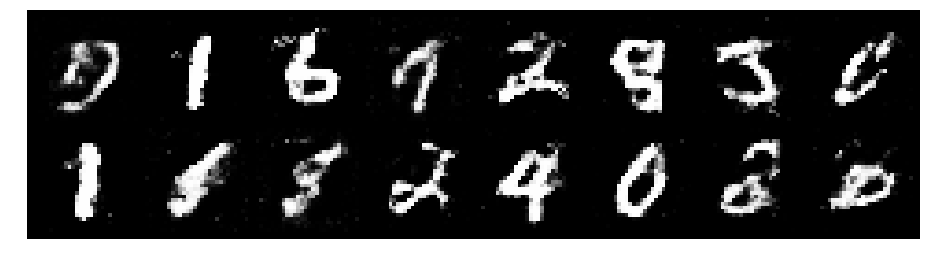

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.1683, Generator Loss: 1.0380
D(x): 0.6027, D(G(z)): 0.4021


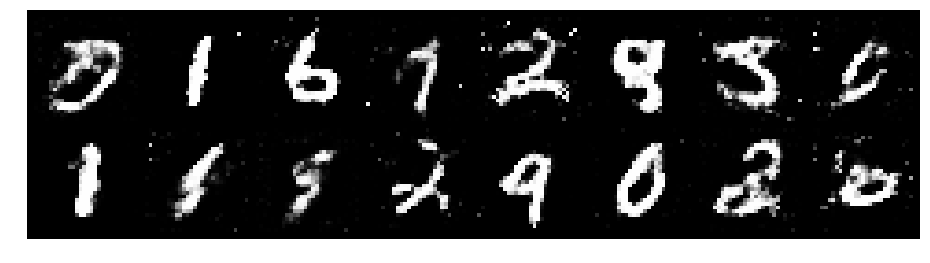

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.1584, Generator Loss: 0.8962
D(x): 0.5953, D(G(z)): 0.4221


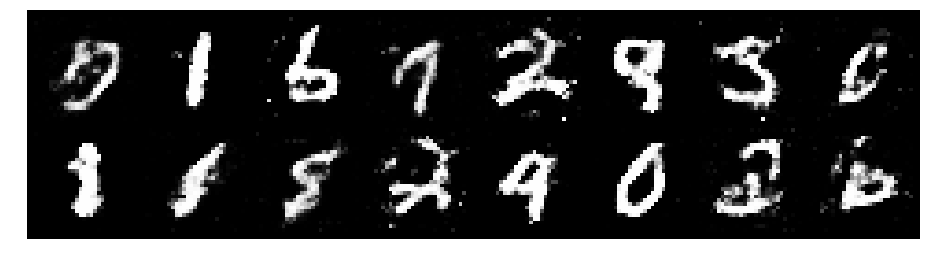

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.2590, Generator Loss: 0.8556
D(x): 0.5570, D(G(z)): 0.4344


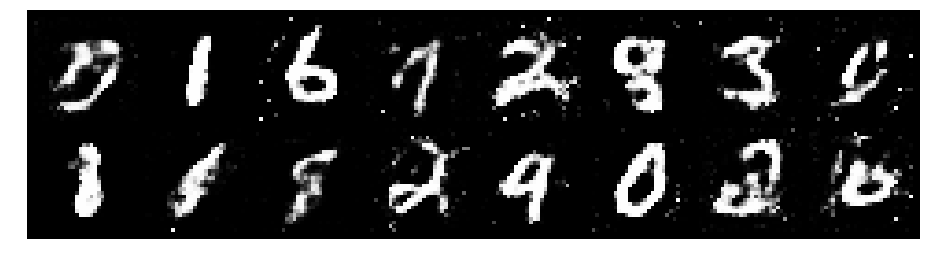

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2672, Generator Loss: 0.8819
D(x): 0.5609, D(G(z)): 0.4516


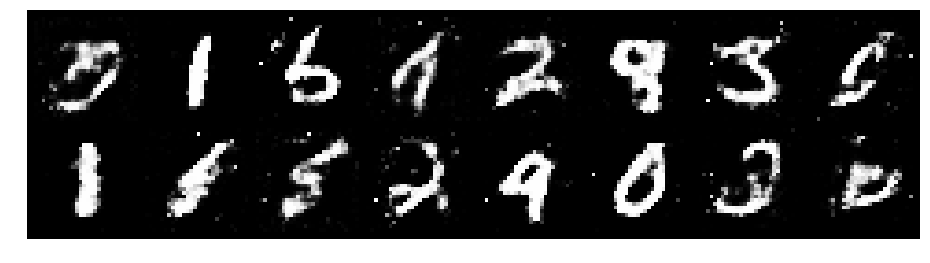

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.1492, Generator Loss: 0.9183
D(x): 0.6090, D(G(z)): 0.4252


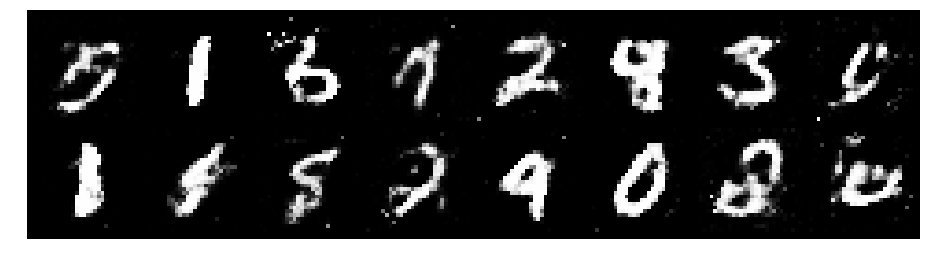

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1586, Generator Loss: 0.9522
D(x): 0.6001, D(G(z)): 0.4009


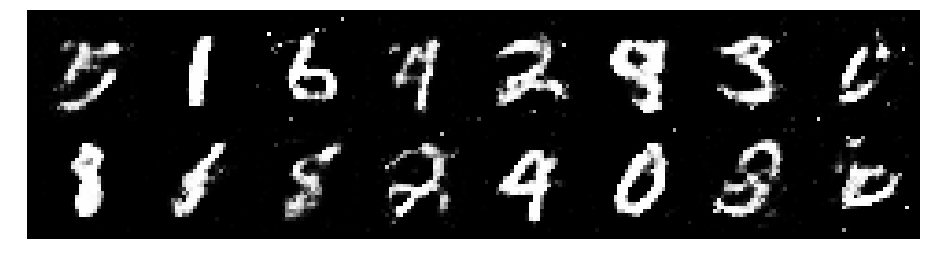

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.0326, Generator Loss: 1.0557
D(x): 0.6378, D(G(z)): 0.3776


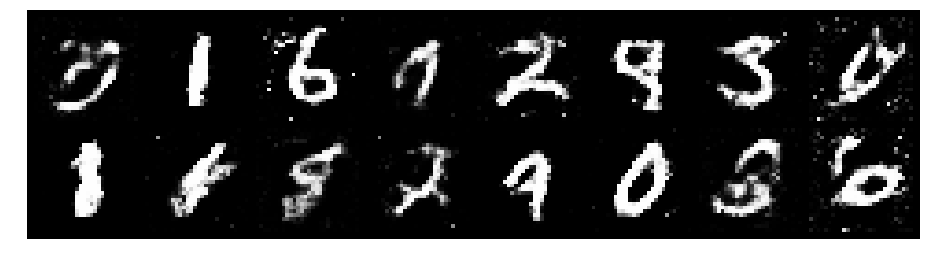

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2965, Generator Loss: 0.8202
D(x): 0.5511, D(G(z)): 0.4564


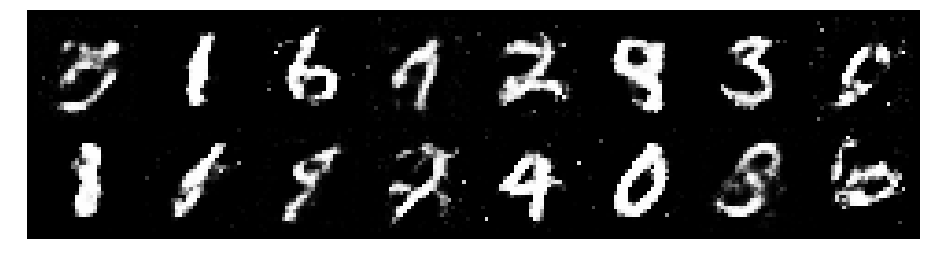

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2582, Generator Loss: 0.8364
D(x): 0.5739, D(G(z)): 0.4637


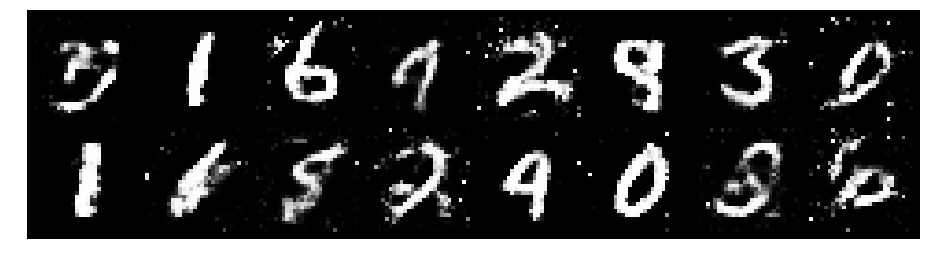

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2563, Generator Loss: 0.8486
D(x): 0.5611, D(G(z)): 0.4524


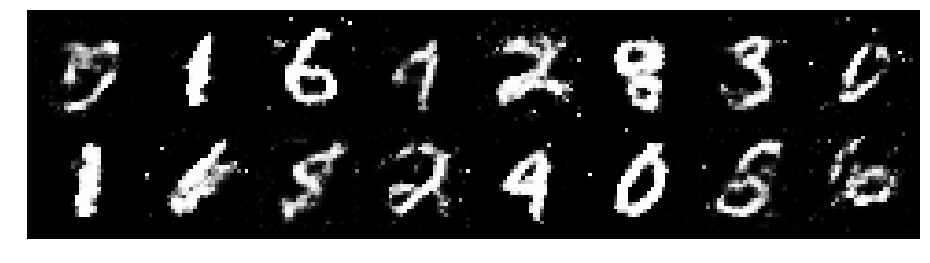

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2219, Generator Loss: 1.0012
D(x): 0.5363, D(G(z)): 0.3992


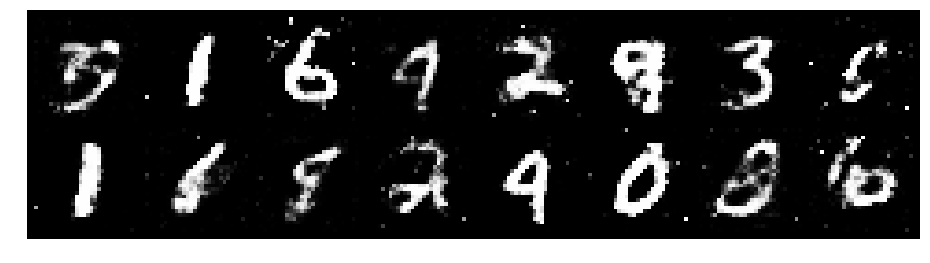

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2864, Generator Loss: 0.8500
D(x): 0.5560, D(G(z)): 0.4584


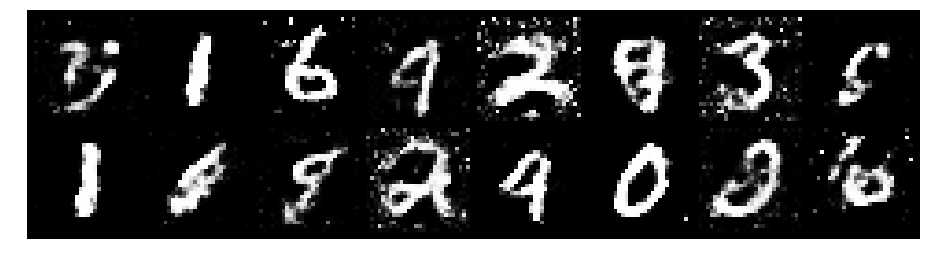

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8289
D(x): 0.5621, D(G(z)): 0.4617


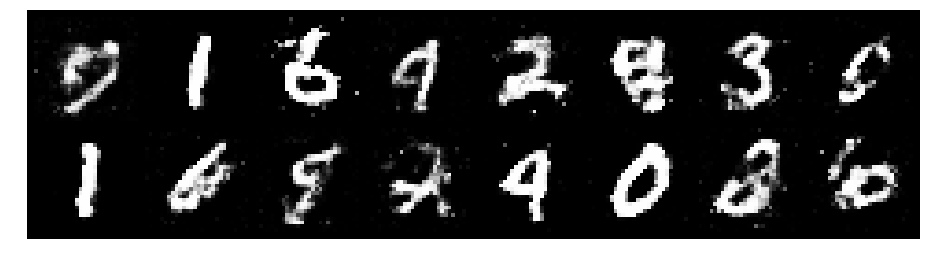

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2967, Generator Loss: 0.8736
D(x): 0.5197, D(G(z)): 0.4159


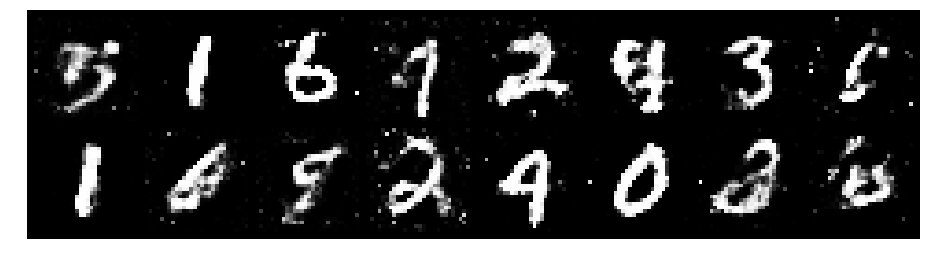

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2180, Generator Loss: 1.0604
D(x): 0.5800, D(G(z)): 0.4067


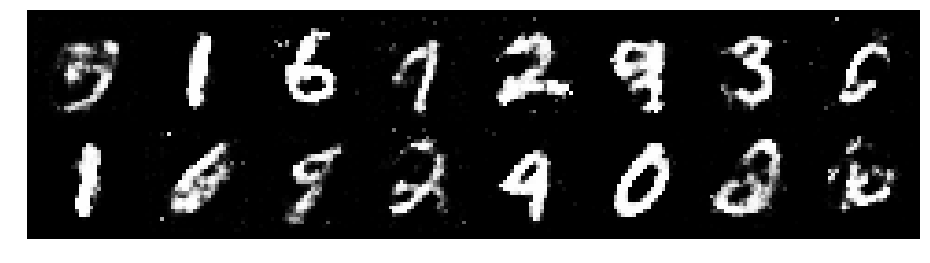

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2332, Generator Loss: 0.8333
D(x): 0.6383, D(G(z)): 0.4922


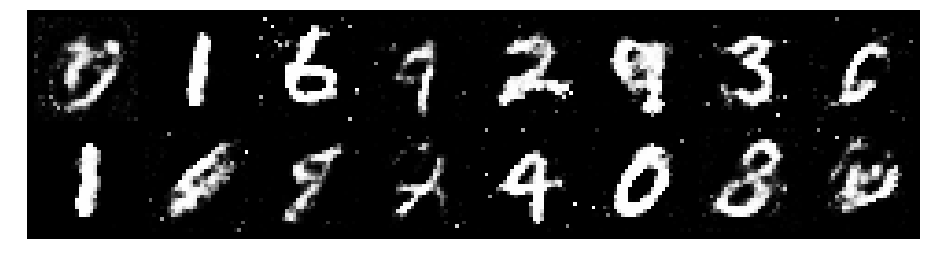

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1682, Generator Loss: 1.0017
D(x): 0.5715, D(G(z)): 0.3914


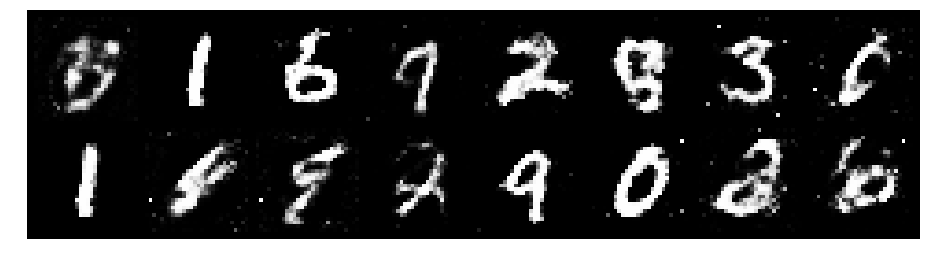

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9514
D(x): 0.5602, D(G(z)): 0.4172


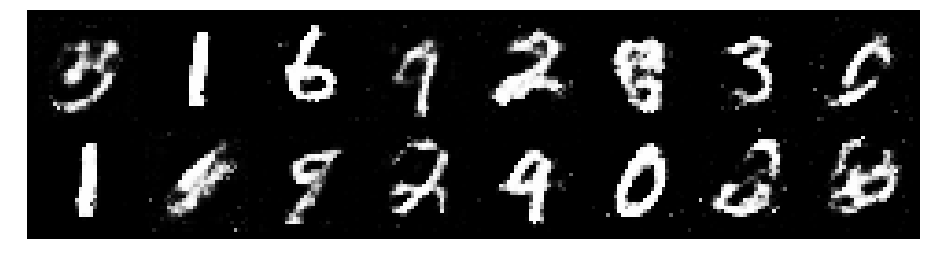

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2075, Generator Loss: 0.9277
D(x): 0.6020, D(G(z)): 0.4445


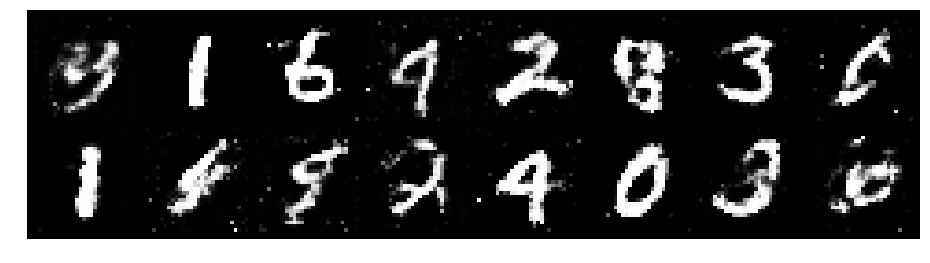

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2454, Generator Loss: 0.8852
D(x): 0.5490, D(G(z)): 0.4290


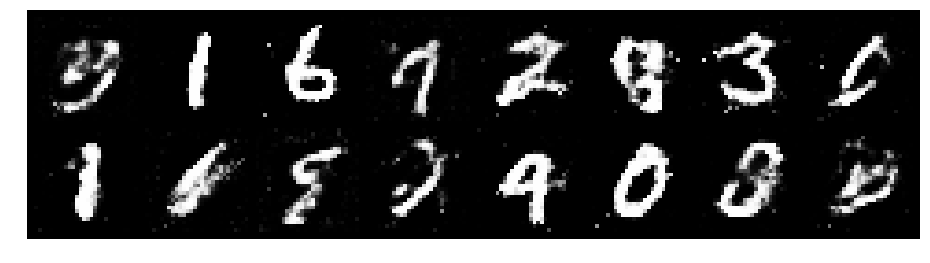

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.3390, Generator Loss: 1.0177
D(x): 0.5472, D(G(z)): 0.4531


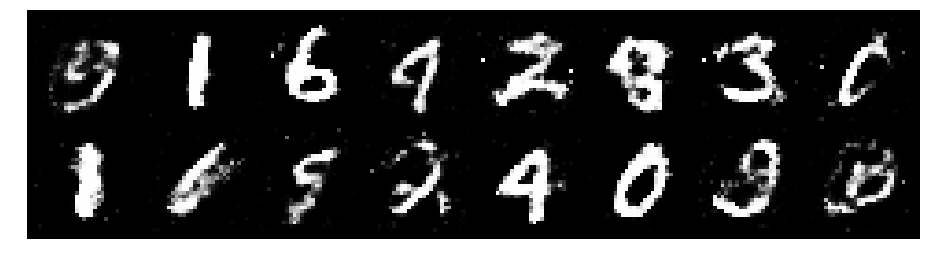

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.3226, Generator Loss: 1.1604
D(x): 0.5829, D(G(z)): 0.4244


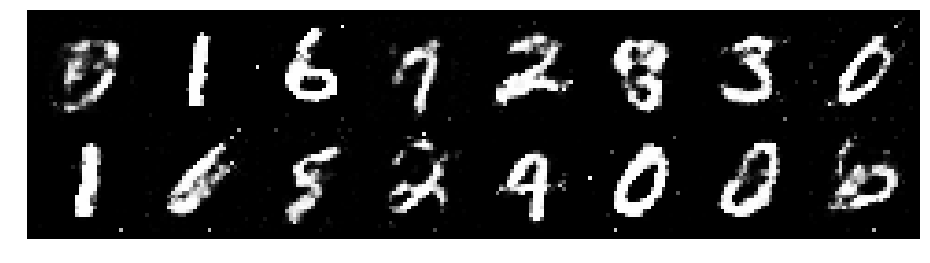

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2034, Generator Loss: 1.0104
D(x): 0.6009, D(G(z)): 0.4081


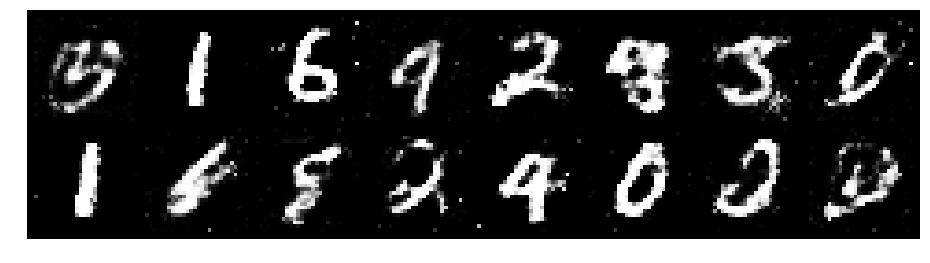

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.2525, Generator Loss: 0.9383
D(x): 0.5755, D(G(z)): 0.4300


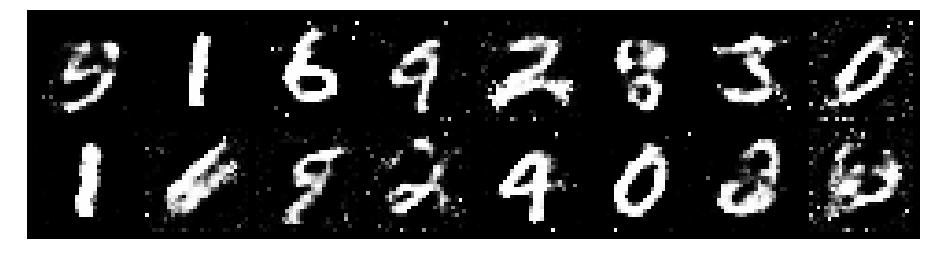

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.1105, Generator Loss: 1.0463
D(x): 0.5949, D(G(z)): 0.3807


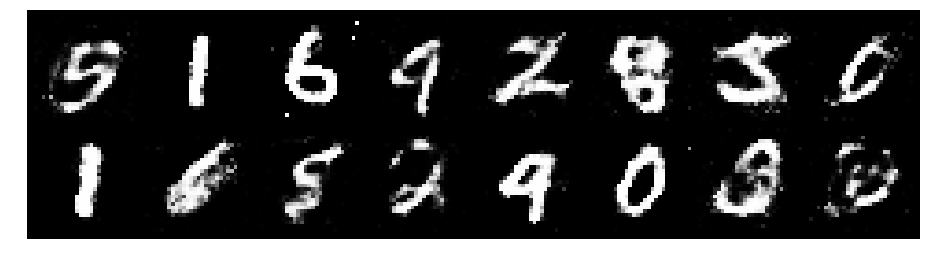

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.2662, Generator Loss: 1.1704
D(x): 0.5685, D(G(z)): 0.4324


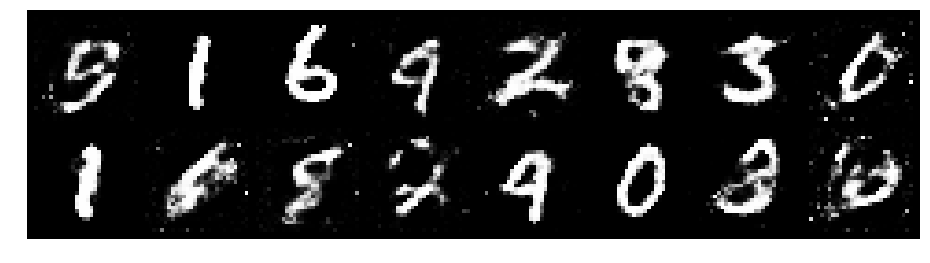

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.1406, Generator Loss: 0.9946
D(x): 0.5996, D(G(z)): 0.4006


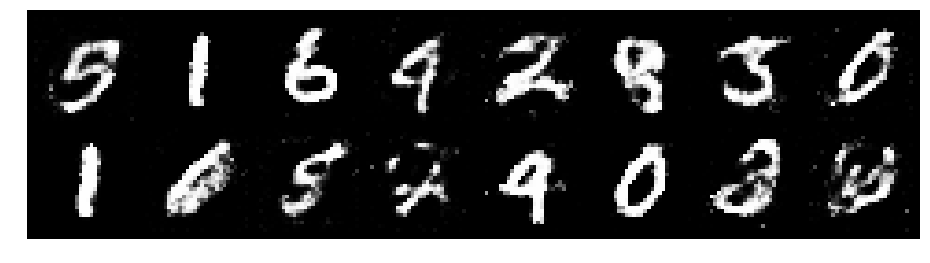

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1758, Generator Loss: 0.9119
D(x): 0.6126, D(G(z)): 0.4360


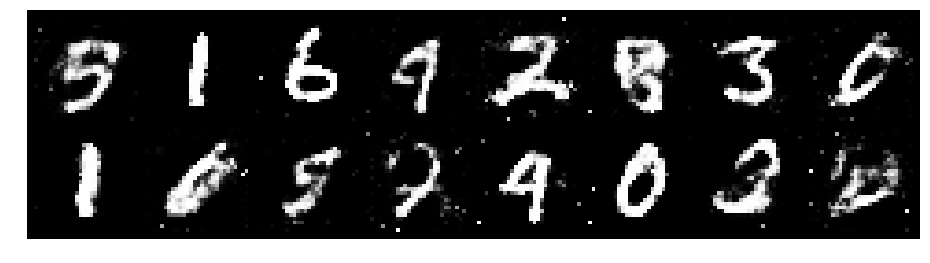

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.1679, Generator Loss: 1.1795
D(x): 0.5387, D(G(z)): 0.3767


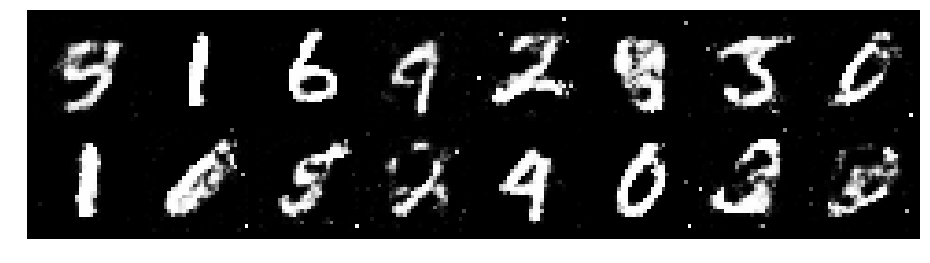

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2936, Generator Loss: 0.9299
D(x): 0.5446, D(G(z)): 0.4412


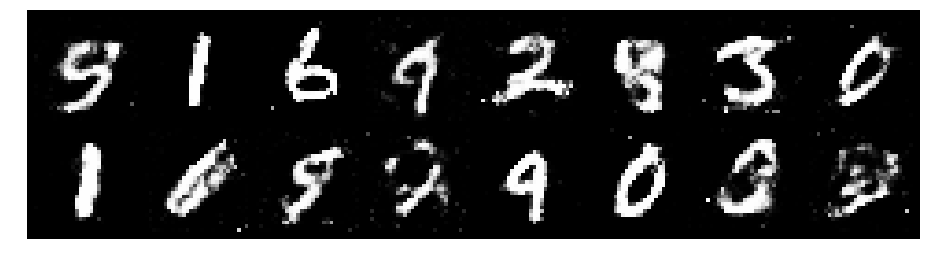

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.3411, Generator Loss: 0.8403
D(x): 0.5712, D(G(z)): 0.4769


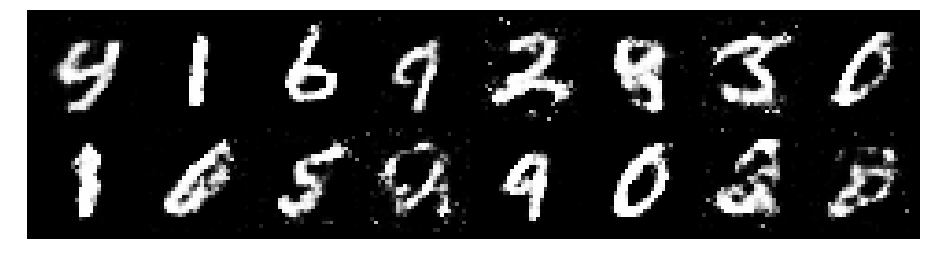

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2975, Generator Loss: 0.8785
D(x): 0.5485, D(G(z)): 0.4636


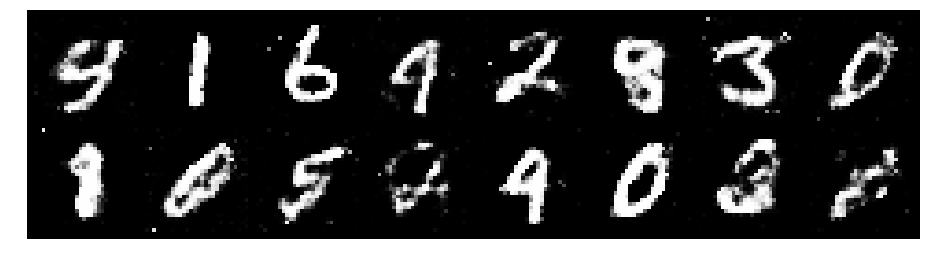

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.4416, Generator Loss: 0.8190
D(x): 0.5881, D(G(z)): 0.5209


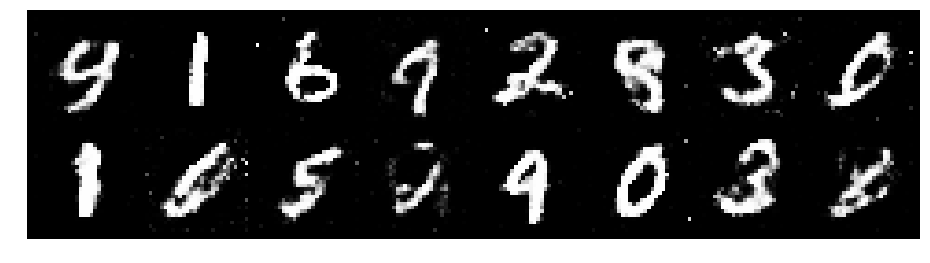

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2240, Generator Loss: 1.1255
D(x): 0.5941, D(G(z)): 0.4254


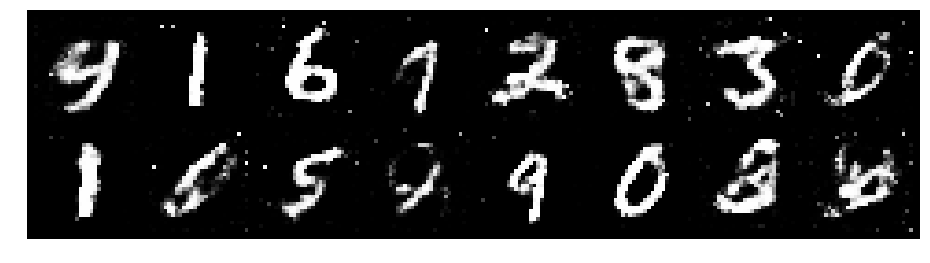

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.1216, Generator Loss: 1.1864
D(x): 0.5666, D(G(z)): 0.3535


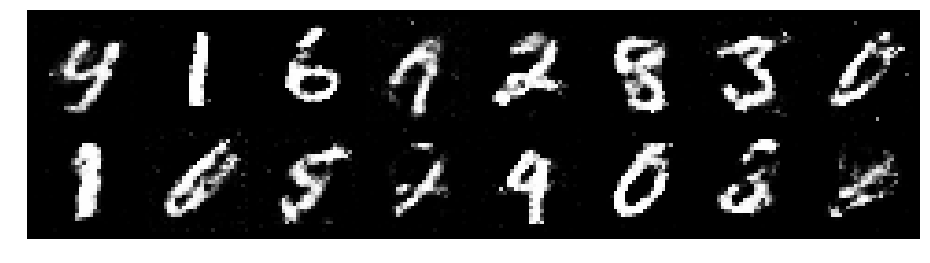

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.1527, Generator Loss: 0.9547
D(x): 0.5881, D(G(z)): 0.4048


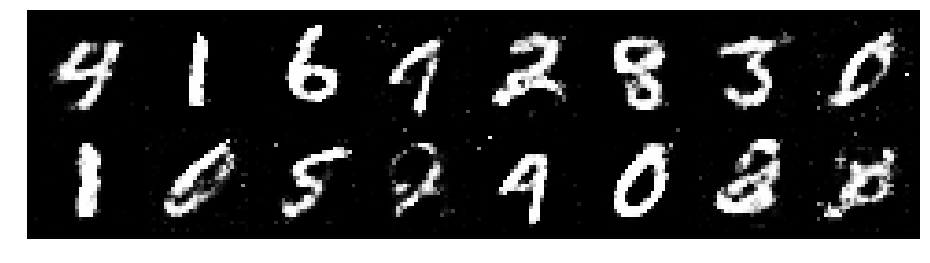

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2795, Generator Loss: 0.8369
D(x): 0.5881, D(G(z)): 0.4762


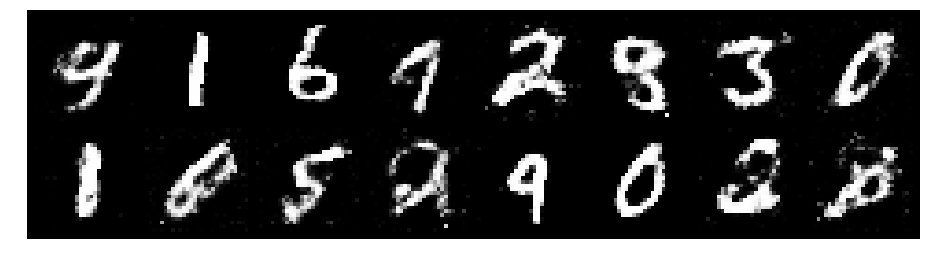

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.3055, Generator Loss: 0.9881
D(x): 0.5530, D(G(z)): 0.4294


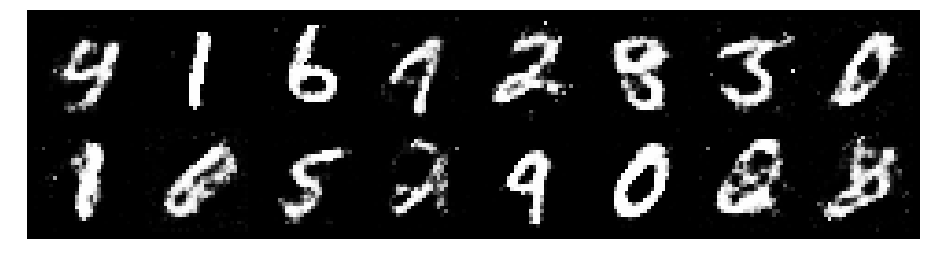

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.1935, Generator Loss: 1.1506
D(x): 0.5701, D(G(z)): 0.3865


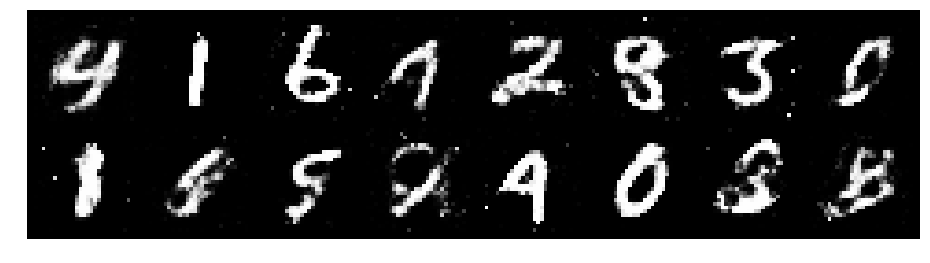

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.1129, Generator Loss: 1.0319
D(x): 0.6227, D(G(z)): 0.4234


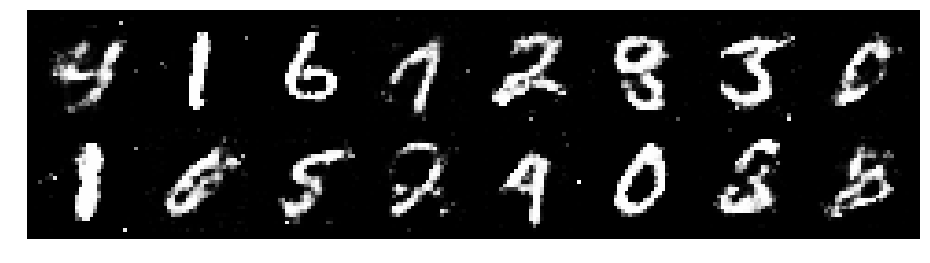

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2272, Generator Loss: 0.8703
D(x): 0.6031, D(G(z)): 0.4666


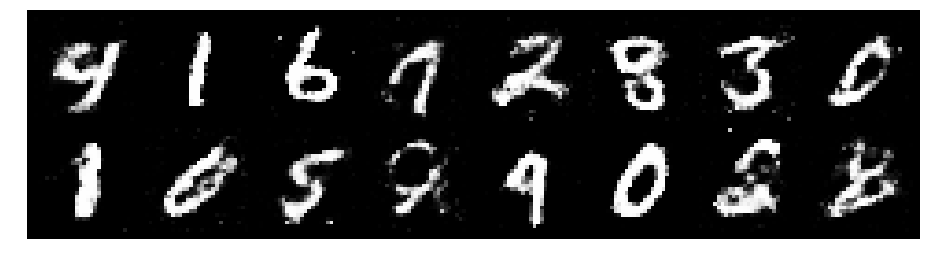

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2977, Generator Loss: 0.9001
D(x): 0.5573, D(G(z)): 0.4594


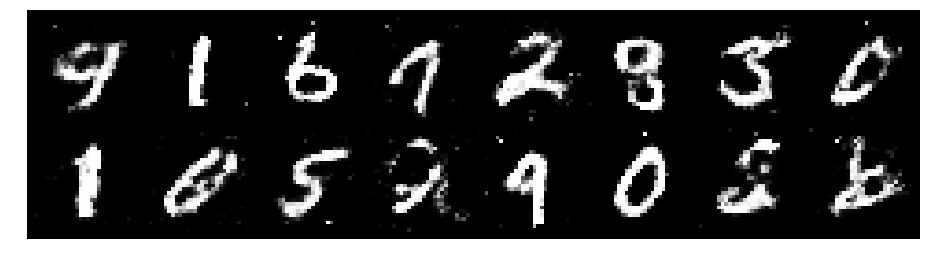

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2508, Generator Loss: 0.9830
D(x): 0.5564, D(G(z)): 0.4411


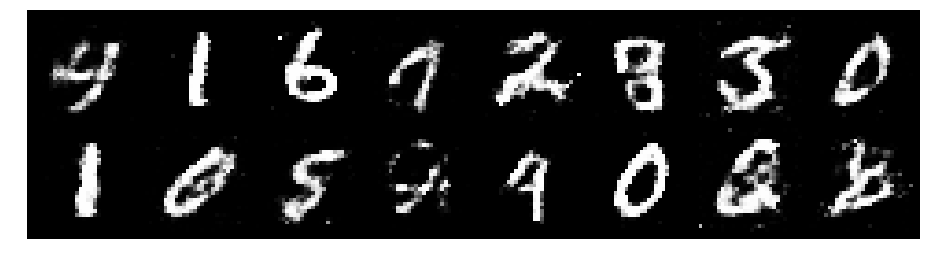

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.1802, Generator Loss: 0.8948
D(x): 0.6012, D(G(z)): 0.4430


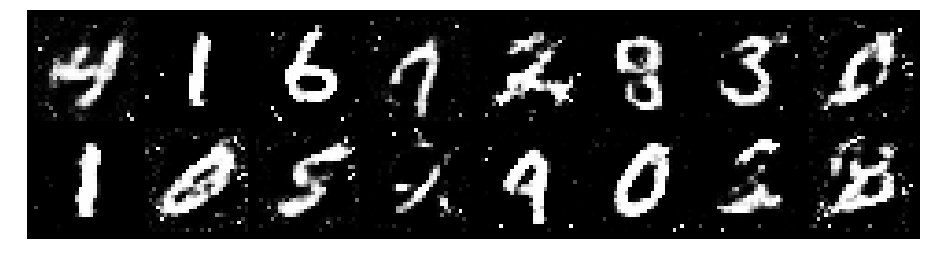

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2327, Generator Loss: 1.0488
D(x): 0.5294, D(G(z)): 0.4036


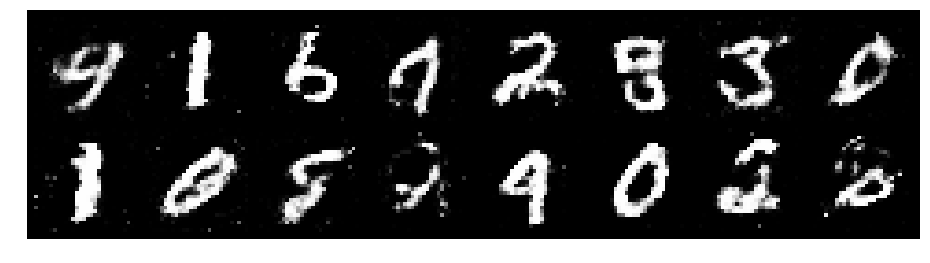

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2300, Generator Loss: 0.8603
D(x): 0.5530, D(G(z)): 0.4331


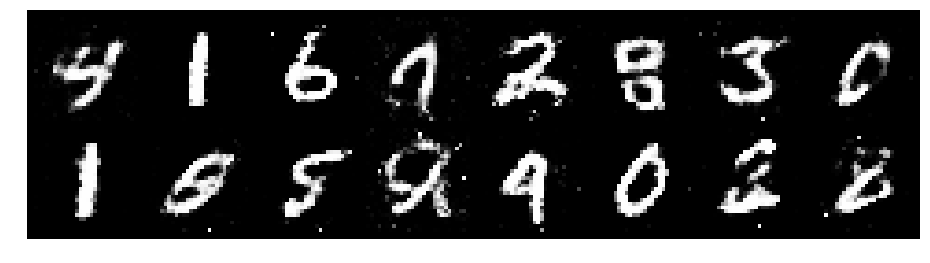

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2561, Generator Loss: 0.9532
D(x): 0.5949, D(G(z)): 0.4773


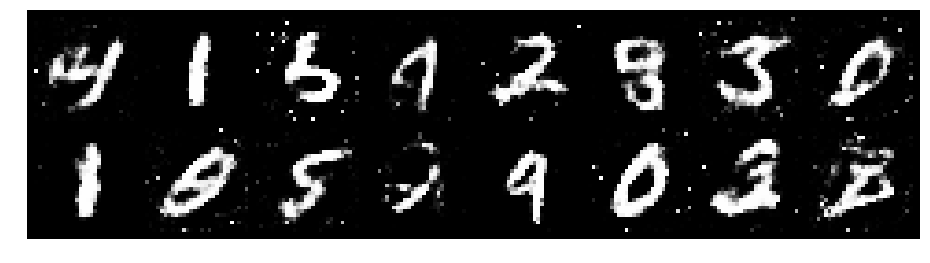

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2623, Generator Loss: 0.8830
D(x): 0.5257, D(G(z)): 0.4155


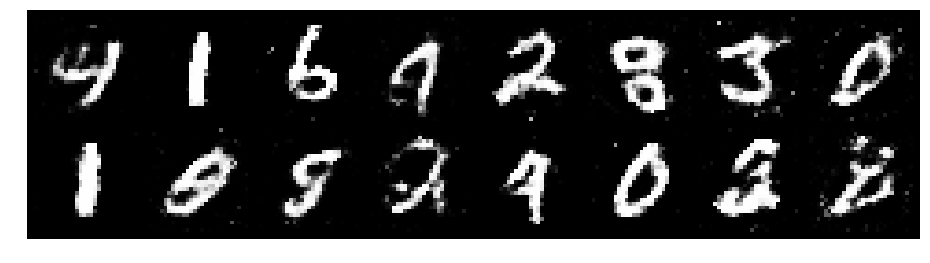

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.1951, Generator Loss: 0.9010
D(x): 0.5915, D(G(z)): 0.4424


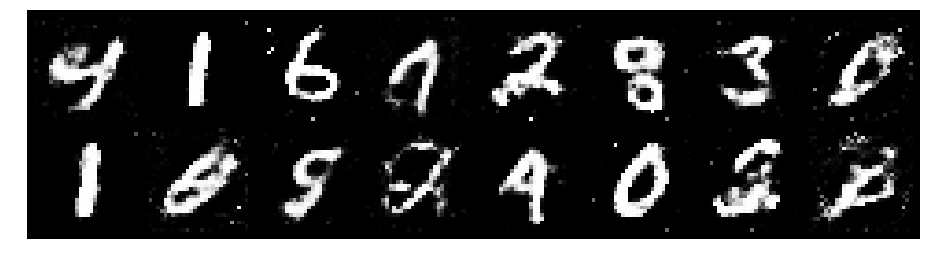

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2607, Generator Loss: 1.0149
D(x): 0.5656, D(G(z)): 0.4526


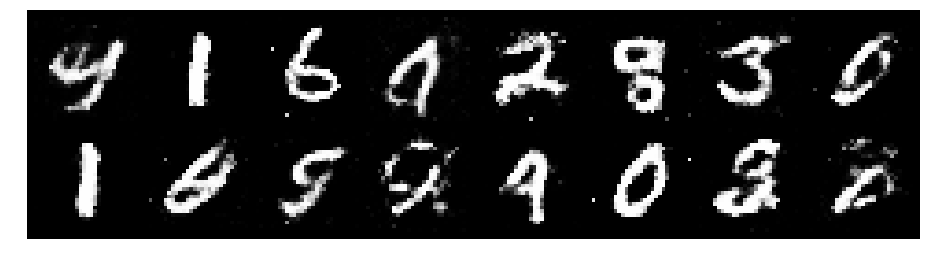

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2098, Generator Loss: 1.1151
D(x): 0.5975, D(G(z)): 0.4169


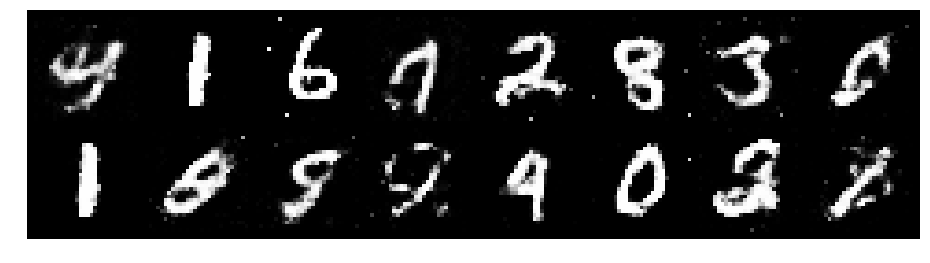

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.1587, Generator Loss: 1.0761
D(x): 0.6180, D(G(z)): 0.4189


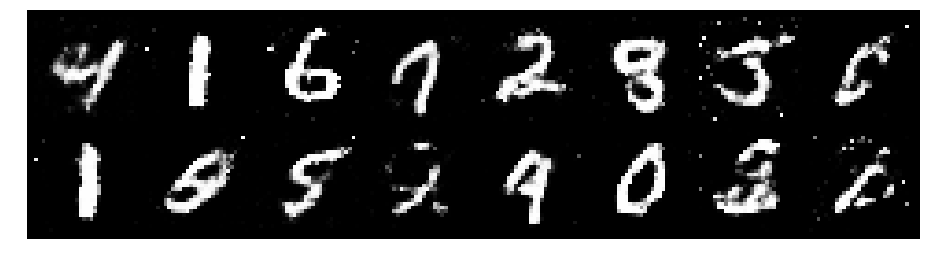

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2868, Generator Loss: 0.9475
D(x): 0.5609, D(G(z)): 0.4530


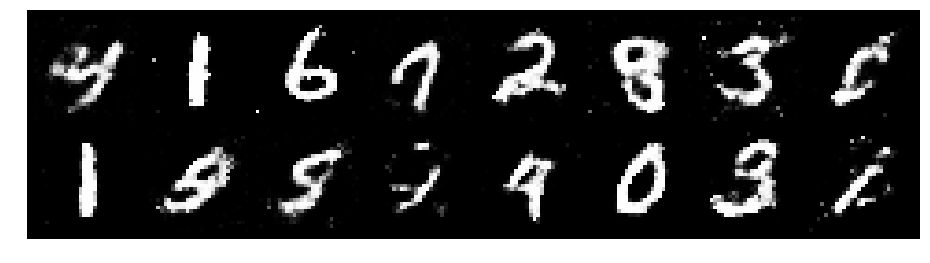

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2707, Generator Loss: 0.8550
D(x): 0.5426, D(G(z)): 0.4427


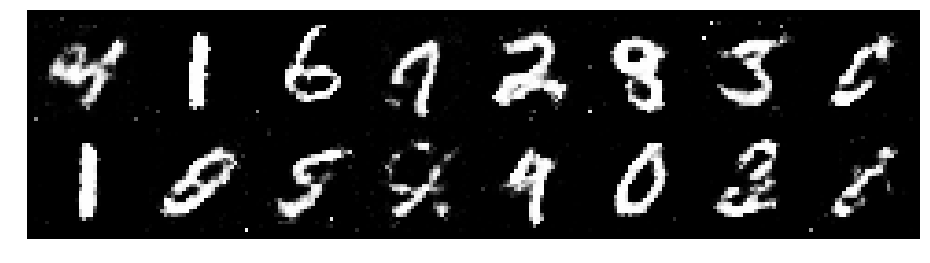

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.3973, Generator Loss: 0.8268
D(x): 0.5308, D(G(z)): 0.4863


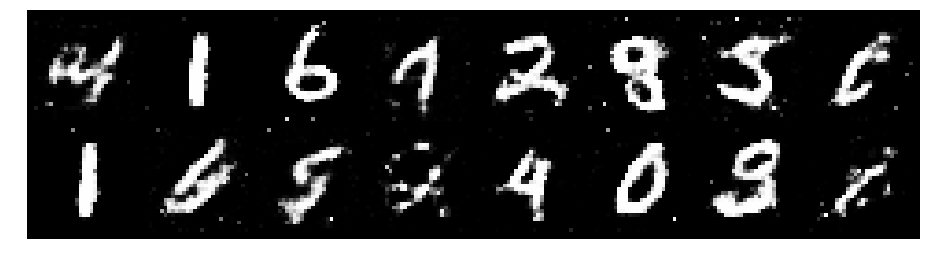

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1744, Generator Loss: 0.9634
D(x): 0.6356, D(G(z)): 0.4149


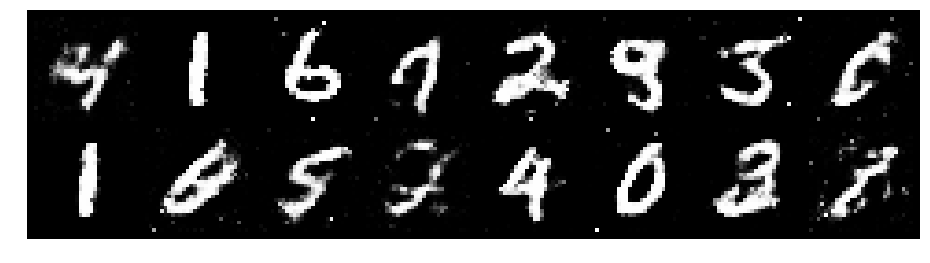

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.1760, Generator Loss: 1.1632
D(x): 0.5991, D(G(z)): 0.4080


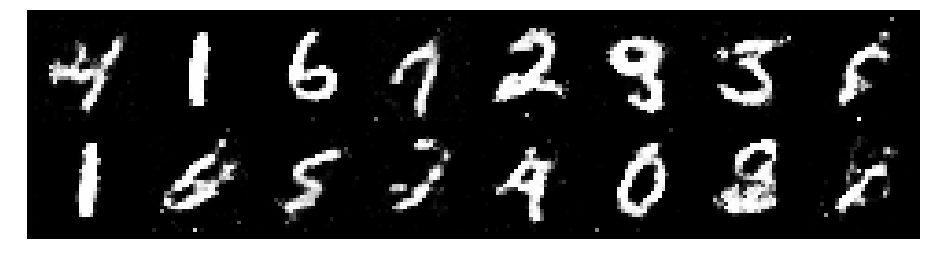

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2554, Generator Loss: 0.9612
D(x): 0.5946, D(G(z)): 0.4531


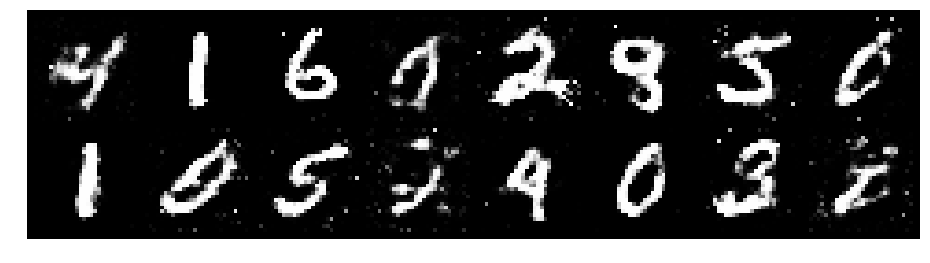

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.3405, Generator Loss: 0.9591
D(x): 0.5606, D(G(z)): 0.4778


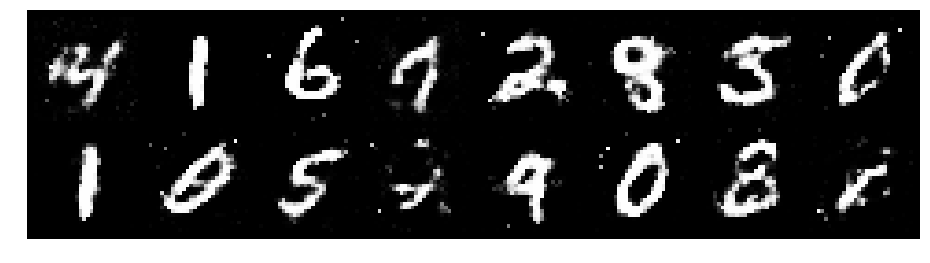

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.3211, Generator Loss: 0.7909
D(x): 0.5886, D(G(z)): 0.4969


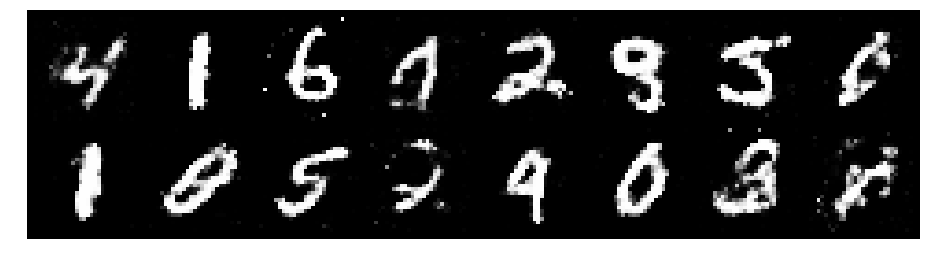

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.1807, Generator Loss: 1.1476
D(x): 0.6093, D(G(z)): 0.4262


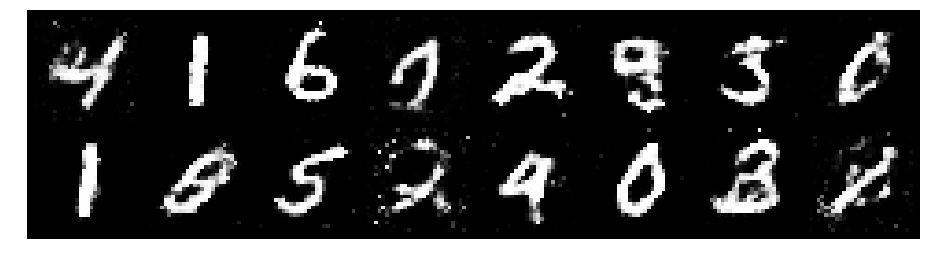

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.0332, Generator Loss: 1.1461
D(x): 0.6368, D(G(z)): 0.3750


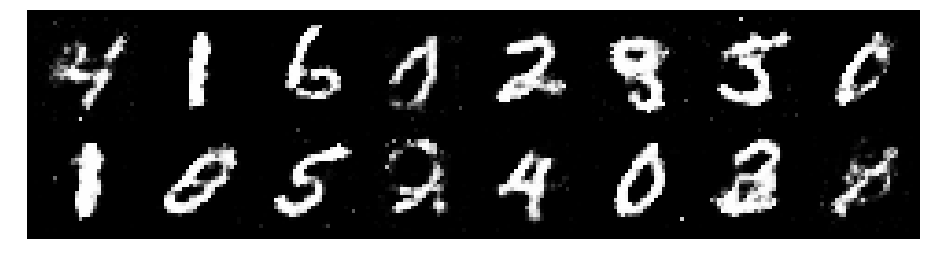

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2420, Generator Loss: 1.0587
D(x): 0.5480, D(G(z)): 0.4126


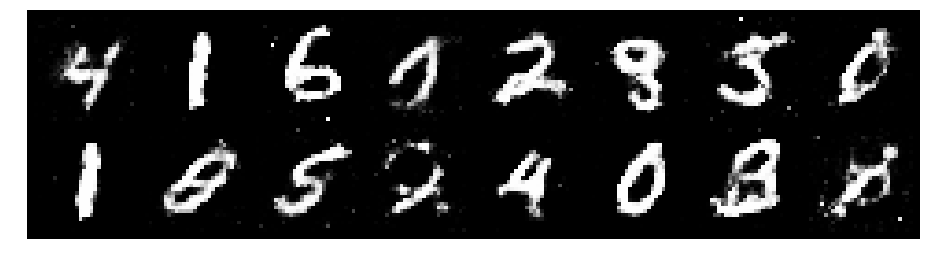

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.3175, Generator Loss: 0.8402
D(x): 0.5706, D(G(z)): 0.4909


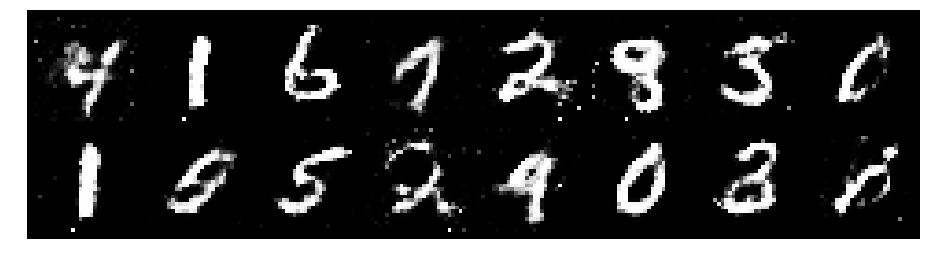

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2914, Generator Loss: 0.8669
D(x): 0.5294, D(G(z)): 0.4399


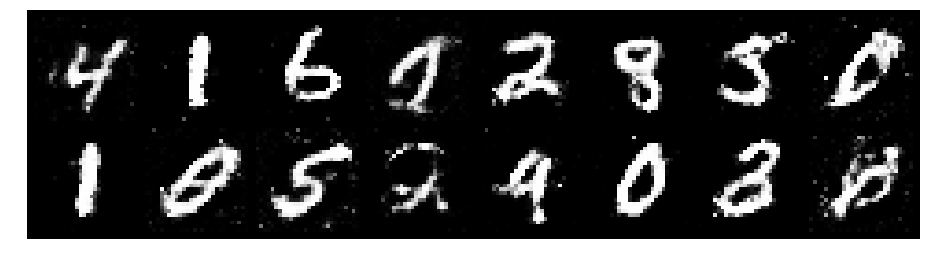

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2623, Generator Loss: 0.9351
D(x): 0.5482, D(G(z)): 0.4247


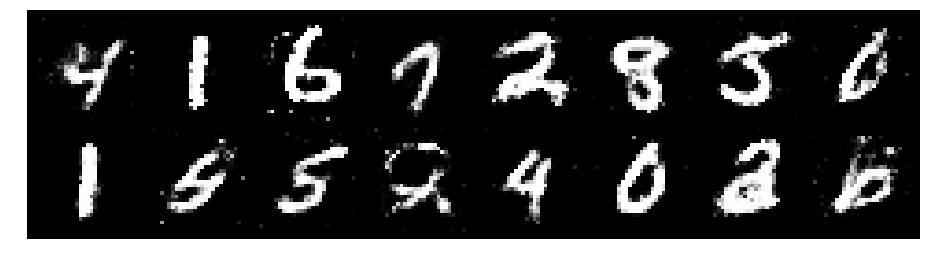

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2381, Generator Loss: 0.8471
D(x): 0.6243, D(G(z)): 0.4622


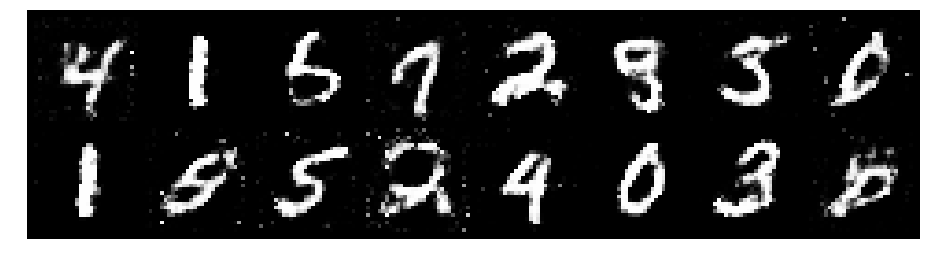

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.1639, Generator Loss: 1.0726
D(x): 0.5878, D(G(z)): 0.4123


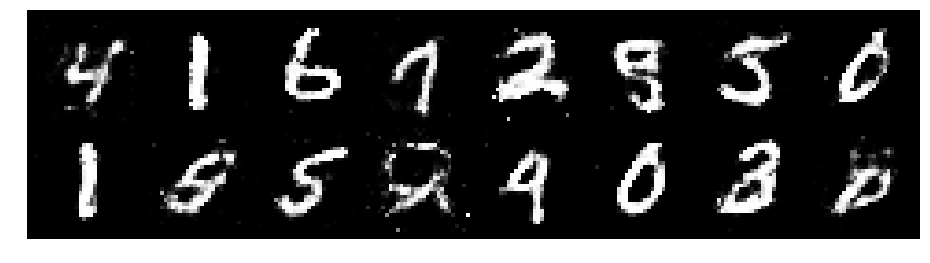

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1986, Generator Loss: 0.9710
D(x): 0.5251, D(G(z)): 0.3790


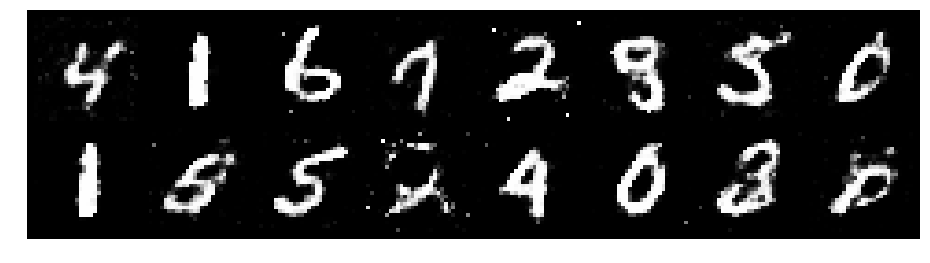

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2672, Generator Loss: 0.9486
D(x): 0.5685, D(G(z)): 0.4450


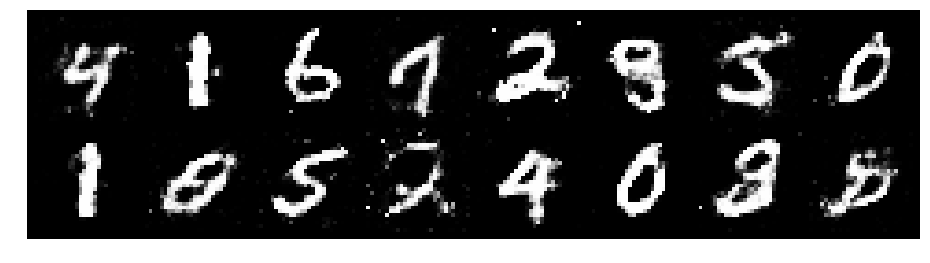

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.3877, Generator Loss: 0.8449
D(x): 0.5279, D(G(z)): 0.4866


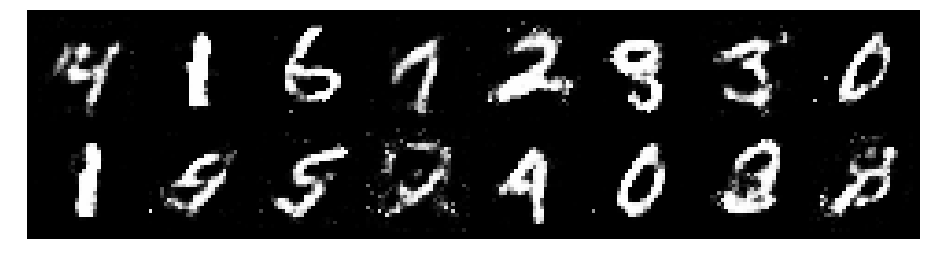

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2987, Generator Loss: 0.8165
D(x): 0.5669, D(G(z)): 0.4620


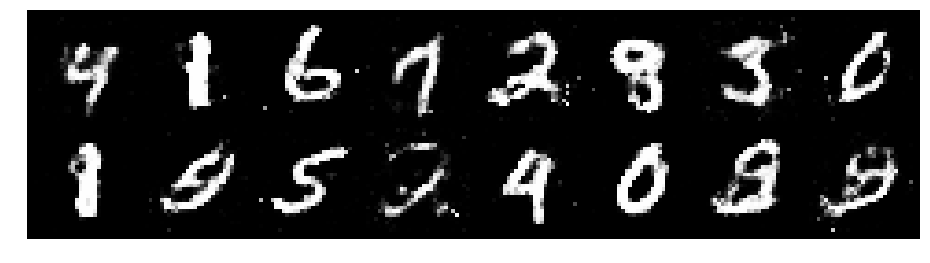

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.3766, Generator Loss: 0.7937
D(x): 0.5127, D(G(z)): 0.4417


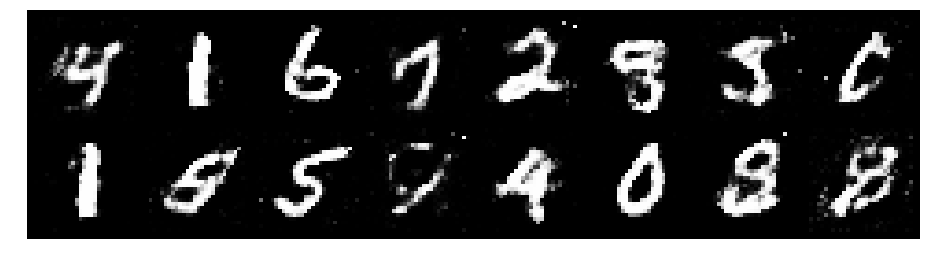

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.3570, Generator Loss: 0.9029
D(x): 0.5990, D(G(z)): 0.4734


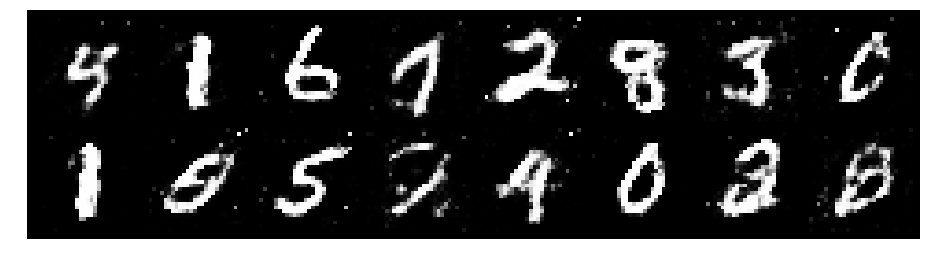

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2234, Generator Loss: 1.0049
D(x): 0.5991, D(G(z)): 0.4319


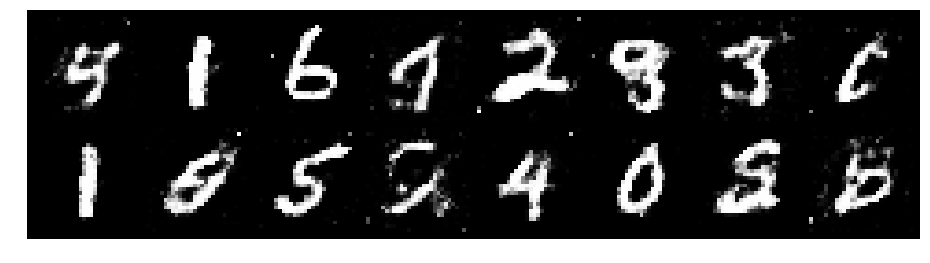

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.1785, Generator Loss: 0.9914
D(x): 0.5966, D(G(z)): 0.4180


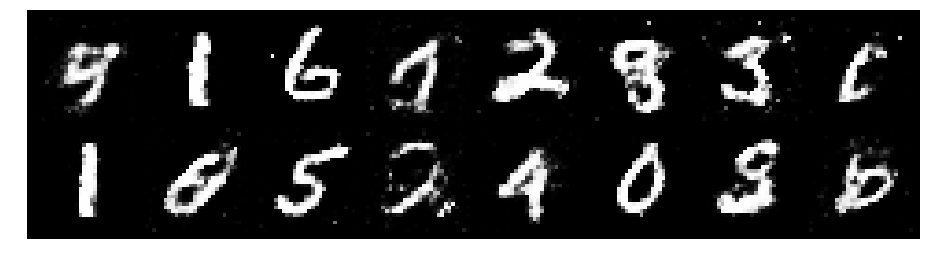

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2310, Generator Loss: 0.9881
D(x): 0.5590, D(G(z)): 0.4153


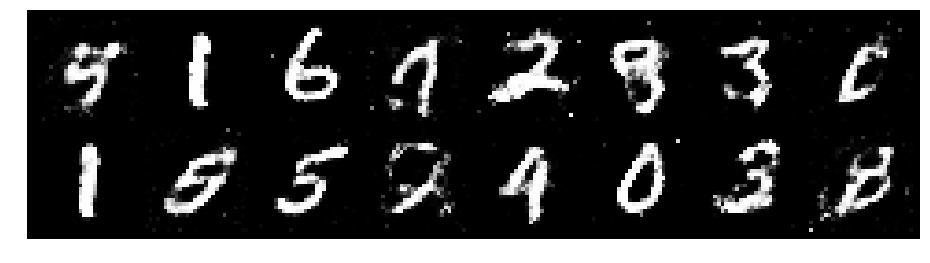

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2114, Generator Loss: 0.9741
D(x): 0.6063, D(G(z)): 0.4538


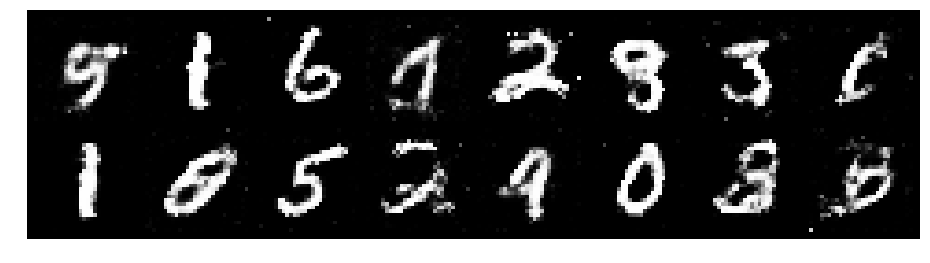

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.3473, Generator Loss: 0.9457
D(x): 0.4909, D(G(z)): 0.3977


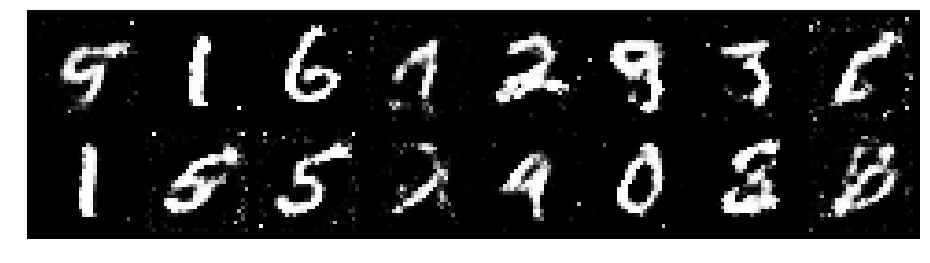

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2253, Generator Loss: 0.9335
D(x): 0.5981, D(G(z)): 0.4483


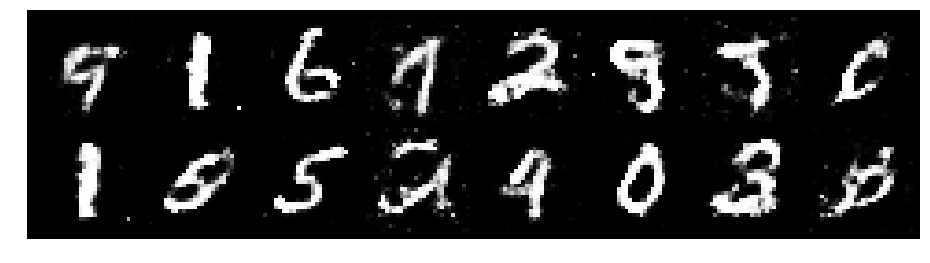

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2305, Generator Loss: 0.9322
D(x): 0.5820, D(G(z)): 0.4541


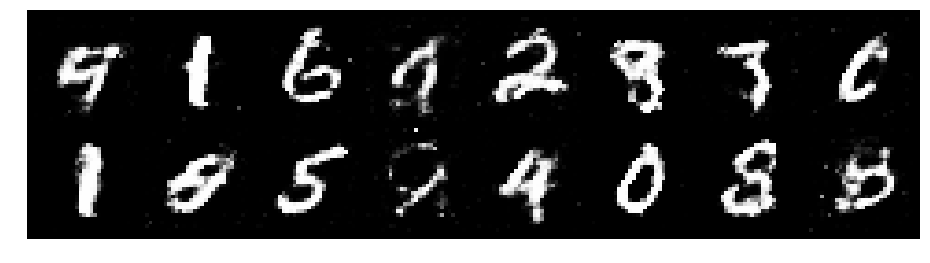

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.3243, Generator Loss: 0.8072
D(x): 0.5825, D(G(z)): 0.4823


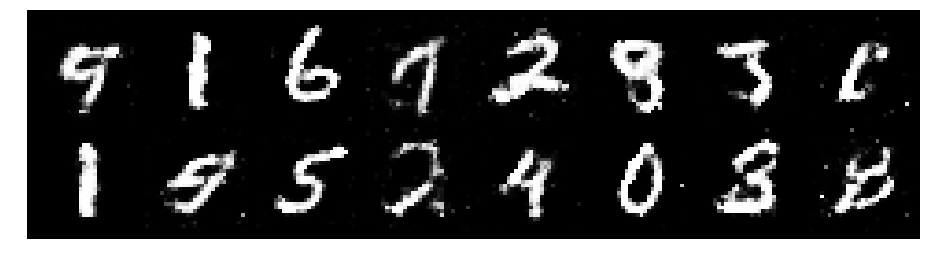

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.2841, Generator Loss: 0.9208
D(x): 0.5324, D(G(z)): 0.4463


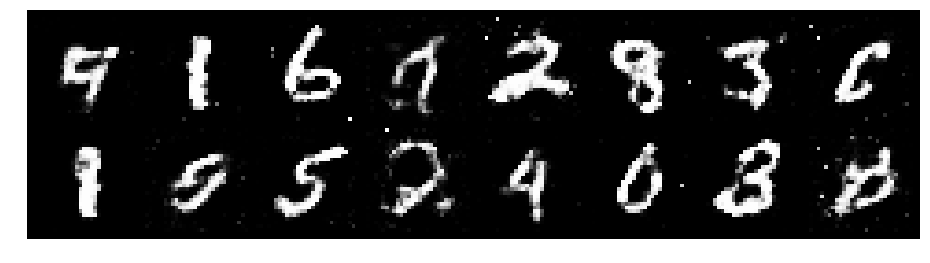

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.3629, Generator Loss: 0.9497
D(x): 0.5785, D(G(z)): 0.4596


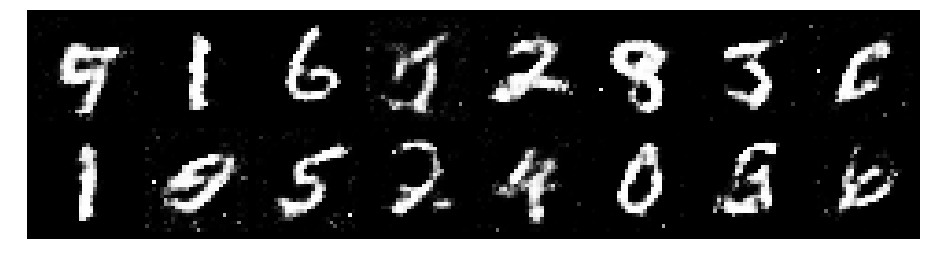

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.1957, Generator Loss: 0.9752
D(x): 0.5236, D(G(z)): 0.3764


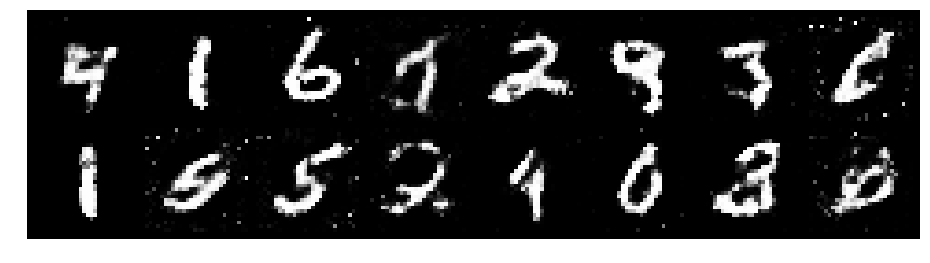

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.3259, Generator Loss: 0.9957
D(x): 0.4899, D(G(z)): 0.4110


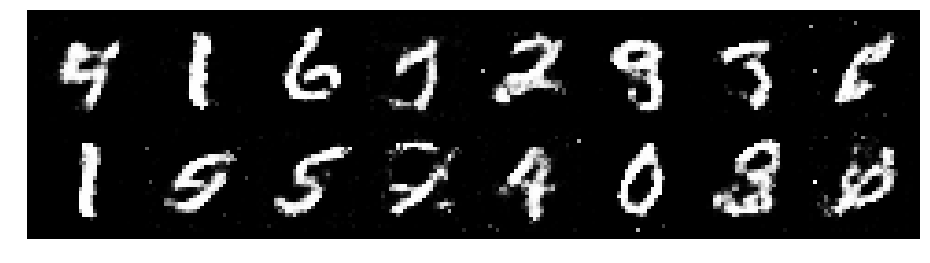

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.1741, Generator Loss: 1.0274
D(x): 0.5494, D(G(z)): 0.3654


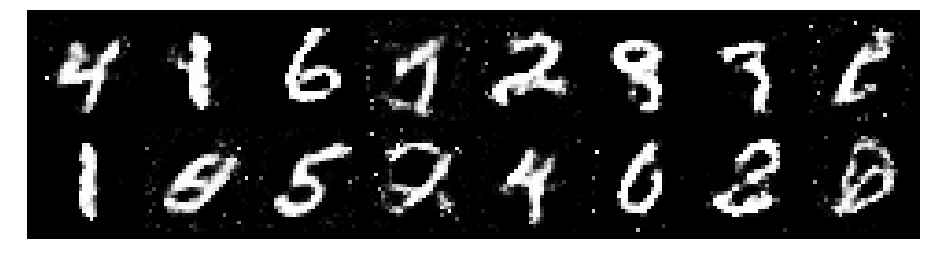

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.2735, Generator Loss: 0.8581
D(x): 0.5871, D(G(z)): 0.4616


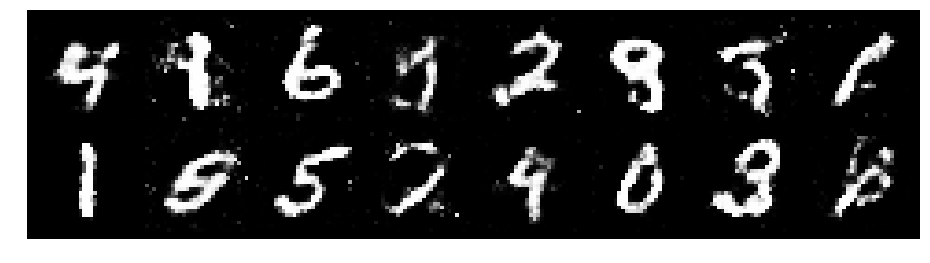

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.3573, Generator Loss: 0.9006
D(x): 0.5559, D(G(z)): 0.4664


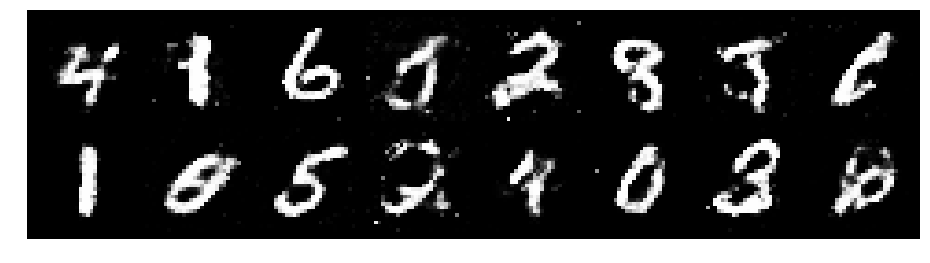

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.3686, Generator Loss: 0.8577
D(x): 0.5170, D(G(z)): 0.4625


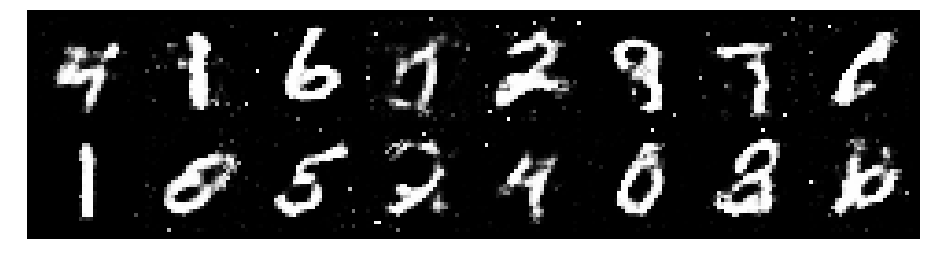

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2125, Generator Loss: 1.0498
D(x): 0.5622, D(G(z)): 0.4029


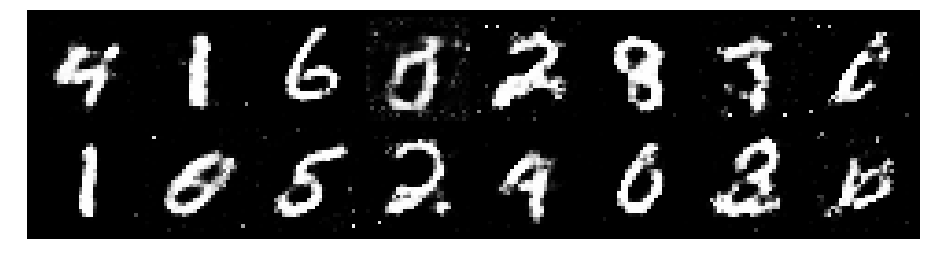

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9031
D(x): 0.5473, D(G(z)): 0.4315


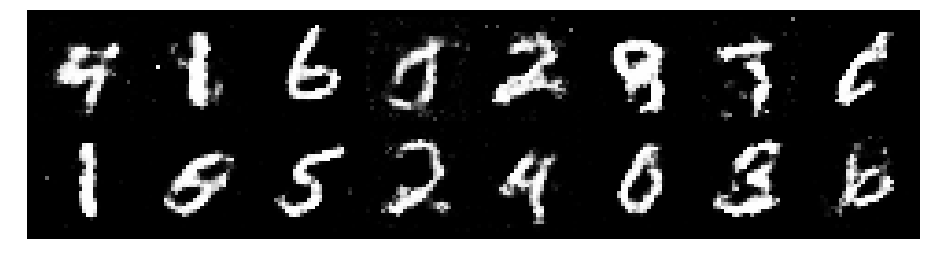

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.1915, Generator Loss: 0.8729
D(x): 0.5786, D(G(z)): 0.4081


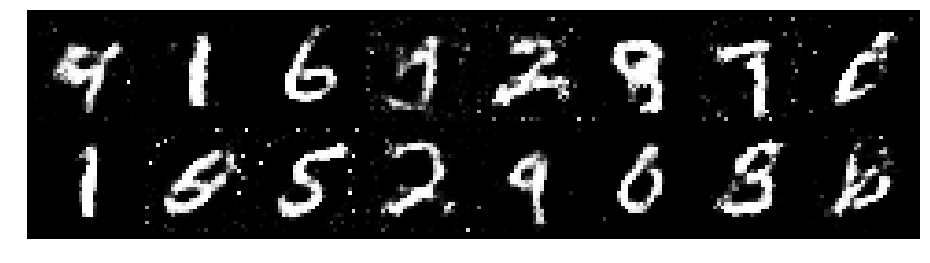

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.3172, Generator Loss: 0.9969
D(x): 0.5327, D(G(z)): 0.4137


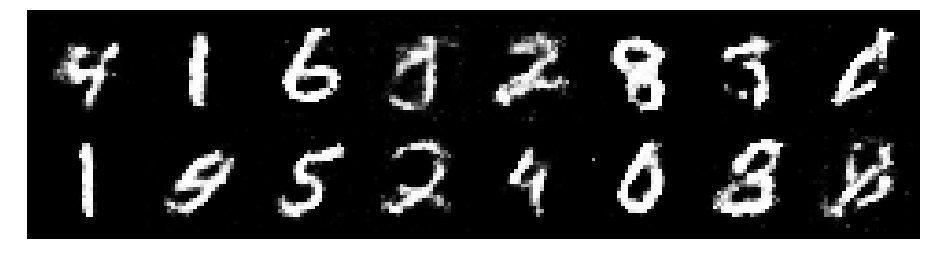

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2219, Generator Loss: 0.9525
D(x): 0.5755, D(G(z)): 0.4252


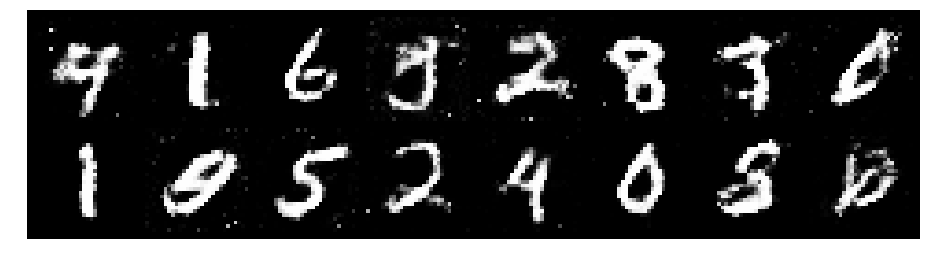

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.3579, Generator Loss: 1.0404
D(x): 0.5175, D(G(z)): 0.4104


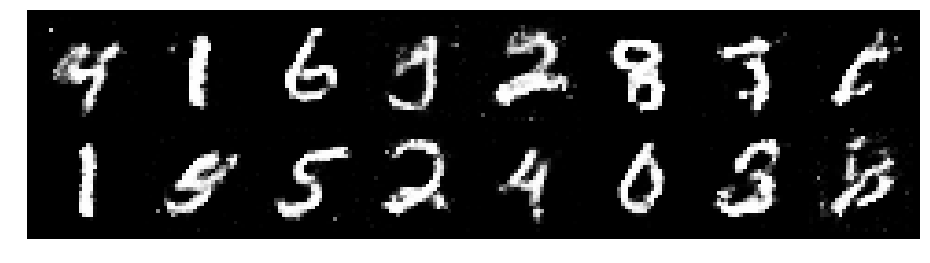

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.3015, Generator Loss: 1.2193
D(x): 0.5255, D(G(z)): 0.4211


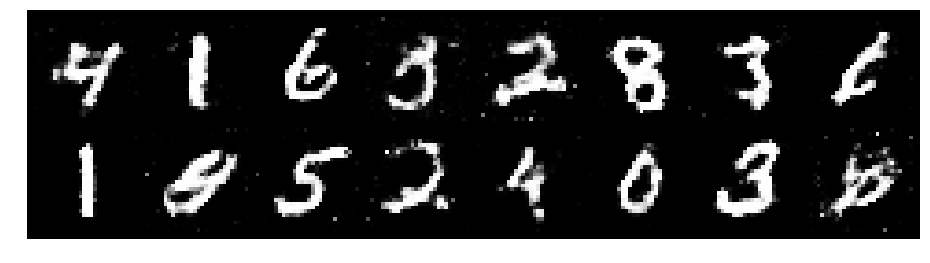

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.3303, Generator Loss: 1.0414
D(x): 0.5289, D(G(z)): 0.3967


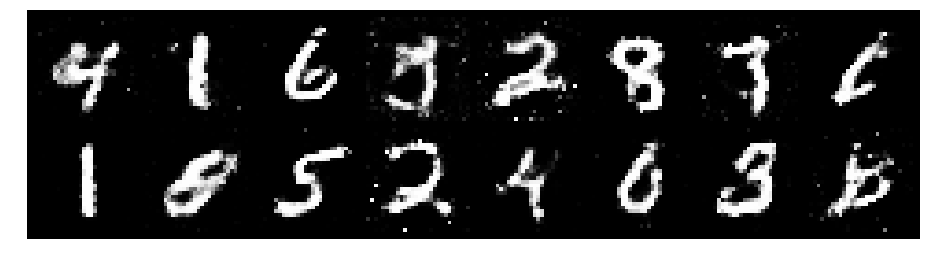

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2250, Generator Loss: 1.0164
D(x): 0.5602, D(G(z)): 0.4011


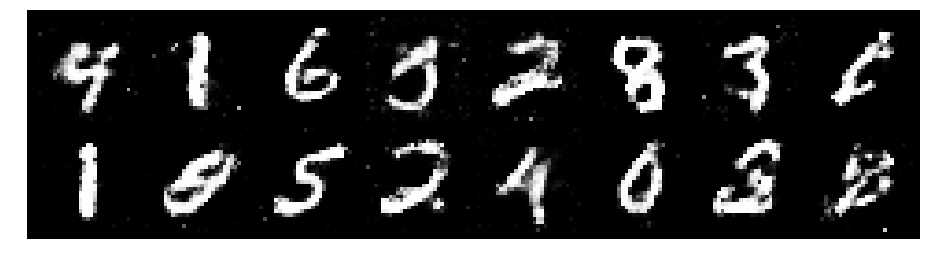

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.1455, Generator Loss: 0.9628
D(x): 0.6382, D(G(z)): 0.4566


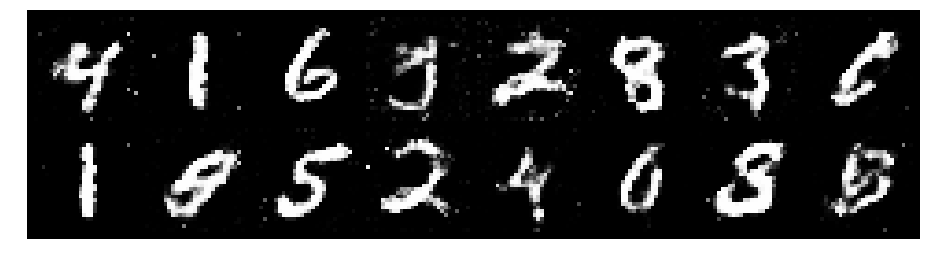

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.1969, Generator Loss: 1.0055
D(x): 0.5625, D(G(z)): 0.4058


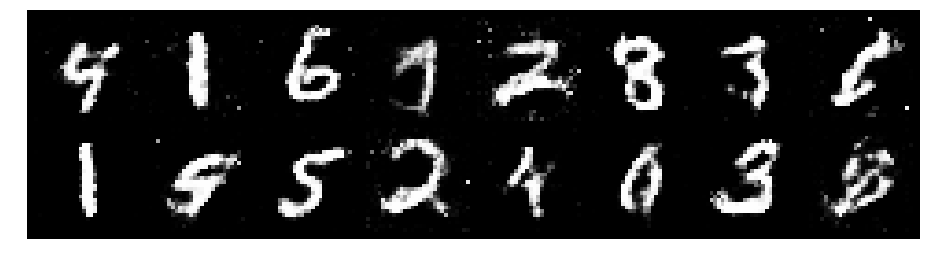

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2561, Generator Loss: 1.0542
D(x): 0.5577, D(G(z)): 0.4136


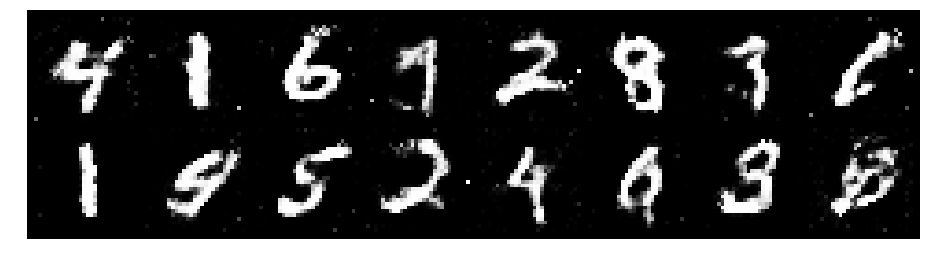

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.1924, Generator Loss: 1.0258
D(x): 0.5710, D(G(z)): 0.4092


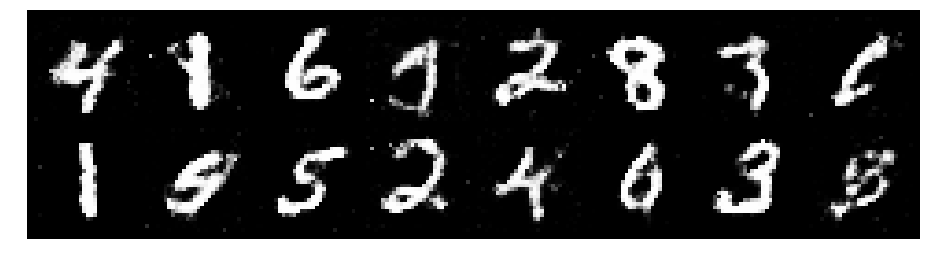

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.1531, Generator Loss: 1.0627
D(x): 0.5910, D(G(z)): 0.4004


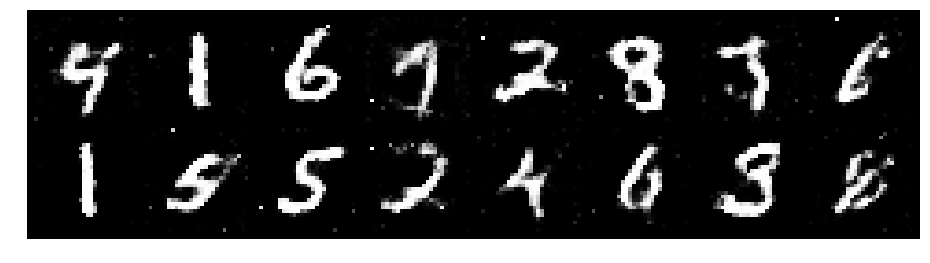

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2249, Generator Loss: 1.0171
D(x): 0.5744, D(G(z)): 0.4353


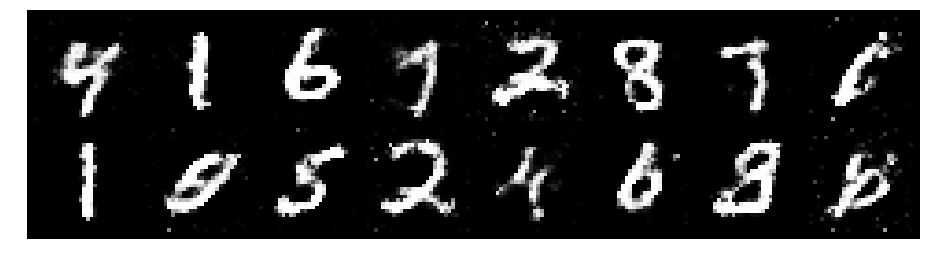

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.2801, Generator Loss: 0.9305
D(x): 0.5353, D(G(z)): 0.4332


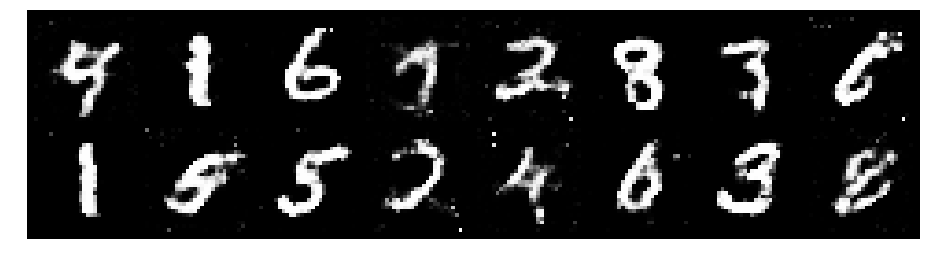

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2877, Generator Loss: 0.8042
D(x): 0.5801, D(G(z)): 0.4788


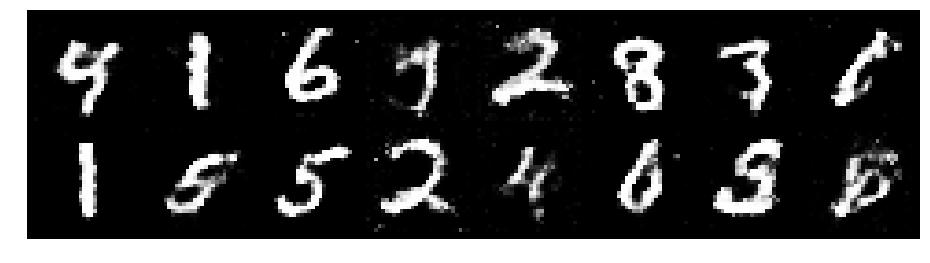

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.3075, Generator Loss: 0.8984
D(x): 0.5484, D(G(z)): 0.4637


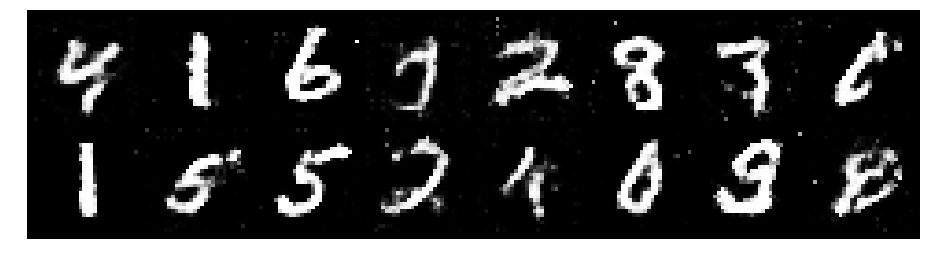

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.3118, Generator Loss: 0.8450
D(x): 0.6062, D(G(z)): 0.4968


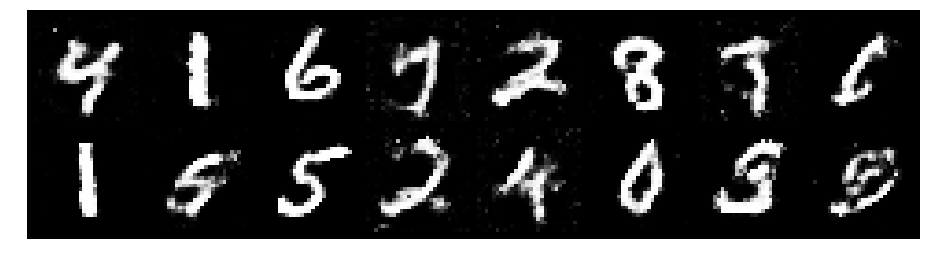

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2892, Generator Loss: 0.9351
D(x): 0.6175, D(G(z)): 0.4645


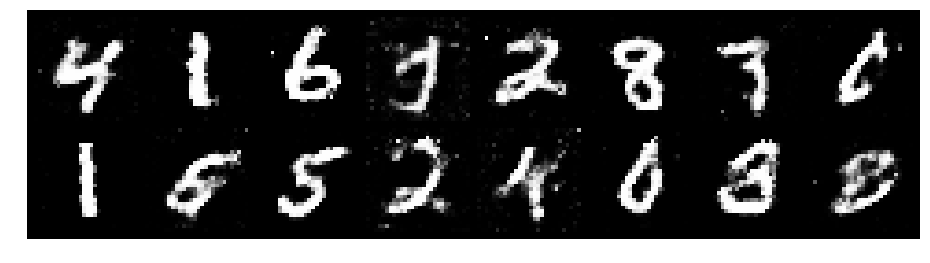

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1685, Generator Loss: 1.1071
D(x): 0.6342, D(G(z)): 0.4391


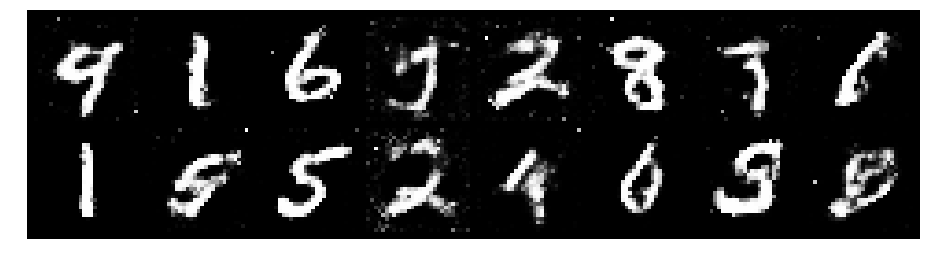

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2463, Generator Loss: 0.8918
D(x): 0.5764, D(G(z)): 0.4535


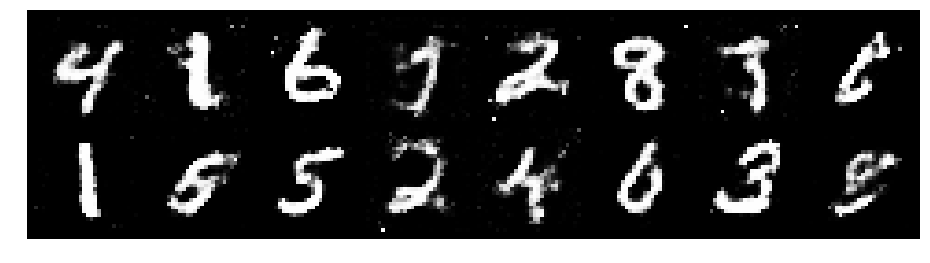

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2990, Generator Loss: 0.8763
D(x): 0.5458, D(G(z)): 0.4447


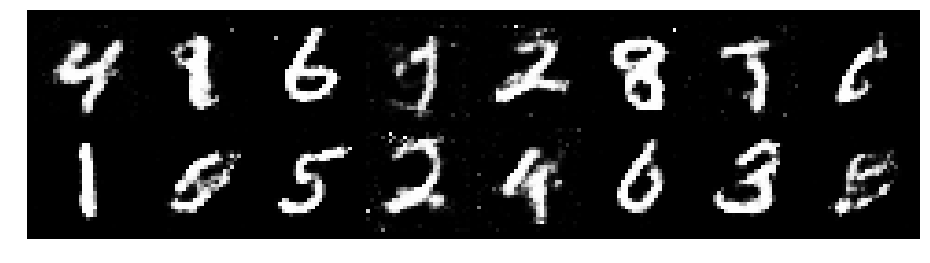

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.3377, Generator Loss: 0.8945
D(x): 0.5254, D(G(z)): 0.4334


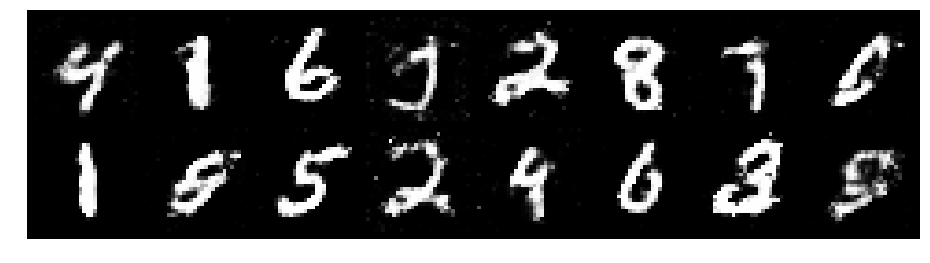

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2847, Generator Loss: 0.7307
D(x): 0.5526, D(G(z)): 0.4453


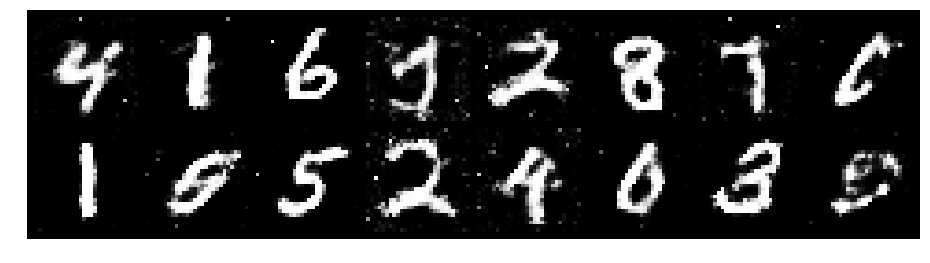

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2560, Generator Loss: 0.9526
D(x): 0.5549, D(G(z)): 0.4177


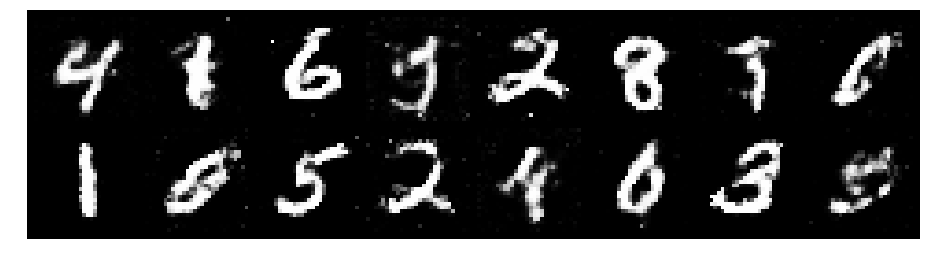

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.1992, Generator Loss: 1.2179
D(x): 0.6054, D(G(z)): 0.4049


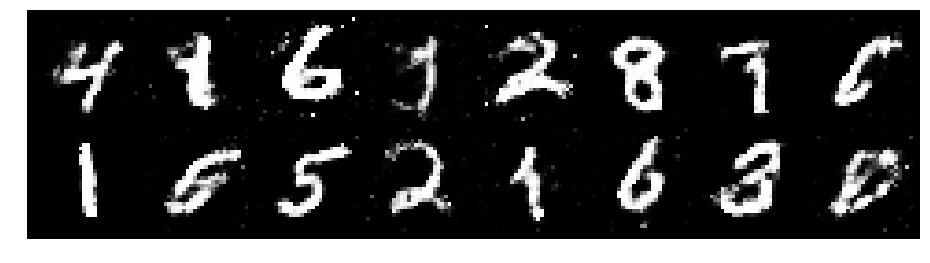

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.1497, Generator Loss: 1.0322
D(x): 0.5890, D(G(z)): 0.3939


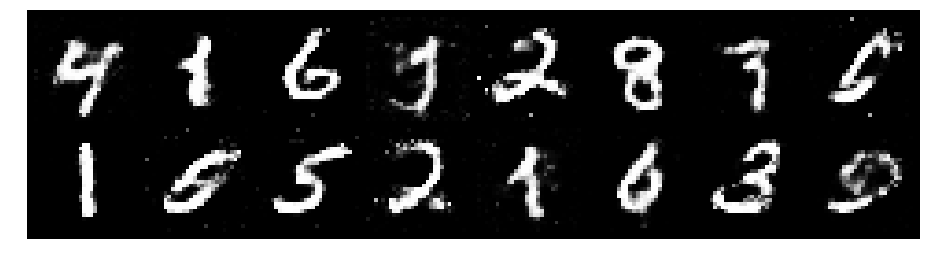

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2102, Generator Loss: 1.0228
D(x): 0.5812, D(G(z)): 0.4456


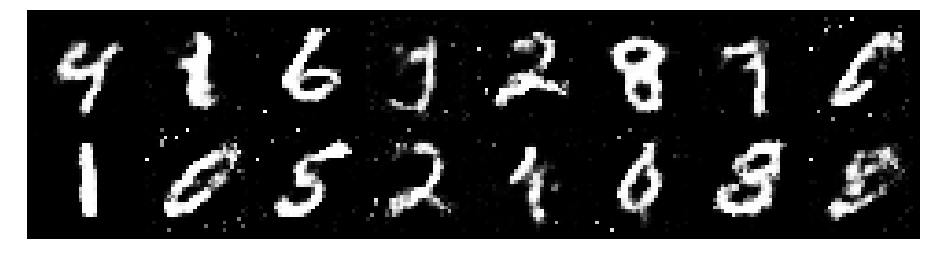

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2976, Generator Loss: 0.9353
D(x): 0.5376, D(G(z)): 0.4354


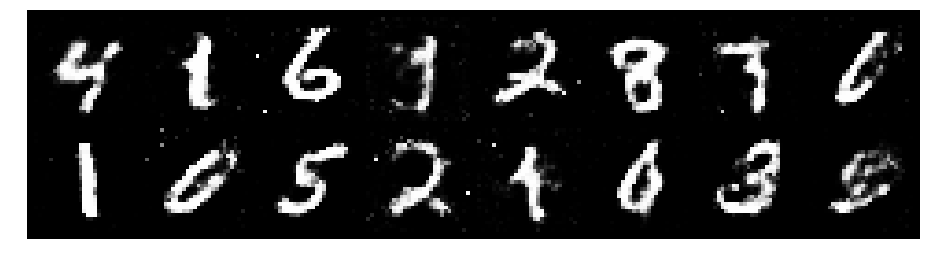

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.3322, Generator Loss: 0.9552
D(x): 0.5308, D(G(z)): 0.4381


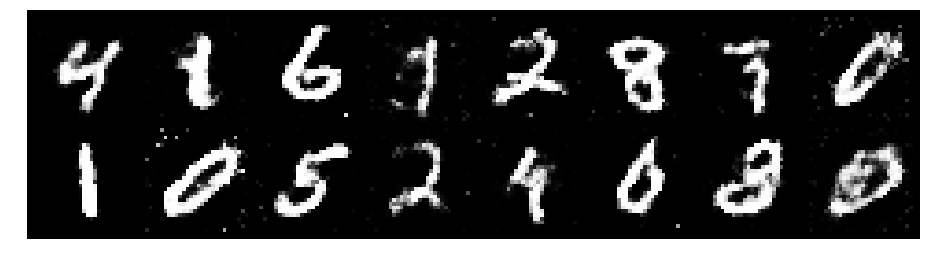

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.1970, Generator Loss: 1.0033
D(x): 0.5809, D(G(z)): 0.4232


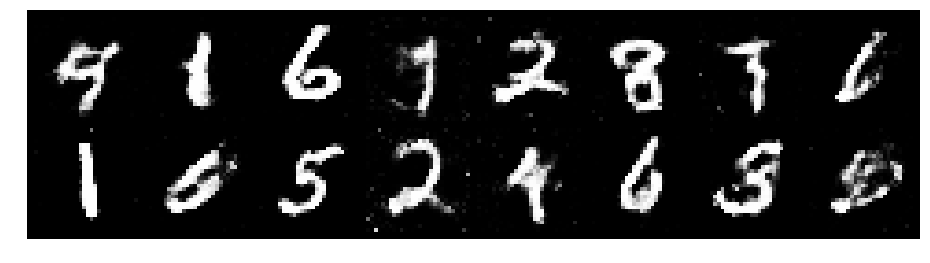

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2712, Generator Loss: 1.1031
D(x): 0.5572, D(G(z)): 0.4236


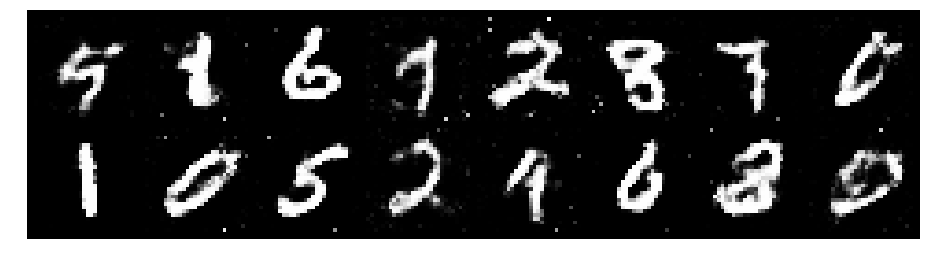

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.3847, Generator Loss: 0.8527
D(x): 0.5388, D(G(z)): 0.4869


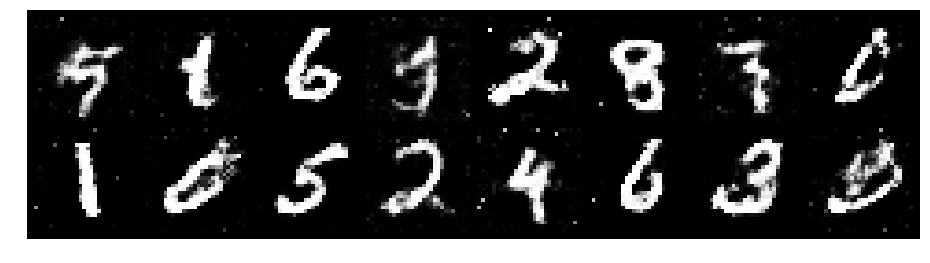

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.3021, Generator Loss: 0.9969
D(x): 0.5386, D(G(z)): 0.4398


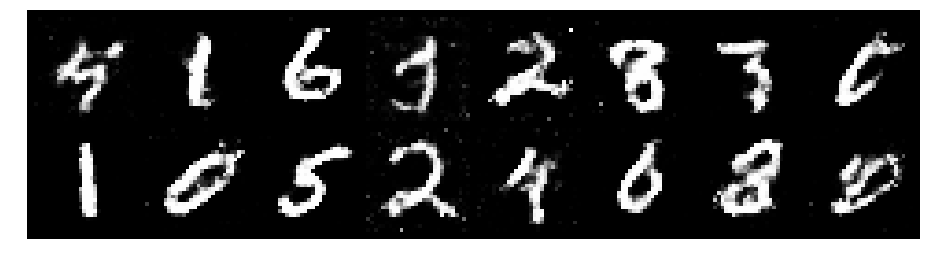

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.3890, Generator Loss: 0.9699
D(x): 0.4851, D(G(z)): 0.4261


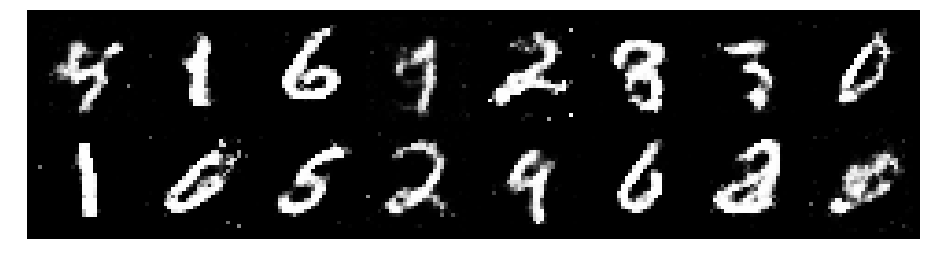

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.2362, Generator Loss: 0.8138
D(x): 0.5757, D(G(z)): 0.4619


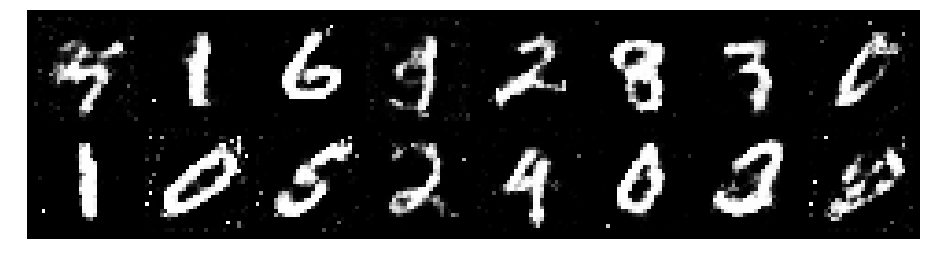

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.3468, Generator Loss: 0.9251
D(x): 0.5136, D(G(z)): 0.4570


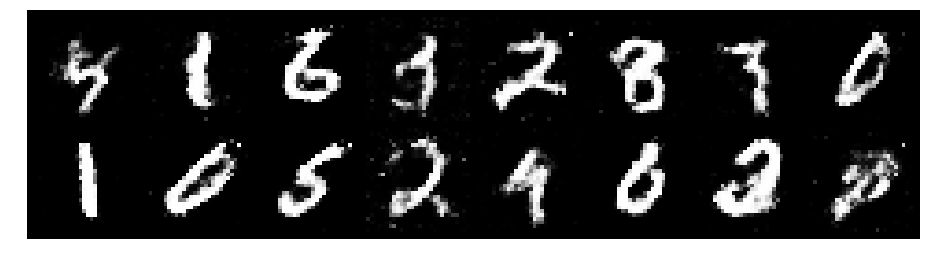

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.1703, Generator Loss: 1.1244
D(x): 0.5955, D(G(z)): 0.4320


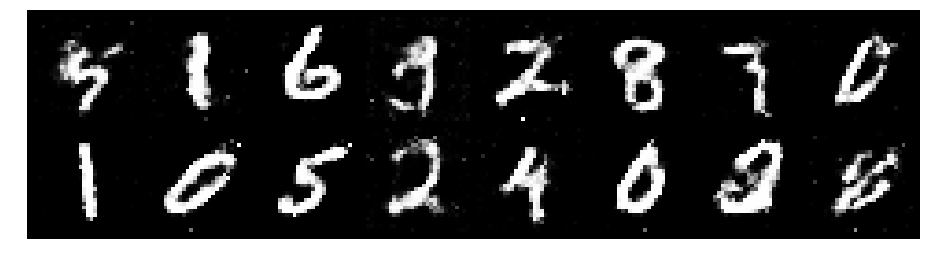

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.3646, Generator Loss: 0.9984
D(x): 0.5095, D(G(z)): 0.4437


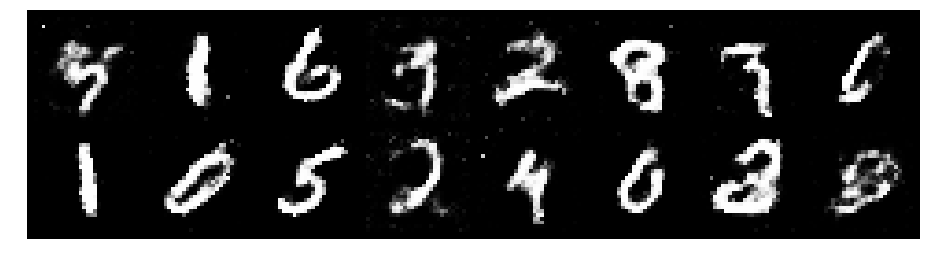

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.4260, Generator Loss: 0.8850
D(x): 0.5220, D(G(z)): 0.4732


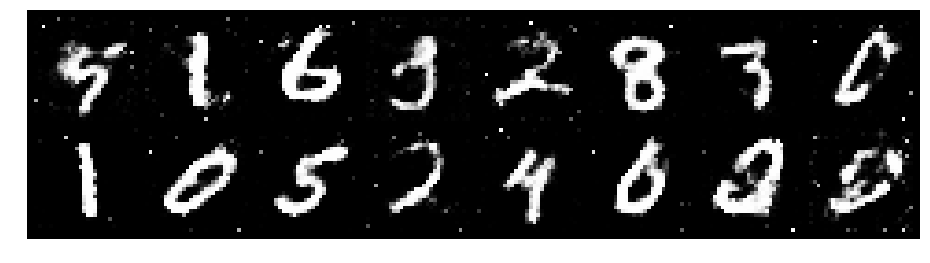

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2213, Generator Loss: 0.9543
D(x): 0.5455, D(G(z)): 0.4167


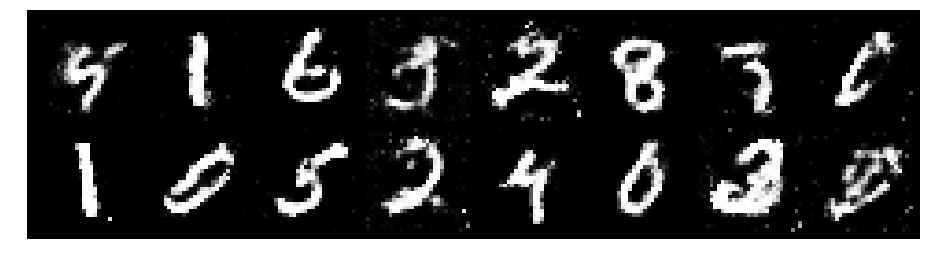

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1113, Generator Loss: 0.8736
D(x): 0.6385, D(G(z)): 0.4232


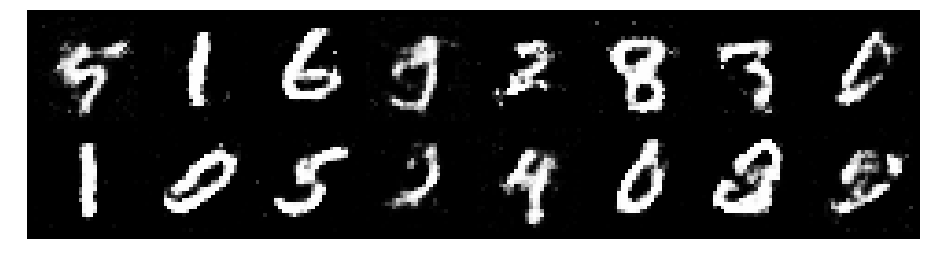

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.1555, Generator Loss: 0.8762
D(x): 0.6291, D(G(z)): 0.4552


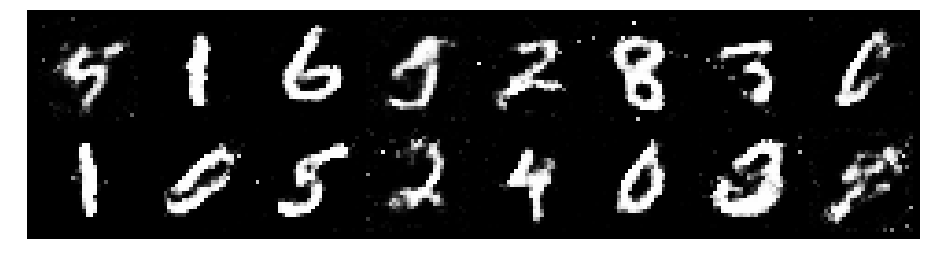

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.3855, Generator Loss: 0.8227
D(x): 0.5519, D(G(z)): 0.4888


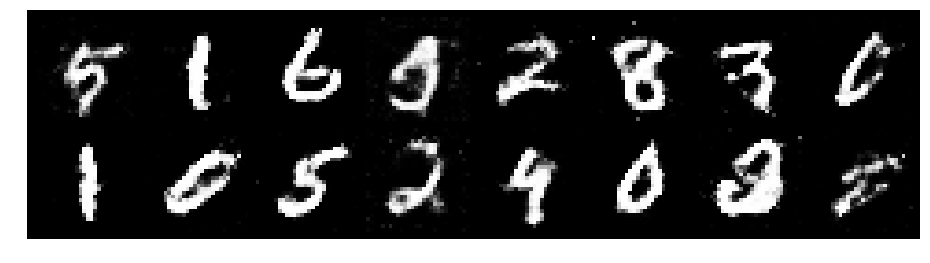

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2365, Generator Loss: 1.1225
D(x): 0.5742, D(G(z)): 0.4106


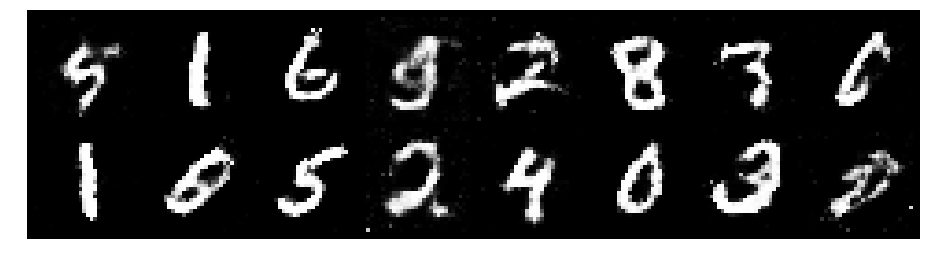

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2292, Generator Loss: 1.0413
D(x): 0.5824, D(G(z)): 0.4265


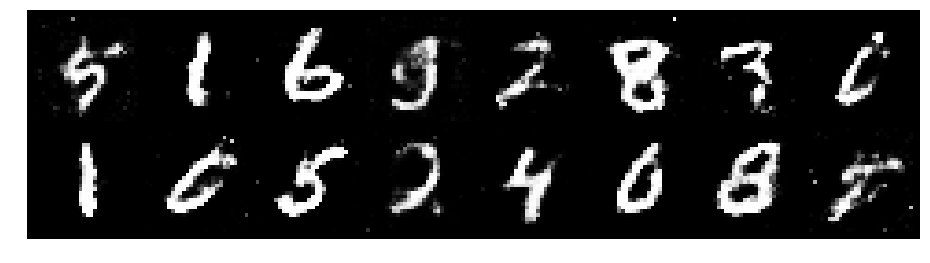

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.3024, Generator Loss: 0.8742
D(x): 0.5832, D(G(z)): 0.4736


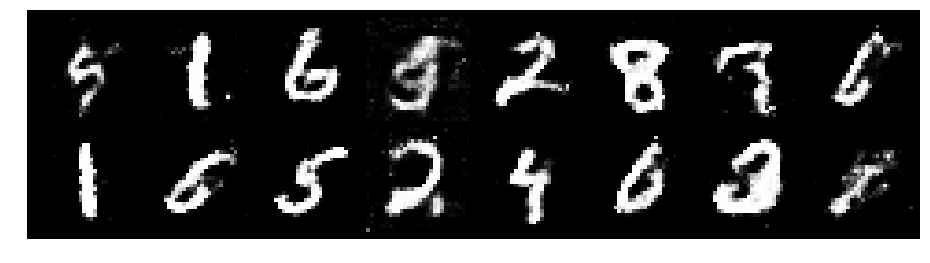

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.3512, Generator Loss: 0.7667
D(x): 0.5340, D(G(z)): 0.4705


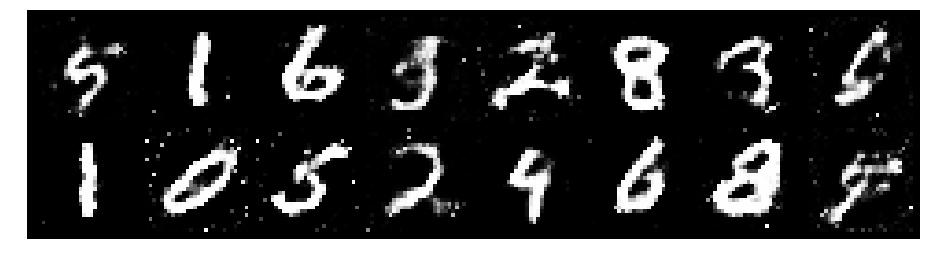

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.3141, Generator Loss: 0.8960
D(x): 0.5984, D(G(z)): 0.4750


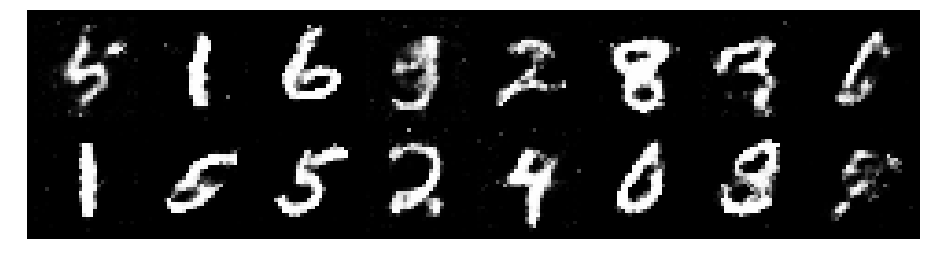

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2816, Generator Loss: 0.9242
D(x): 0.5386, D(G(z)): 0.4288


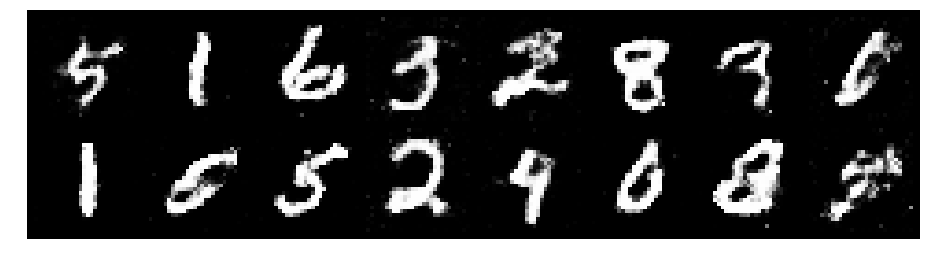

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.3212, Generator Loss: 1.0222
D(x): 0.5886, D(G(z)): 0.4788


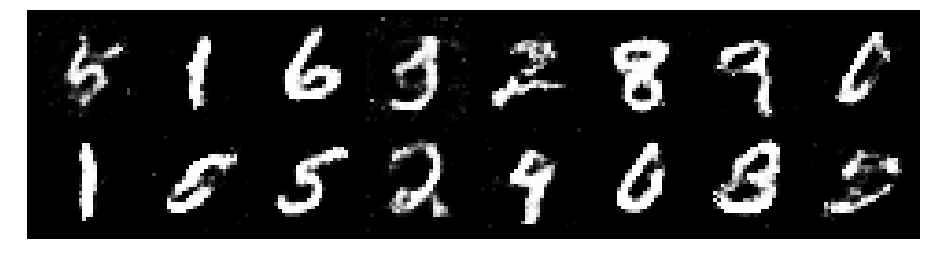

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.3084, Generator Loss: 0.9907
D(x): 0.6042, D(G(z)): 0.4704


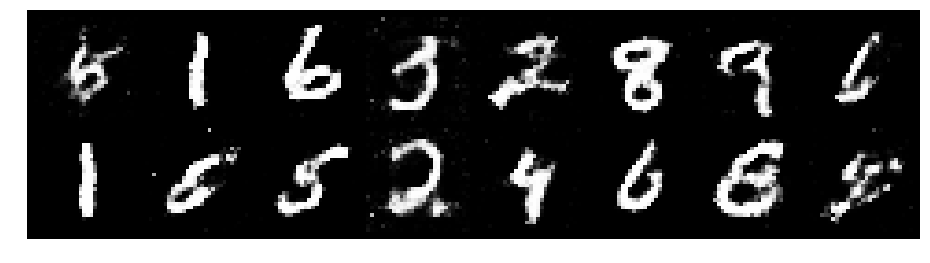

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2564, Generator Loss: 0.9319
D(x): 0.5662, D(G(z)): 0.4459


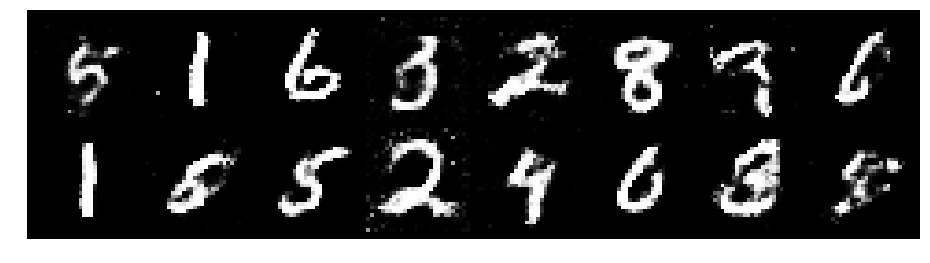

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2265, Generator Loss: 0.8400
D(x): 0.5963, D(G(z)): 0.4560


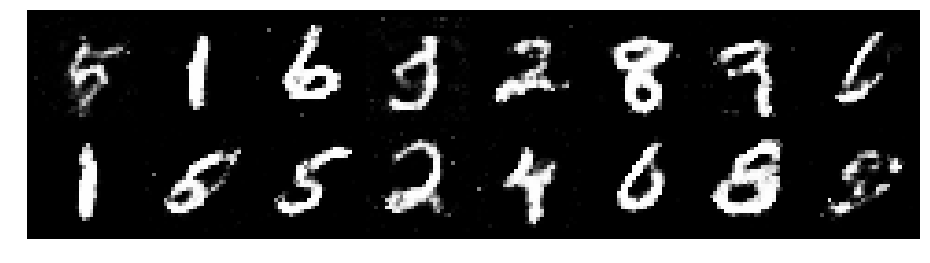

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2691, Generator Loss: 0.8828
D(x): 0.5315, D(G(z)): 0.4200


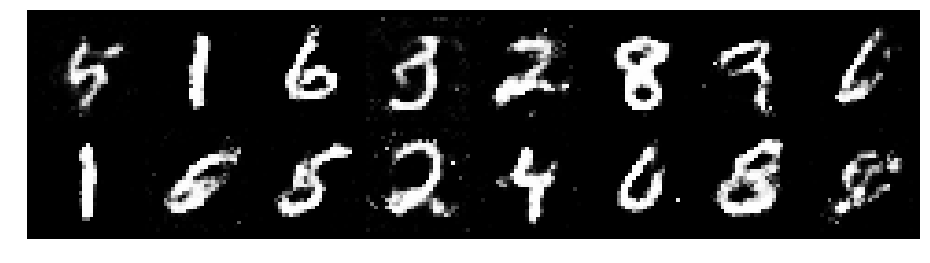

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2943, Generator Loss: 0.8744
D(x): 0.5891, D(G(z)): 0.4660


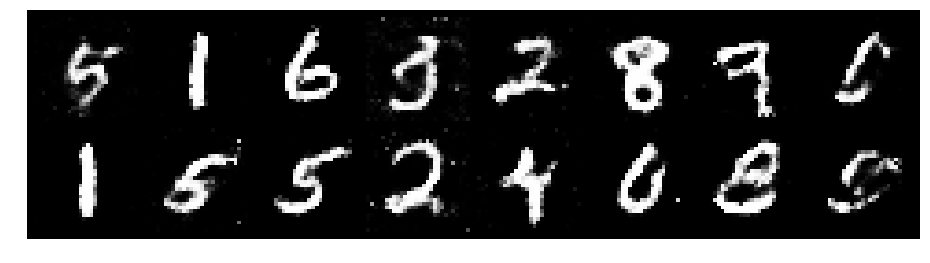

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.1955, Generator Loss: 0.7575
D(x): 0.6344, D(G(z)): 0.4800


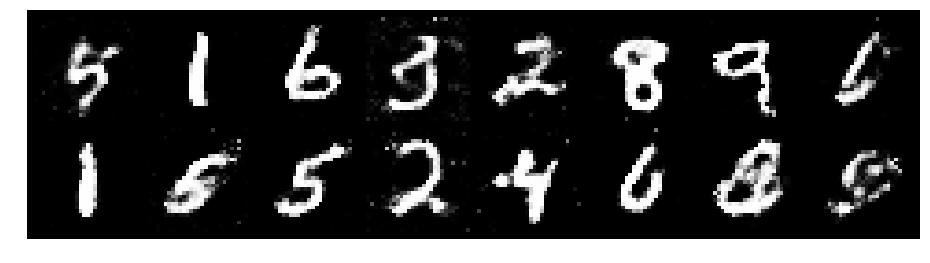

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.1660, Generator Loss: 1.0095
D(x): 0.5714, D(G(z)): 0.4146


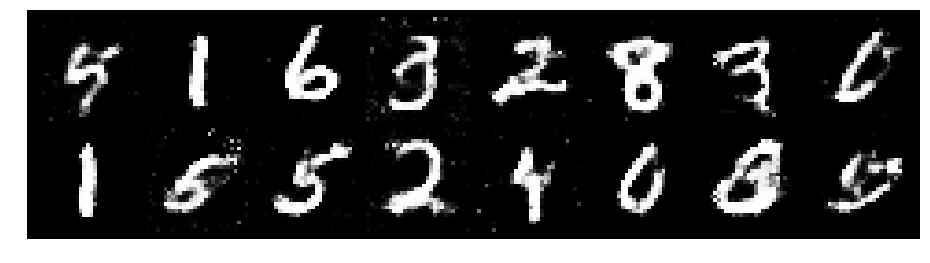

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.1744, Generator Loss: 0.8767
D(x): 0.5787, D(G(z)): 0.4295


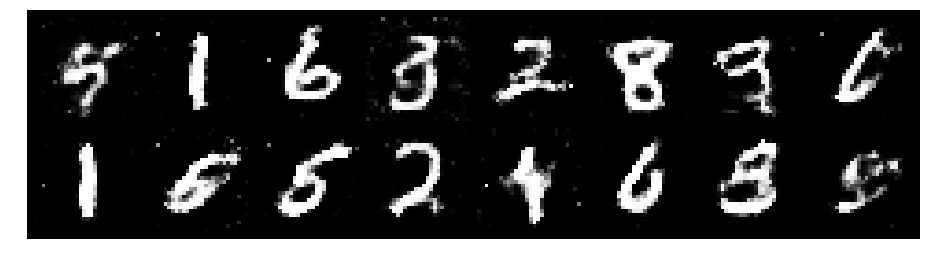

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2489, Generator Loss: 0.8465
D(x): 0.5909, D(G(z)): 0.4704


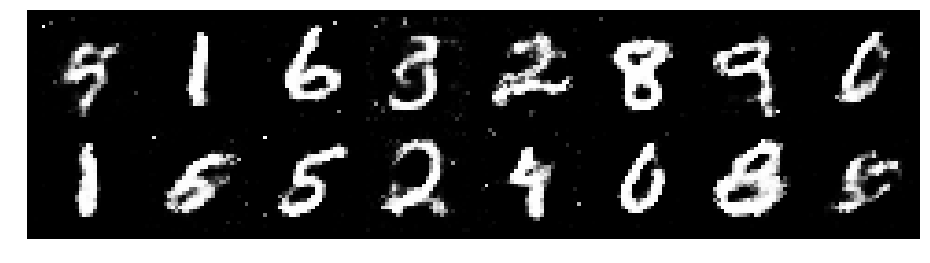

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9094
D(x): 0.5989, D(G(z)): 0.4755


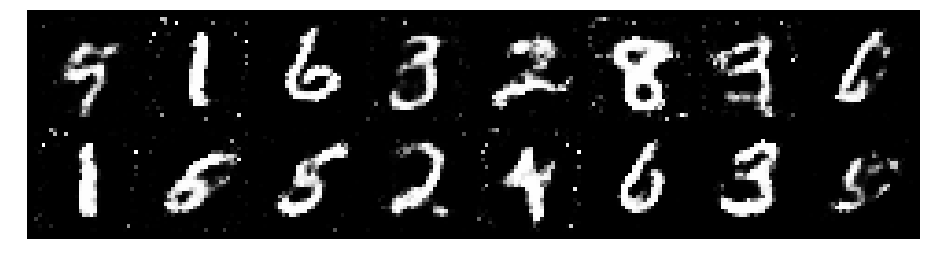

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.3245, Generator Loss: 1.0404
D(x): 0.5032, D(G(z)): 0.3988


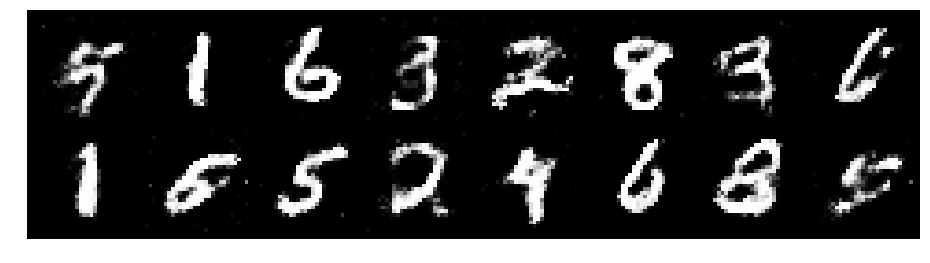

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2246, Generator Loss: 0.9791
D(x): 0.5416, D(G(z)): 0.4189


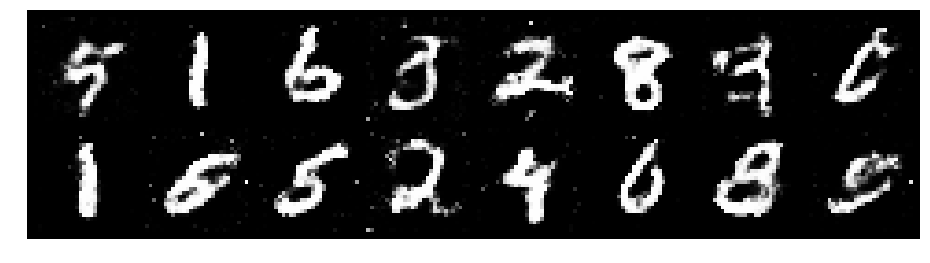

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3045, Generator Loss: 0.9116
D(x): 0.5321, D(G(z)): 0.4434


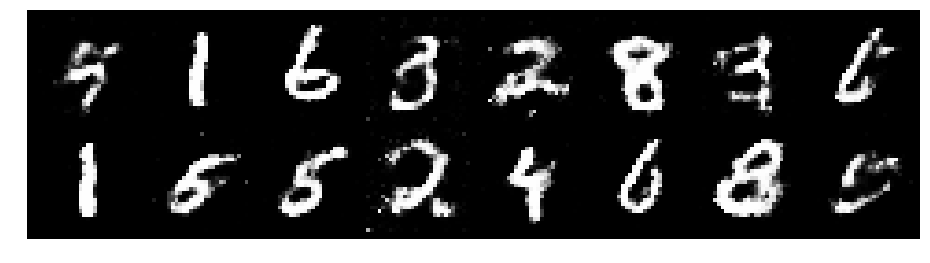

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2900, Generator Loss: 0.8419
D(x): 0.5516, D(G(z)): 0.4526


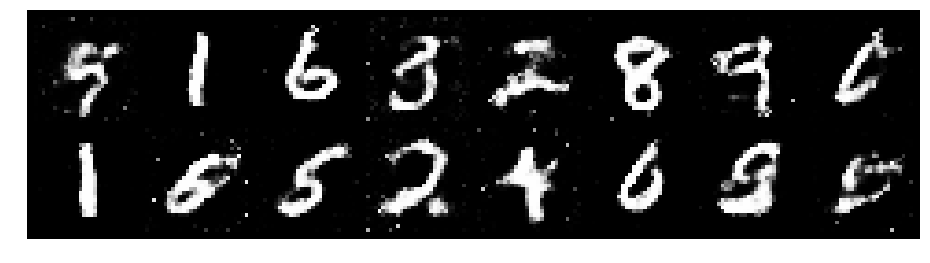

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.2782, Generator Loss: 0.8539
D(x): 0.5868, D(G(z)): 0.4535


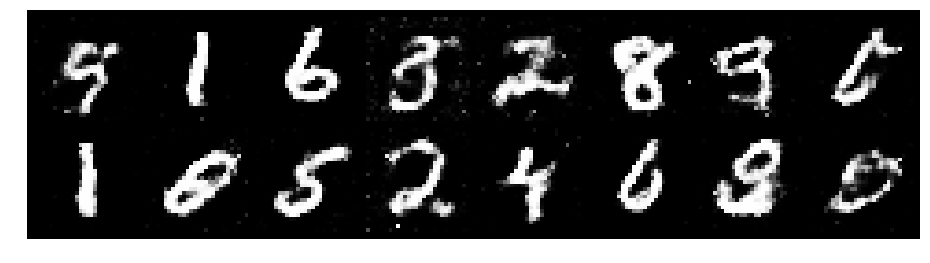

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.1772, Generator Loss: 1.0496
D(x): 0.5894, D(G(z)): 0.4152


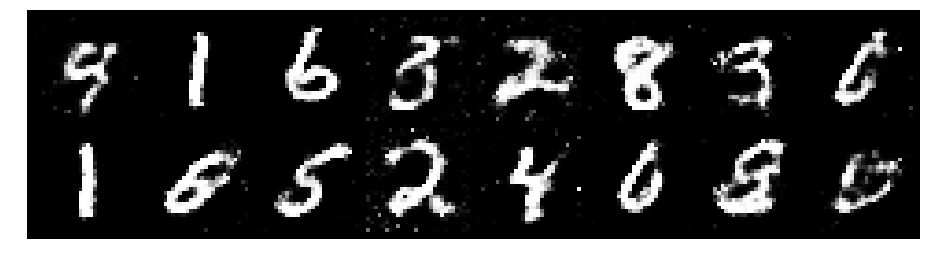

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.1584, Generator Loss: 0.9062
D(x): 0.5698, D(G(z)): 0.3924


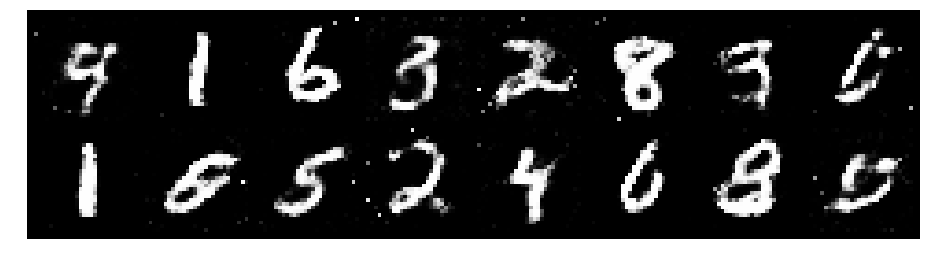

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.1999, Generator Loss: 0.9537
D(x): 0.5713, D(G(z)): 0.4231


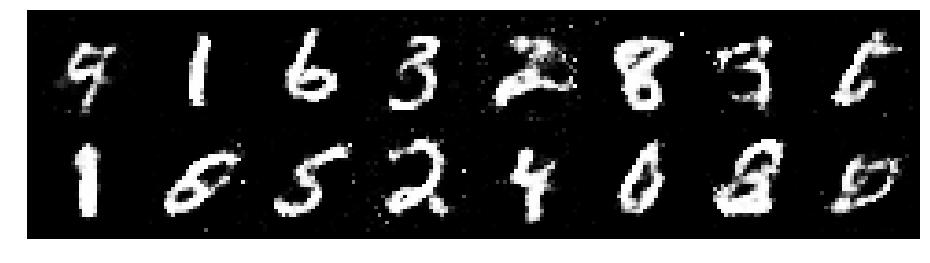

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.1105, Generator Loss: 1.0736
D(x): 0.5671, D(G(z)): 0.3794


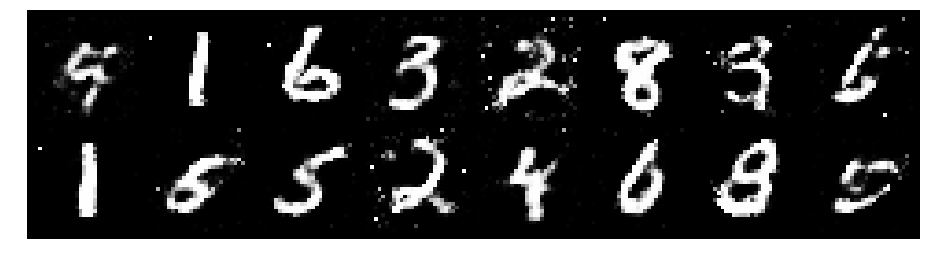

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8554
D(x): 0.5559, D(G(z)): 0.4407


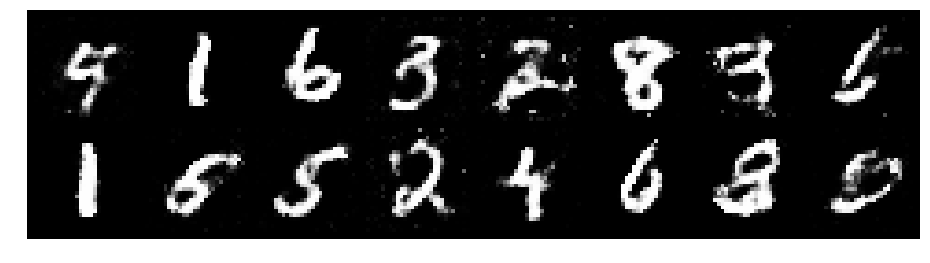

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3099, Generator Loss: 0.7435
D(x): 0.5626, D(G(z)): 0.4867


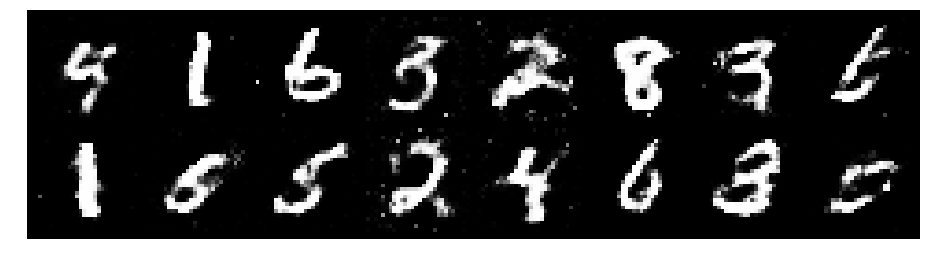

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.4170, Generator Loss: 0.8620
D(x): 0.5206, D(G(z)): 0.4728


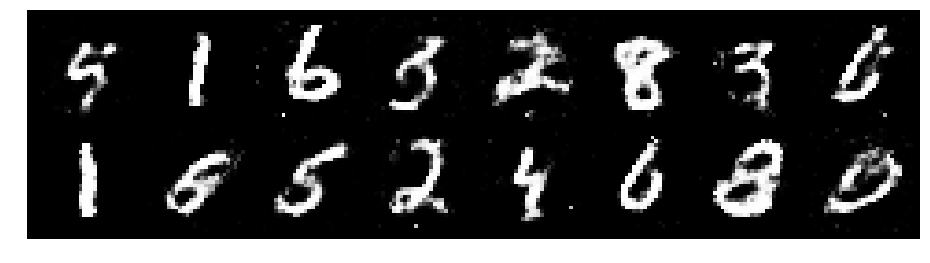

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.3203, Generator Loss: 1.0680
D(x): 0.5503, D(G(z)): 0.4110


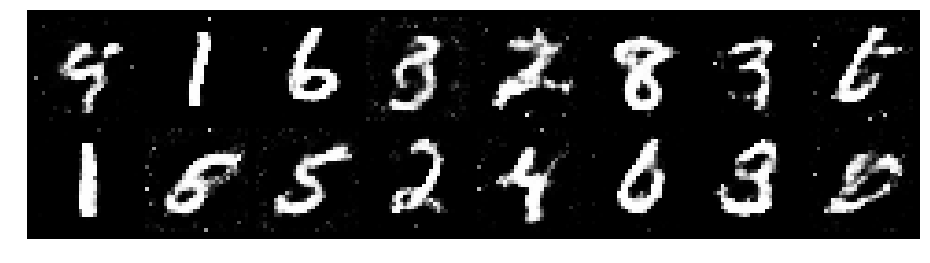

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2021, Generator Loss: 0.8841
D(x): 0.6091, D(G(z)): 0.4238


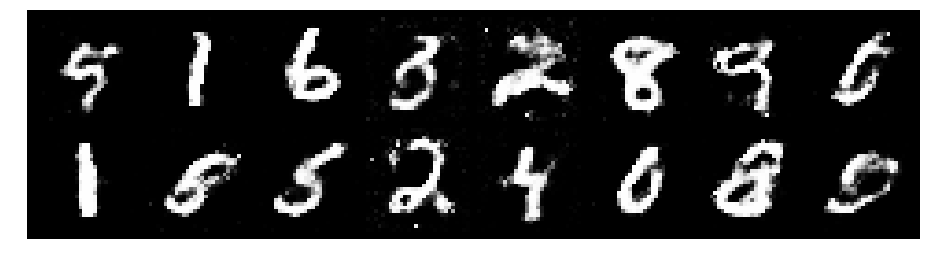

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2267, Generator Loss: 0.9275
D(x): 0.5716, D(G(z)): 0.4414


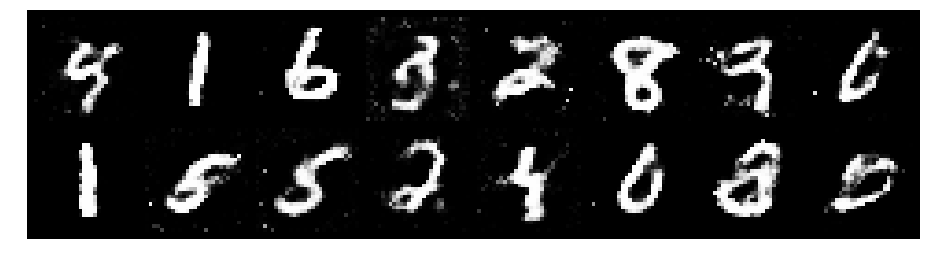

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2447, Generator Loss: 0.9500
D(x): 0.5778, D(G(z)): 0.4490


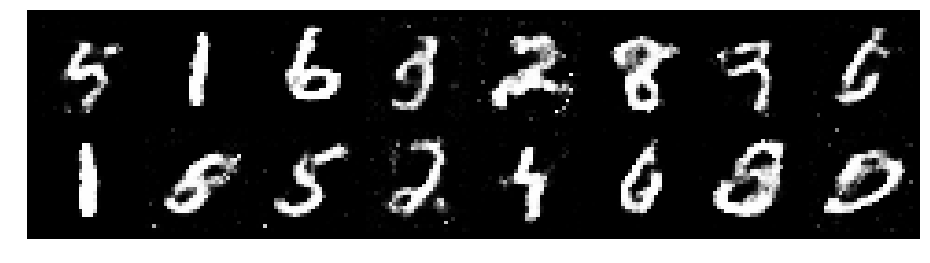

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2149, Generator Loss: 0.8639
D(x): 0.5780, D(G(z)): 0.4237


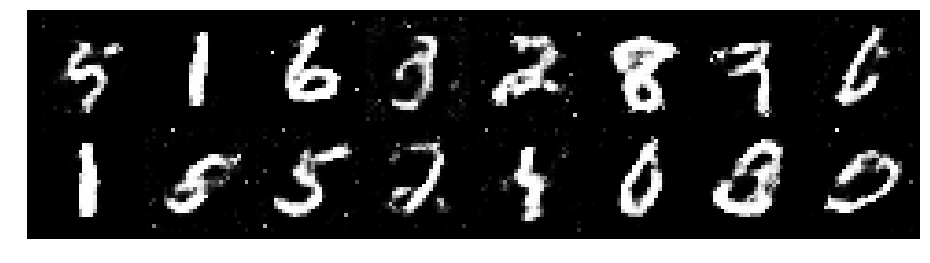

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2651, Generator Loss: 0.8615
D(x): 0.5337, D(G(z)): 0.4133


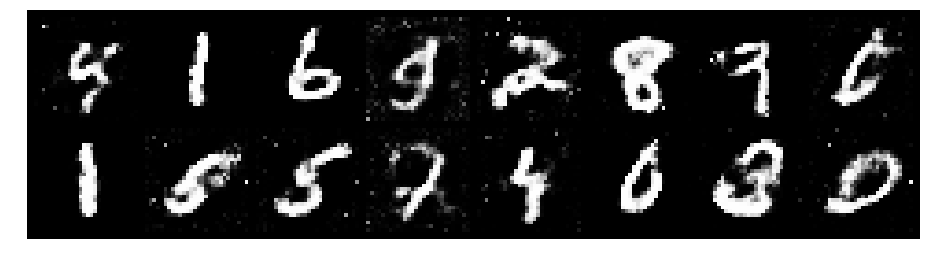

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2938, Generator Loss: 1.0833
D(x): 0.5579, D(G(z)): 0.4156


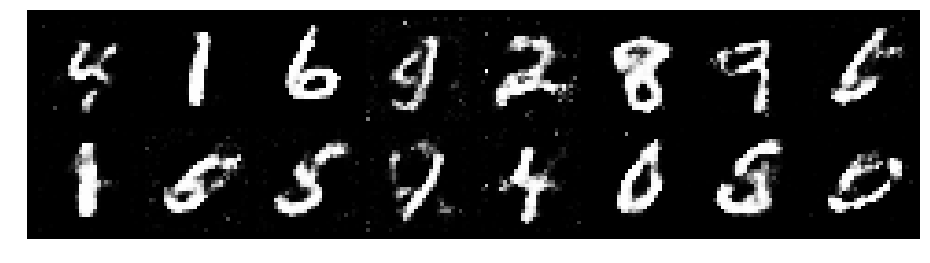

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2429, Generator Loss: 0.8940
D(x): 0.6321, D(G(z)): 0.4743


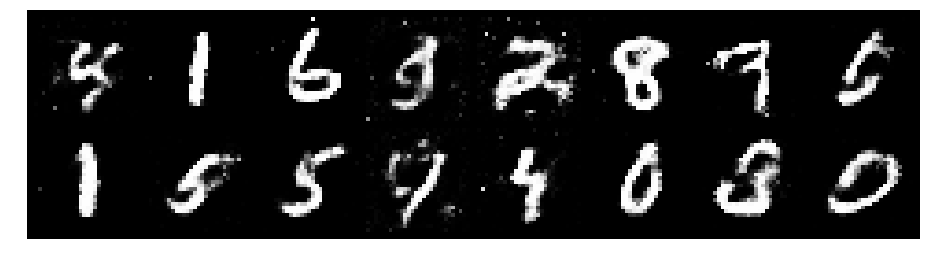

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2489, Generator Loss: 0.9440
D(x): 0.5615, D(G(z)): 0.4532


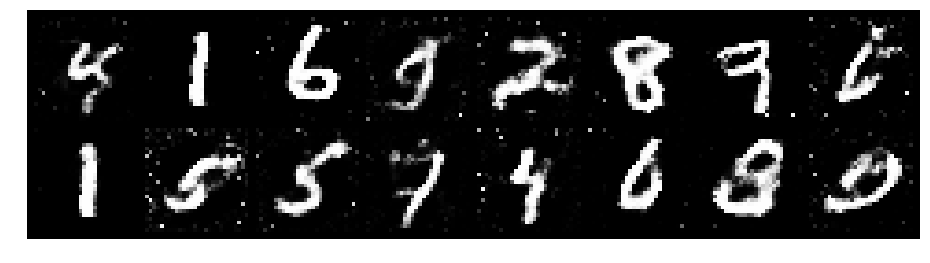

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.3117, Generator Loss: 0.8892
D(x): 0.5567, D(G(z)): 0.4552


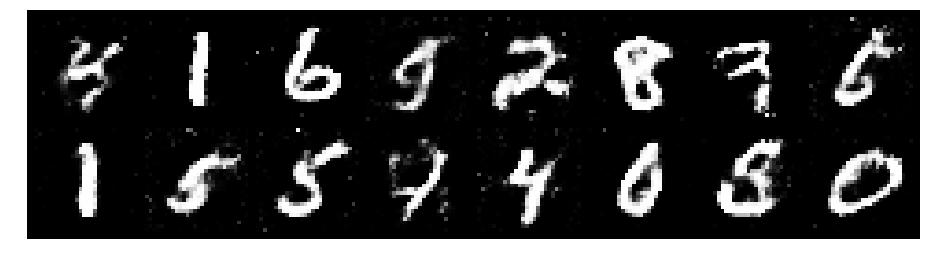

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2636, Generator Loss: 0.8404
D(x): 0.5594, D(G(z)): 0.4464


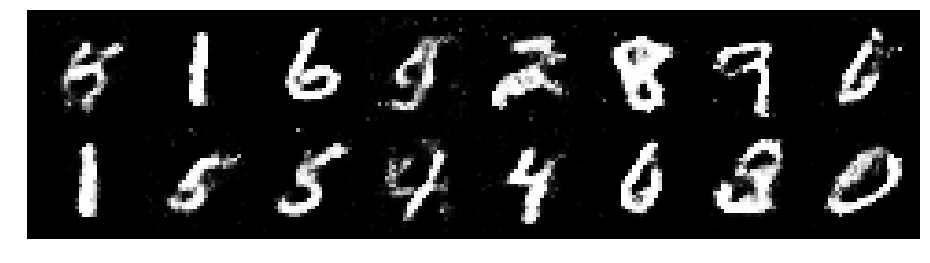

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2992, Generator Loss: 0.7945
D(x): 0.5914, D(G(z)): 0.4903


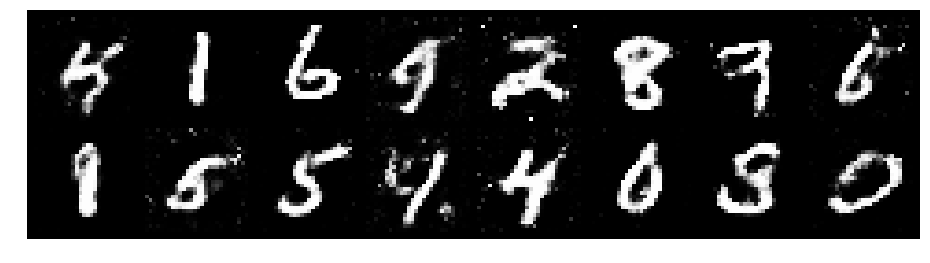

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2827, Generator Loss: 0.8961
D(x): 0.5369, D(G(z)): 0.4361


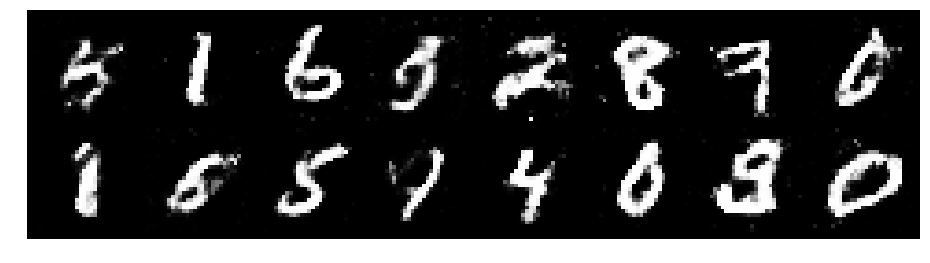

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.1939, Generator Loss: 1.0911
D(x): 0.5455, D(G(z)): 0.3700


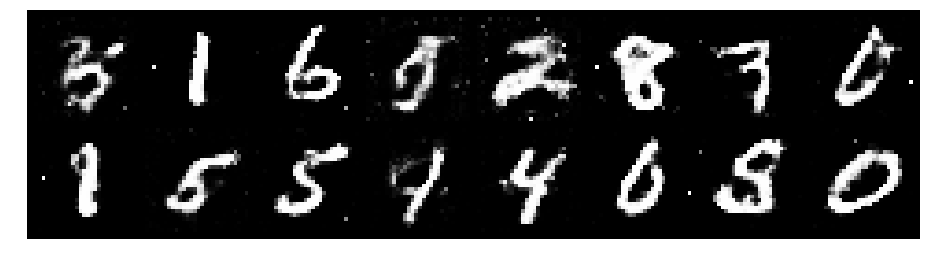

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2022, Generator Loss: 1.0246
D(x): 0.5724, D(G(z)): 0.3958


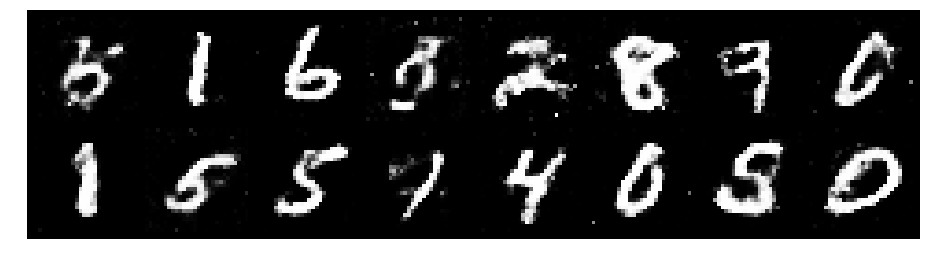

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2687, Generator Loss: 0.7768
D(x): 0.5852, D(G(z)): 0.4641


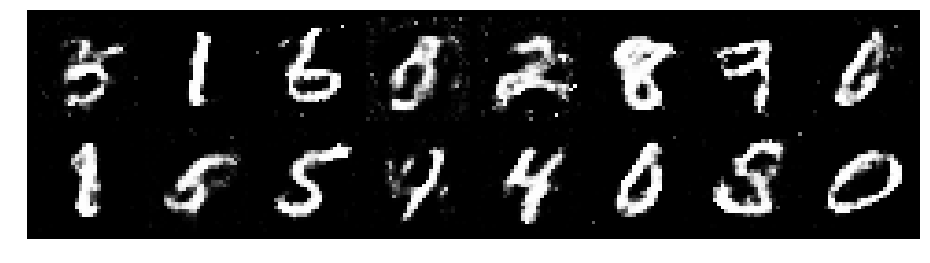

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.1837, Generator Loss: 0.9971
D(x): 0.5556, D(G(z)): 0.3853


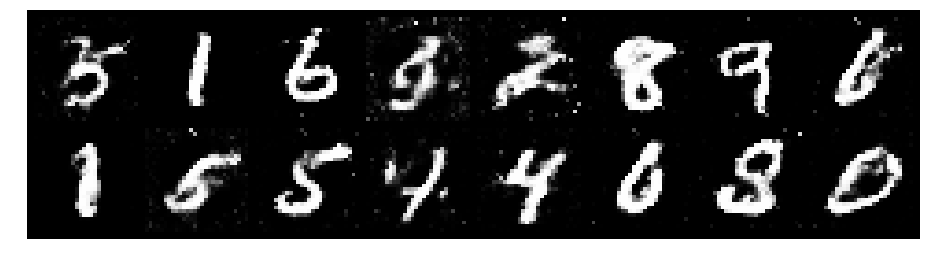

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2519, Generator Loss: 1.0115
D(x): 0.6241, D(G(z)): 0.4726


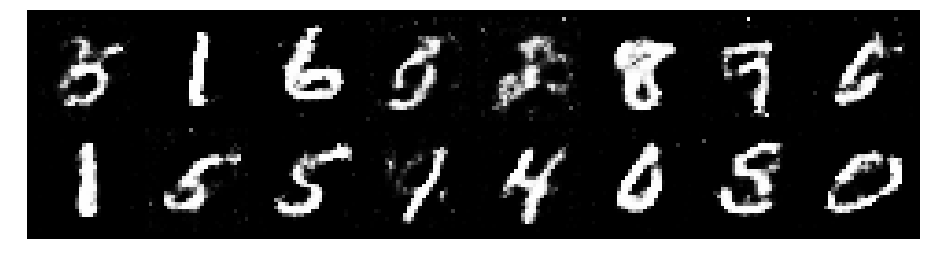

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.1233, Generator Loss: 1.0959
D(x): 0.5858, D(G(z)): 0.3899


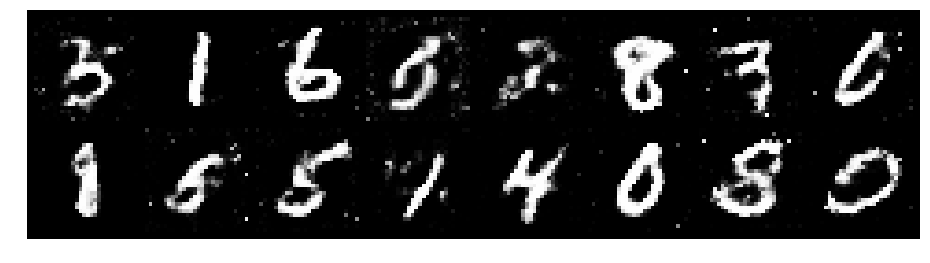

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8231
D(x): 0.5297, D(G(z)): 0.4574


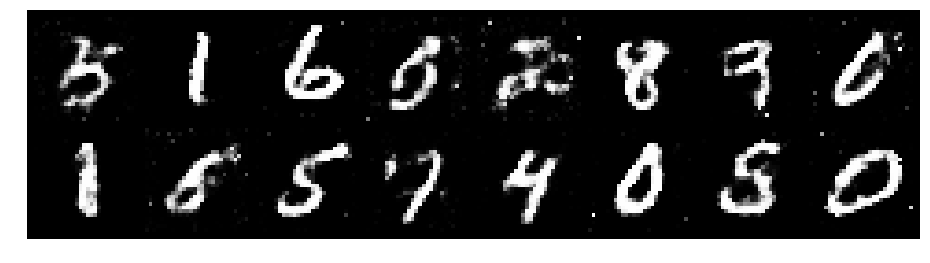

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.2716, Generator Loss: 0.9496
D(x): 0.5405, D(G(z)): 0.4231


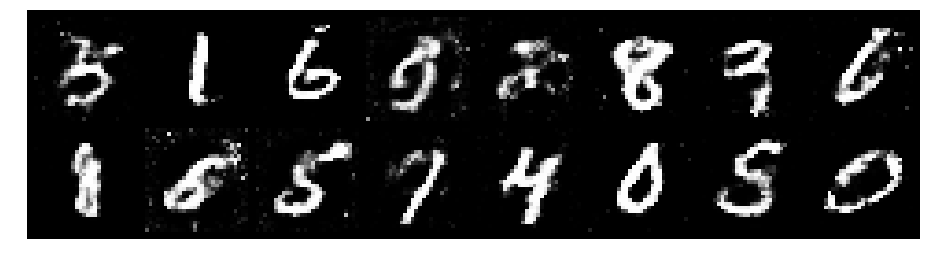

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2583, Generator Loss: 0.7495
D(x): 0.5556, D(G(z)): 0.4522


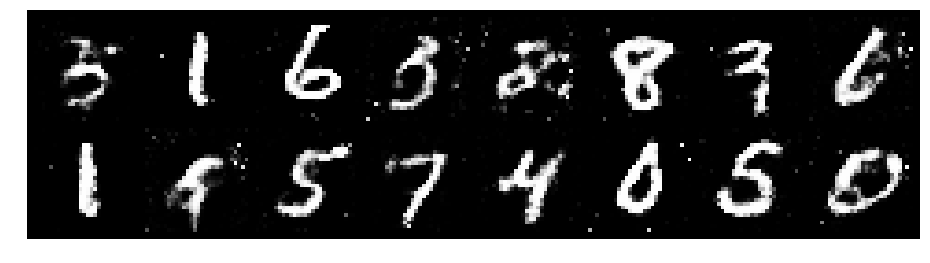

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2846, Generator Loss: 0.9086
D(x): 0.5543, D(G(z)): 0.4465


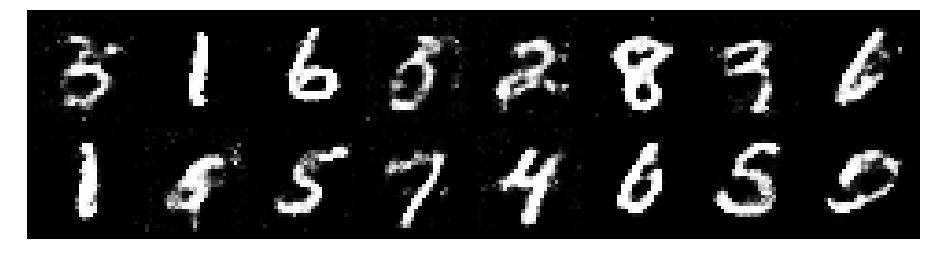

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3215, Generator Loss: 1.0636
D(x): 0.5577, D(G(z)): 0.4485


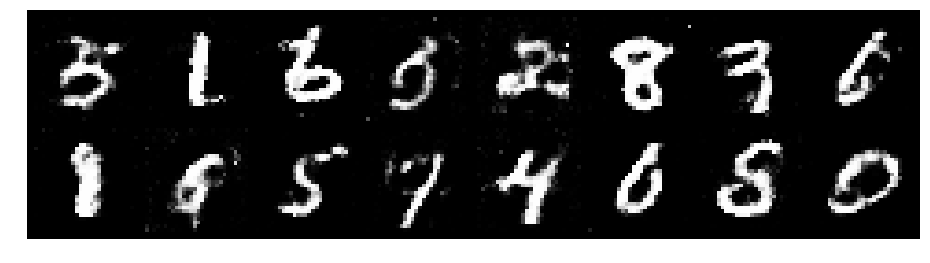

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2205, Generator Loss: 0.9105
D(x): 0.5682, D(G(z)): 0.4052


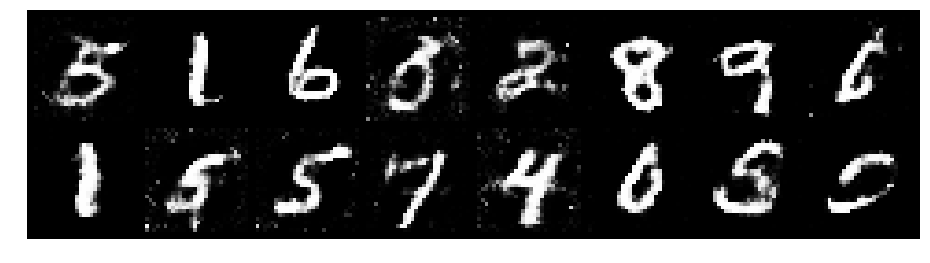

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2846, Generator Loss: 1.0024
D(x): 0.5459, D(G(z)): 0.4197


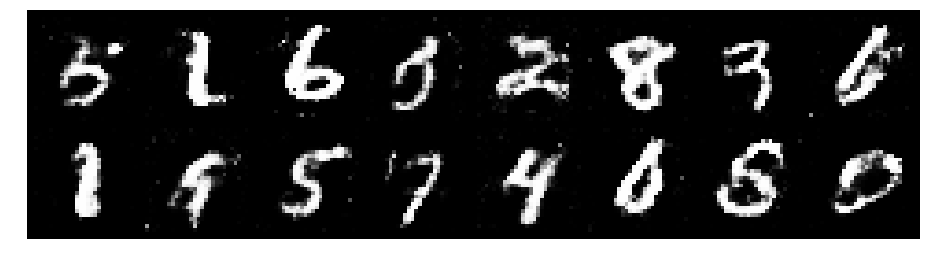

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2087, Generator Loss: 0.9037
D(x): 0.5729, D(G(z)): 0.4391


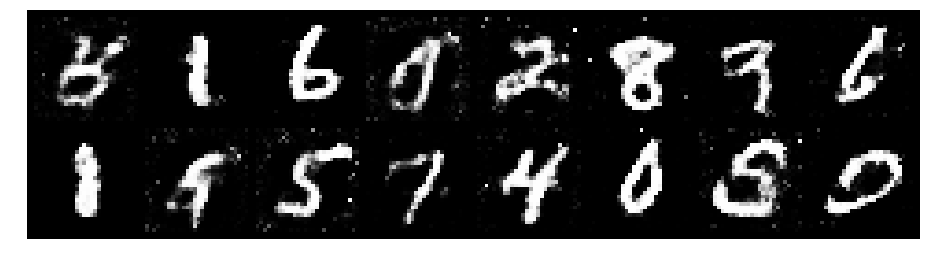

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.1861, Generator Loss: 0.8141
D(x): 0.5768, D(G(z)): 0.4366


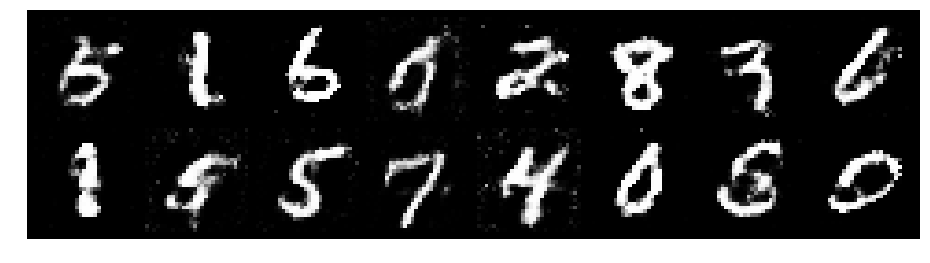

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.1832, Generator Loss: 0.8592
D(x): 0.5515, D(G(z)): 0.4088


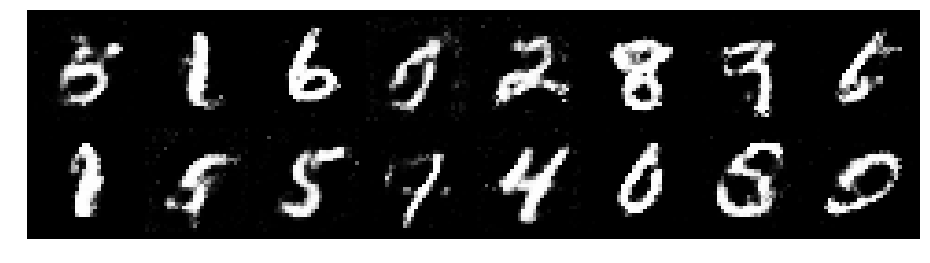

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.3345, Generator Loss: 0.8715
D(x): 0.5412, D(G(z)): 0.4511


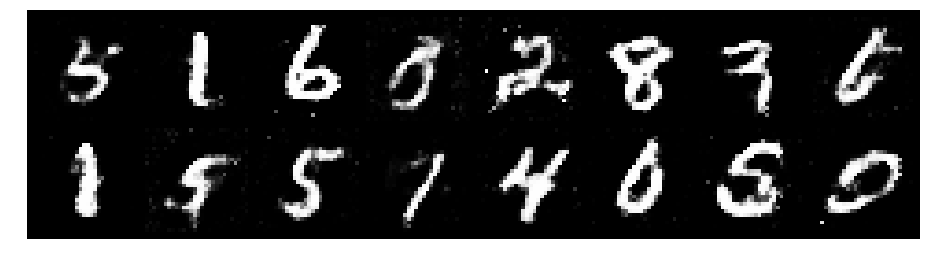

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.1514, Generator Loss: 0.9448
D(x): 0.6037, D(G(z)): 0.4239


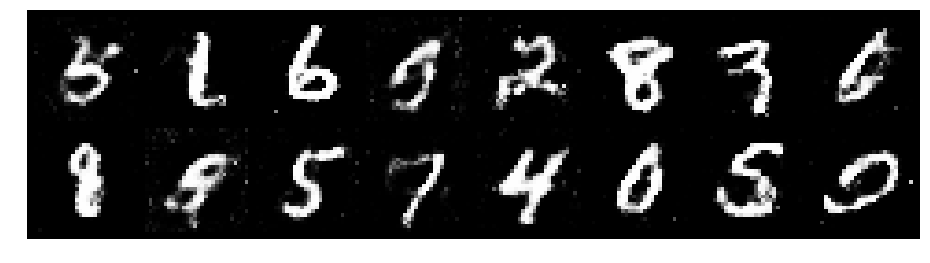

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2430, Generator Loss: 1.0097
D(x): 0.5505, D(G(z)): 0.4243


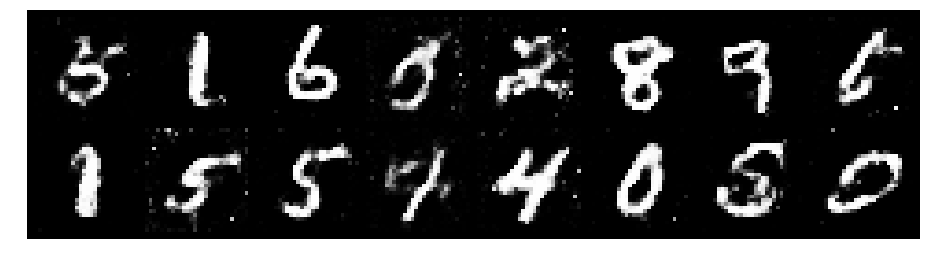

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.1436, Generator Loss: 1.0408
D(x): 0.6368, D(G(z)): 0.4398


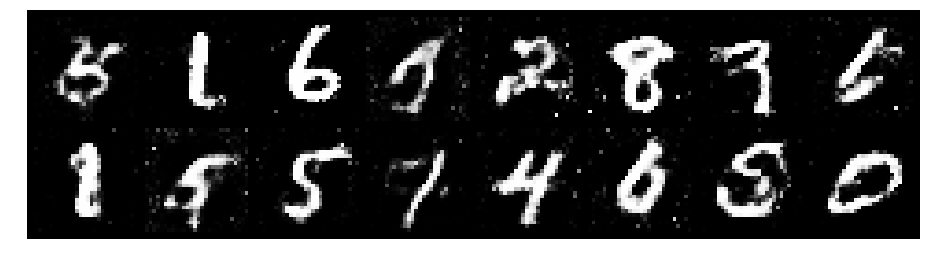

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2510, Generator Loss: 0.7788
D(x): 0.5625, D(G(z)): 0.4570


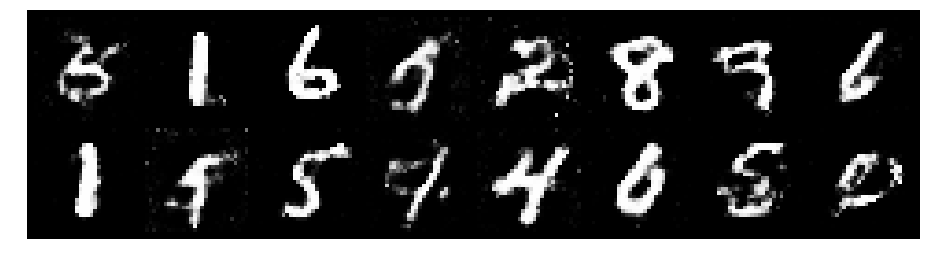

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.4122, Generator Loss: 0.9052
D(x): 0.4818, D(G(z)): 0.4356


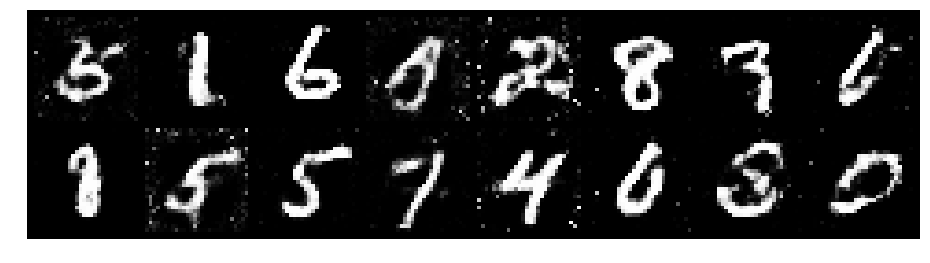

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.3474, Generator Loss: 0.7710
D(x): 0.5154, D(G(z)): 0.4464


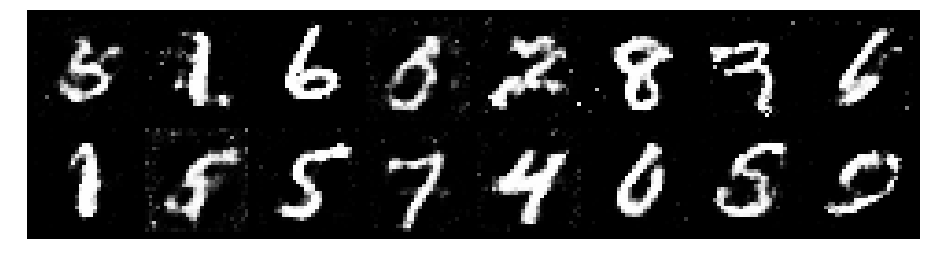

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.3677, Generator Loss: 0.8559
D(x): 0.5339, D(G(z)): 0.4679


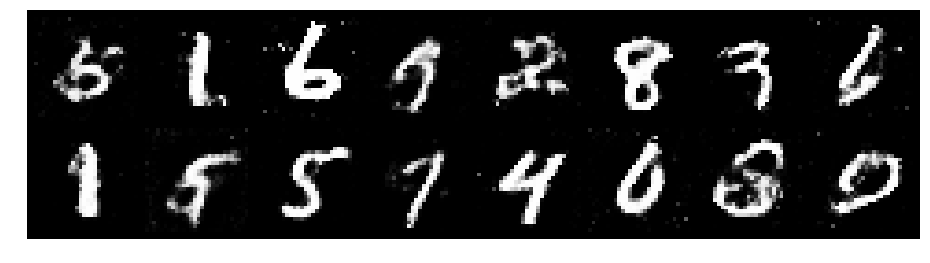

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.1896, Generator Loss: 0.8107
D(x): 0.6176, D(G(z)): 0.4670


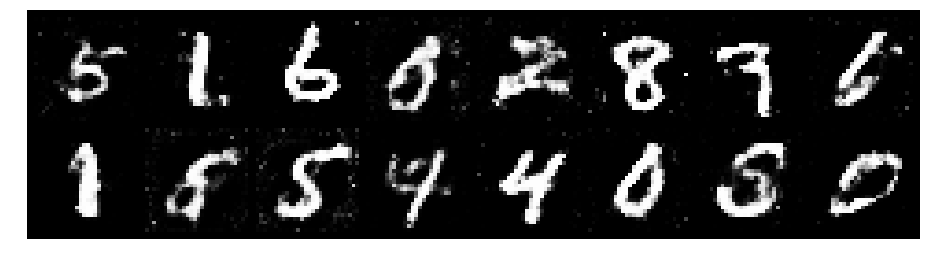

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.2183, Generator Loss: 0.8117
D(x): 0.5979, D(G(z)): 0.4453


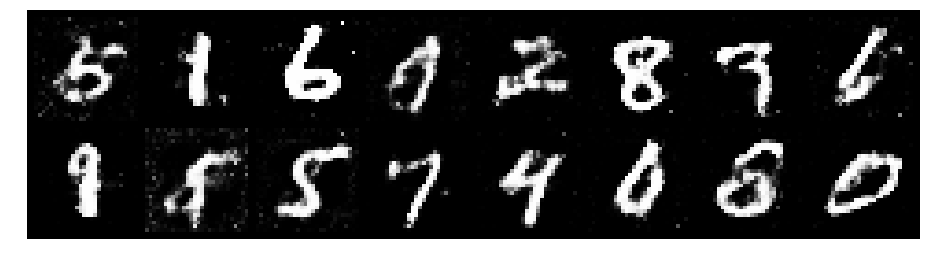

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2975, Generator Loss: 0.9366
D(x): 0.5619, D(G(z)): 0.4478


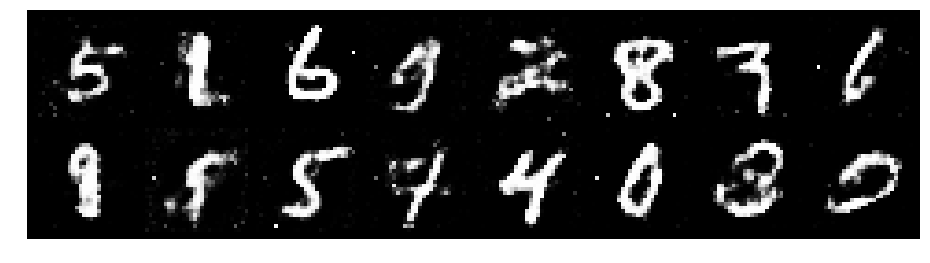

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.1853, Generator Loss: 1.0594
D(x): 0.5708, D(G(z)): 0.4119


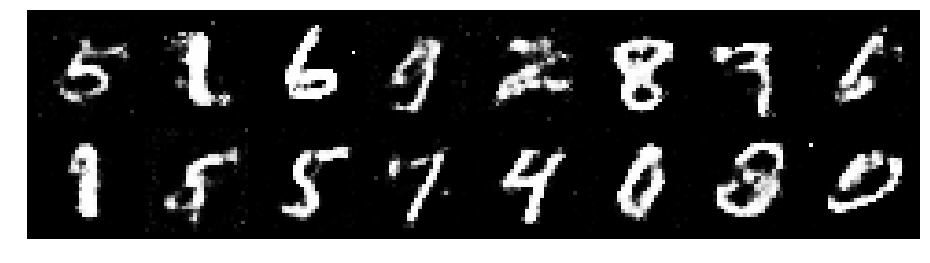

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2806, Generator Loss: 0.8916
D(x): 0.5621, D(G(z)): 0.4631


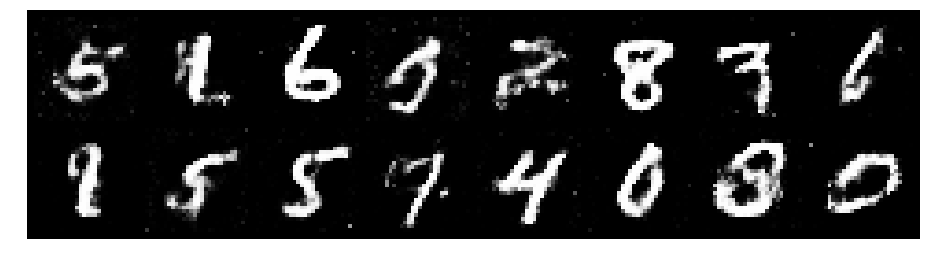

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2144, Generator Loss: 0.9380
D(x): 0.5790, D(G(z)): 0.4458


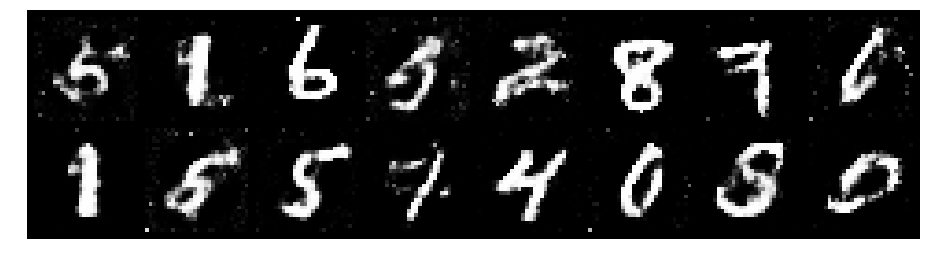

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2298, Generator Loss: 0.8431
D(x): 0.5507, D(G(z)): 0.4335


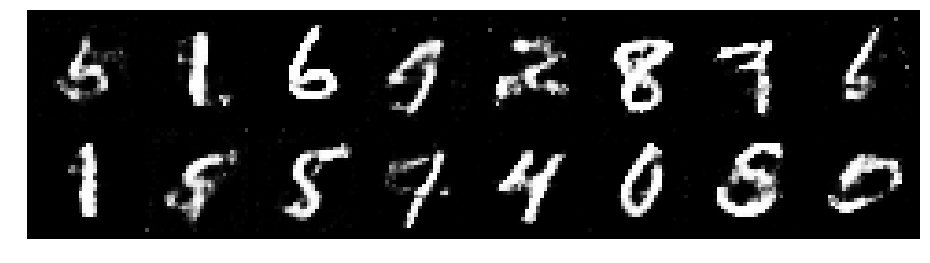

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3252, Generator Loss: 0.8698
D(x): 0.5547, D(G(z)): 0.4863


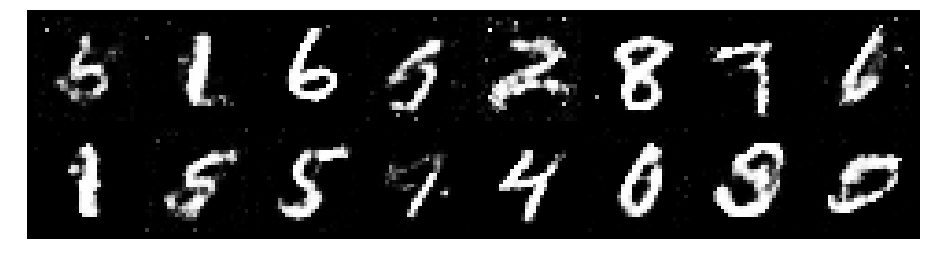

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2367, Generator Loss: 0.9349
D(x): 0.5480, D(G(z)): 0.4262


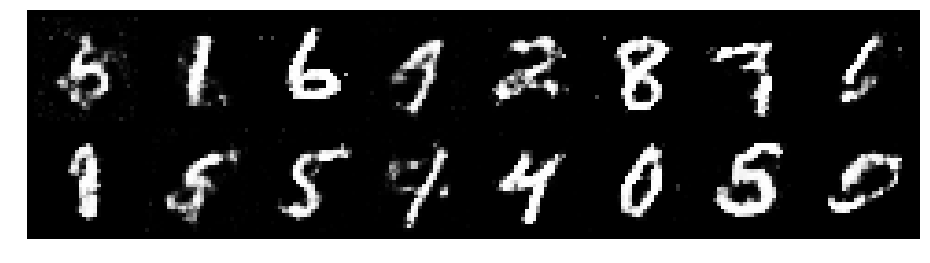

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2648, Generator Loss: 0.8648
D(x): 0.5740, D(G(z)): 0.4615


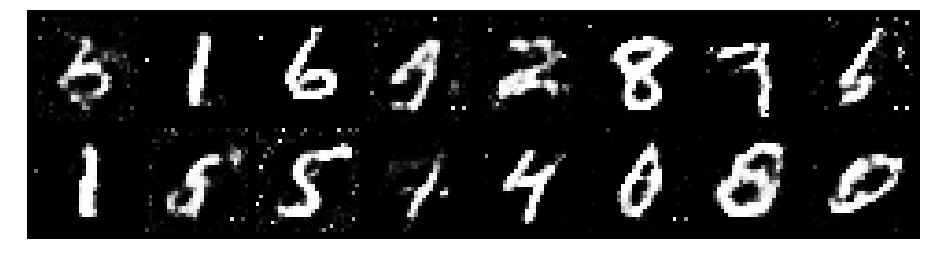

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2758, Generator Loss: 0.7674
D(x): 0.5350, D(G(z)): 0.4405


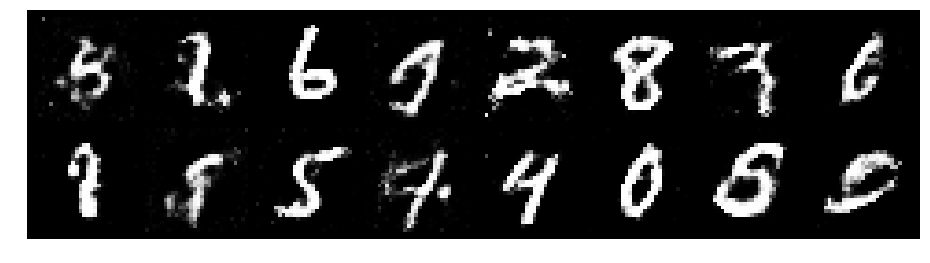

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2694, Generator Loss: 0.9364
D(x): 0.5612, D(G(z)): 0.4458


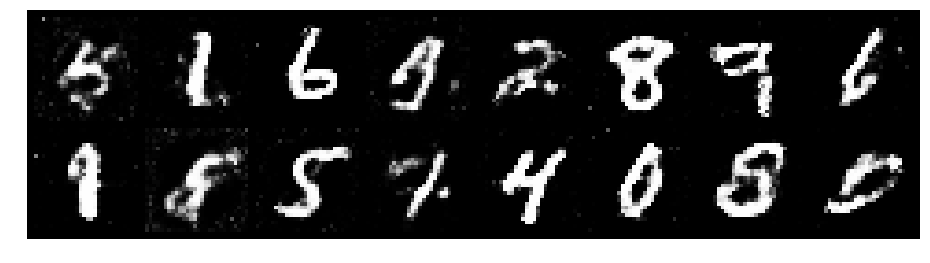

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.2512, Generator Loss: 1.0216
D(x): 0.5606, D(G(z)): 0.4347


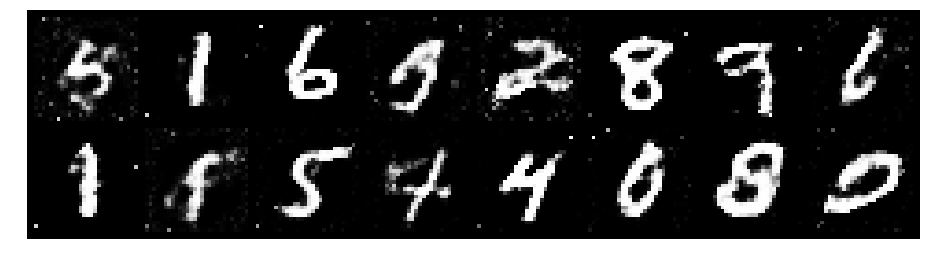

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2577, Generator Loss: 1.0390
D(x): 0.5097, D(G(z)): 0.3826


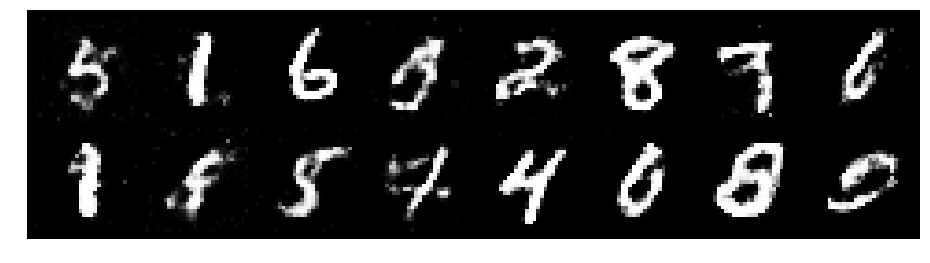

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2795, Generator Loss: 0.9708
D(x): 0.5656, D(G(z)): 0.4397


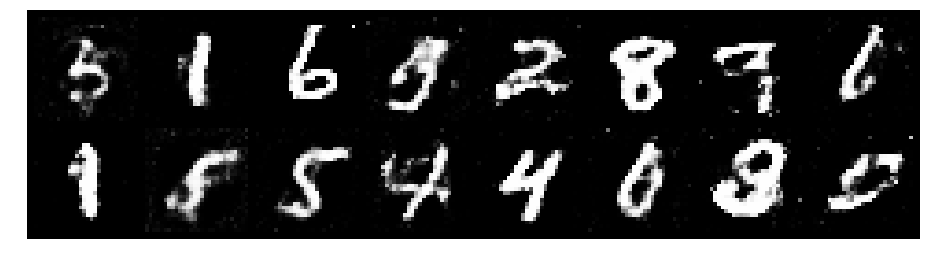

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.3118, Generator Loss: 0.7847
D(x): 0.5402, D(G(z)): 0.4579


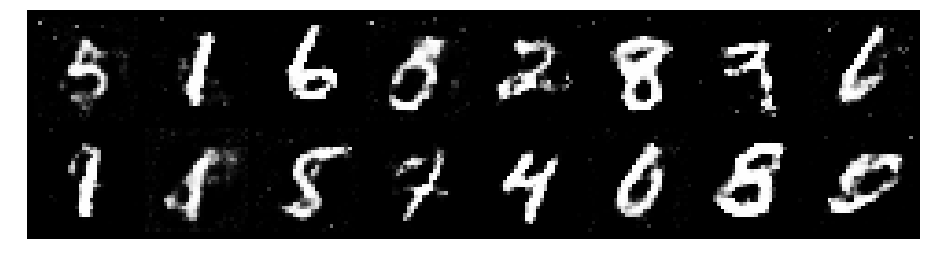

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2685, Generator Loss: 1.0016
D(x): 0.5742, D(G(z)): 0.4508


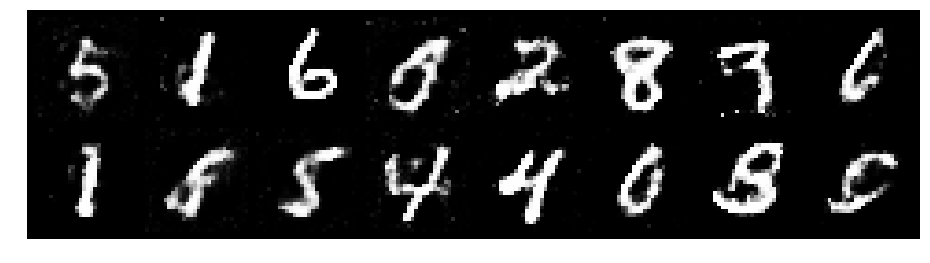

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2690, Generator Loss: 1.0323
D(x): 0.5411, D(G(z)): 0.4390


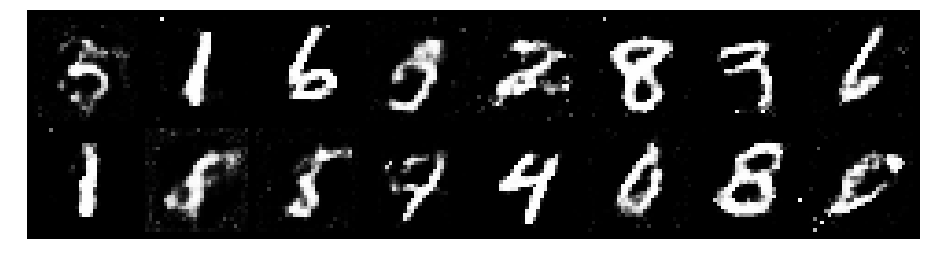

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3538, Generator Loss: 0.8797
D(x): 0.5132, D(G(z)): 0.4516


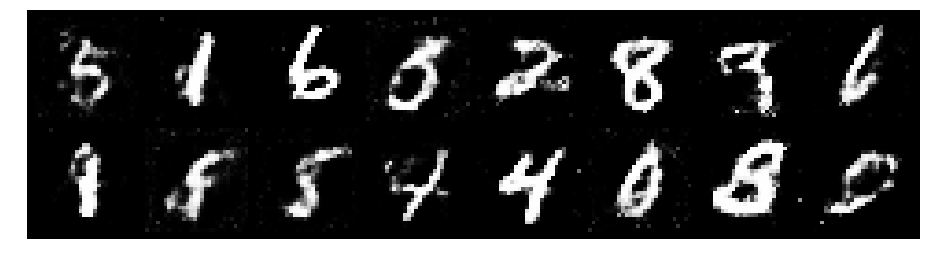

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2244, Generator Loss: 0.8238
D(x): 0.5780, D(G(z)): 0.4439


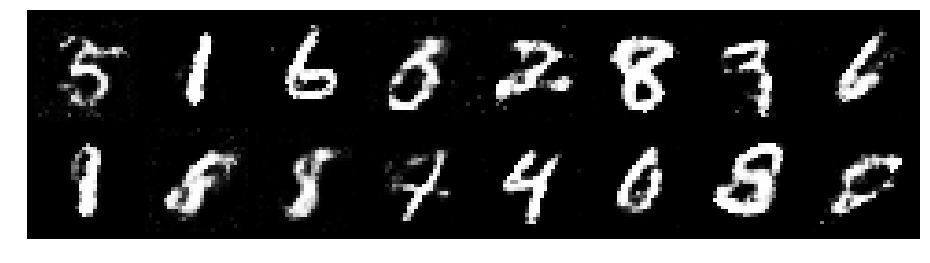

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2555, Generator Loss: 0.8966
D(x): 0.5305, D(G(z)): 0.4276


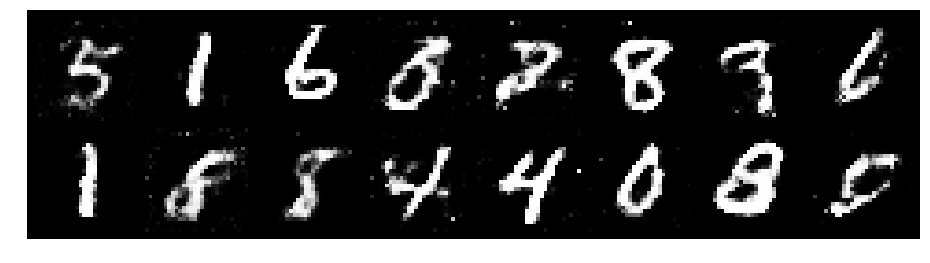

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.3498, Generator Loss: 0.8427
D(x): 0.5070, D(G(z)): 0.4476


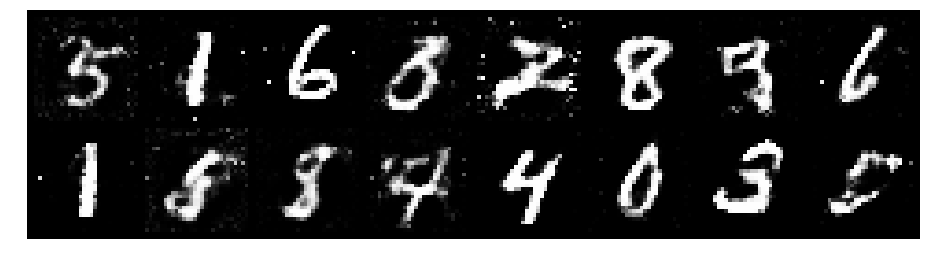

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3549, Generator Loss: 0.7975
D(x): 0.5222, D(G(z)): 0.4650


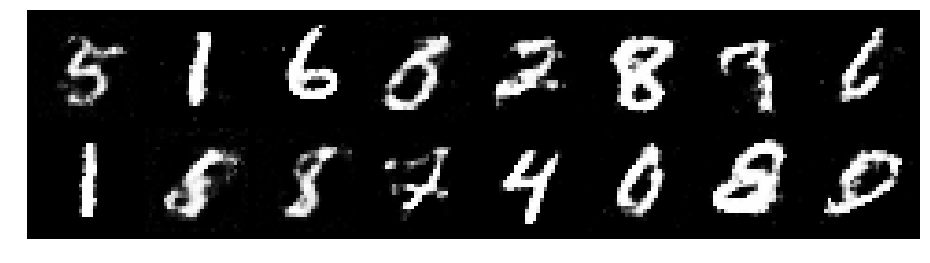

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.3166, Generator Loss: 0.7292
D(x): 0.5672, D(G(z)): 0.4908


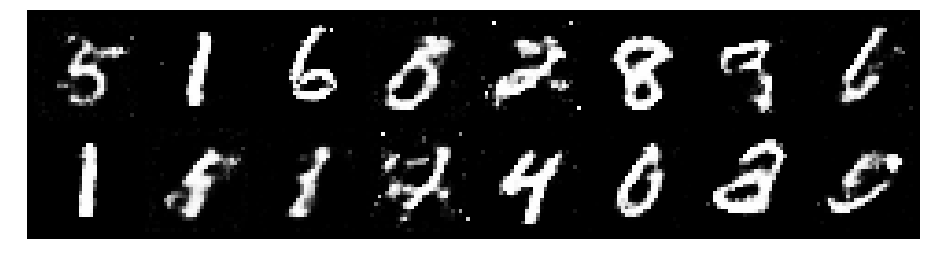

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.3779, Generator Loss: 0.8589
D(x): 0.5224, D(G(z)): 0.4695


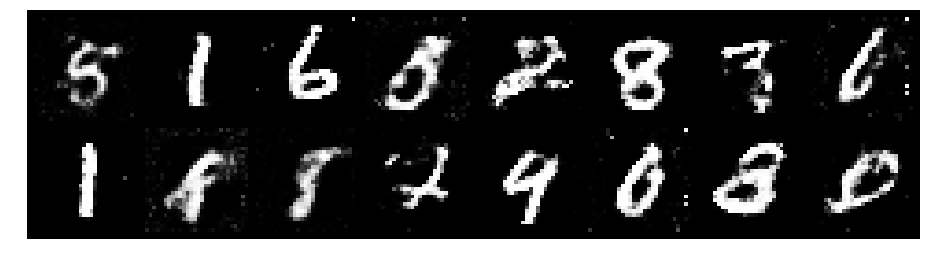

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3391, Generator Loss: 0.8371
D(x): 0.5293, D(G(z)): 0.4693


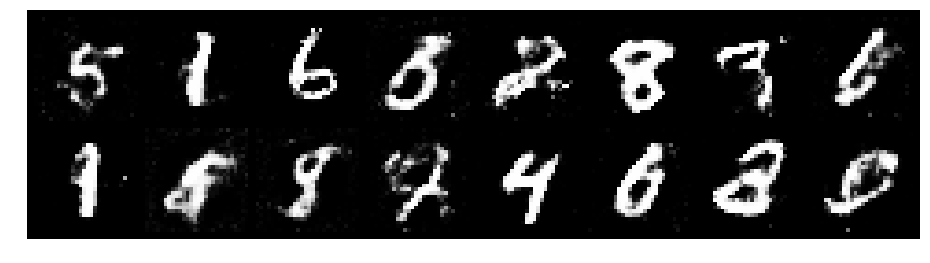

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.2654, Generator Loss: 0.7864
D(x): 0.5503, D(G(z)): 0.4597


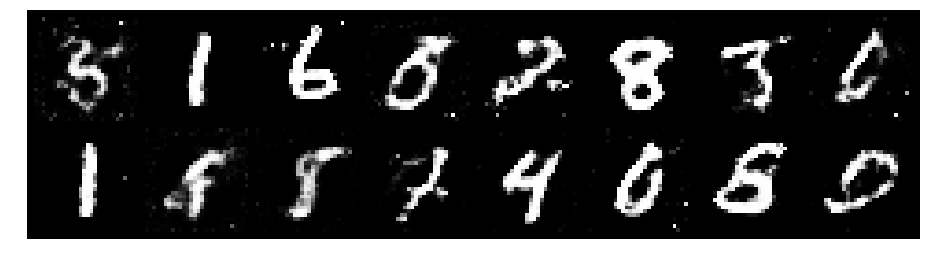

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2773, Generator Loss: 1.0736
D(x): 0.5300, D(G(z)): 0.4041


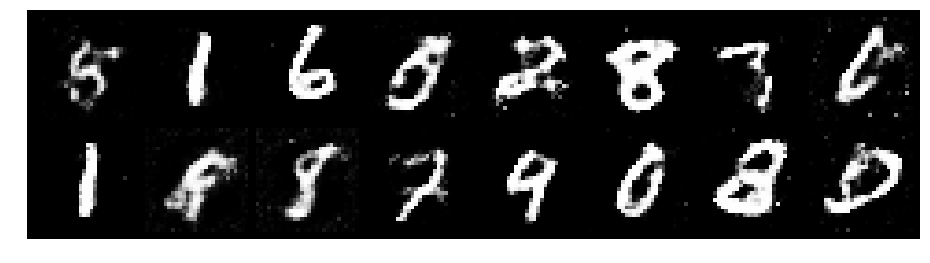

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3127, Generator Loss: 1.0821
D(x): 0.5416, D(G(z)): 0.4123


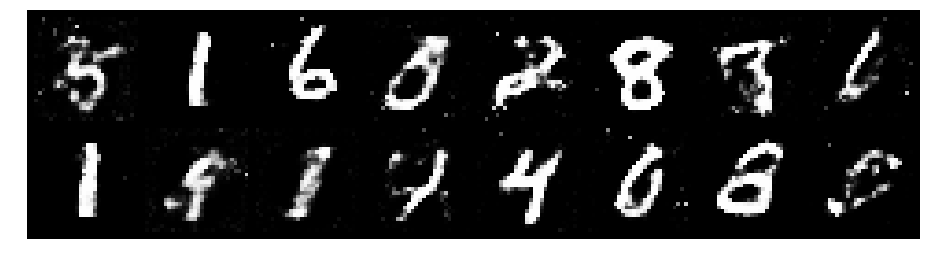

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.1852, Generator Loss: 0.8739
D(x): 0.5865, D(G(z)): 0.4321


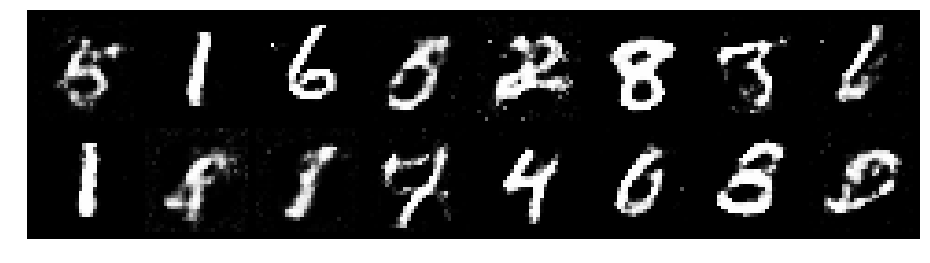

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2901, Generator Loss: 0.9927
D(x): 0.5621, D(G(z)): 0.4428


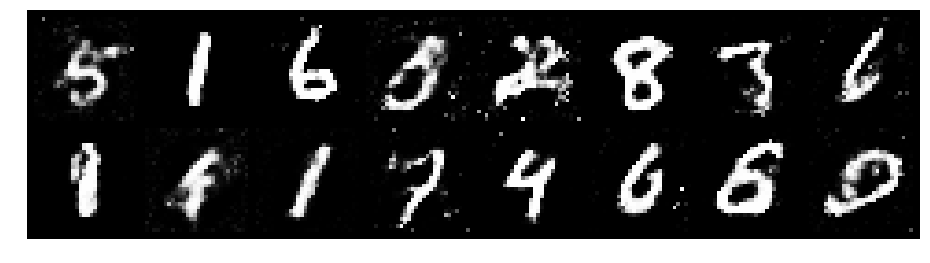

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2101, Generator Loss: 0.9187
D(x): 0.5641, D(G(z)): 0.4162


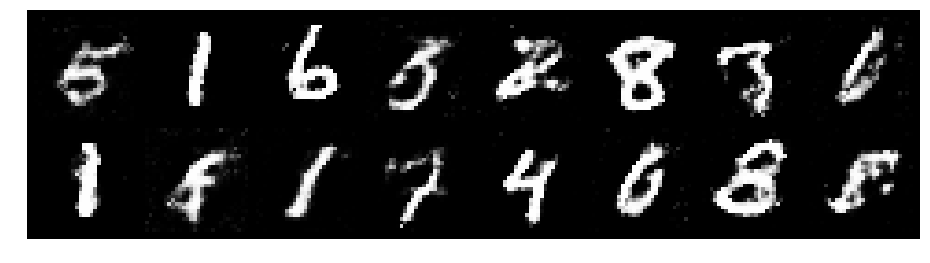

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.1829, Generator Loss: 0.8452
D(x): 0.5727, D(G(z)): 0.4282


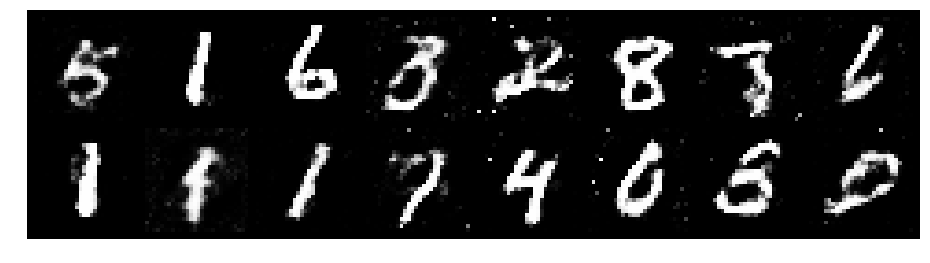

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2292, Generator Loss: 0.8560
D(x): 0.5565, D(G(z)): 0.4352


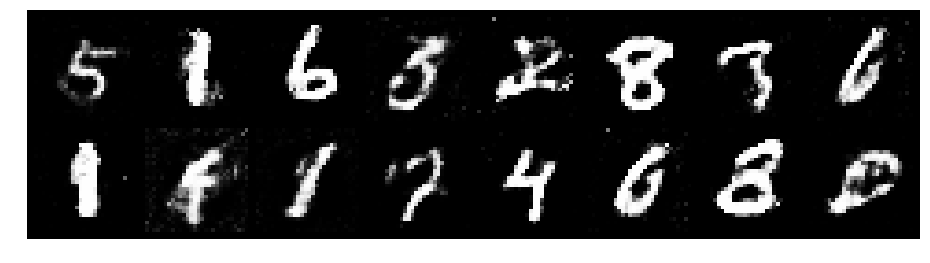

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2746, Generator Loss: 0.8925
D(x): 0.5574, D(G(z)): 0.4320


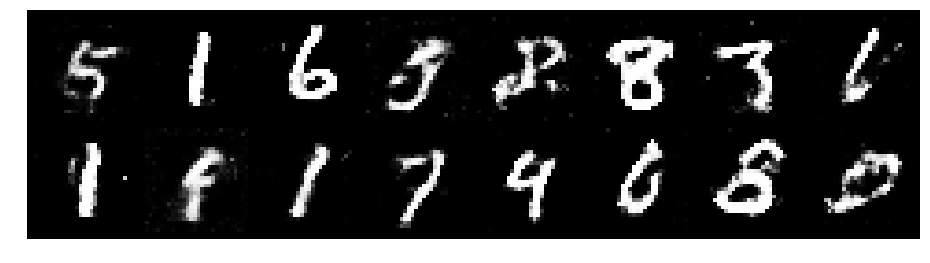

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2639, Generator Loss: 0.8084
D(x): 0.5576, D(G(z)): 0.4454


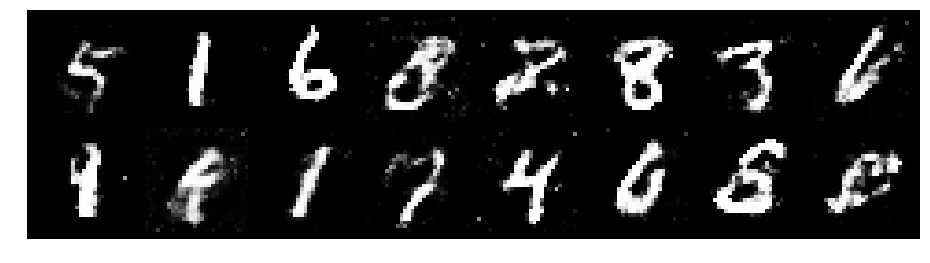

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2737, Generator Loss: 0.8294
D(x): 0.5632, D(G(z)): 0.4543


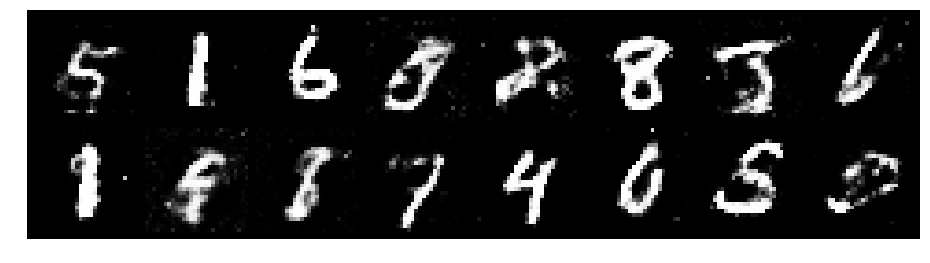

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2606, Generator Loss: 0.8500
D(x): 0.5522, D(G(z)): 0.4556


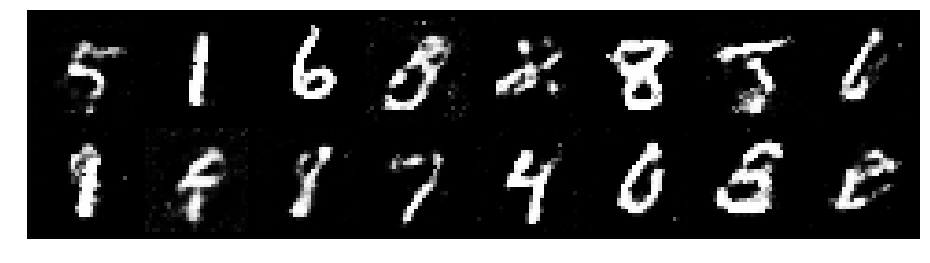

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3162, Generator Loss: 0.8752
D(x): 0.5267, D(G(z)): 0.4454


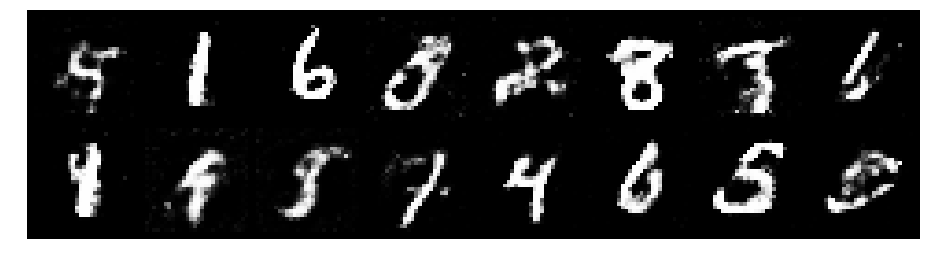

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.3487, Generator Loss: 0.7863
D(x): 0.5115, D(G(z)): 0.4440


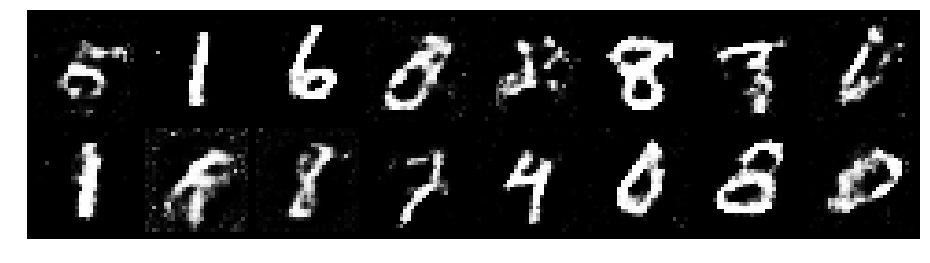

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2265, Generator Loss: 0.9750
D(x): 0.5398, D(G(z)): 0.4165


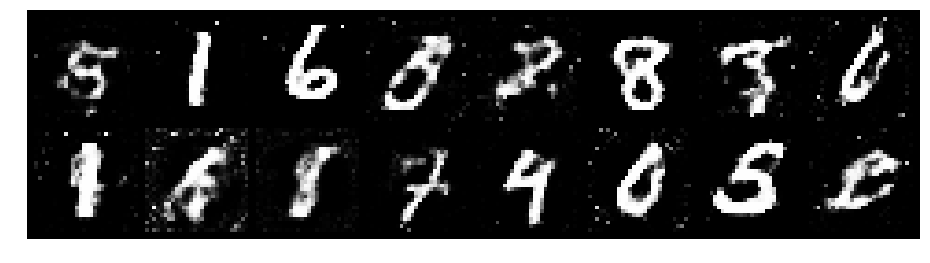

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.1759, Generator Loss: 0.8304
D(x): 0.5807, D(G(z)): 0.4358


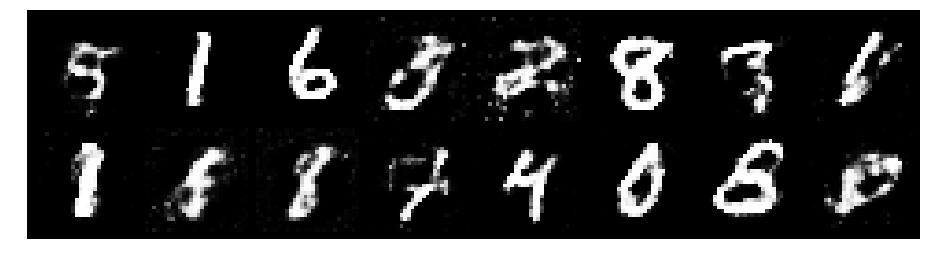

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.1825, Generator Loss: 0.8676
D(x): 0.5584, D(G(z)): 0.3951


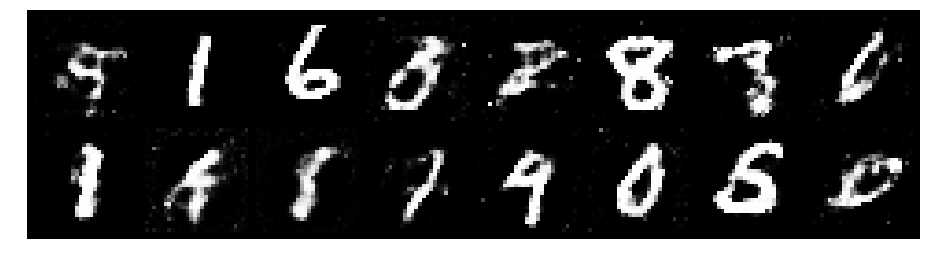

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.3022, Generator Loss: 1.0793
D(x): 0.5843, D(G(z)): 0.4749


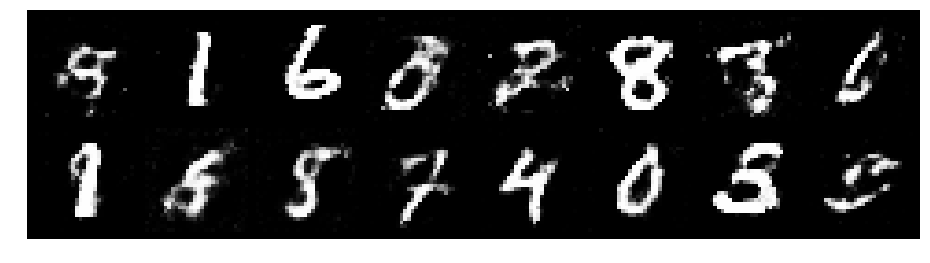

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.3344, Generator Loss: 0.9216
D(x): 0.5442, D(G(z)): 0.4531


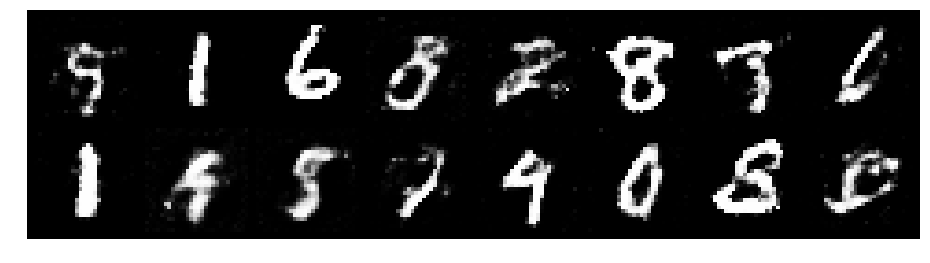

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.1474, Generator Loss: 0.9095
D(x): 0.5934, D(G(z)): 0.4131


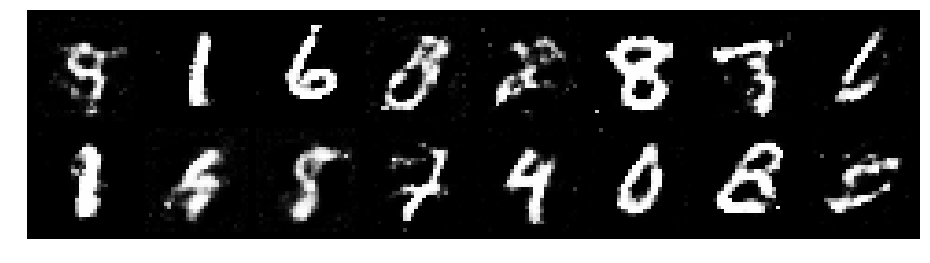

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3847, Generator Loss: 0.8765
D(x): 0.5739, D(G(z)): 0.4930


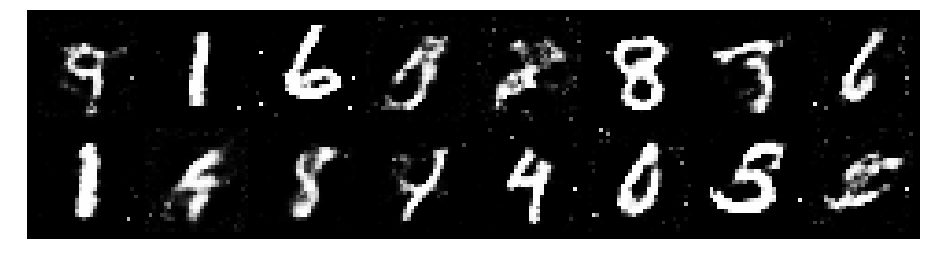

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3285, Generator Loss: 0.9286
D(x): 0.5466, D(G(z)): 0.4657


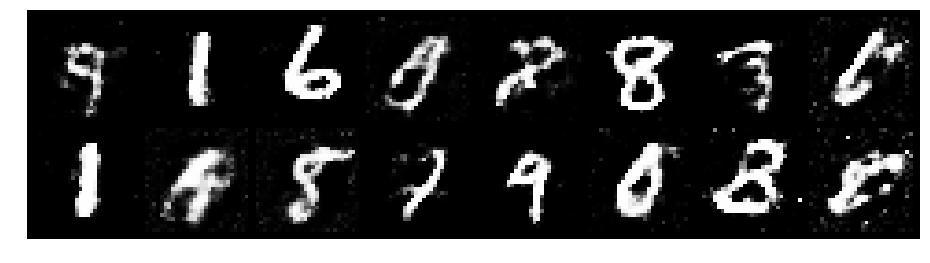

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.0665, Generator Loss: 0.9676
D(x): 0.6360, D(G(z)): 0.4014


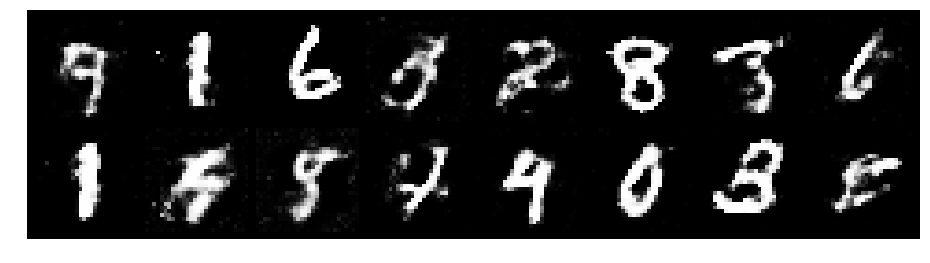

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8374
D(x): 0.5406, D(G(z)): 0.4451


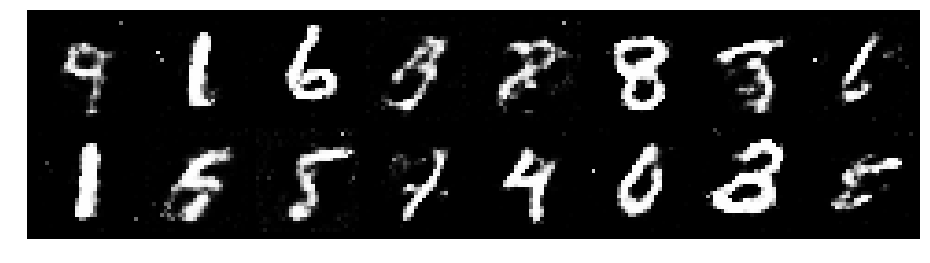

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.3075, Generator Loss: 0.9323
D(x): 0.5599, D(G(z)): 0.4607


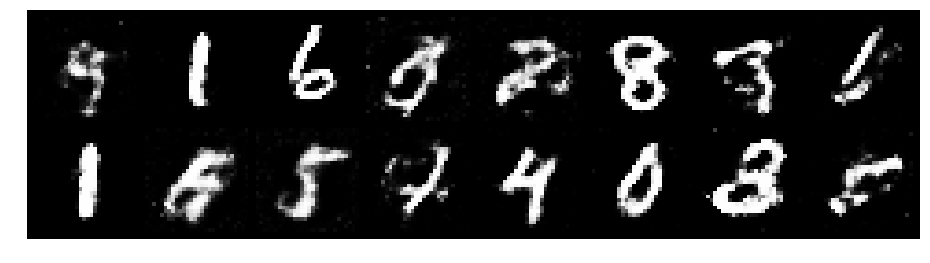

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.3414, Generator Loss: 0.8291
D(x): 0.5470, D(G(z)): 0.4858


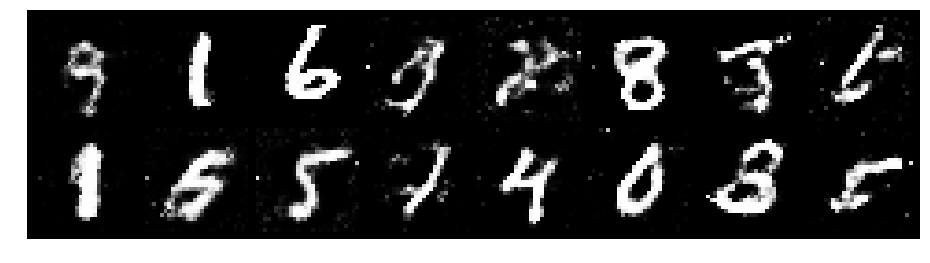

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2566, Generator Loss: 0.8818
D(x): 0.5619, D(G(z)): 0.4491


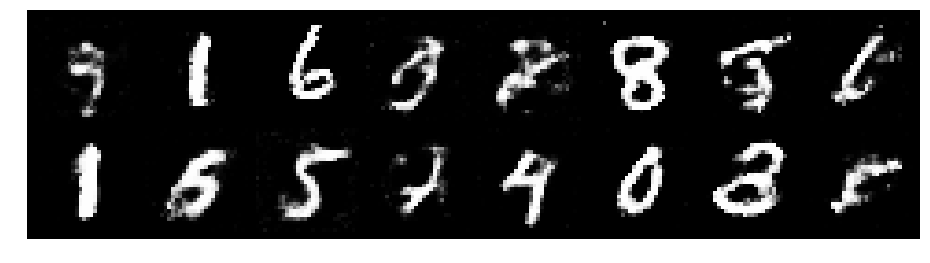

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2335, Generator Loss: 0.9739
D(x): 0.5258, D(G(z)): 0.4108


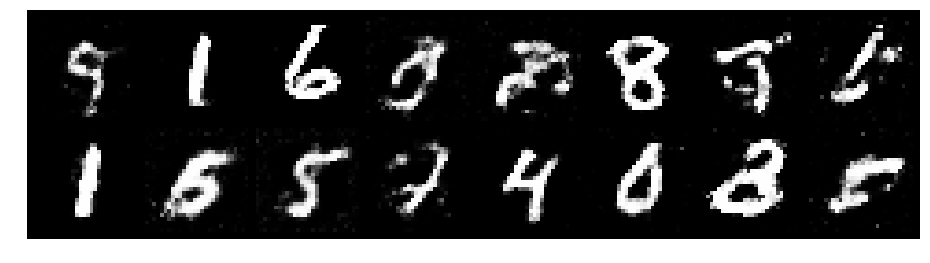

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.4238, Generator Loss: 0.7910
D(x): 0.5476, D(G(z)): 0.5077


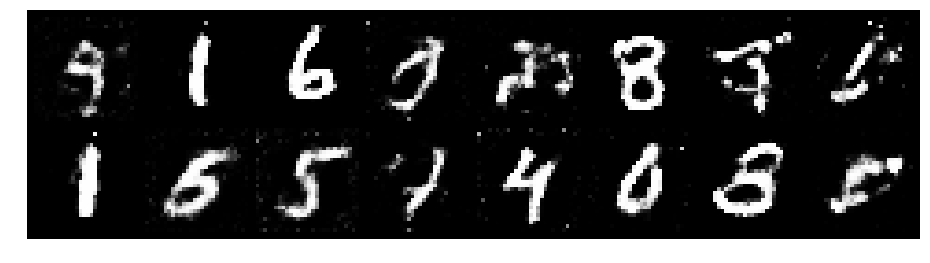

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2951, Generator Loss: 0.8007
D(x): 0.5536, D(G(z)): 0.4565


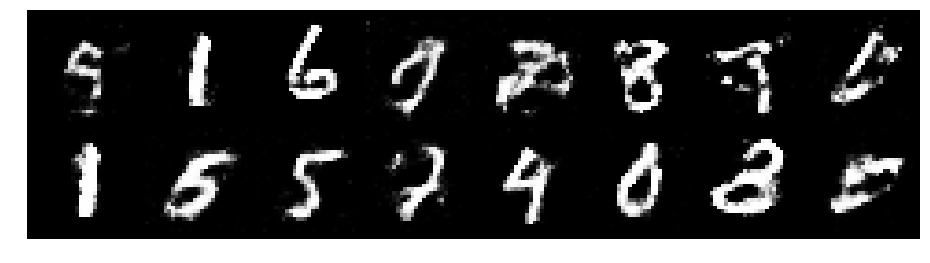

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.3103, Generator Loss: 0.8241
D(x): 0.5981, D(G(z)): 0.4734


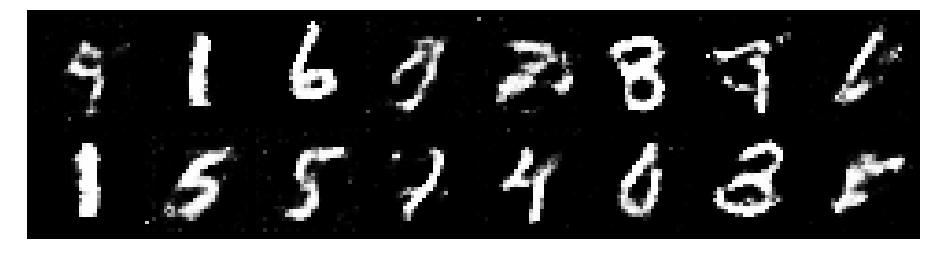

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.3342, Generator Loss: 1.0570
D(x): 0.5425, D(G(z)): 0.4505


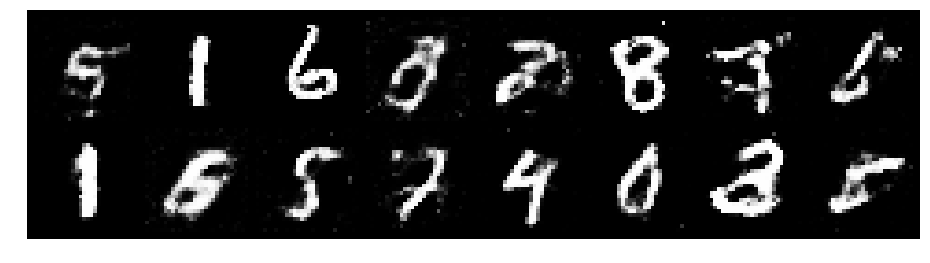

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2355, Generator Loss: 1.0062
D(x): 0.5507, D(G(z)): 0.4194


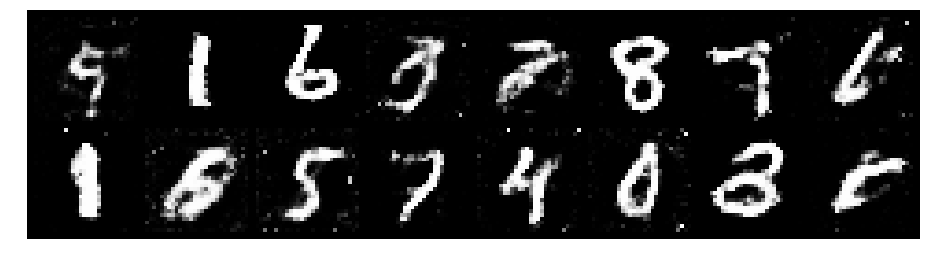

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.1508, Generator Loss: 1.0175
D(x): 0.5653, D(G(z)): 0.3950


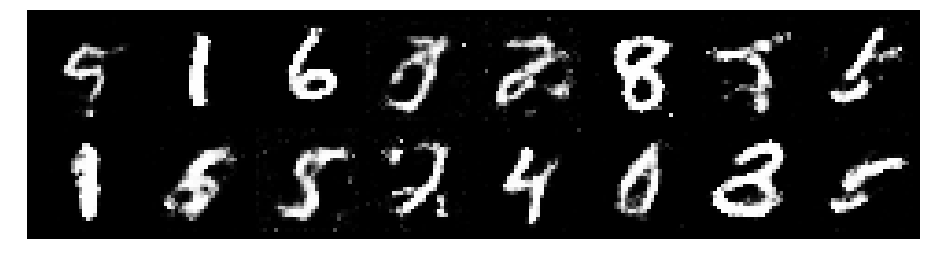

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.1359, Generator Loss: 0.8799
D(x): 0.5711, D(G(z)): 0.3949


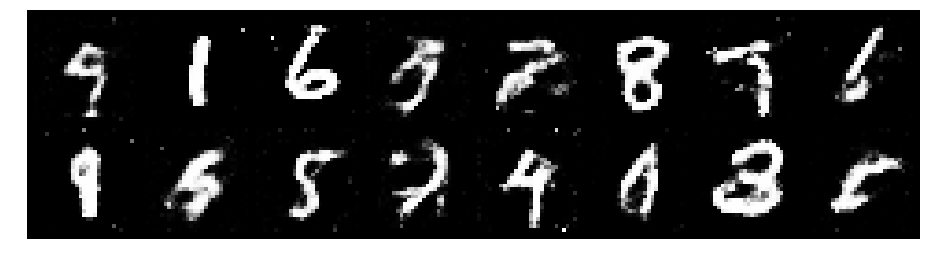

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2344, Generator Loss: 0.8516
D(x): 0.5384, D(G(z)): 0.4342


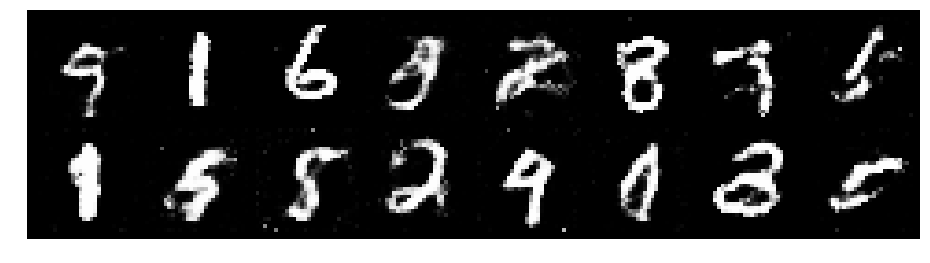

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3240, Generator Loss: 0.8524
D(x): 0.5108, D(G(z)): 0.4428


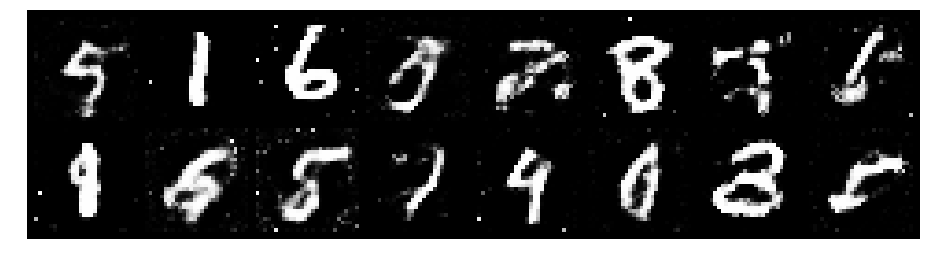

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2507, Generator Loss: 0.8847
D(x): 0.5564, D(G(z)): 0.4255


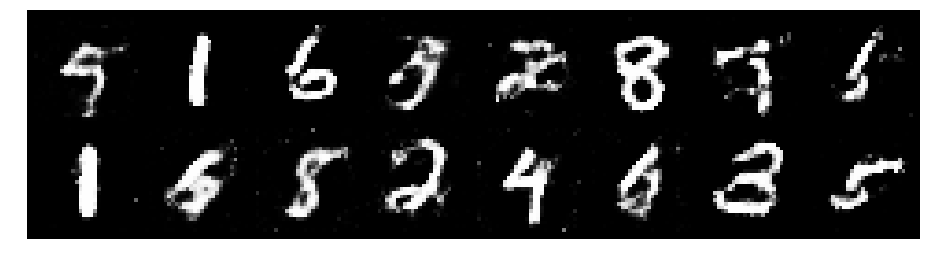

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2397, Generator Loss: 0.8942
D(x): 0.5523, D(G(z)): 0.4169


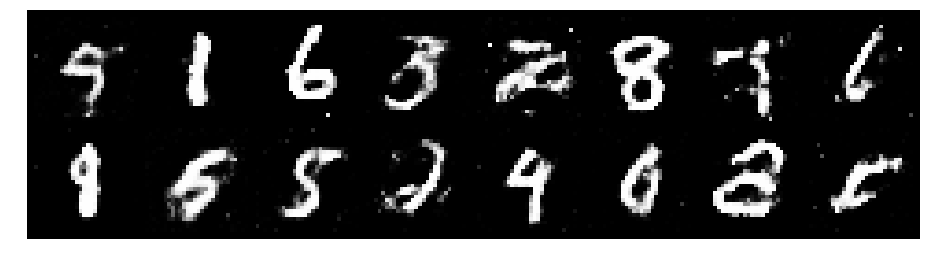

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.3028, Generator Loss: 1.1004
D(x): 0.5365, D(G(z)): 0.4290


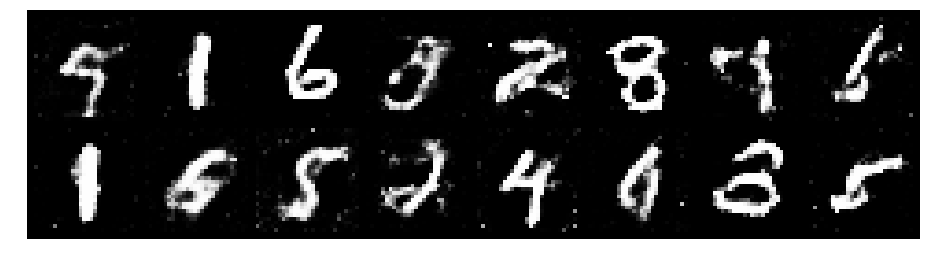

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2024, Generator Loss: 0.9269
D(x): 0.5571, D(G(z)): 0.4075


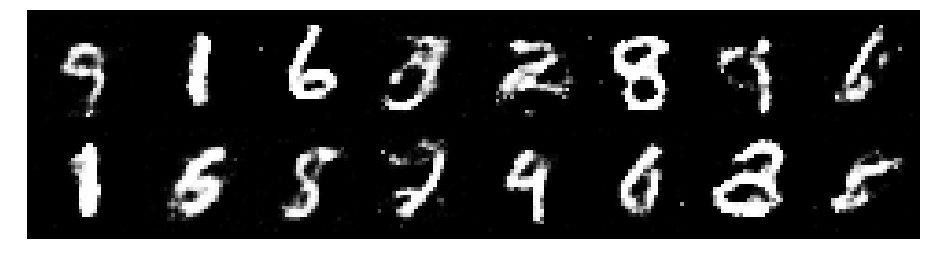

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.3117, Generator Loss: 0.9564
D(x): 0.5336, D(G(z)): 0.4421


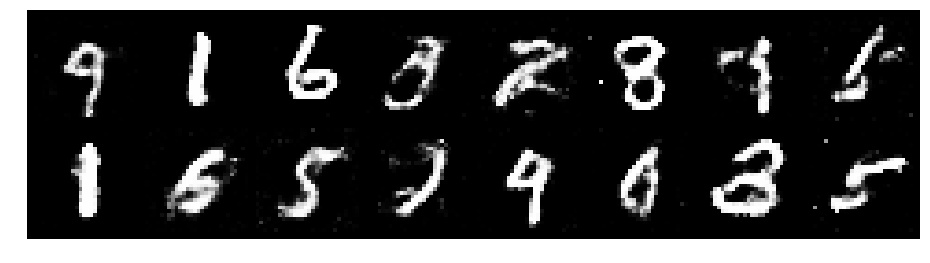

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2769, Generator Loss: 1.1715
D(x): 0.5183, D(G(z)): 0.3856


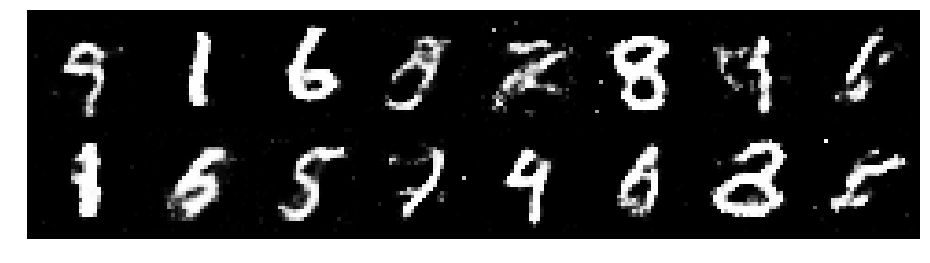

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2189, Generator Loss: 1.0995
D(x): 0.5480, D(G(z)): 0.4044


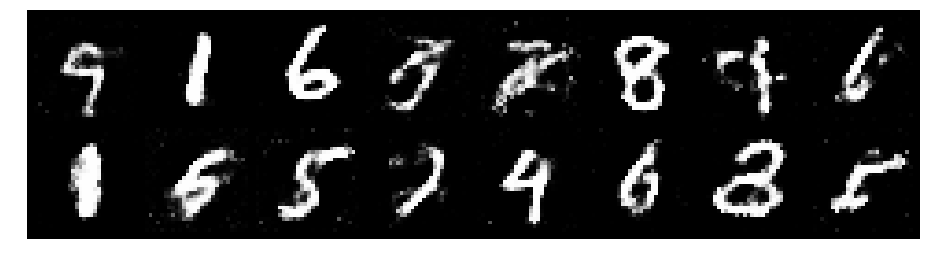

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3263, Generator Loss: 0.9367
D(x): 0.5088, D(G(z)): 0.4131


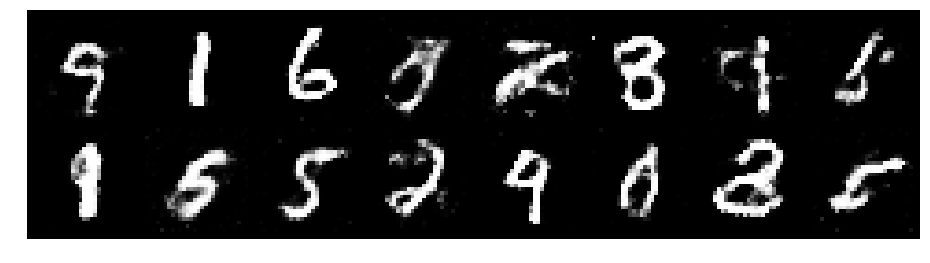

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3500, Generator Loss: 0.7871
D(x): 0.5415, D(G(z)): 0.4640


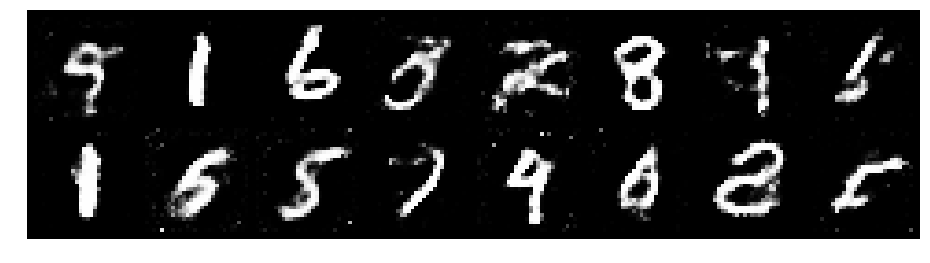

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2870, Generator Loss: 0.7868
D(x): 0.5479, D(G(z)): 0.4291


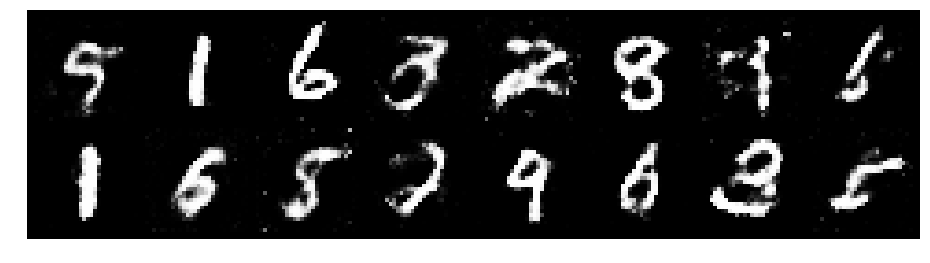

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2360, Generator Loss: 0.8920
D(x): 0.5739, D(G(z)): 0.4456


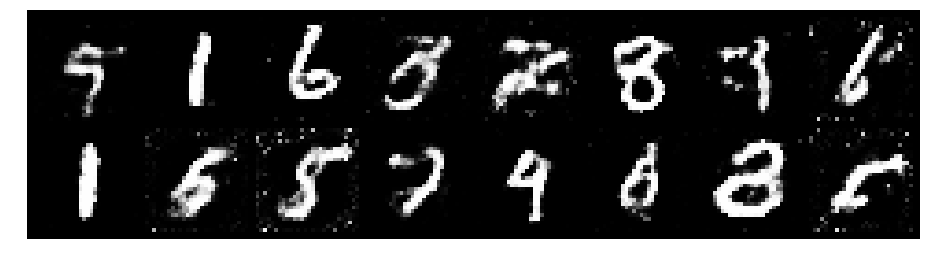

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.1958, Generator Loss: 0.8396
D(x): 0.5866, D(G(z)): 0.4457


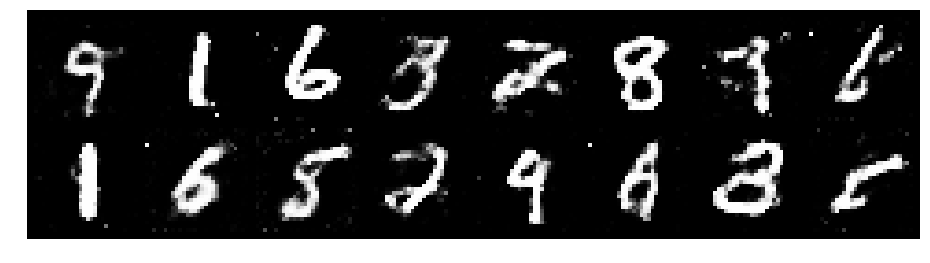

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.1676, Generator Loss: 0.9759
D(x): 0.5737, D(G(z)): 0.4027


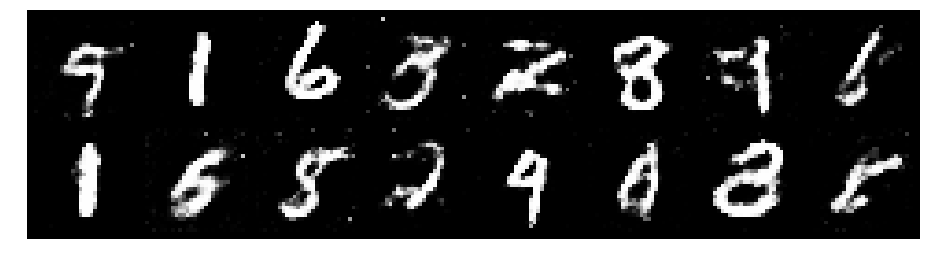

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2015, Generator Loss: 0.8641
D(x): 0.5486, D(G(z)): 0.4024


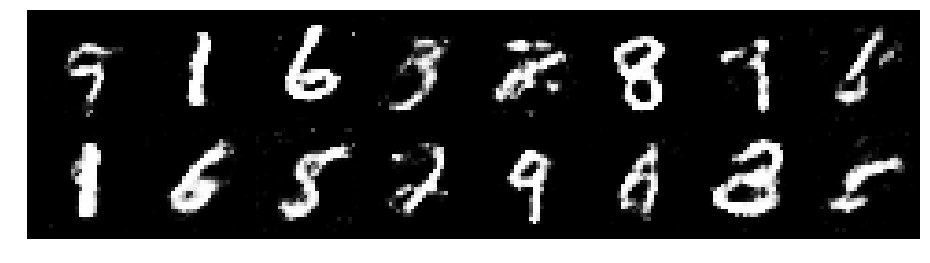

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2917, Generator Loss: 0.9033
D(x): 0.5808, D(G(z)): 0.4726


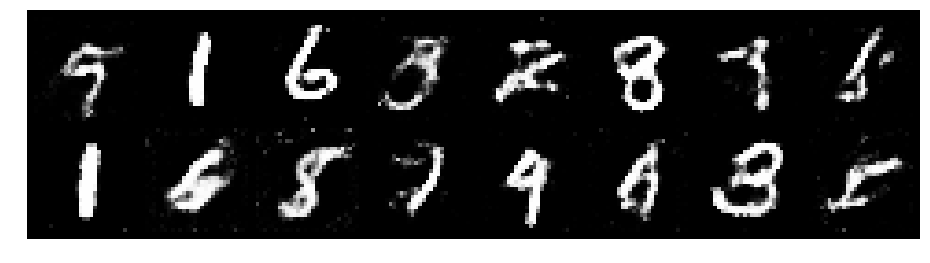

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2746, Generator Loss: 0.9606
D(x): 0.5617, D(G(z)): 0.4499


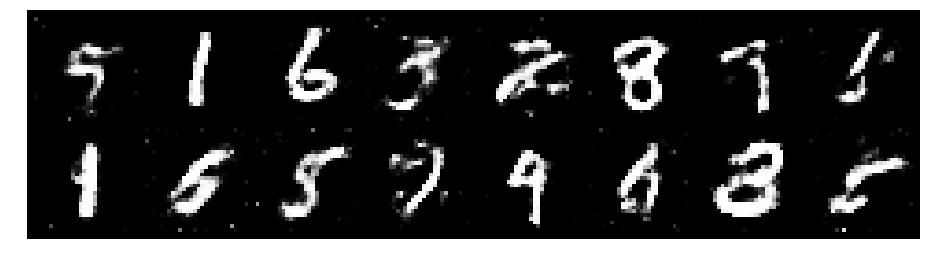

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2999, Generator Loss: 0.8715
D(x): 0.5840, D(G(z)): 0.4862


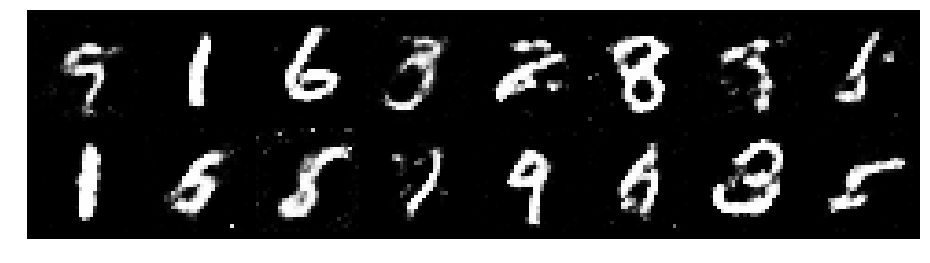

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3200, Generator Loss: 0.8367
D(x): 0.5357, D(G(z)): 0.4676


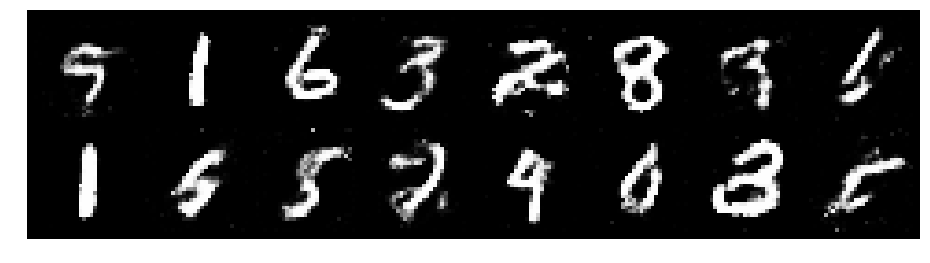

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.1788, Generator Loss: 0.9337
D(x): 0.6057, D(G(z)): 0.4498


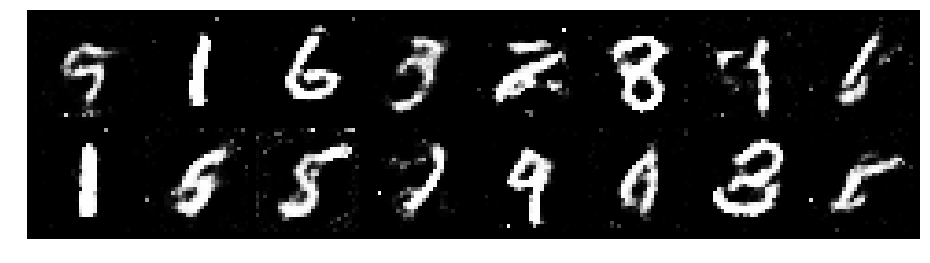

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2547, Generator Loss: 0.9073
D(x): 0.5469, D(G(z)): 0.4201


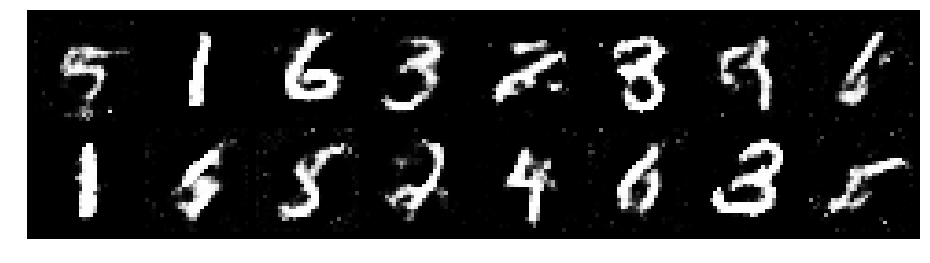

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2930, Generator Loss: 1.0302
D(x): 0.5342, D(G(z)): 0.4227


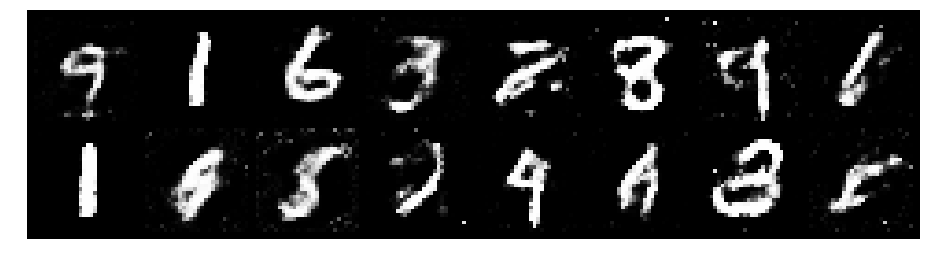

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2895, Generator Loss: 0.9382
D(x): 0.5451, D(G(z)): 0.4345


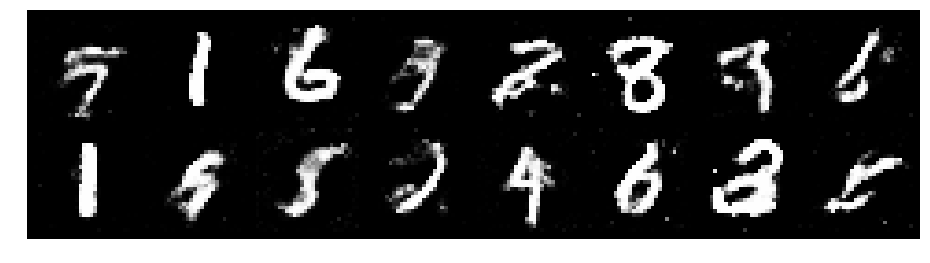

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.4242, Generator Loss: 0.8610
D(x): 0.5124, D(G(z)): 0.4854


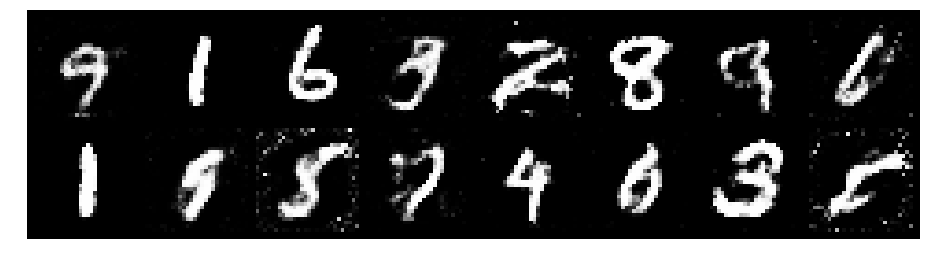

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.3361, Generator Loss: 0.9279
D(x): 0.5334, D(G(z)): 0.4485


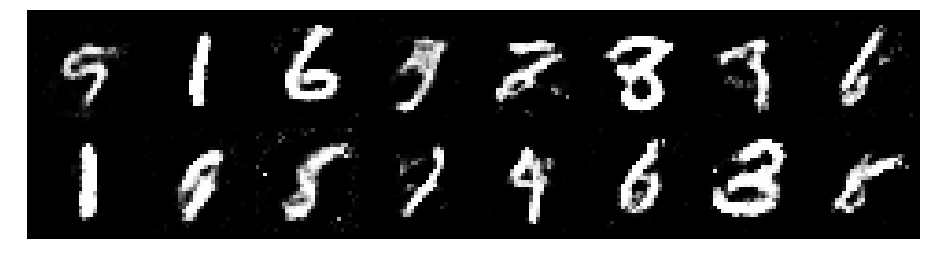

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2282, Generator Loss: 0.9776
D(x): 0.5453, D(G(z)): 0.4217


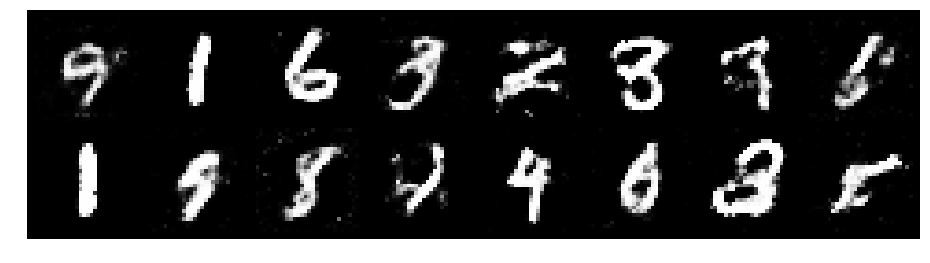

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.3347, Generator Loss: 0.9889
D(x): 0.5157, D(G(z)): 0.4308


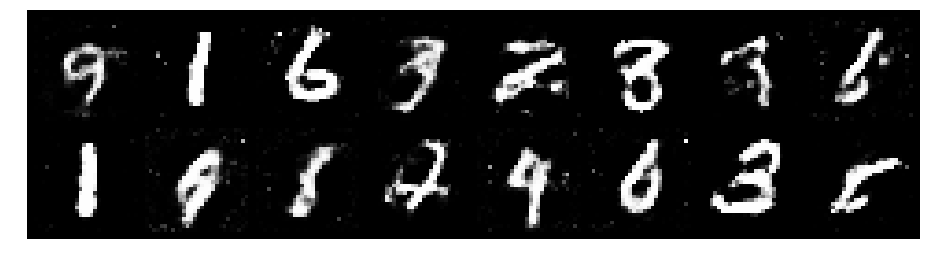

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2117, Generator Loss: 0.9507
D(x): 0.5849, D(G(z)): 0.4267


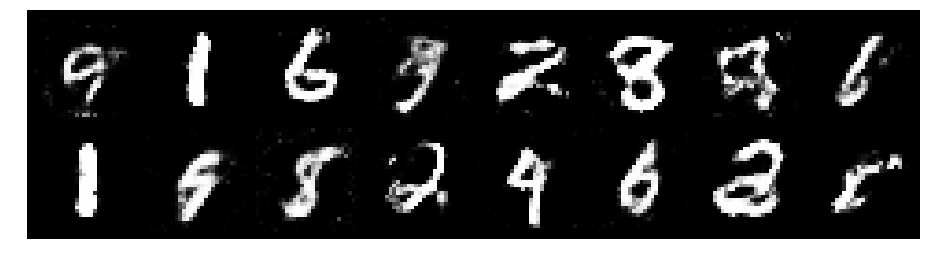

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1966, Generator Loss: 0.9127
D(x): 0.5684, D(G(z)): 0.4214


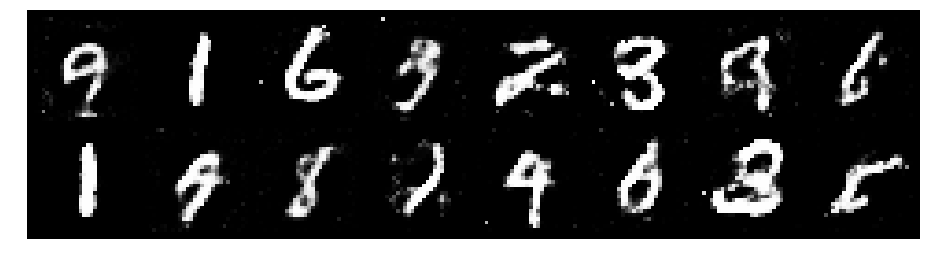

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.3331, Generator Loss: 0.9589
D(x): 0.5446, D(G(z)): 0.4593


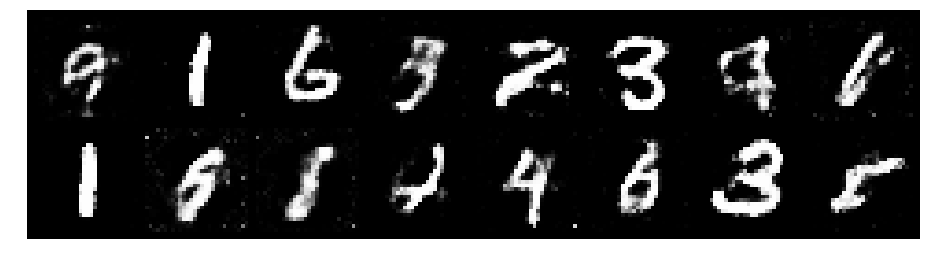

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2786, Generator Loss: 0.8979
D(x): 0.5396, D(G(z)): 0.4345


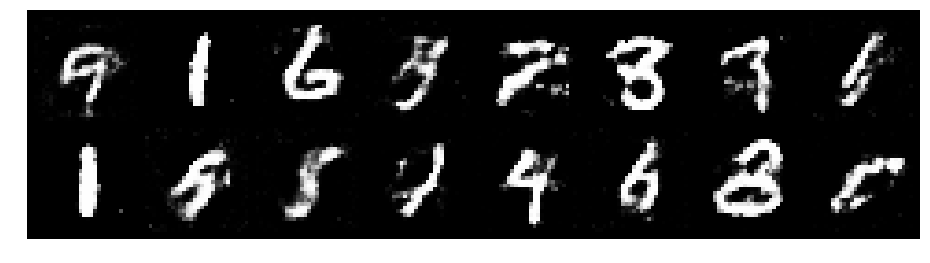

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.3031, Generator Loss: 0.8316
D(x): 0.5379, D(G(z)): 0.4595


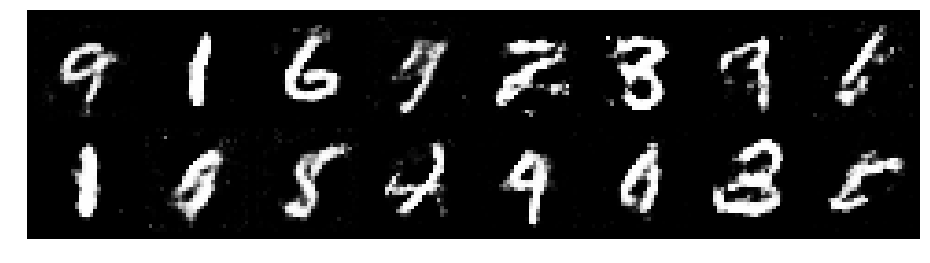

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2170, Generator Loss: 0.9986
D(x): 0.5697, D(G(z)): 0.4364


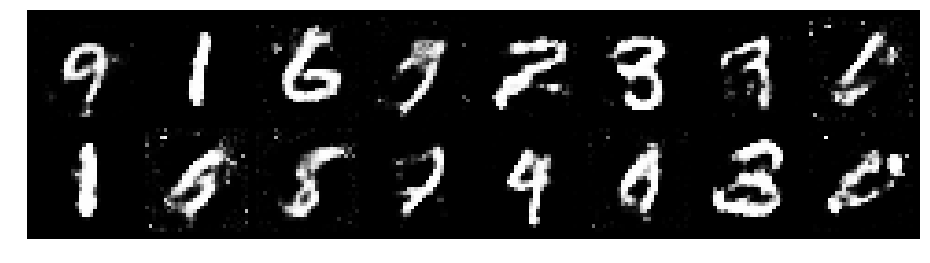

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2601, Generator Loss: 0.8205
D(x): 0.5722, D(G(z)): 0.4342


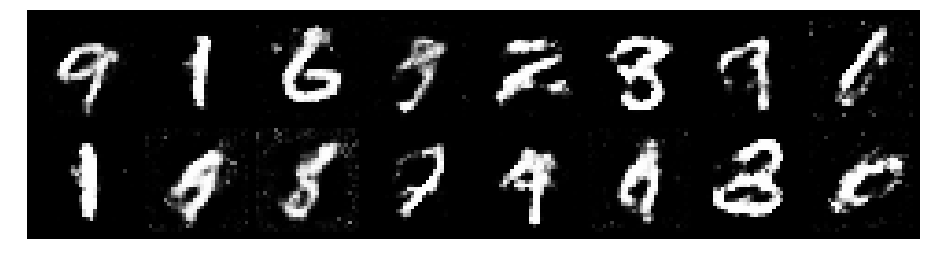

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.3555, Generator Loss: 0.8004
D(x): 0.5175, D(G(z)): 0.4756


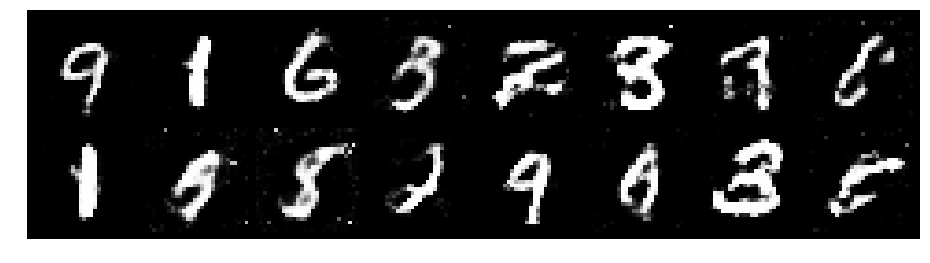

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3624, Generator Loss: 0.9706
D(x): 0.5678, D(G(z)): 0.4623


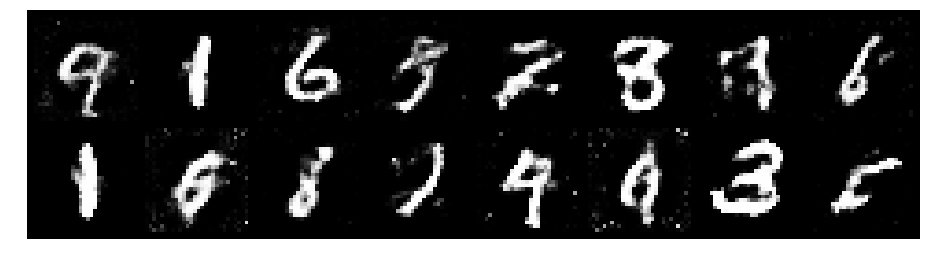

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.3219, Generator Loss: 0.8400
D(x): 0.5460, D(G(z)): 0.4756


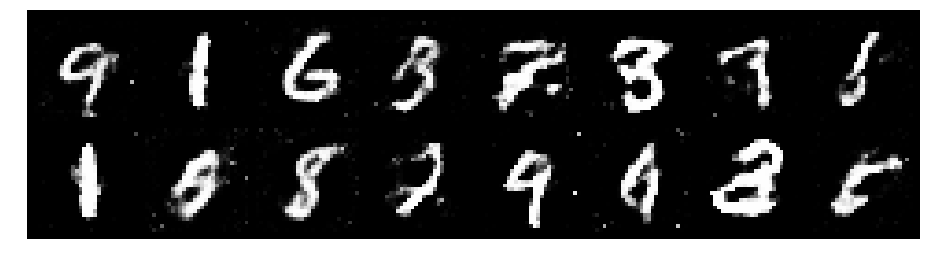

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2782, Generator Loss: 1.0789
D(x): 0.5459, D(G(z)): 0.4355


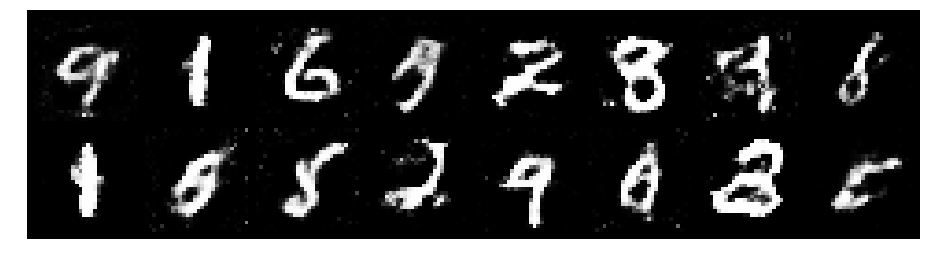

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2557, Generator Loss: 0.9230
D(x): 0.5673, D(G(z)): 0.4559


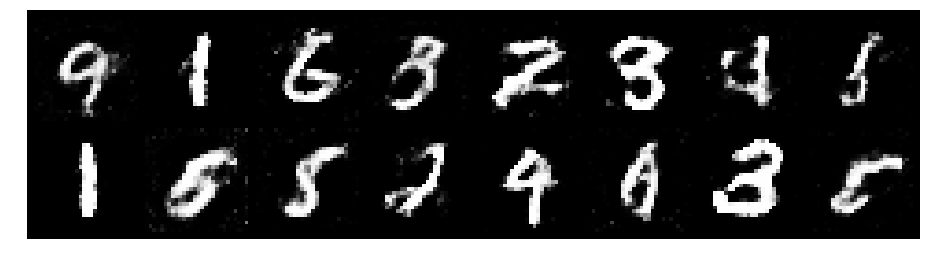

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.3065, Generator Loss: 1.0782
D(x): 0.5476, D(G(z)): 0.4254


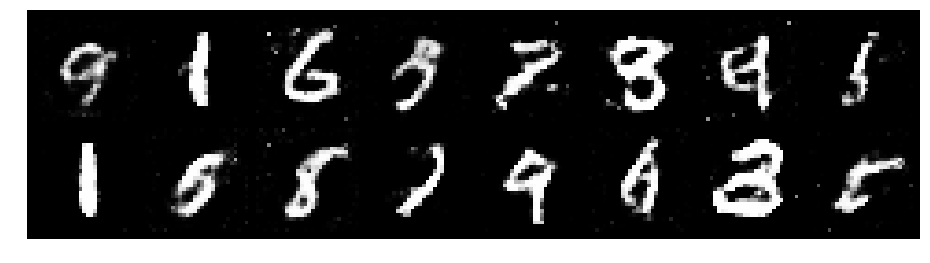

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2729, Generator Loss: 0.8758
D(x): 0.5502, D(G(z)): 0.4364


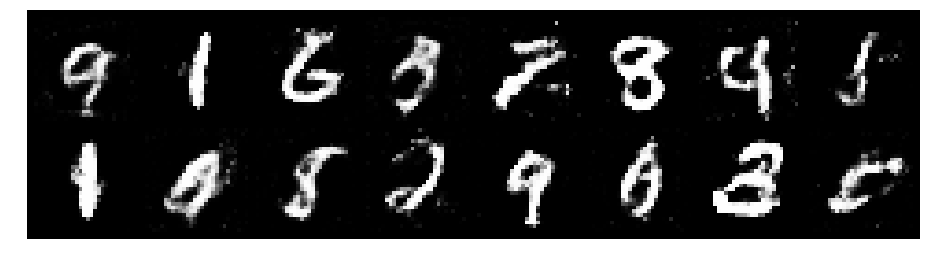

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2512, Generator Loss: 0.8408
D(x): 0.5714, D(G(z)): 0.4728


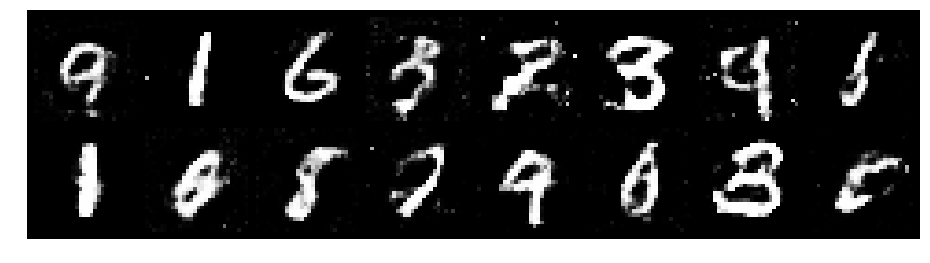

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2686, Generator Loss: 0.8162
D(x): 0.5349, D(G(z)): 0.4454


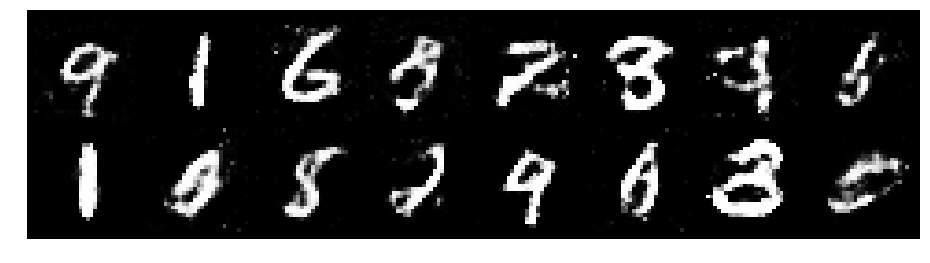

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2302, Generator Loss: 0.7737
D(x): 0.5931, D(G(z)): 0.4729


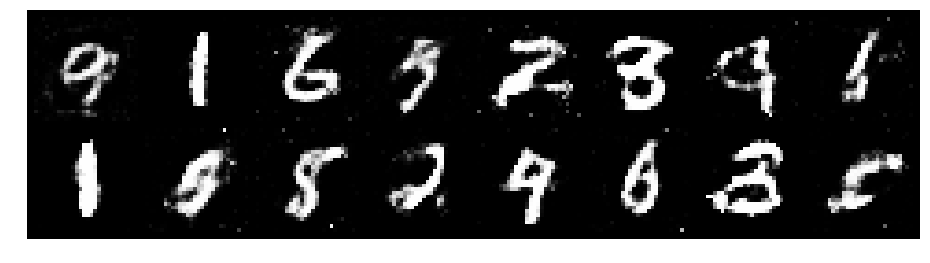

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.1632, Generator Loss: 0.9545
D(x): 0.5608, D(G(z)): 0.3849


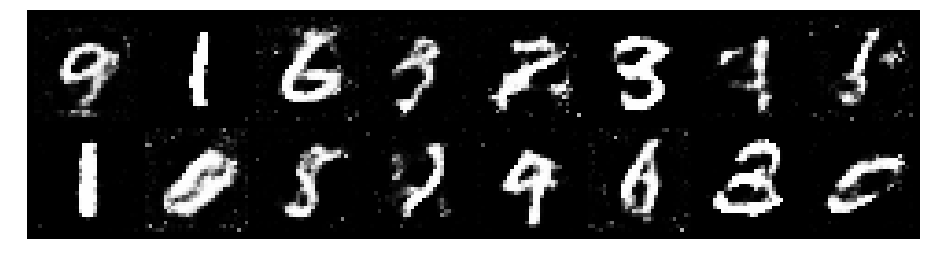

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.3159, Generator Loss: 0.8060
D(x): 0.5429, D(G(z)): 0.4423


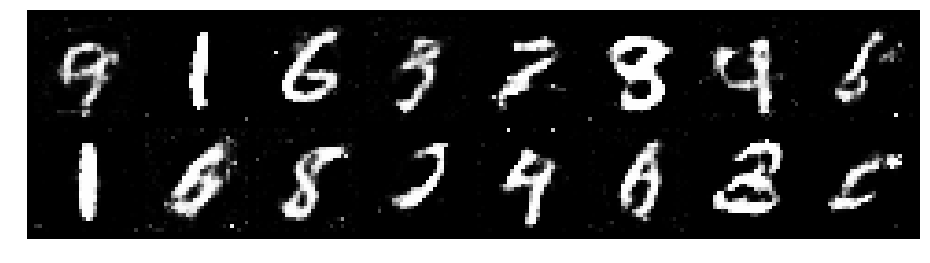

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.3364, Generator Loss: 0.9213
D(x): 0.5415, D(G(z)): 0.4669


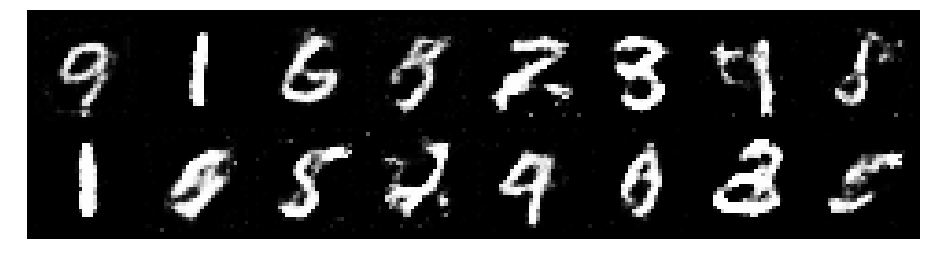

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2031, Generator Loss: 0.8473
D(x): 0.5990, D(G(z)): 0.4562


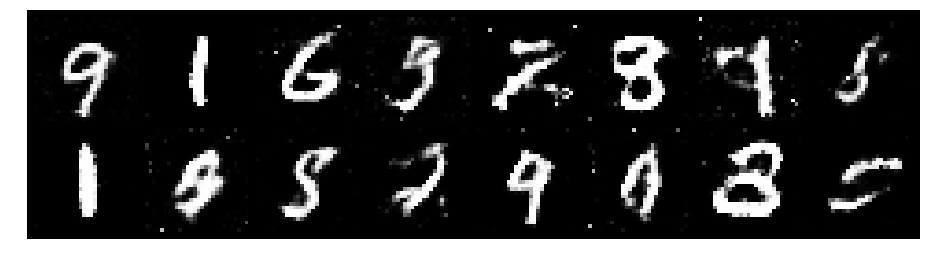

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.1861, Generator Loss: 0.9381
D(x): 0.5677, D(G(z)): 0.4199


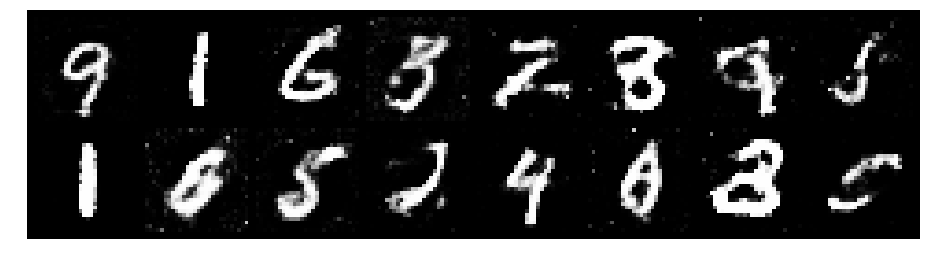

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2123, Generator Loss: 0.8507
D(x): 0.5891, D(G(z)): 0.4646


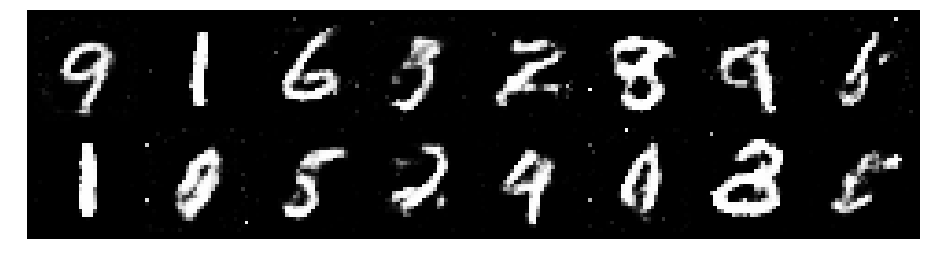

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2936, Generator Loss: 0.8723
D(x): 0.5509, D(G(z)): 0.4409


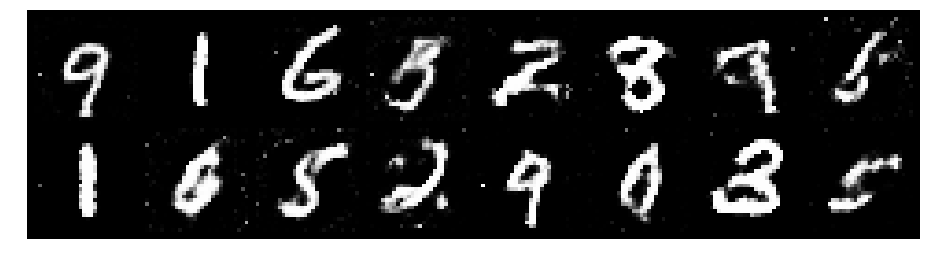

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3564, Generator Loss: 0.8989
D(x): 0.5639, D(G(z)): 0.4920


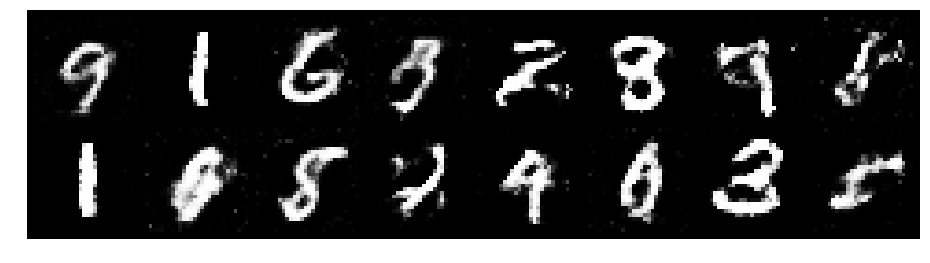

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2103, Generator Loss: 0.8236
D(x): 0.5890, D(G(z)): 0.4383


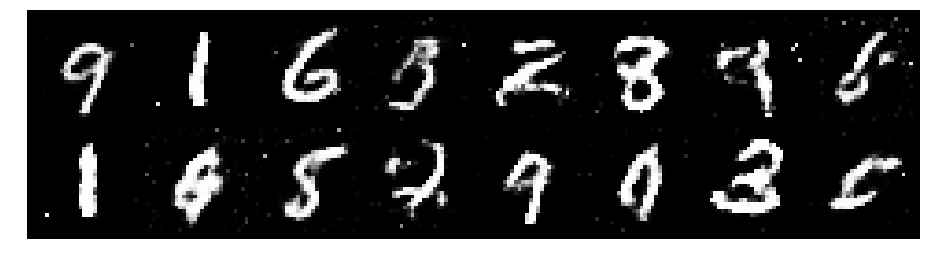

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2300, Generator Loss: 1.0254
D(x): 0.5332, D(G(z)): 0.4137


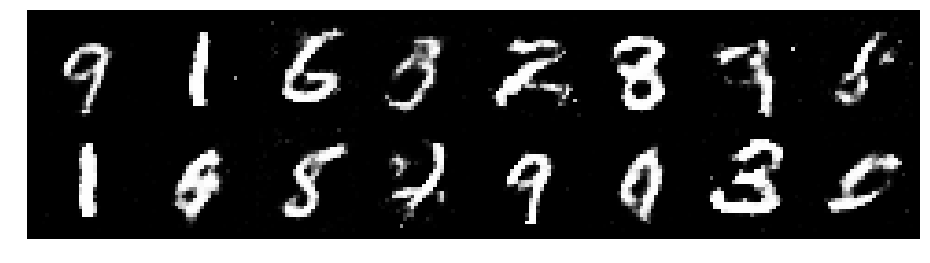

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2907, Generator Loss: 0.8795
D(x): 0.5582, D(G(z)): 0.4563


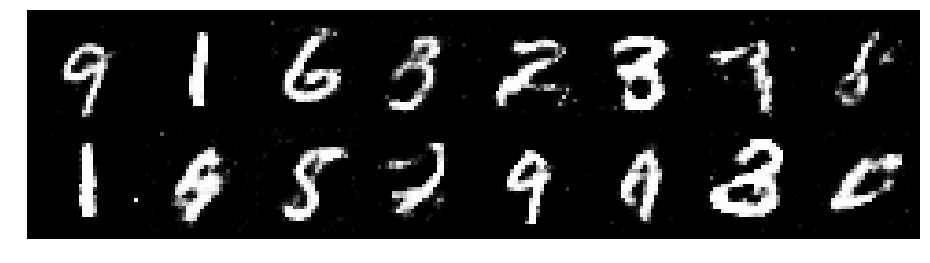

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3692, Generator Loss: 0.8608
D(x): 0.5142, D(G(z)): 0.4474


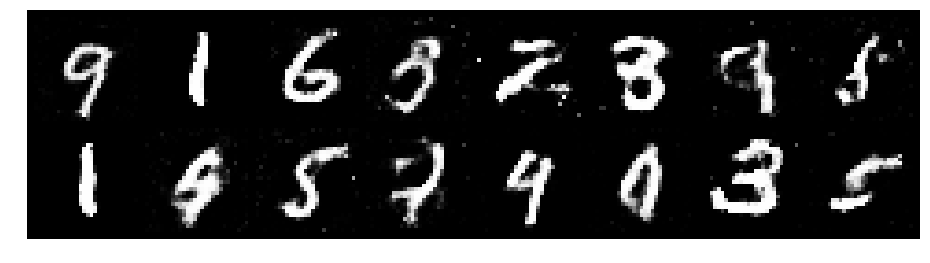

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2662, Generator Loss: 0.8341
D(x): 0.5785, D(G(z)): 0.4799


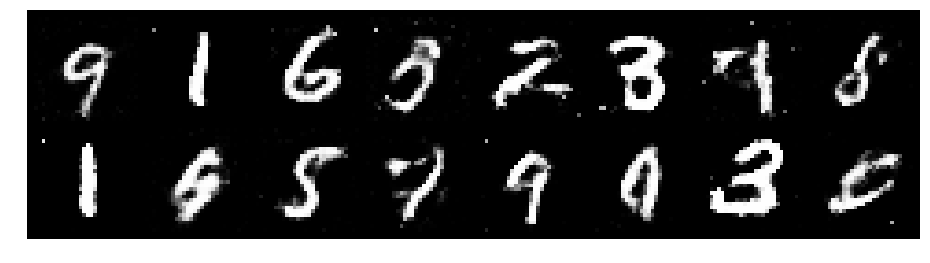

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.2454, Generator Loss: 0.8142
D(x): 0.5815, D(G(z)): 0.4702


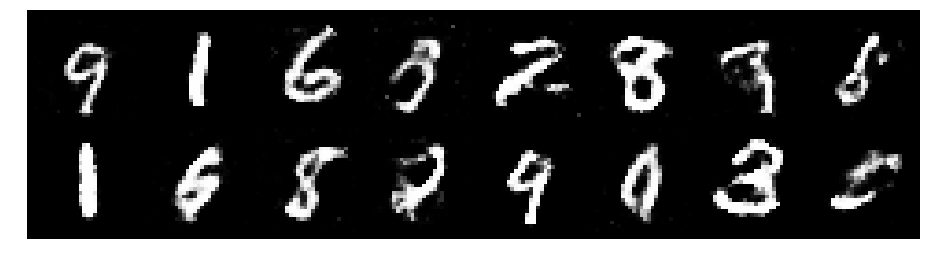

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2972, Generator Loss: 0.8804
D(x): 0.5462, D(G(z)): 0.4556


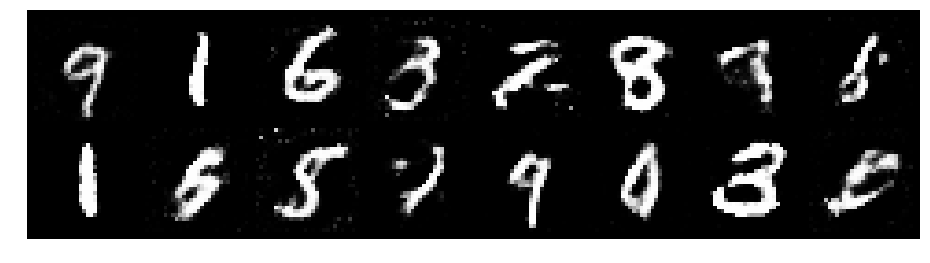

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2425, Generator Loss: 1.1027
D(x): 0.5051, D(G(z)): 0.3784


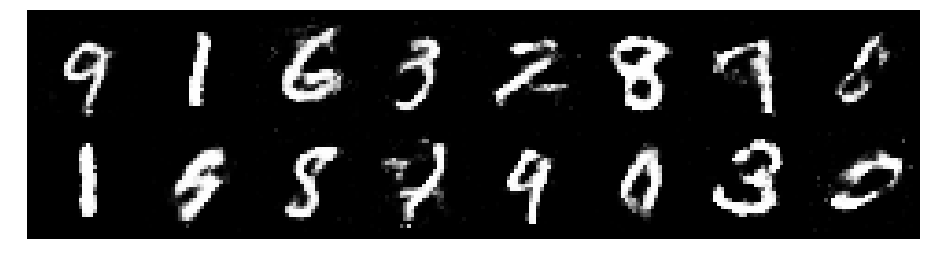

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2419, Generator Loss: 0.8784
D(x): 0.5683, D(G(z)): 0.4546


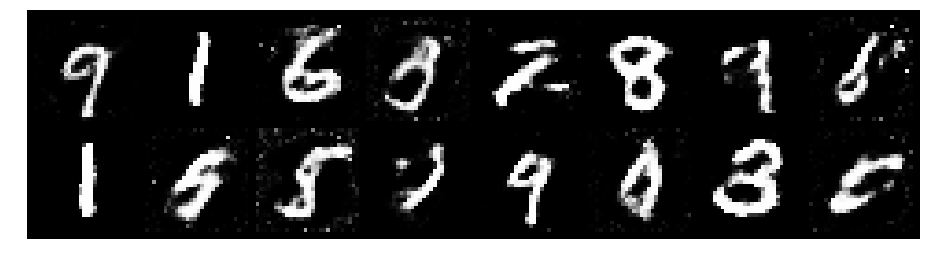

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.3252, Generator Loss: 0.7571
D(x): 0.5891, D(G(z)): 0.4968


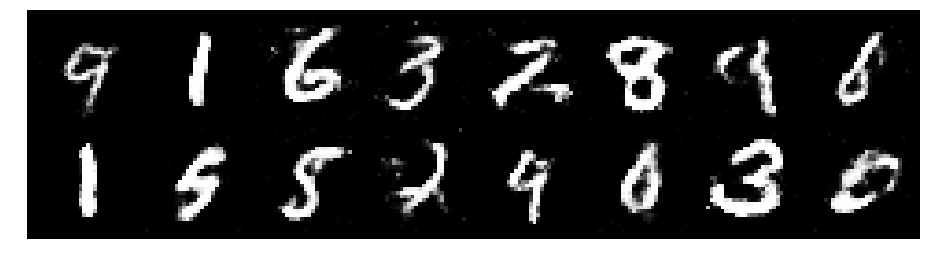

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.3683, Generator Loss: 0.8230
D(x): 0.5291, D(G(z)): 0.4654


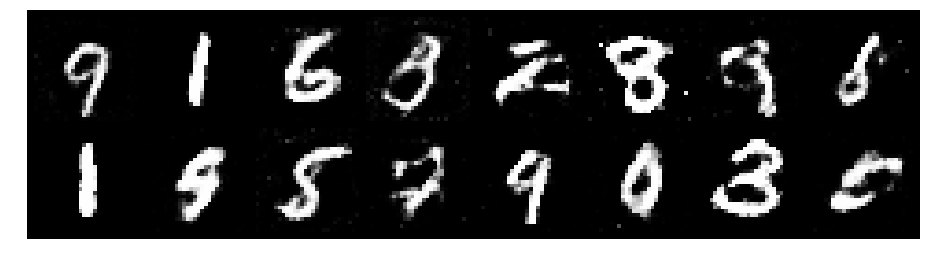

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3192, Generator Loss: 0.8090
D(x): 0.5570, D(G(z)): 0.4670


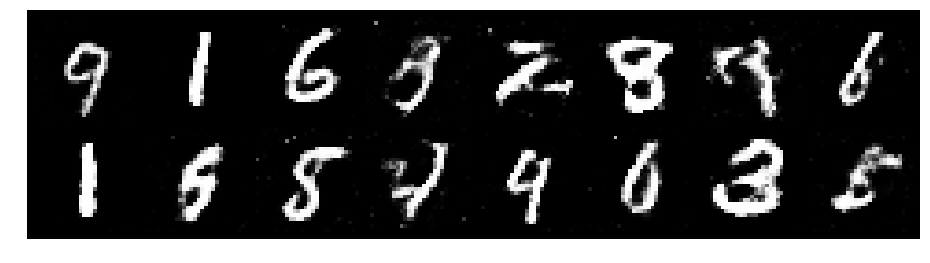

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3578, Generator Loss: 0.8393
D(x): 0.5311, D(G(z)): 0.4481


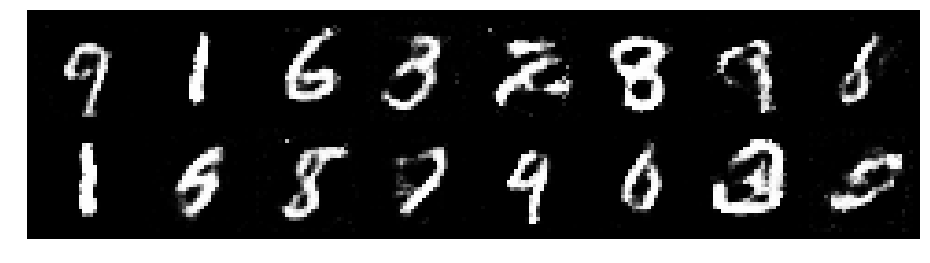

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2212, Generator Loss: 1.0313
D(x): 0.5817, D(G(z)): 0.4422


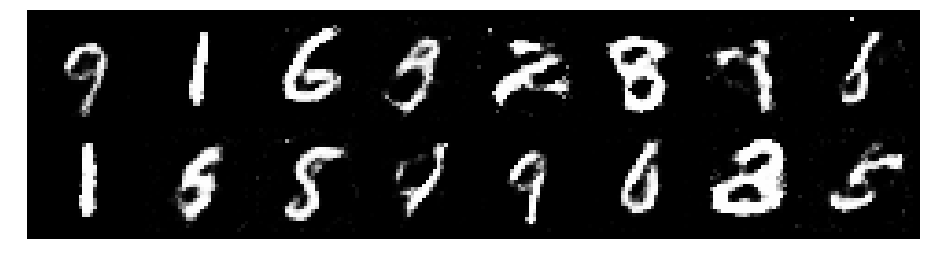

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.2575, Generator Loss: 0.8164
D(x): 0.5557, D(G(z)): 0.4540


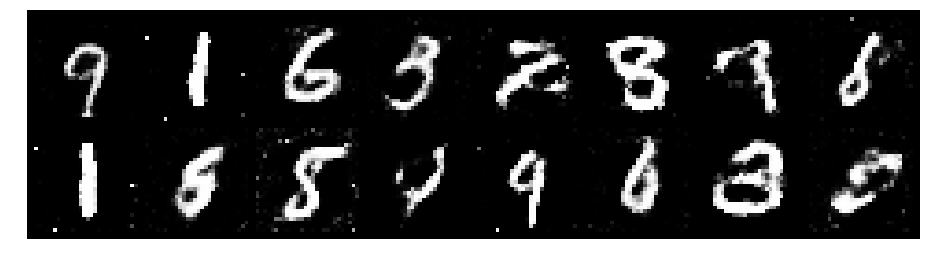

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.3014, Generator Loss: 0.8228
D(x): 0.5347, D(G(z)): 0.4476


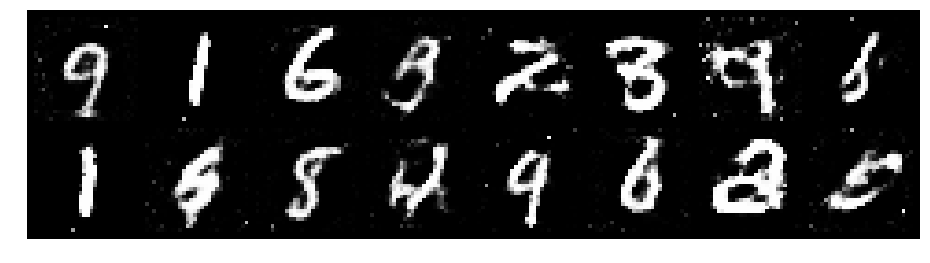

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2427, Generator Loss: 0.8493
D(x): 0.5575, D(G(z)): 0.4411


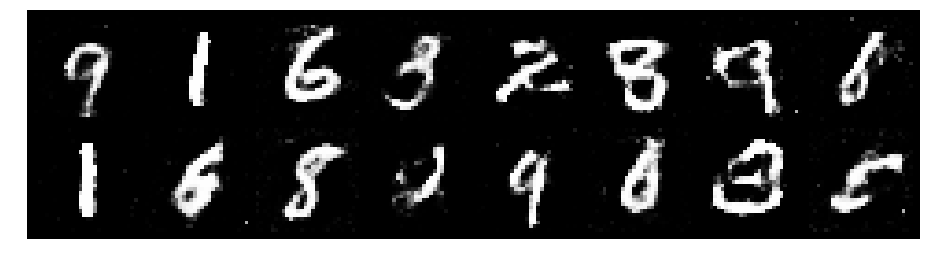

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.3849, Generator Loss: 0.8927
D(x): 0.5108, D(G(z)): 0.4571


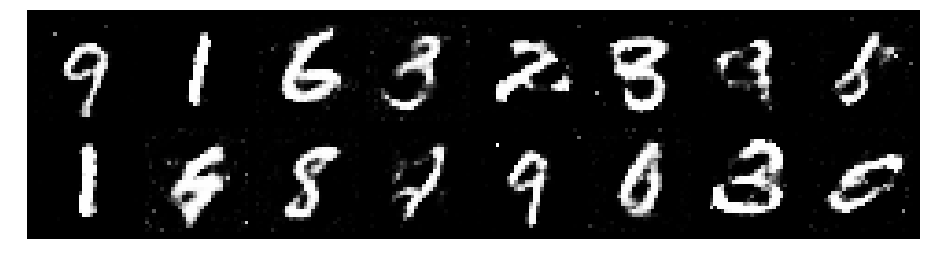

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.3626, Generator Loss: 0.8499
D(x): 0.5353, D(G(z)): 0.4914


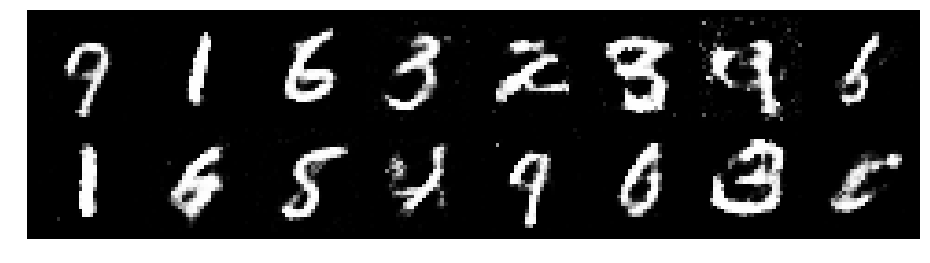

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.3636, Generator Loss: 0.8462
D(x): 0.5558, D(G(z)): 0.4905


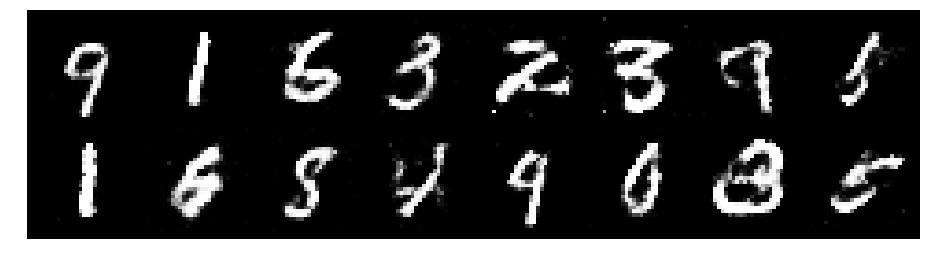

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.3862, Generator Loss: 0.6745
D(x): 0.5469, D(G(z)): 0.5104


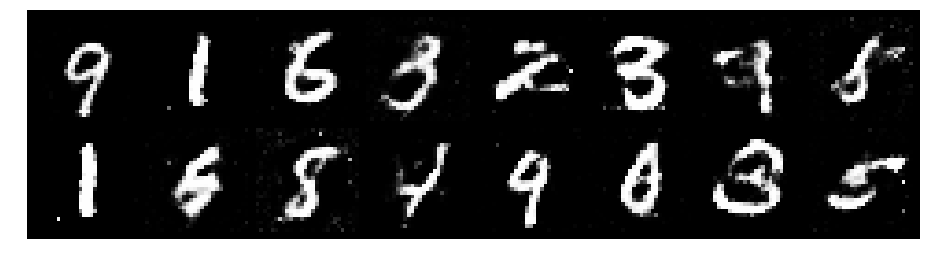

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.3283, Generator Loss: 0.8561
D(x): 0.5909, D(G(z)): 0.5008


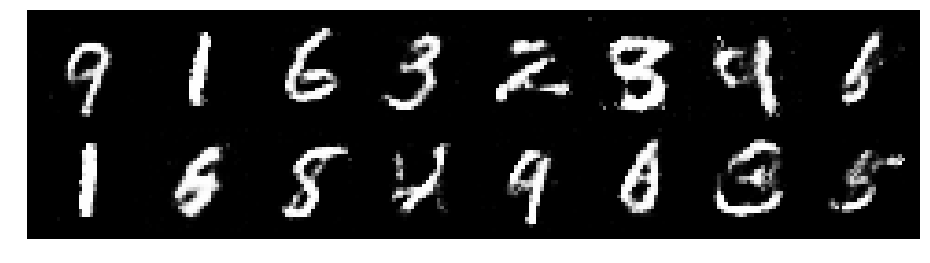

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2473, Generator Loss: 0.8334
D(x): 0.5451, D(G(z)): 0.4371


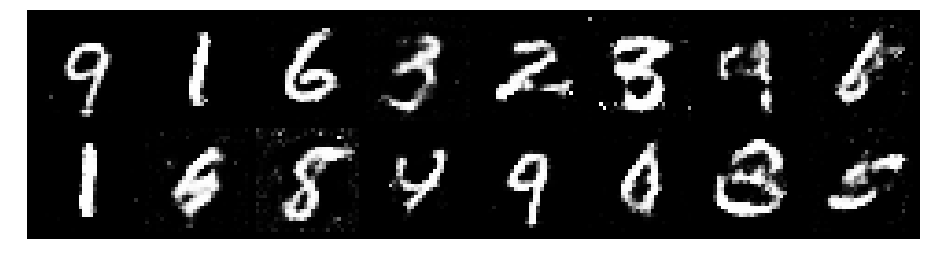

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.3081, Generator Loss: 0.8852
D(x): 0.5529, D(G(z)): 0.4632


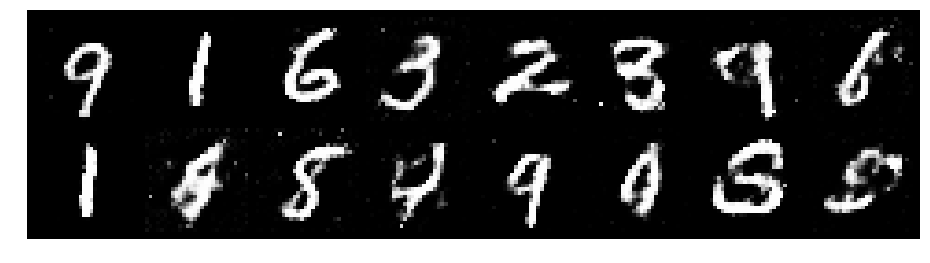

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2783, Generator Loss: 0.9723
D(x): 0.5318, D(G(z)): 0.4118


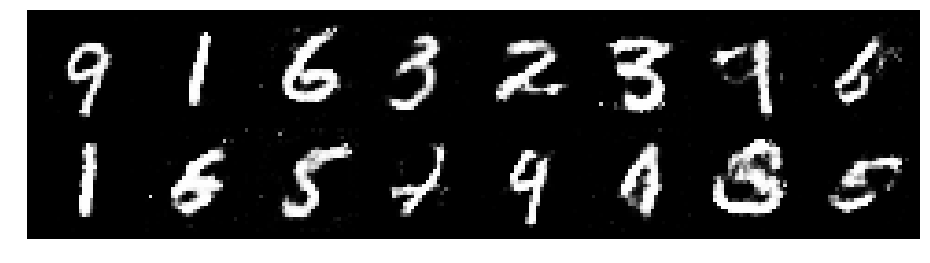

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2925, Generator Loss: 0.9194
D(x): 0.5620, D(G(z)): 0.4437


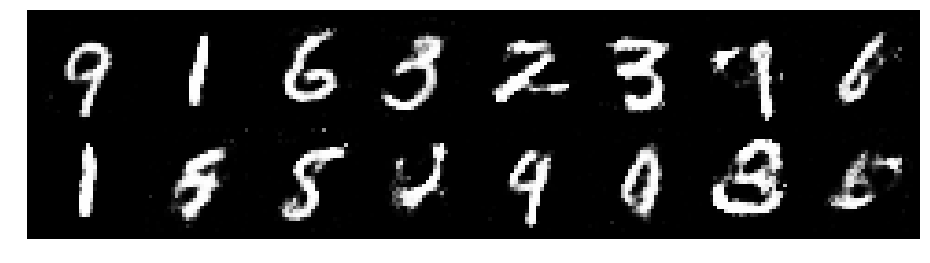

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3104, Generator Loss: 0.8414
D(x): 0.5115, D(G(z)): 0.4352


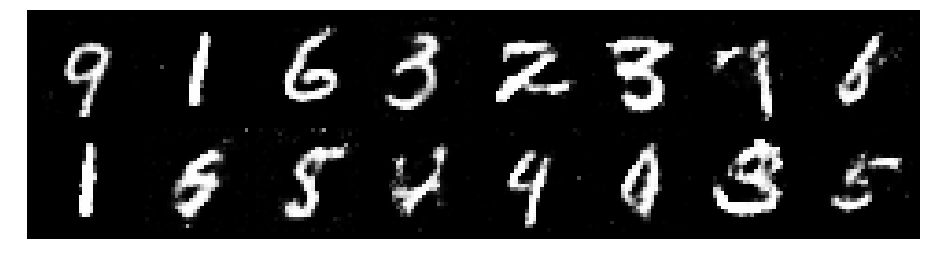

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3150, Generator Loss: 0.8019
D(x): 0.5410, D(G(z)): 0.4451


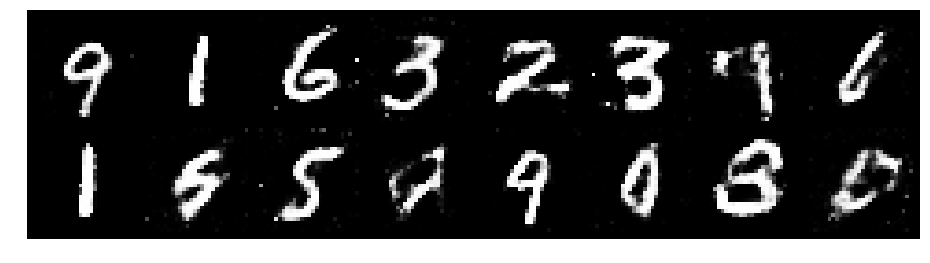

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.3481, Generator Loss: 0.8036
D(x): 0.6083, D(G(z)): 0.5164


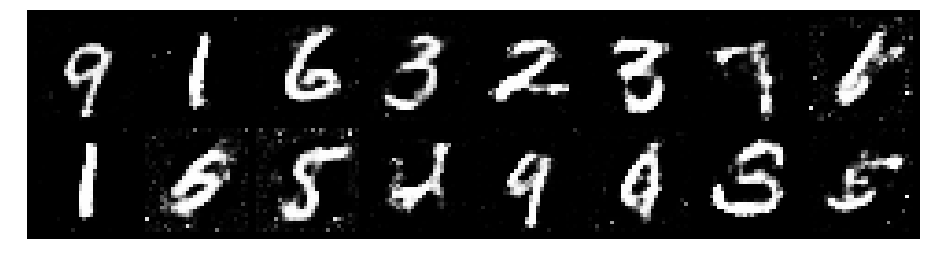

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.3122, Generator Loss: 0.8352
D(x): 0.5426, D(G(z)): 0.4600


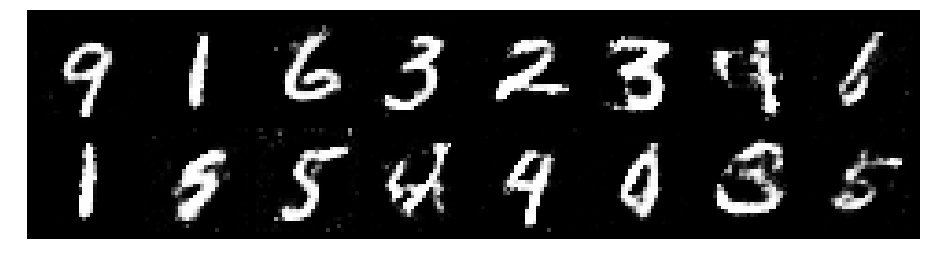

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.3478, Generator Loss: 0.7894
D(x): 0.5348, D(G(z)): 0.4561


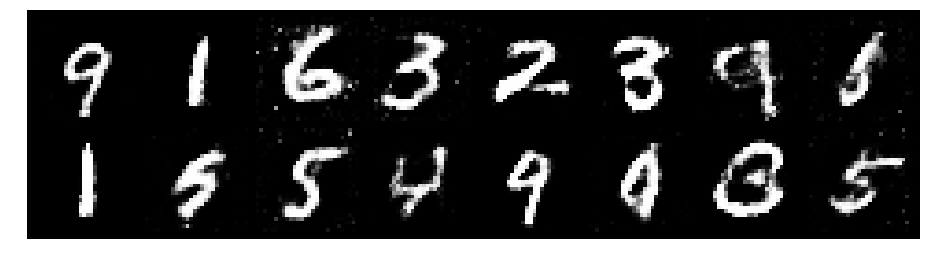

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.3391, Generator Loss: 0.8671
D(x): 0.5326, D(G(z)): 0.4572


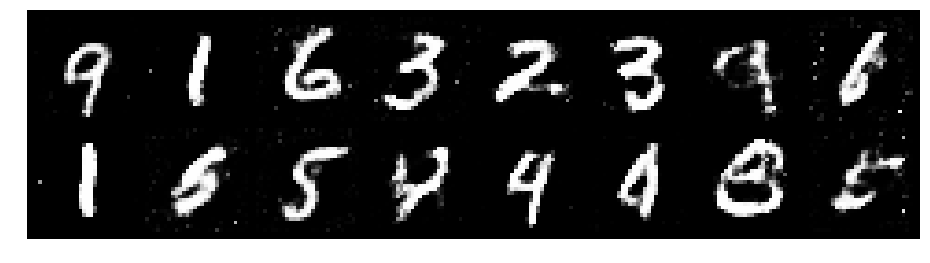

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2392, Generator Loss: 0.9132
D(x): 0.5664, D(G(z)): 0.4281


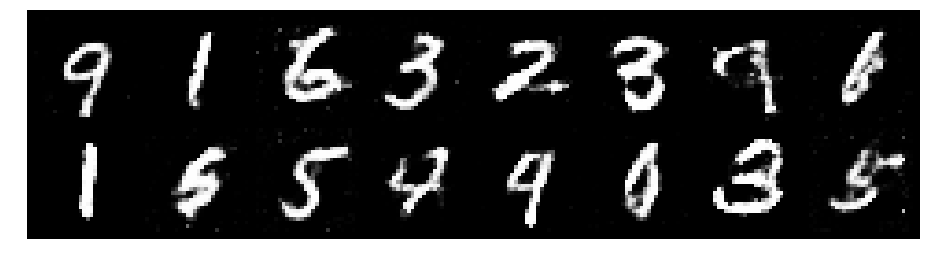

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.1806, Generator Loss: 0.9893
D(x): 0.5639, D(G(z)): 0.4104


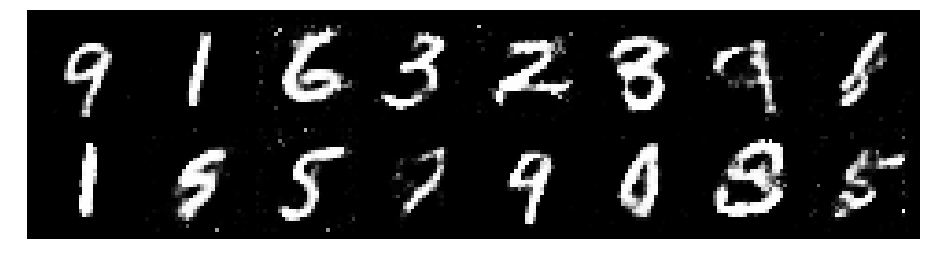

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2440, Generator Loss: 0.8938
D(x): 0.5578, D(G(z)): 0.4393


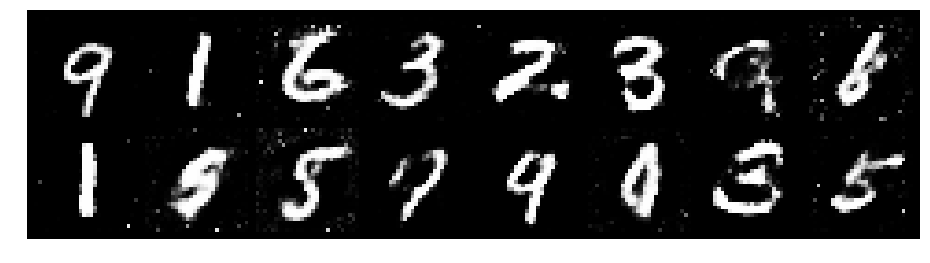

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2761, Generator Loss: 0.9932
D(x): 0.5100, D(G(z)): 0.3921


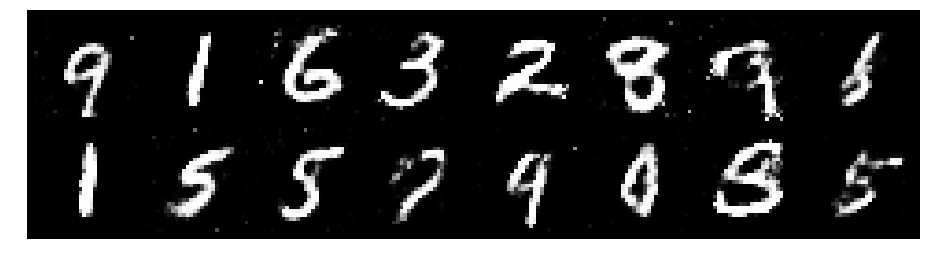

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.3138, Generator Loss: 0.9674
D(x): 0.5405, D(G(z)): 0.4270


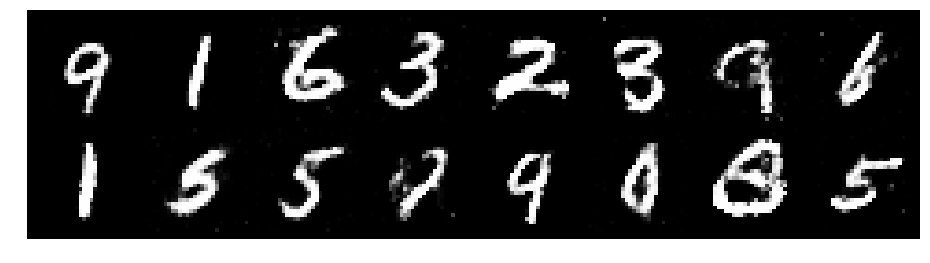

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.3143, Generator Loss: 0.9571
D(x): 0.5466, D(G(z)): 0.4507


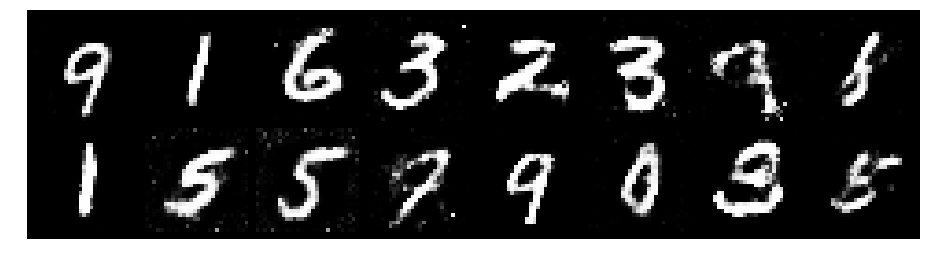

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.1683, Generator Loss: 1.0171
D(x): 0.5843, D(G(z)): 0.3957


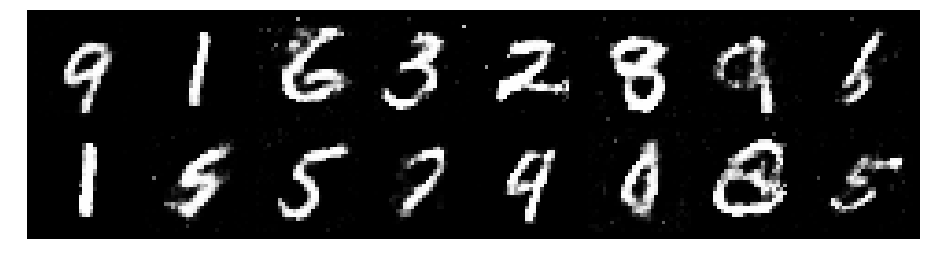

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2266, Generator Loss: 1.0010
D(x): 0.5978, D(G(z)): 0.4496


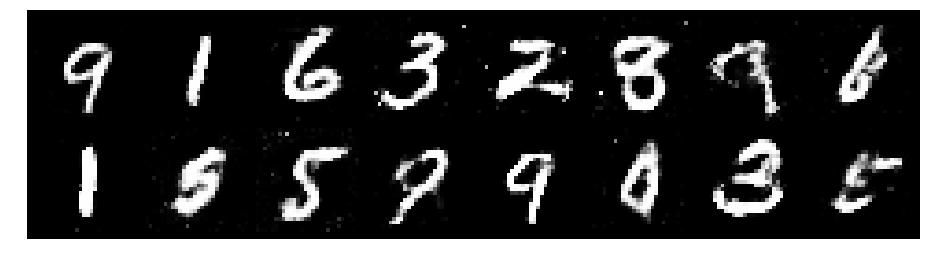

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.2788, Generator Loss: 0.8944
D(x): 0.5446, D(G(z)): 0.4420


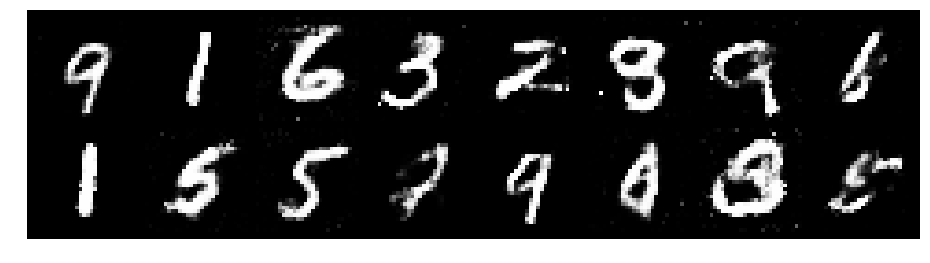

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.3067, Generator Loss: 0.9208
D(x): 0.5646, D(G(z)): 0.4521


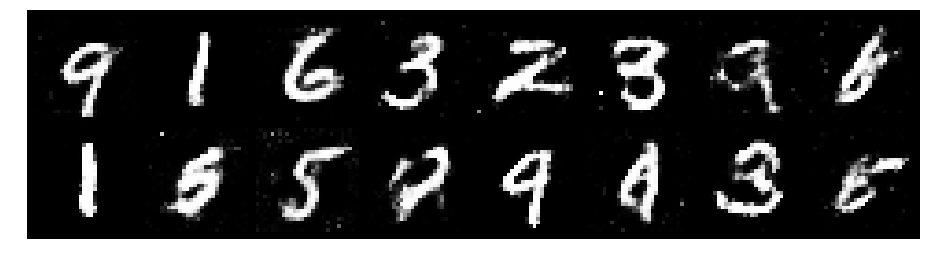

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2647, Generator Loss: 0.9838
D(x): 0.5336, D(G(z)): 0.4089


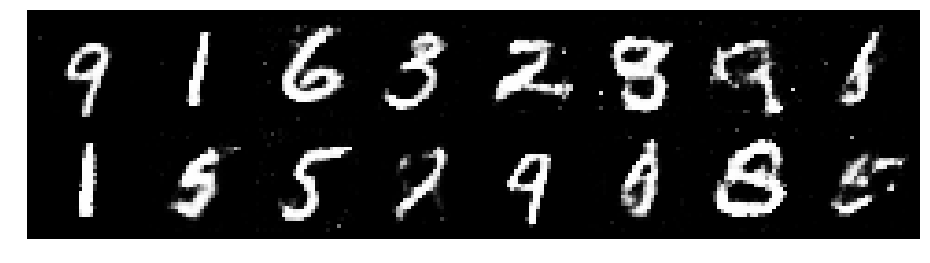

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.1783, Generator Loss: 1.0755
D(x): 0.5645, D(G(z)): 0.3940


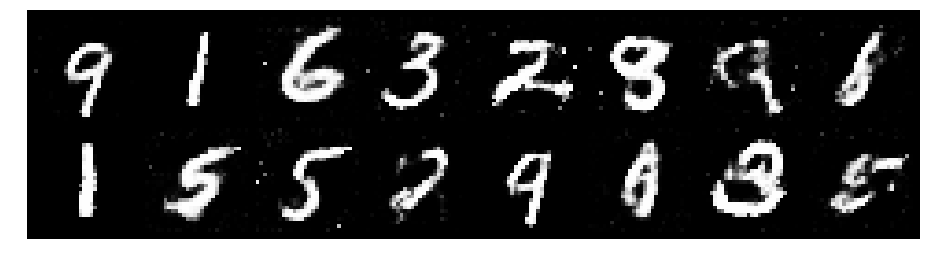

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2400, Generator Loss: 0.8948
D(x): 0.5766, D(G(z)): 0.4412


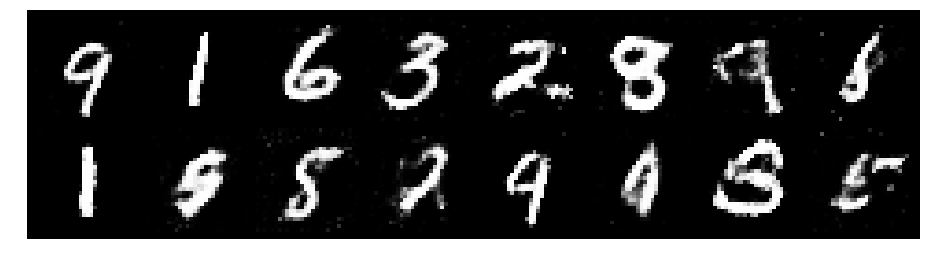

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.1937, Generator Loss: 1.0018
D(x): 0.5340, D(G(z)): 0.3797


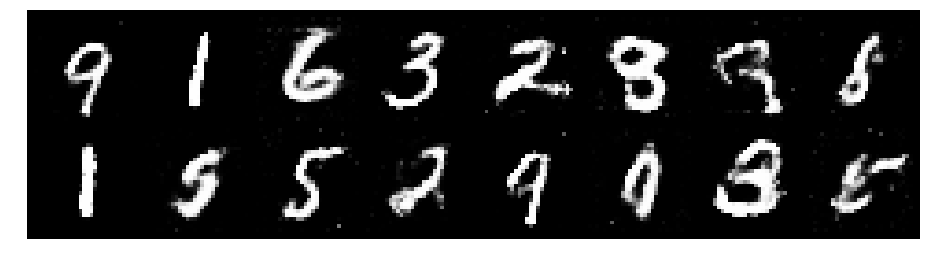

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2926, Generator Loss: 1.0198
D(x): 0.5294, D(G(z)): 0.4073


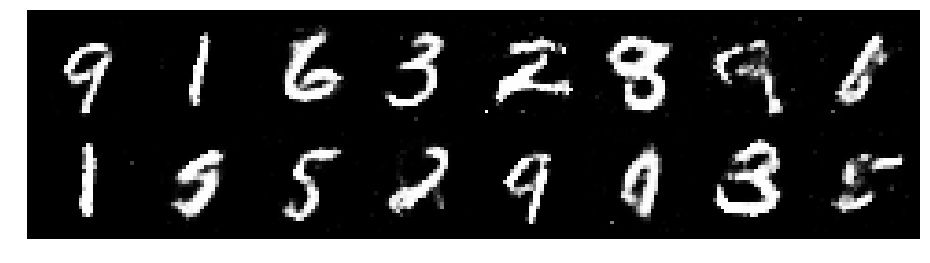

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3953, Generator Loss: 0.7873
D(x): 0.5863, D(G(z)): 0.5192


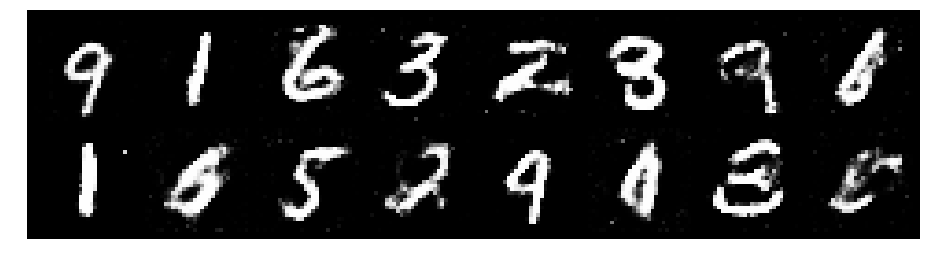

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2403, Generator Loss: 0.9780
D(x): 0.5363, D(G(z)): 0.3974


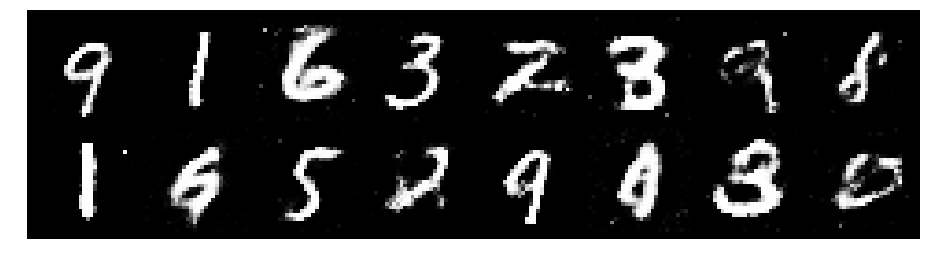

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.3078, Generator Loss: 0.9823
D(x): 0.5291, D(G(z)): 0.4353


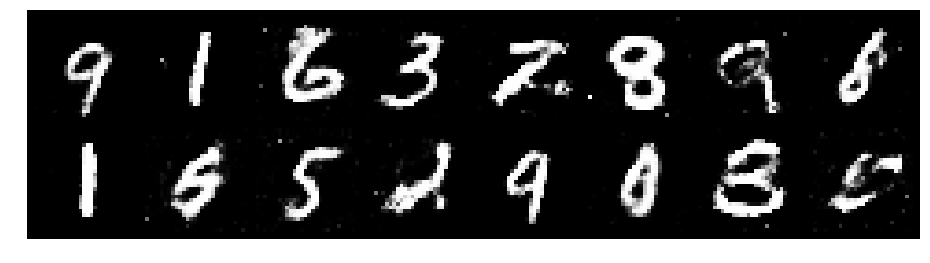

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.3811, Generator Loss: 0.8311
D(x): 0.5220, D(G(z)): 0.4652


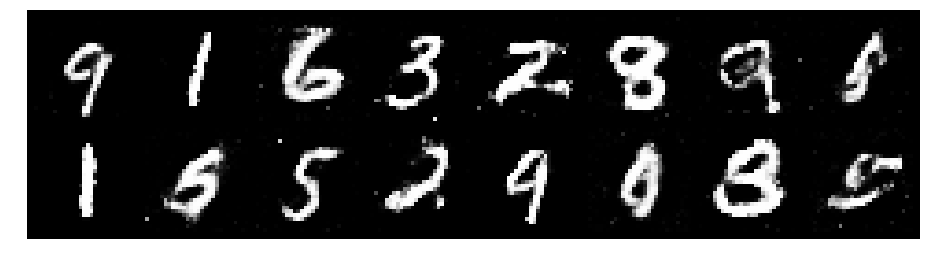

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.3560, Generator Loss: 0.8068
D(x): 0.5219, D(G(z)): 0.4534


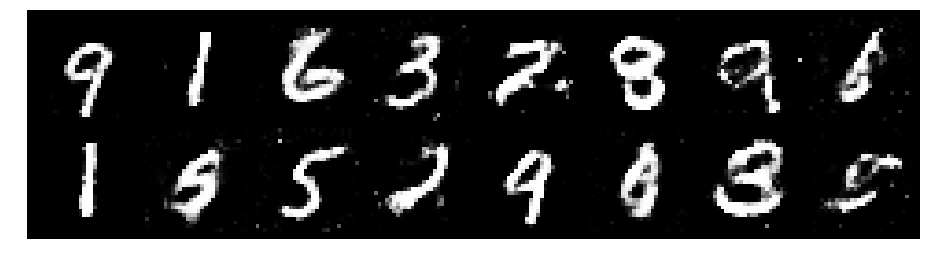

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3335, Generator Loss: 0.7824
D(x): 0.5430, D(G(z)): 0.4754


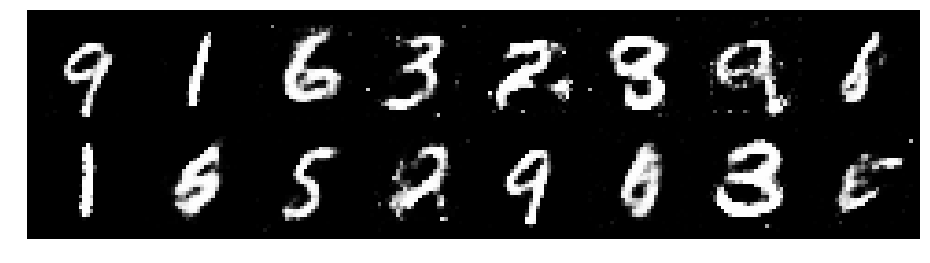

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.3529, Generator Loss: 0.8065
D(x): 0.5219, D(G(z)): 0.4705


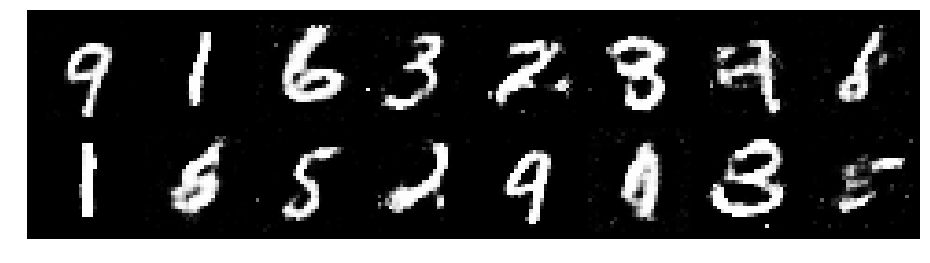

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.3574, Generator Loss: 0.8878
D(x): 0.5397, D(G(z)): 0.4620


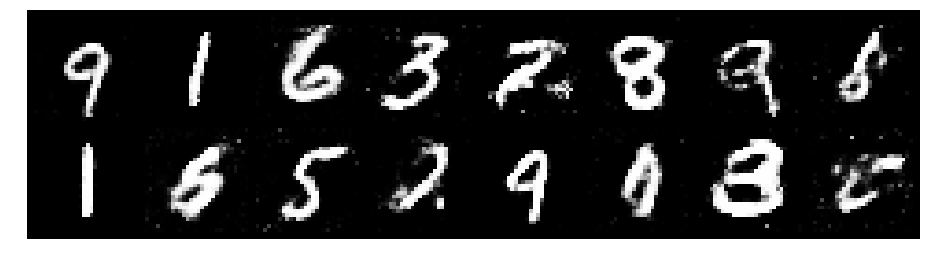

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.3500, Generator Loss: 0.9554
D(x): 0.5209, D(G(z)): 0.4371


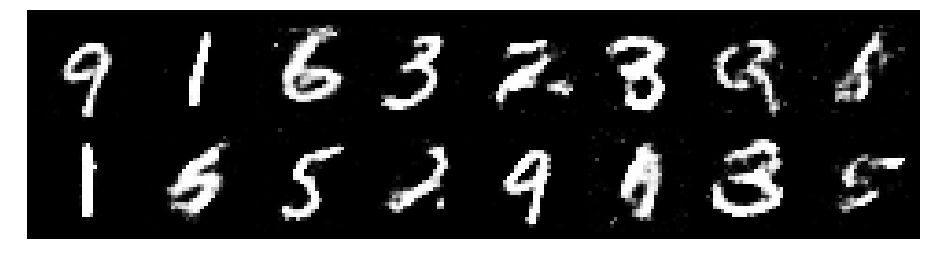

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.3255, Generator Loss: 0.8515
D(x): 0.5527, D(G(z)): 0.4652


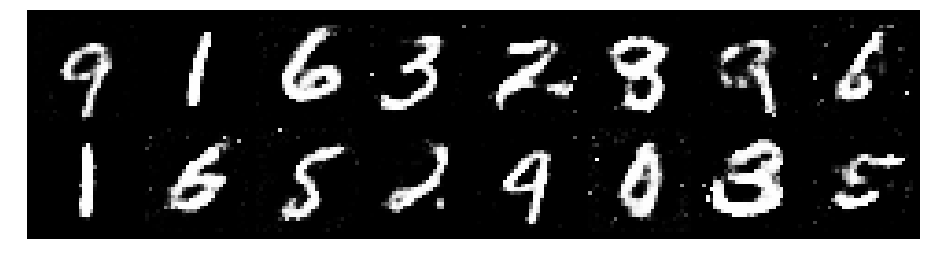

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2219, Generator Loss: 1.0174
D(x): 0.5232, D(G(z)): 0.3647


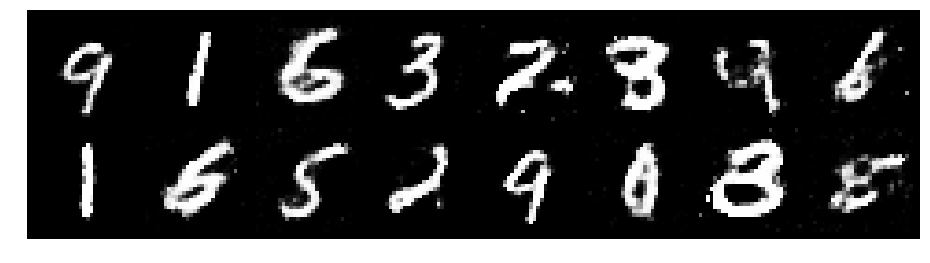

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.2695, Generator Loss: 0.8774
D(x): 0.5415, D(G(z)): 0.4303


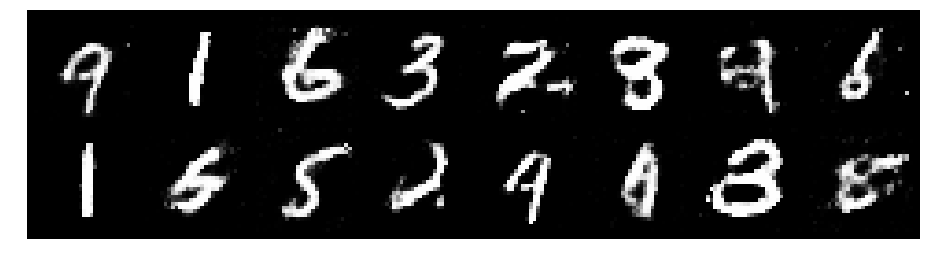

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3418, Generator Loss: 0.9419
D(x): 0.5275, D(G(z)): 0.4593


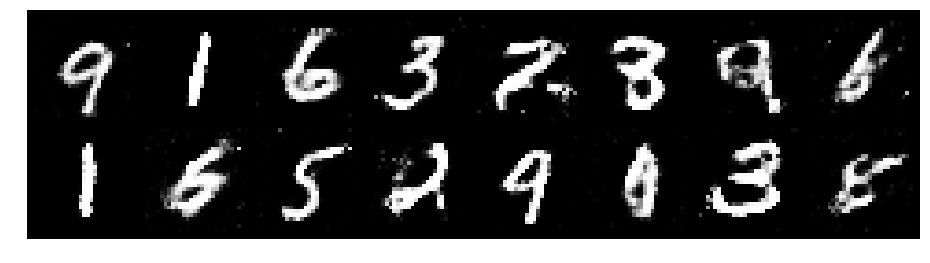

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.3381, Generator Loss: 0.8870
D(x): 0.5458, D(G(z)): 0.4578


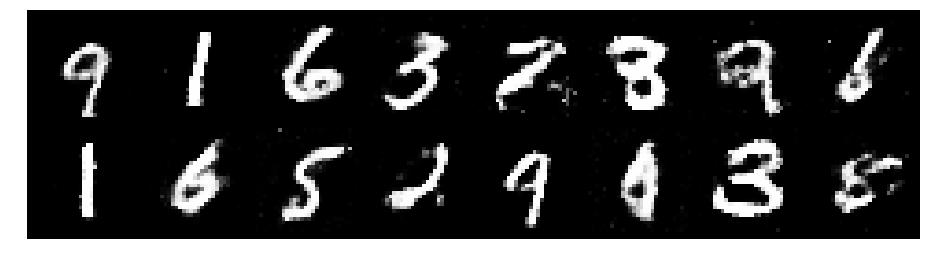

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.2214, Generator Loss: 0.9057
D(x): 0.5899, D(G(z)): 0.4448


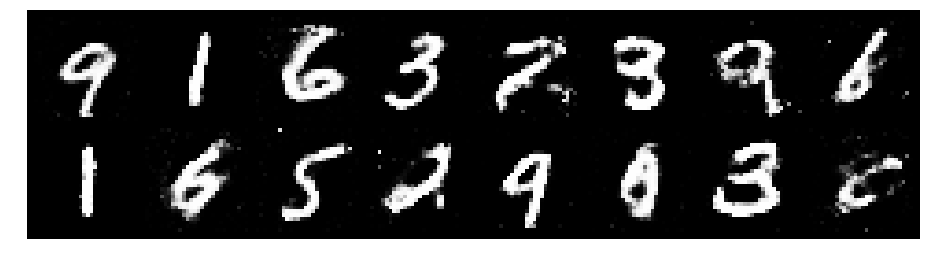

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.3194, Generator Loss: 0.9031
D(x): 0.5566, D(G(z)): 0.4627


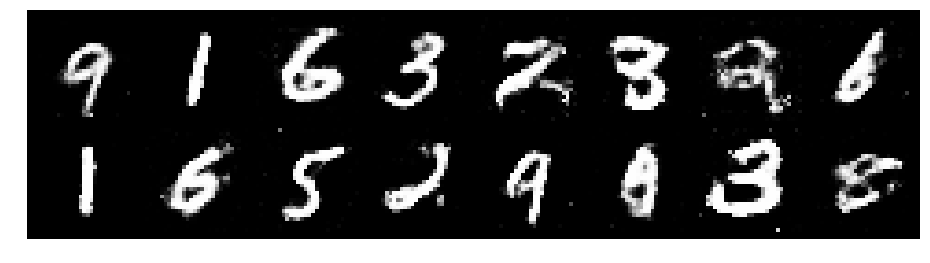

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.2994, Generator Loss: 0.9301
D(x): 0.5684, D(G(z)): 0.4563


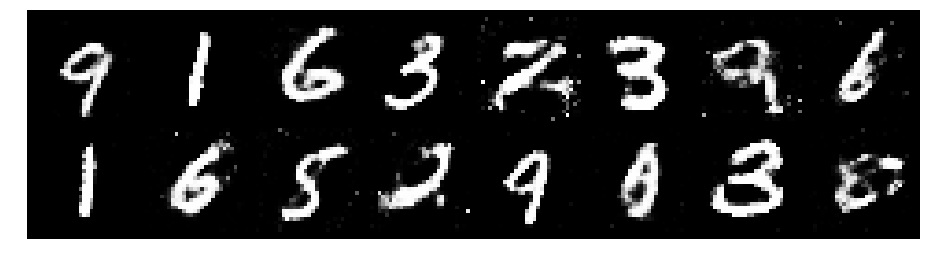

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2680, Generator Loss: 0.8860
D(x): 0.5833, D(G(z)): 0.4754


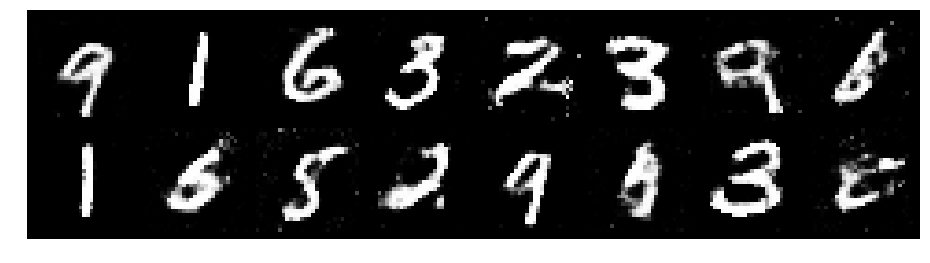

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2709, Generator Loss: 0.8730
D(x): 0.5515, D(G(z)): 0.4306


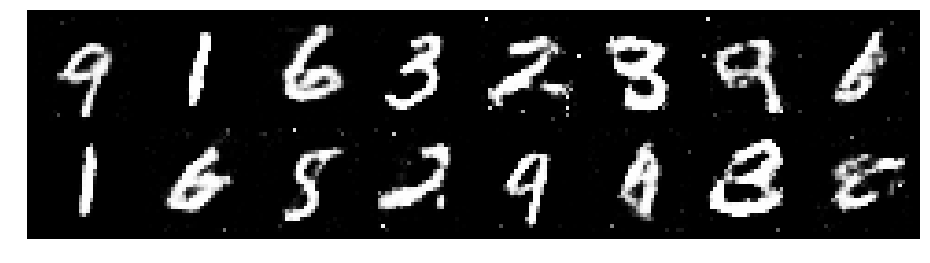

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2733, Generator Loss: 0.9286
D(x): 0.5261, D(G(z)): 0.4340


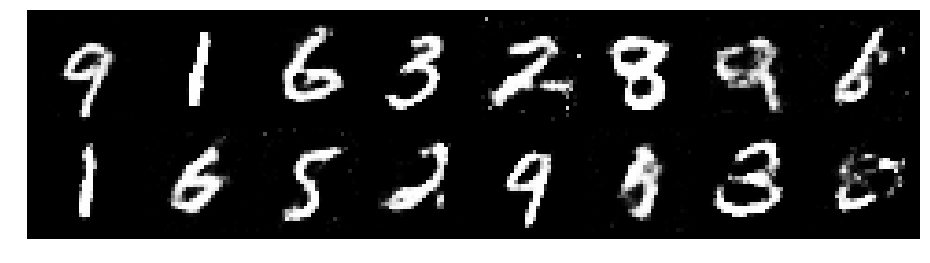

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.1871, Generator Loss: 0.8443
D(x): 0.5892, D(G(z)): 0.4418


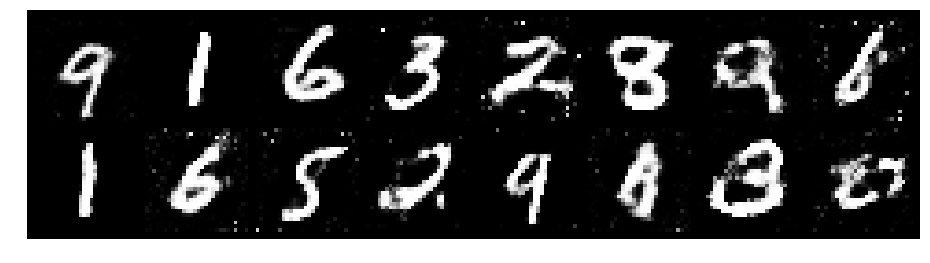

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2422, Generator Loss: 0.7945
D(x): 0.5445, D(G(z)): 0.4269


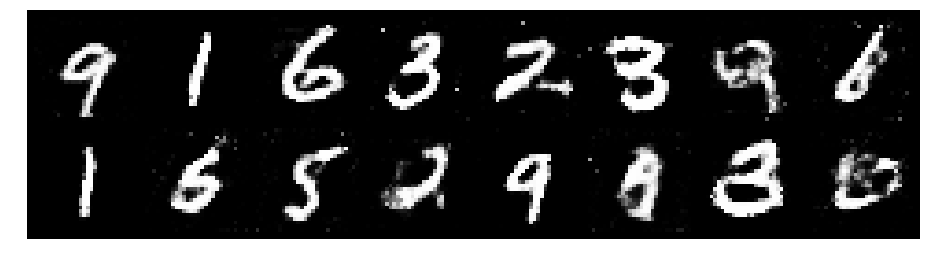

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2006, Generator Loss: 0.9638
D(x): 0.6049, D(G(z)): 0.4500


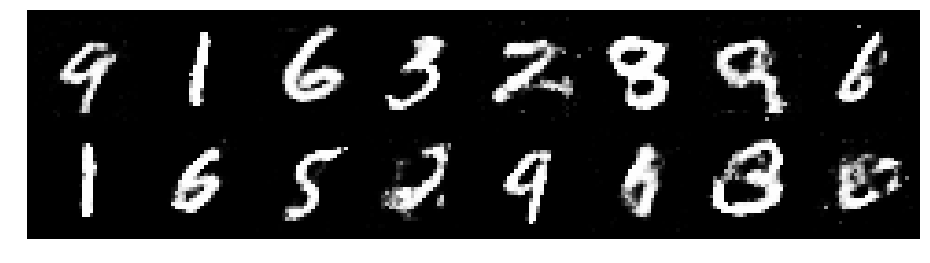

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.1571, Generator Loss: 0.9727
D(x): 0.5983, D(G(z)): 0.4313


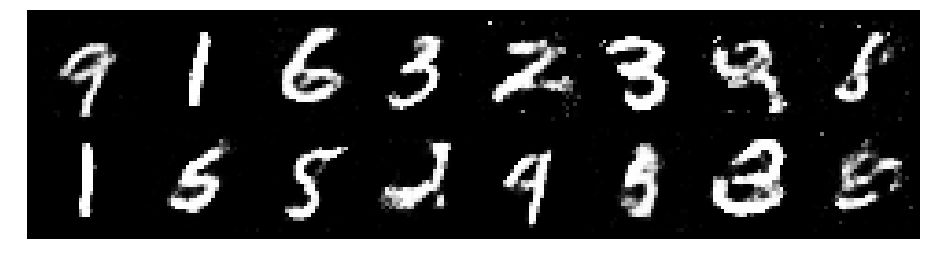

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2665, Generator Loss: 0.9897
D(x): 0.5650, D(G(z)): 0.4417


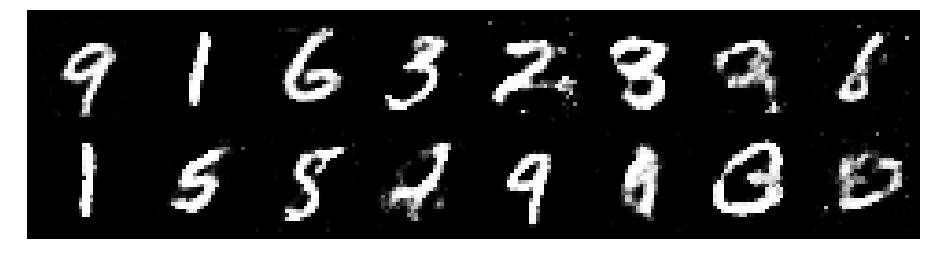

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.3243, Generator Loss: 0.8993
D(x): 0.5327, D(G(z)): 0.4528


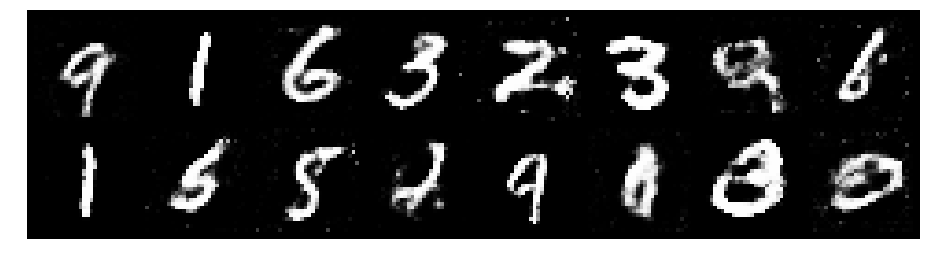

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.3197, Generator Loss: 0.9097
D(x): 0.5244, D(G(z)): 0.4497


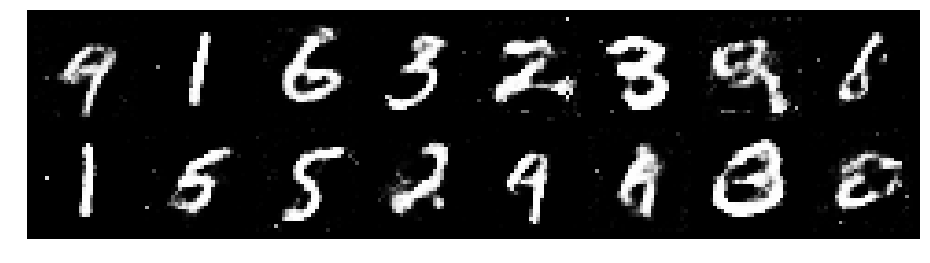

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.5021, Generator Loss: 0.8033
D(x): 0.5205, D(G(z)): 0.5113


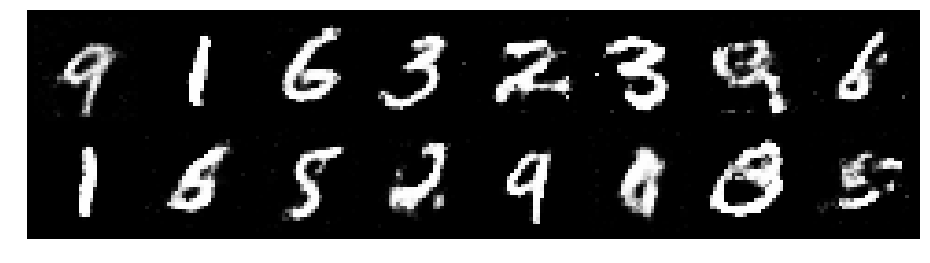

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2871, Generator Loss: 0.8200
D(x): 0.5606, D(G(z)): 0.4681


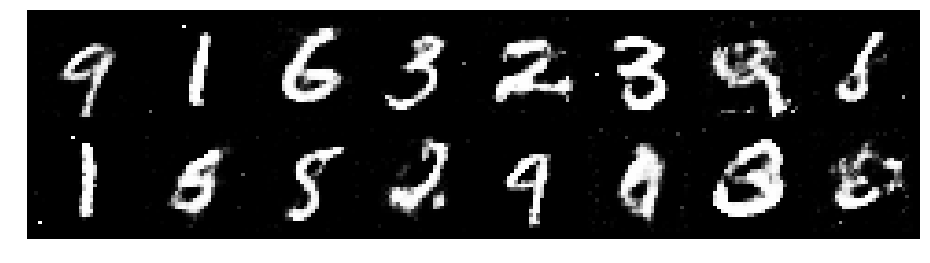

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2559, Generator Loss: 0.8862
D(x): 0.5738, D(G(z)): 0.4544


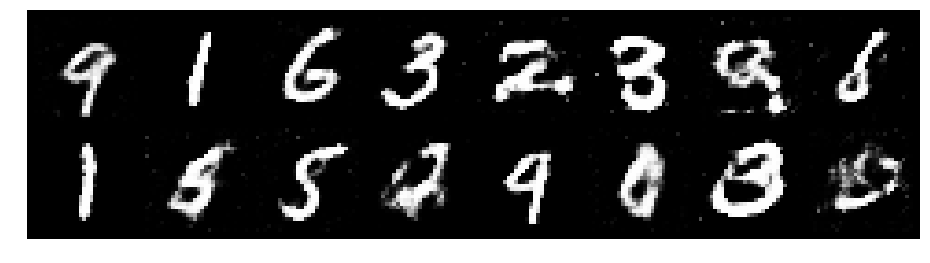

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3006, Generator Loss: 0.9287
D(x): 0.5517, D(G(z)): 0.4501


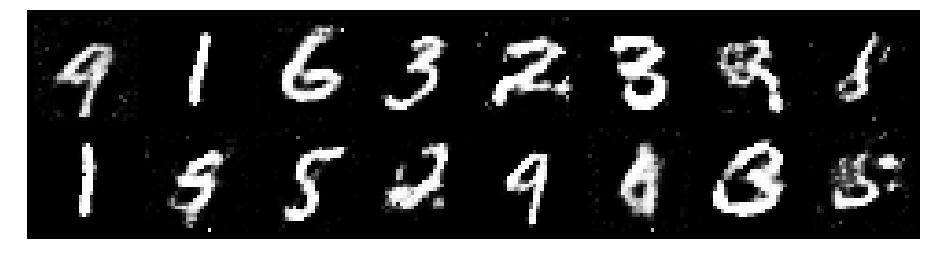

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2433, Generator Loss: 0.8284
D(x): 0.5777, D(G(z)): 0.4516


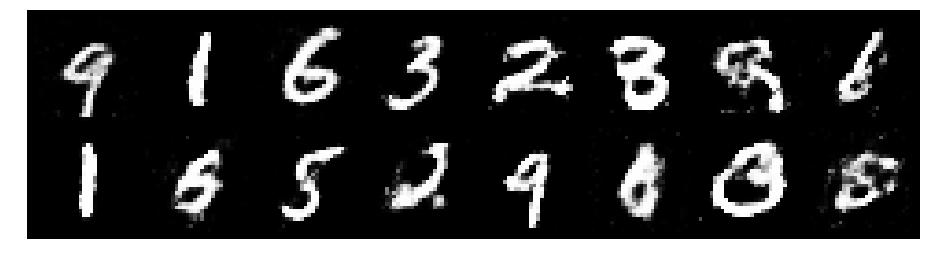

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.1996, Generator Loss: 0.9500
D(x): 0.5678, D(G(z)): 0.4275


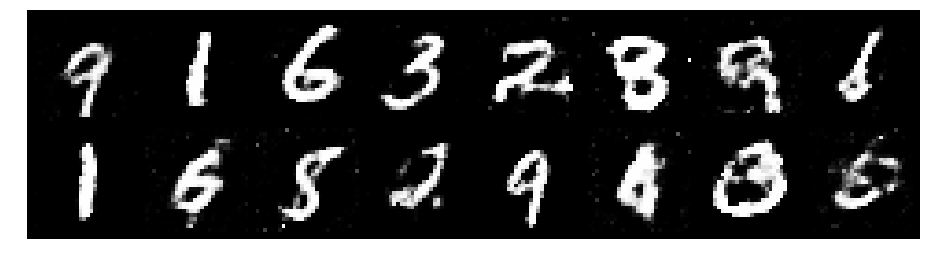

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.3113, Generator Loss: 0.8034
D(x): 0.5187, D(G(z)): 0.4506


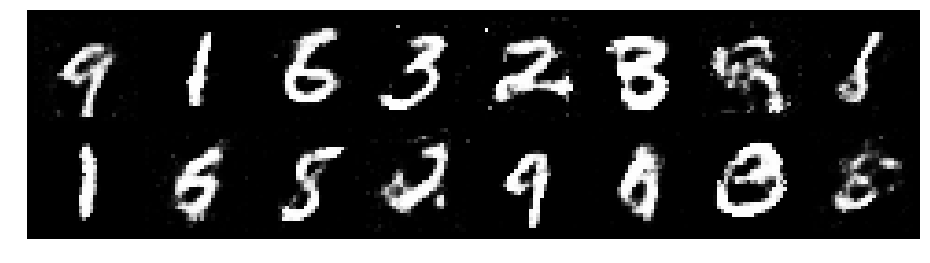

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2167, Generator Loss: 0.9778
D(x): 0.5716, D(G(z)): 0.4355


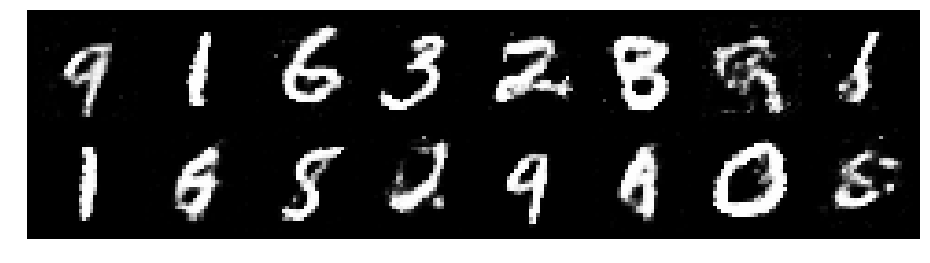

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2546, Generator Loss: 0.9065
D(x): 0.5317, D(G(z)): 0.4192


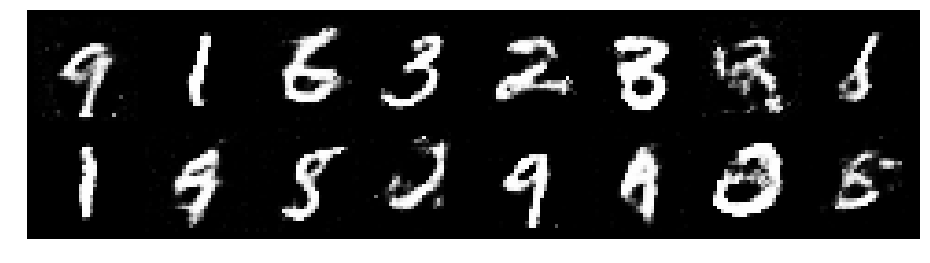

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2063, Generator Loss: 0.9660
D(x): 0.5661, D(G(z)): 0.4099


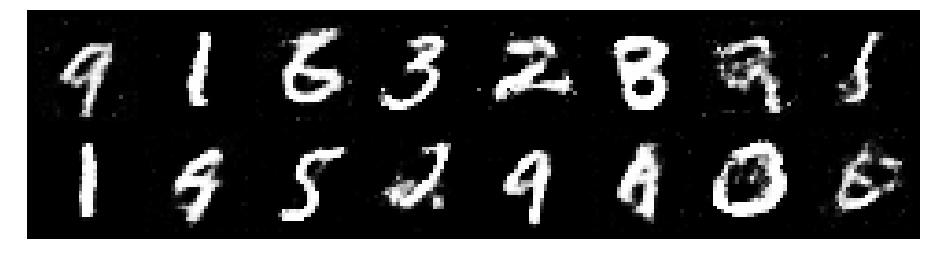

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.3560, Generator Loss: 0.8567
D(x): 0.6209, D(G(z)): 0.5217


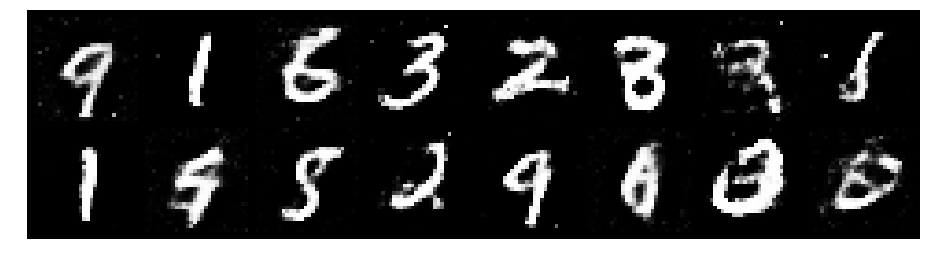

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2244, Generator Loss: 0.7588
D(x): 0.5835, D(G(z)): 0.4599


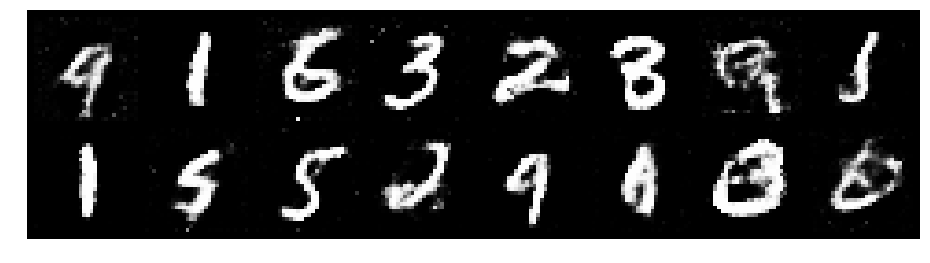

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2863, Generator Loss: 0.8482
D(x): 0.5704, D(G(z)): 0.4641


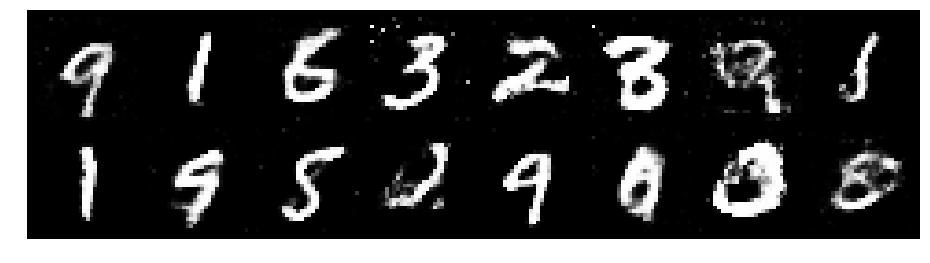

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2932, Generator Loss: 0.9495
D(x): 0.5332, D(G(z)): 0.4168


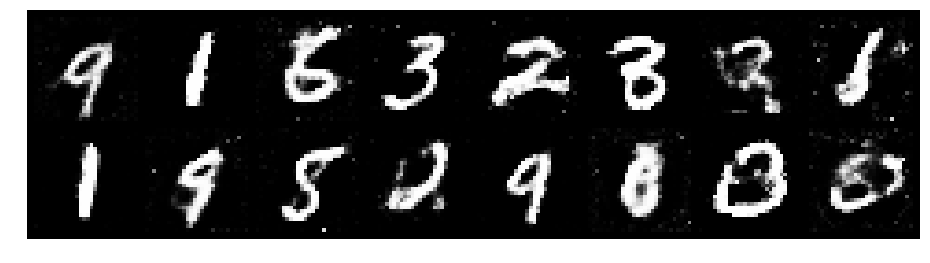

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.4074, Generator Loss: 1.0525
D(x): 0.4879, D(G(z)): 0.4235


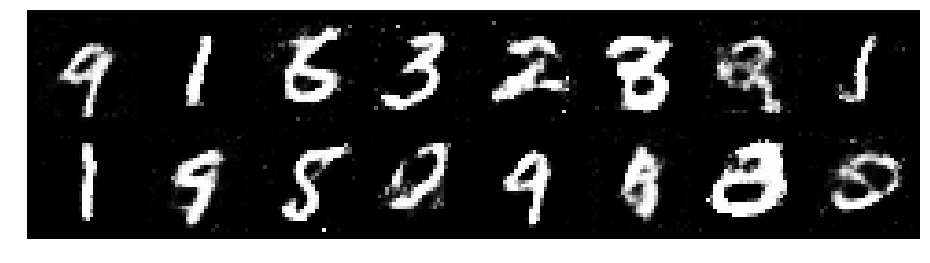

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.3479, Generator Loss: 0.8169
D(x): 0.5330, D(G(z)): 0.4503


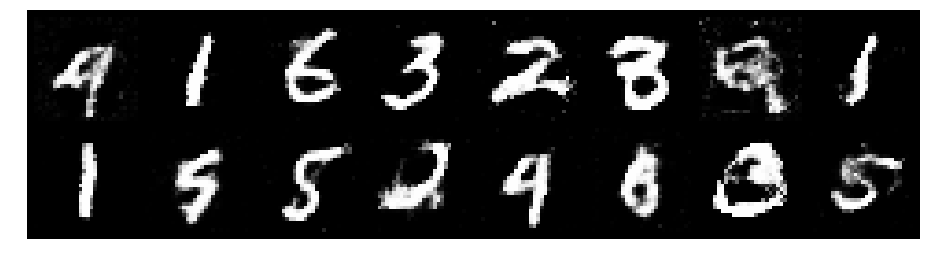

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3088, Generator Loss: 0.8308
D(x): 0.5184, D(G(z)): 0.4376


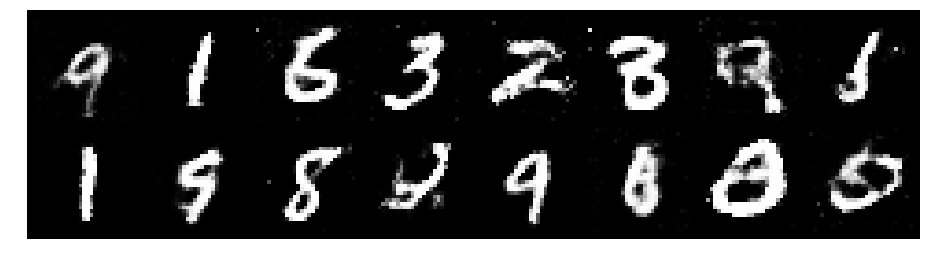

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.3516, Generator Loss: 0.8355
D(x): 0.5647, D(G(z)): 0.4887


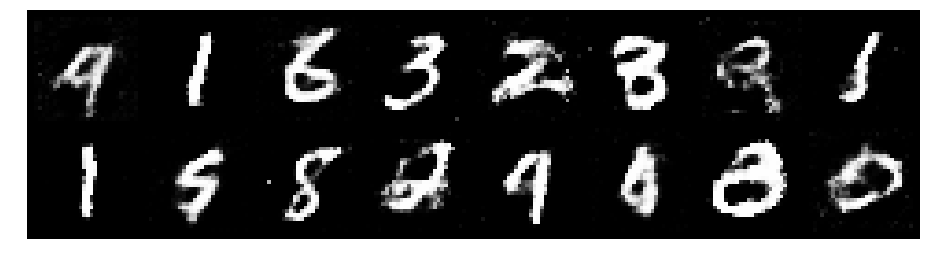

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2353, Generator Loss: 0.9692
D(x): 0.5739, D(G(z)): 0.4327


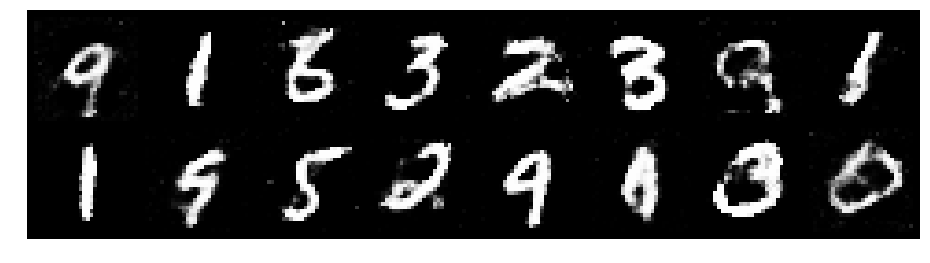

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3833, Generator Loss: 0.9105
D(x): 0.5073, D(G(z)): 0.4296


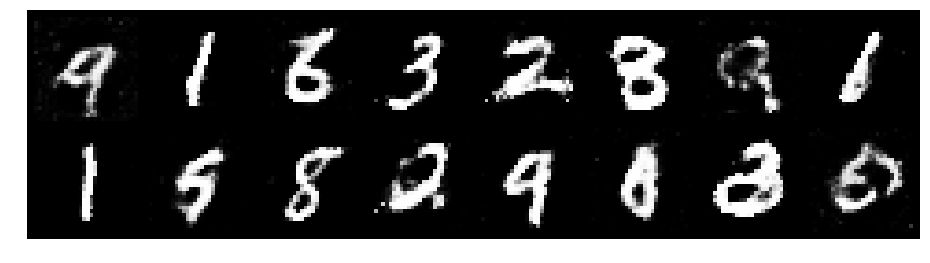

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.0951, Generator Loss: 0.9787
D(x): 0.5729, D(G(z)): 0.3587


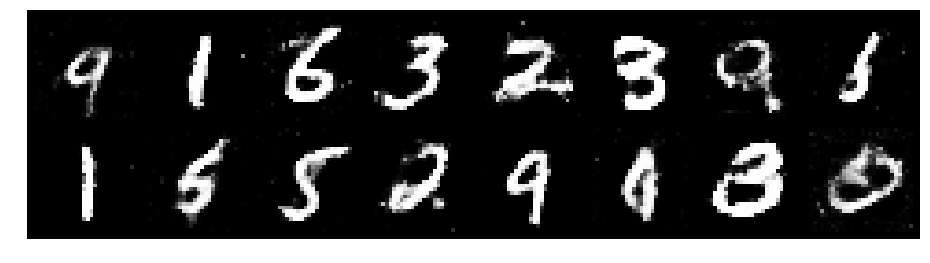

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.1773, Generator Loss: 1.0813
D(x): 0.5539, D(G(z)): 0.3974


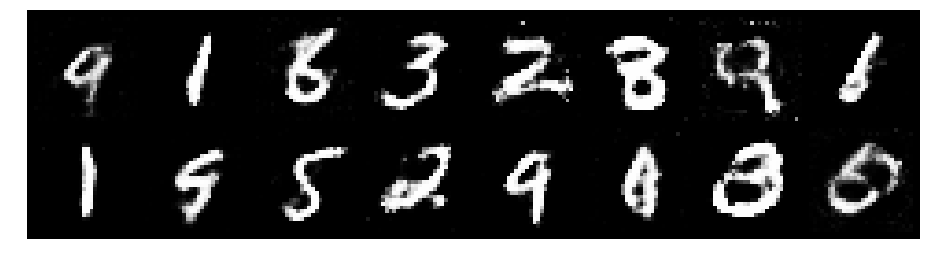

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2792, Generator Loss: 0.9745
D(x): 0.5432, D(G(z)): 0.4310


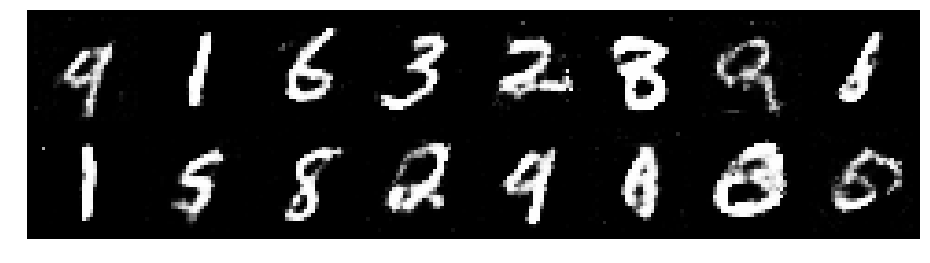

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2434, Generator Loss: 0.8368
D(x): 0.5342, D(G(z)): 0.4314


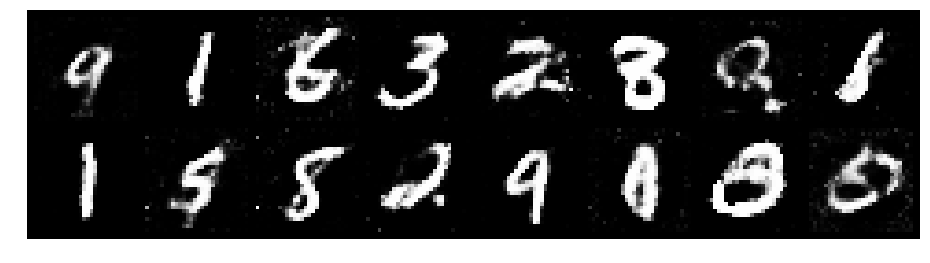

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.3316, Generator Loss: 0.7875
D(x): 0.5965, D(G(z)): 0.4899


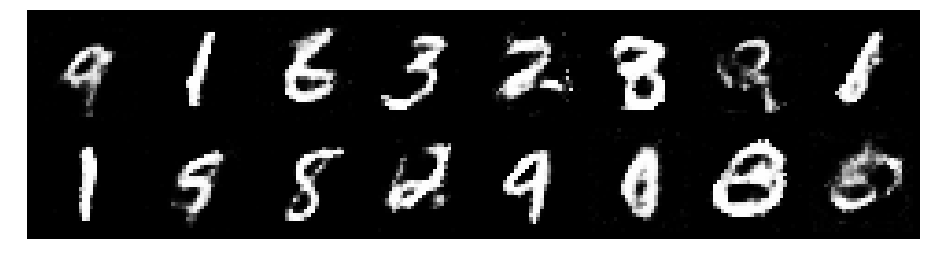

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.3406, Generator Loss: 0.8295
D(x): 0.5462, D(G(z)): 0.4792


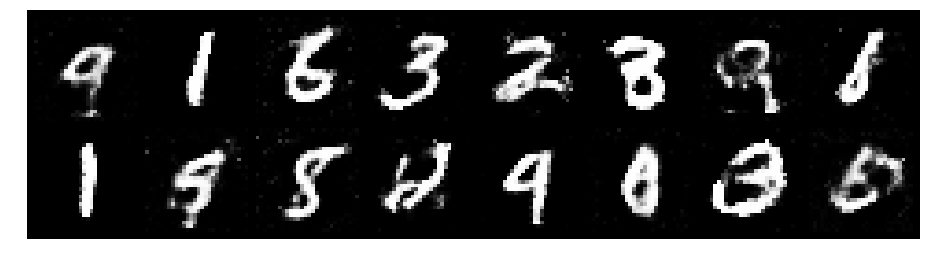

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2242, Generator Loss: 0.7614
D(x): 0.5691, D(G(z)): 0.4505


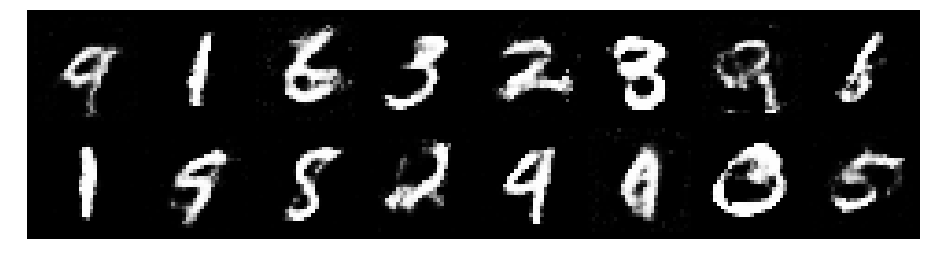

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2007, Generator Loss: 0.9427
D(x): 0.5650, D(G(z)): 0.4214


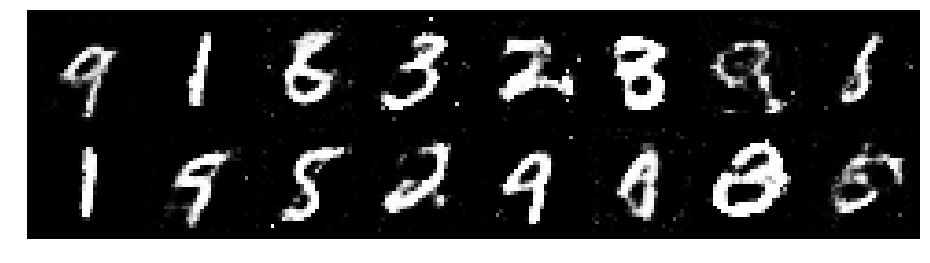

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.3387, Generator Loss: 0.8298
D(x): 0.5104, D(G(z)): 0.4398


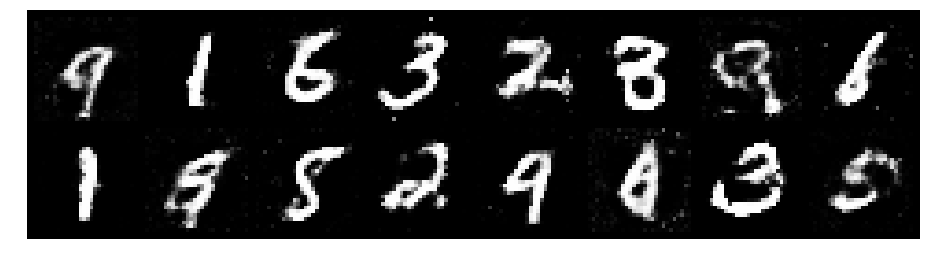

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2210, Generator Loss: 0.8700
D(x): 0.5695, D(G(z)): 0.4380


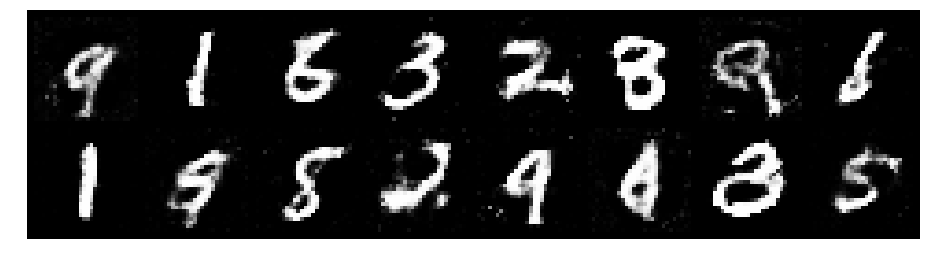

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.1786, Generator Loss: 0.9228
D(x): 0.5857, D(G(z)): 0.4278


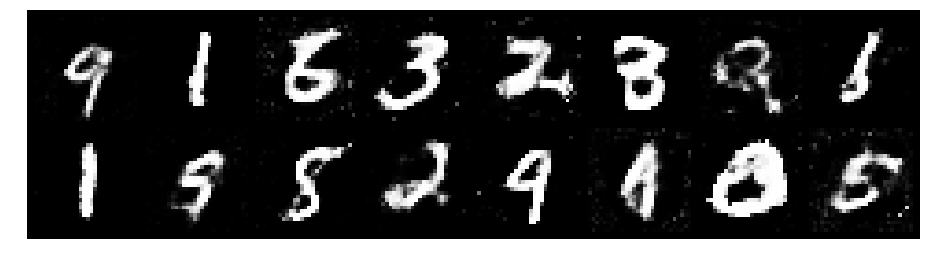

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.3415, Generator Loss: 1.1355
D(x): 0.5233, D(G(z)): 0.4174


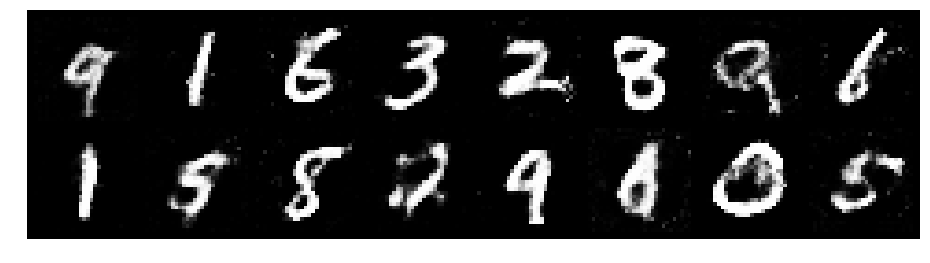

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.1708, Generator Loss: 1.0106
D(x): 0.5613, D(G(z)): 0.4104


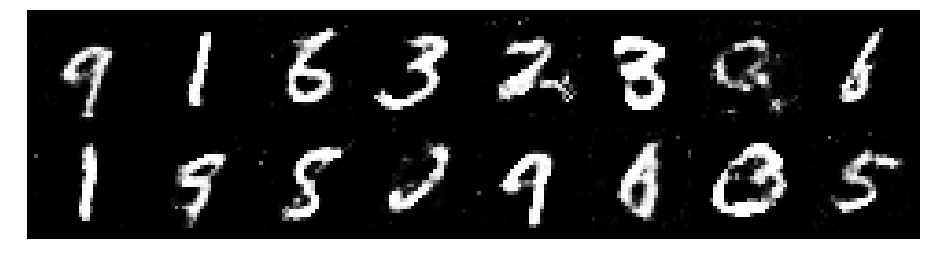

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2513, Generator Loss: 0.9187
D(x): 0.5637, D(G(z)): 0.4500


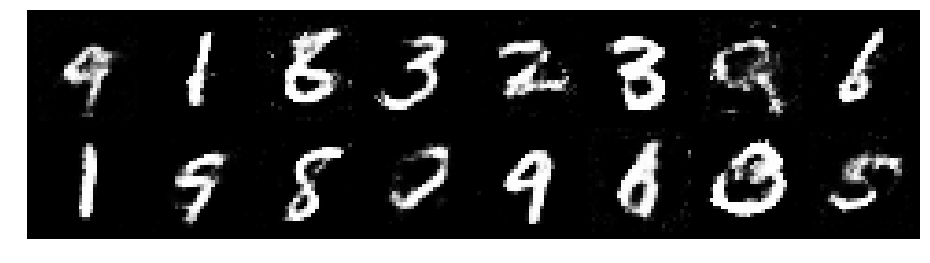

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2615, Generator Loss: 0.8705
D(x): 0.5478, D(G(z)): 0.4490


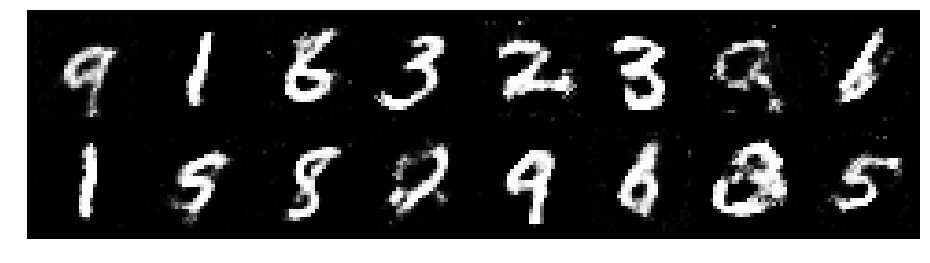

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.2998, Generator Loss: 0.8287
D(x): 0.5243, D(G(z)): 0.4496


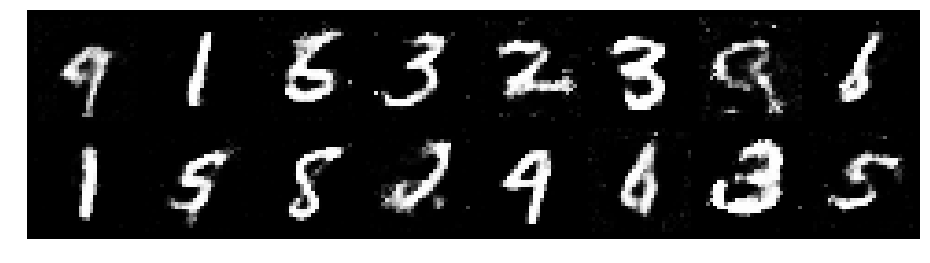

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.3405, Generator Loss: 0.7593
D(x): 0.5322, D(G(z)): 0.4906


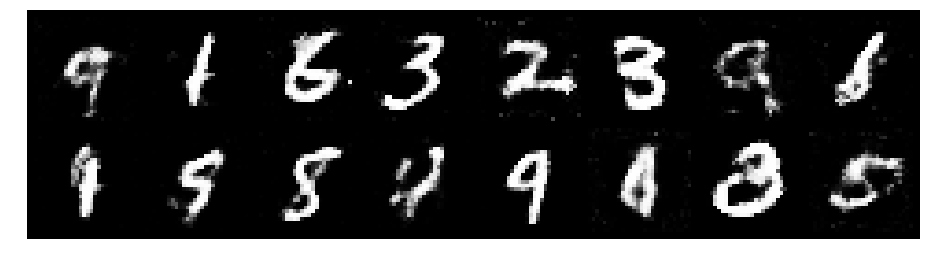

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3432, Generator Loss: 0.8650
D(x): 0.5151, D(G(z)): 0.4531


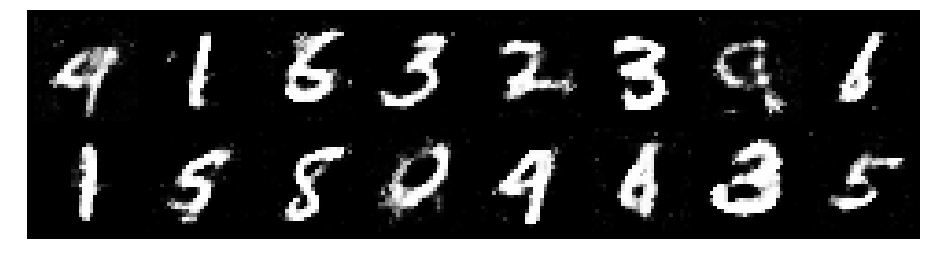

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.3876, Generator Loss: 0.8661
D(x): 0.5410, D(G(z)): 0.4819


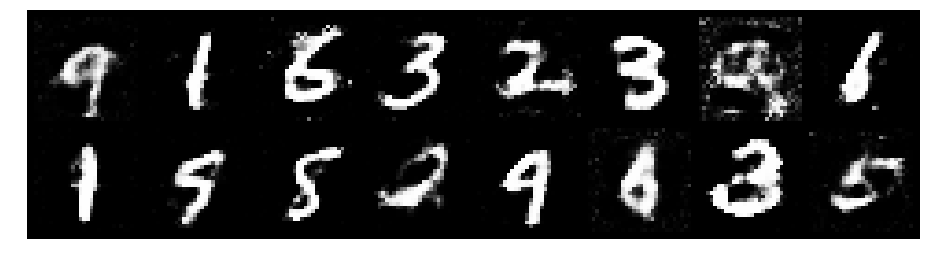

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.4102, Generator Loss: 0.8903
D(x): 0.5286, D(G(z)): 0.4487


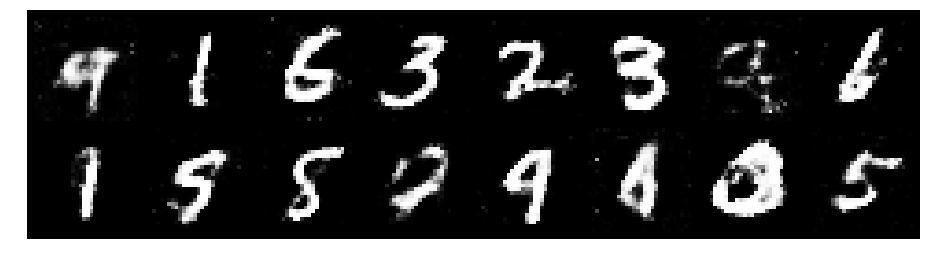

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2307, Generator Loss: 0.9412
D(x): 0.5713, D(G(z)): 0.4326


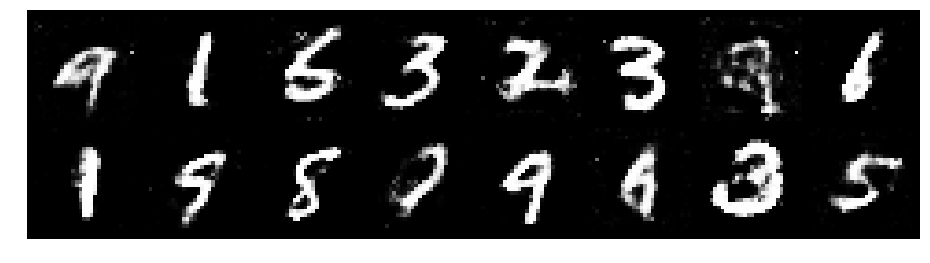

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.3341, Generator Loss: 0.8702
D(x): 0.5826, D(G(z)): 0.4800


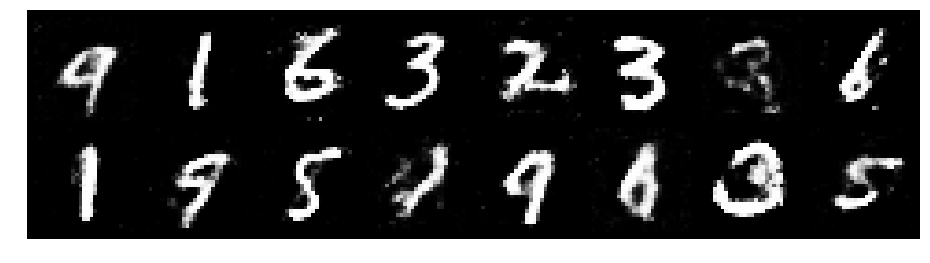

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.1826, Generator Loss: 0.9534
D(x): 0.5745, D(G(z)): 0.4065


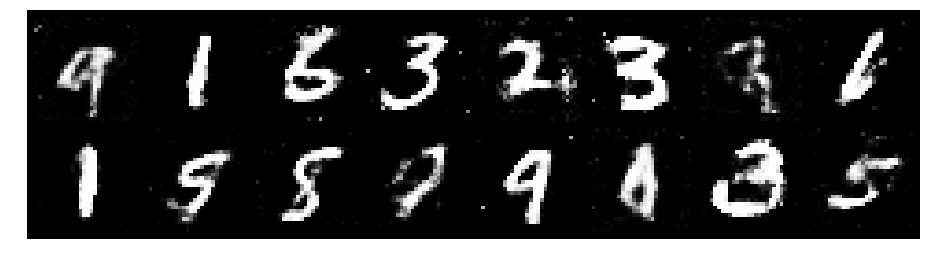

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.3543, Generator Loss: 0.8138
D(x): 0.5303, D(G(z)): 0.4811


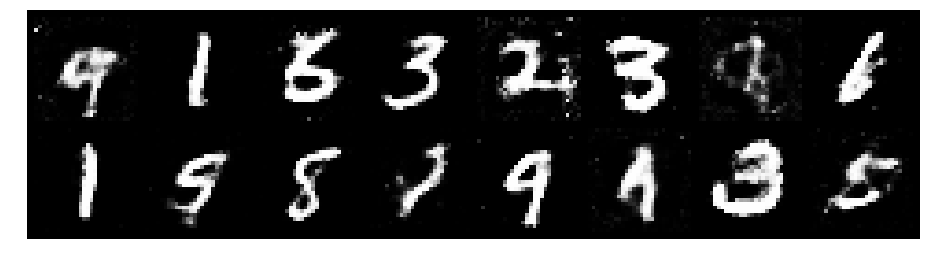

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2479, Generator Loss: 0.9981
D(x): 0.5459, D(G(z)): 0.4322


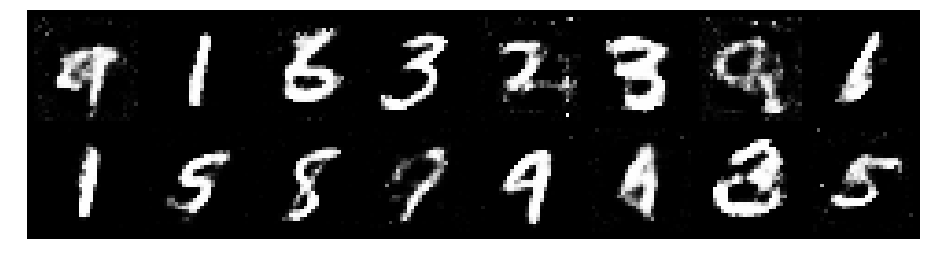

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2271, Generator Loss: 0.8388
D(x): 0.5903, D(G(z)): 0.4600


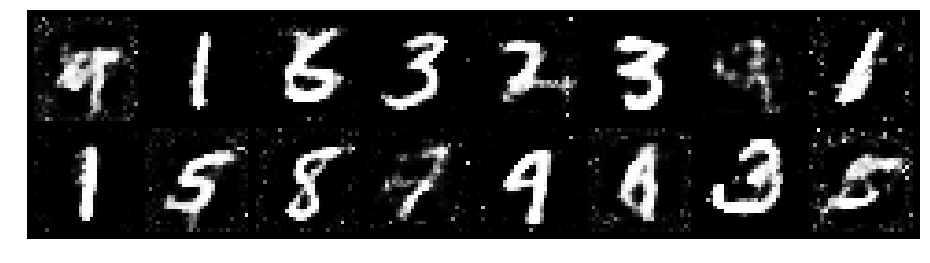

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.2243, Generator Loss: 0.8573
D(x): 0.5332, D(G(z)): 0.4145


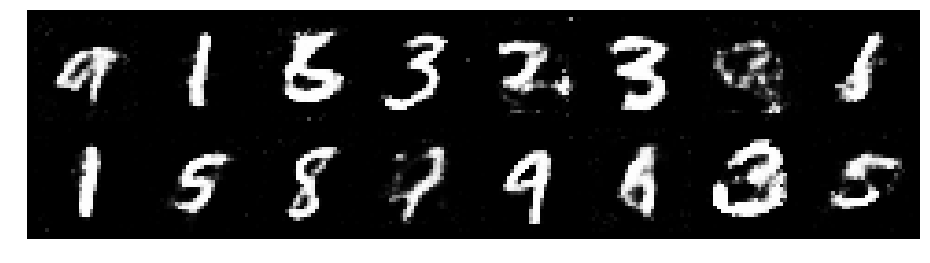

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2772, Generator Loss: 0.8345
D(x): 0.5491, D(G(z)): 0.4490


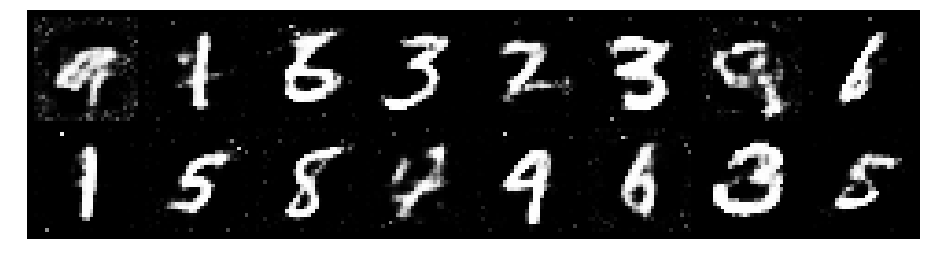

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3328, Generator Loss: 0.7936
D(x): 0.5594, D(G(z)): 0.4802


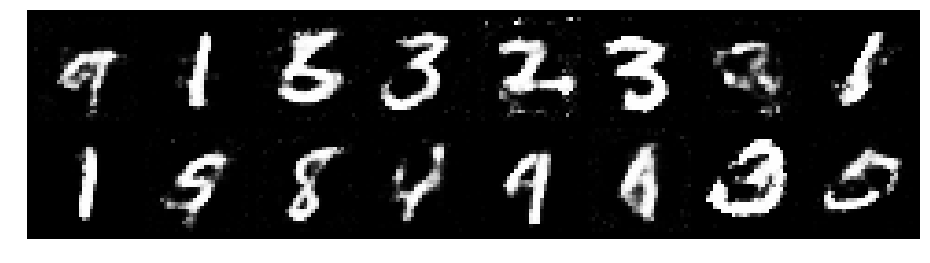

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2130, Generator Loss: 0.8448
D(x): 0.5771, D(G(z)): 0.4468


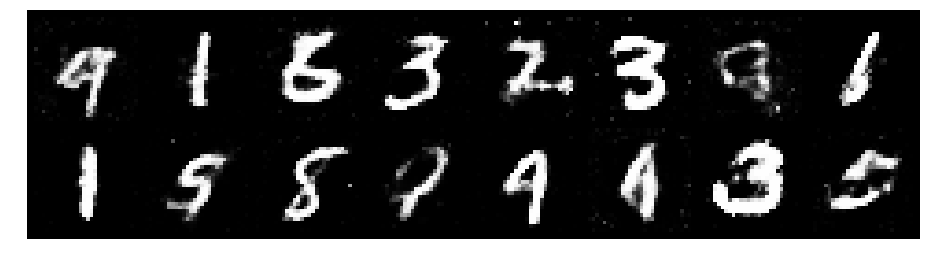

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.3707, Generator Loss: 0.7899
D(x): 0.5502, D(G(z)): 0.4955


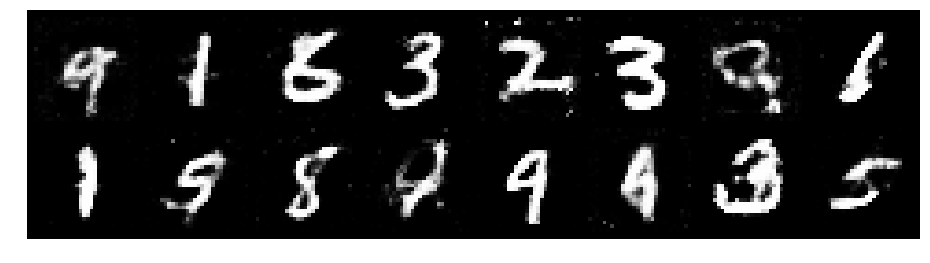

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2228, Generator Loss: 0.9270
D(x): 0.5986, D(G(z)): 0.4656


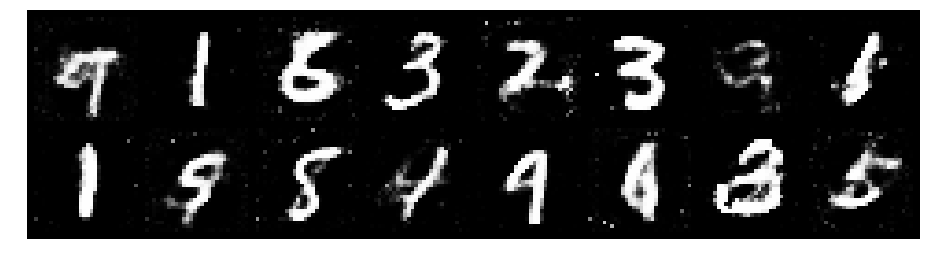

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.1721, Generator Loss: 0.9912
D(x): 0.5793, D(G(z)): 0.4054


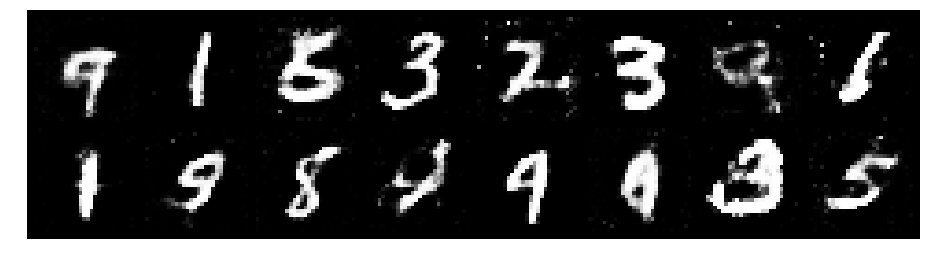

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.4040, Generator Loss: 0.9536
D(x): 0.5404, D(G(z)): 0.4650


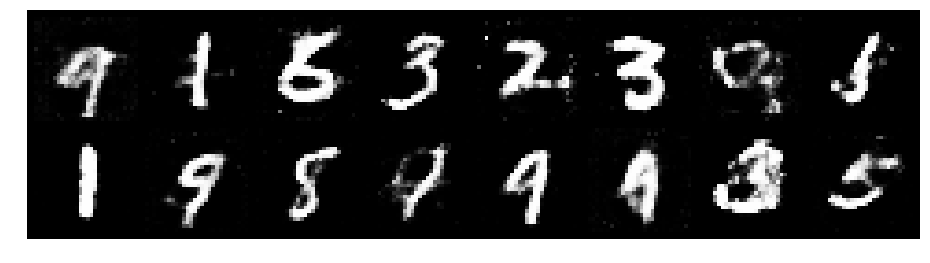

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2145, Generator Loss: 0.9483
D(x): 0.5493, D(G(z)): 0.4130


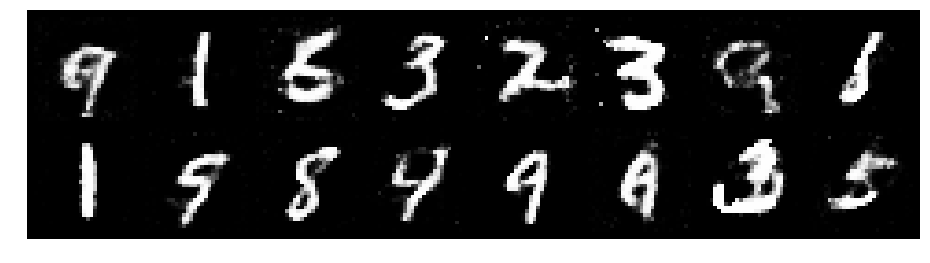

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2295, Generator Loss: 1.0212
D(x): 0.5304, D(G(z)): 0.4016


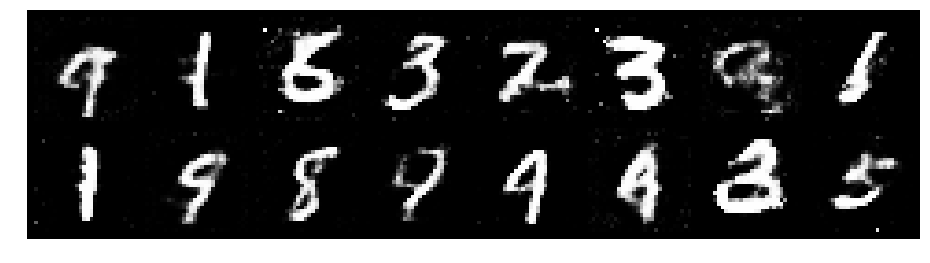

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.1718, Generator Loss: 0.7838
D(x): 0.6210, D(G(z)): 0.4695


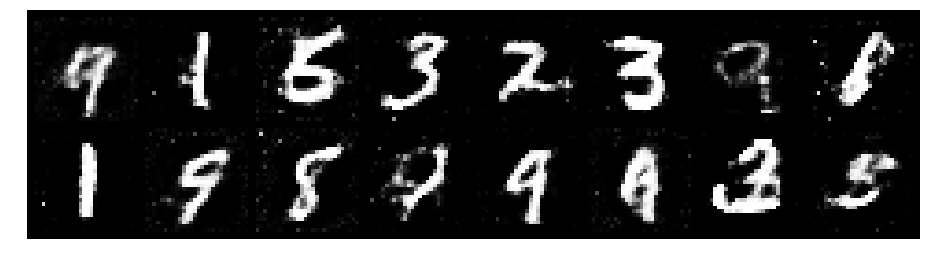

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.2024, Generator Loss: 0.9552
D(x): 0.6092, D(G(z)): 0.4520


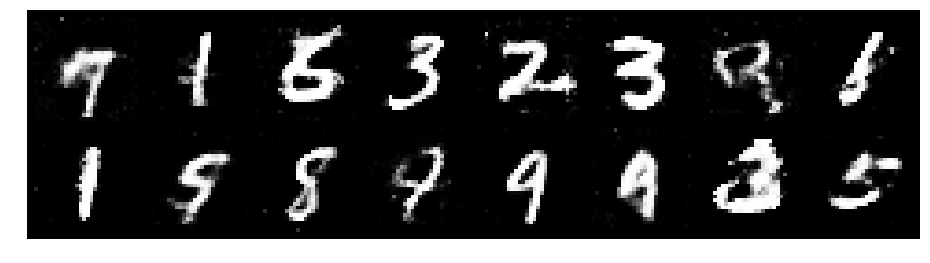

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2760, Generator Loss: 0.8341
D(x): 0.5518, D(G(z)): 0.4436


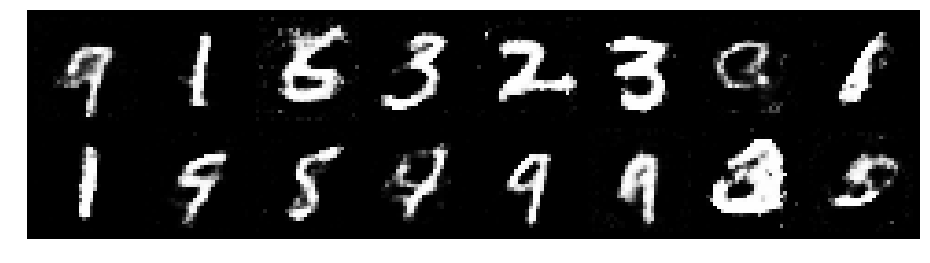

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.3212, Generator Loss: 0.9180
D(x): 0.5755, D(G(z)): 0.4585


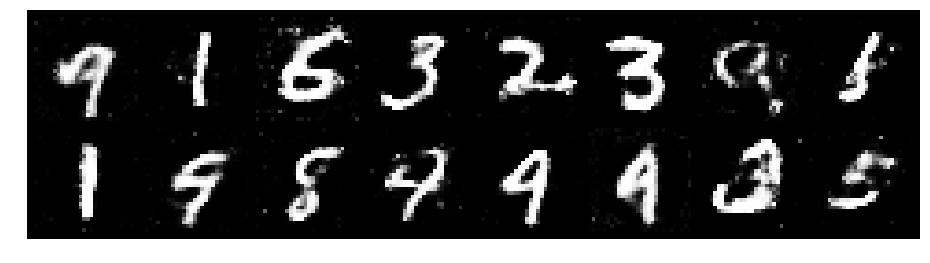

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2708, Generator Loss: 0.9219
D(x): 0.5503, D(G(z)): 0.4480


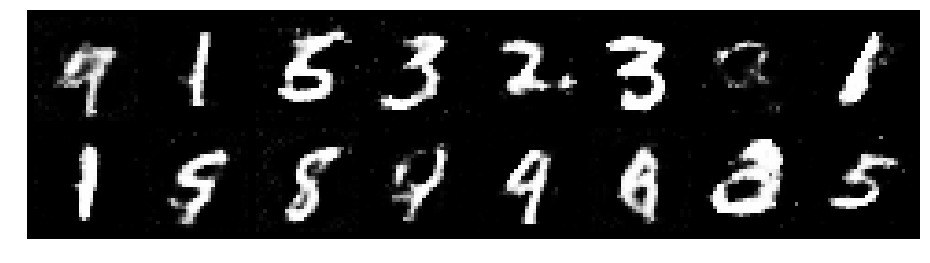

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.3462, Generator Loss: 1.0255
D(x): 0.5215, D(G(z)): 0.4331


In [ ]:
# Training the GAN!

# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')

# Total number of epochs
num_epochs = 200

for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        
        # 1. Train the discriminator
        real_data = Variable(images_to_vectors(real_batch))
        
        # Generate fake data and detach
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        
        # Train discriminator D
        d_error, d_pred_real, d_pred_fake = train_discriminator(d_optimizer, real_data, fake_data)
    
    
        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        
        # Display progress every few batches
        if (n_batch) % 100 == 0:
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            
            logger.log_images(
                test_images, num_test_samples,
                epoch, n_batch, num_batches
            )
            # Display status logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )